<center><h1>1-cd: Convolutional Neural Networks (ConvNets)</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>



In [1]:
#!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git
! rm utils.py
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2024-10-28 10:53:46--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2024-10-28 10:53:46--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]   2.57K  --.-KB/s    in 0s      

2024-10-28 10:53:46 (36.7 MB/s) - ‘utils.py’ saved [2627/2627]



In [2]:
%run 'utils.py'

In [3]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from utils import *

PRINT_INTERVAL = 200
PATH="datasets"

In [4]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.560s (0.560s)	Loss 2.3015 (2.3015)	Prec@1  11.7 ( 11.7)	Prec@5  52.3 ( 52.3)


<Figure size 640x480 with 0 Axes>

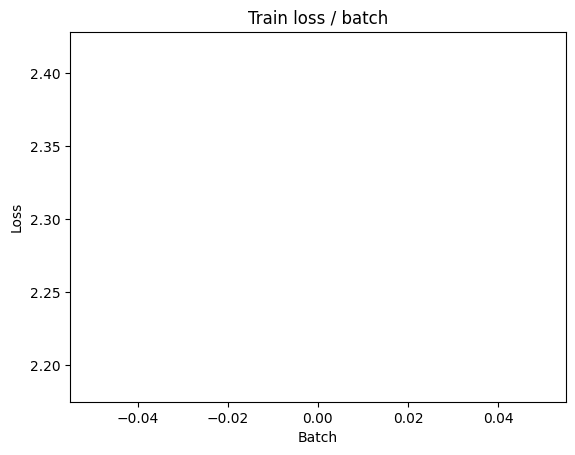

[TRAIN Batch 200/391]	Time 0.020s (0.016s)	Loss 2.0693 (2.2240)	Prec@1  28.1 ( 16.7)	Prec@5  71.1 ( 63.6)


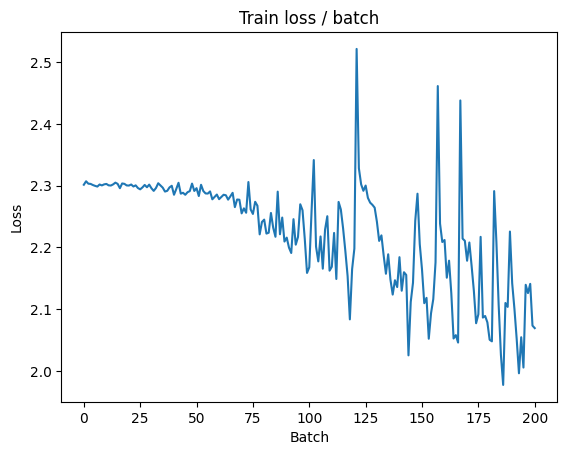


===============> Total time 8s	Avg loss 2.0963	Avg Prec@1 22.86 %	Avg Prec@5 71.47 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 1.8744 (1.8744)	Prec@1  32.8 ( 32.8)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.8908	Avg Prec@1 31.24 %	Avg Prec@5 83.29 %



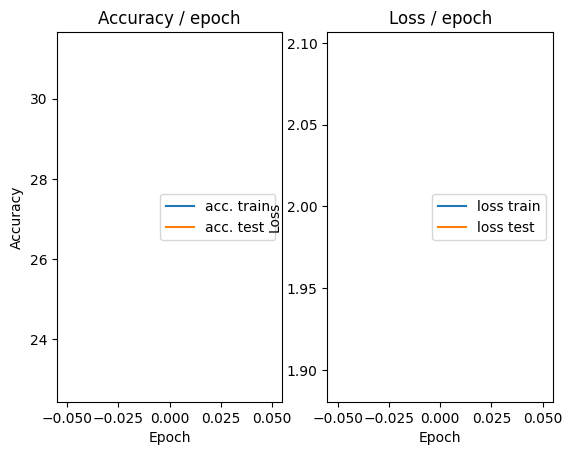

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.104s (0.104s)	Loss 2.0361 (2.0361)	Prec@1  22.7 ( 22.7)	Prec@5  78.9 ( 78.9)


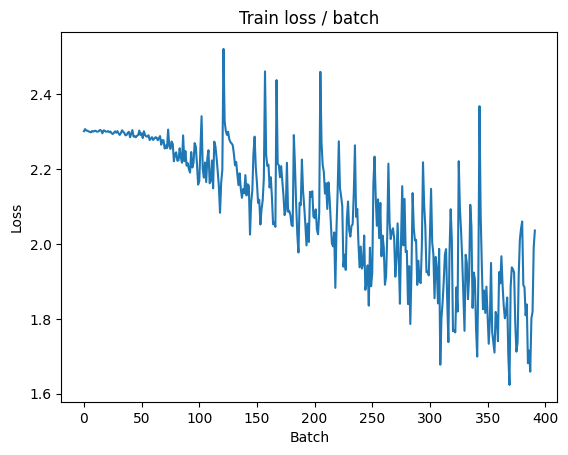

[TRAIN Batch 200/391]	Time 0.012s (0.024s)	Loss 1.6789 (1.7162)	Prec@1  37.5 ( 38.2)	Prec@5  89.8 ( 87.6)


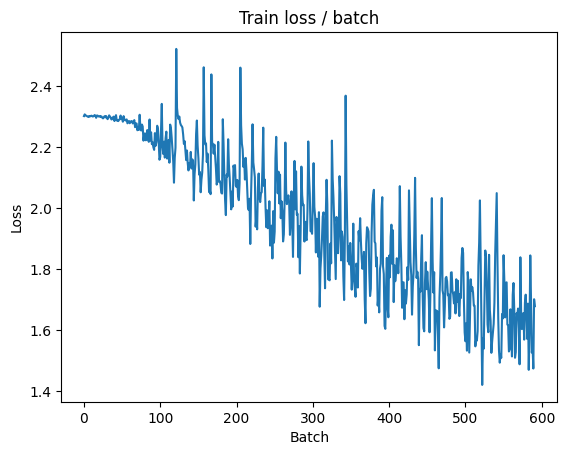


===============> Total time 8s	Avg loss 1.6400	Avg Prec@1 41.01 %	Avg Prec@5 89.00 %

[EVAL Batch 000/079]	Time 0.069s (0.069s)	Loss 1.4136 (1.4136)	Prec@1  49.2 ( 49.2)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.4832	Avg Prec@1 46.32 %	Avg Prec@5 91.98 %



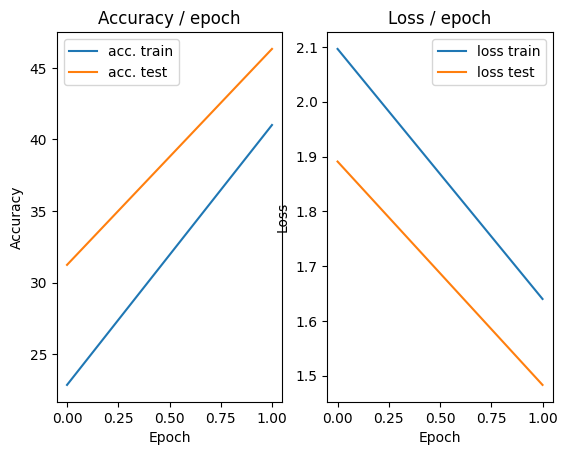

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.092s (0.092s)	Loss 1.4318 (1.4318)	Prec@1  45.3 ( 45.3)	Prec@5  93.8 ( 93.8)


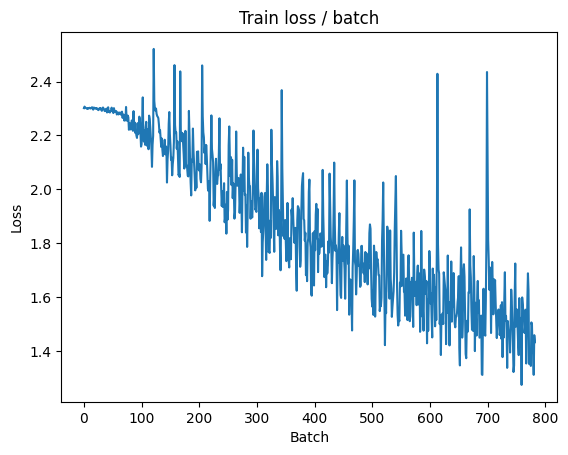

[TRAIN Batch 200/391]	Time 0.011s (0.017s)	Loss 1.3291 (1.4270)	Prec@1  50.0 ( 48.8)	Prec@5  94.5 ( 92.6)


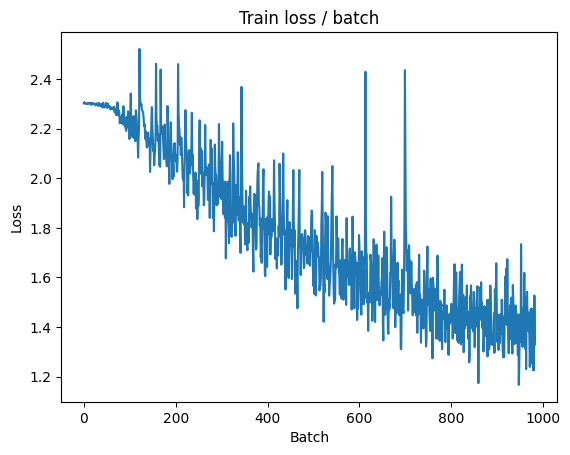


===============> Total time 6s	Avg loss 1.3910	Avg Prec@1 50.32 %	Avg Prec@5 93.03 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 1.4386 (1.4386)	Prec@1  52.3 ( 52.3)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.4973	Avg Prec@1 46.96 %	Avg Prec@5 90.06 %



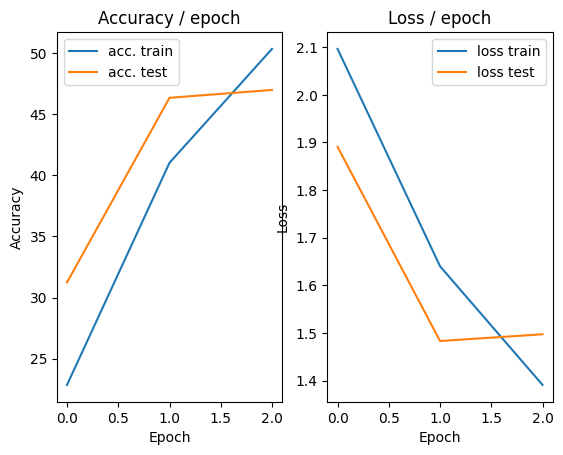

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.100s (0.100s)	Loss 1.4026 (1.4026)	Prec@1  51.6 ( 51.6)	Prec@5  91.4 ( 91.4)


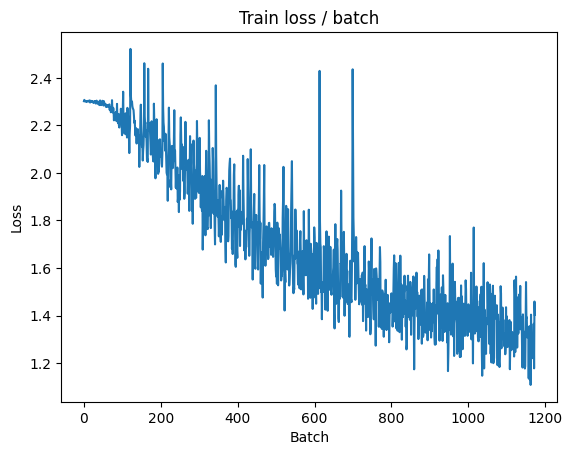

[TRAIN Batch 200/391]	Time 0.020s (0.018s)	Loss 1.2206 (1.2642)	Prec@1  64.1 ( 55.1)	Prec@5  93.0 ( 94.5)


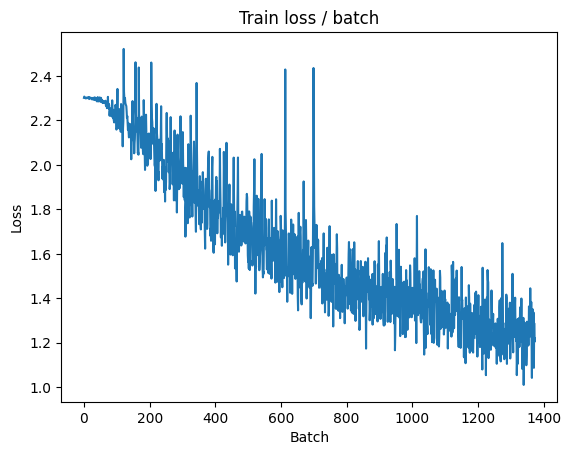


===============> Total time 6s	Avg loss 1.2382	Avg Prec@1 55.98 %	Avg Prec@5 94.63 %

[EVAL Batch 000/079]	Time 0.063s (0.063s)	Loss 1.0773 (1.0773)	Prec@1  67.2 ( 67.2)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1637	Avg Prec@1 58.01 %	Avg Prec@5 95.53 %



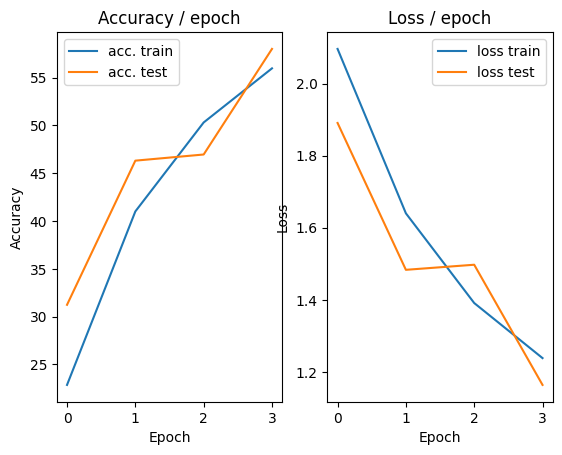

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.091s (0.091s)	Loss 1.1623 (1.1623)	Prec@1  61.7 ( 61.7)	Prec@5  93.8 ( 93.8)


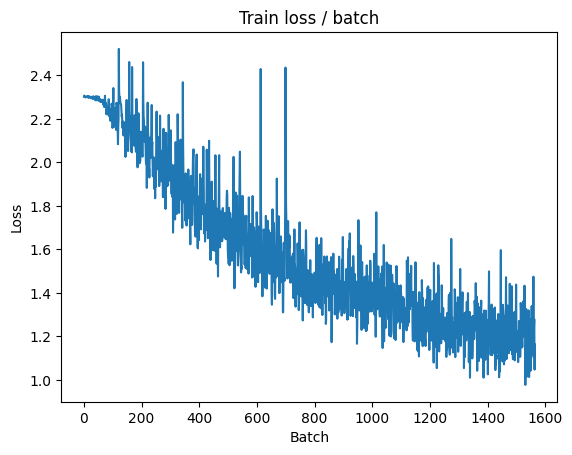

[TRAIN Batch 200/391]	Time 0.018s (0.016s)	Loss 1.0265 (1.1193)	Prec@1  61.7 ( 60.6)	Prec@5  96.1 ( 95.9)


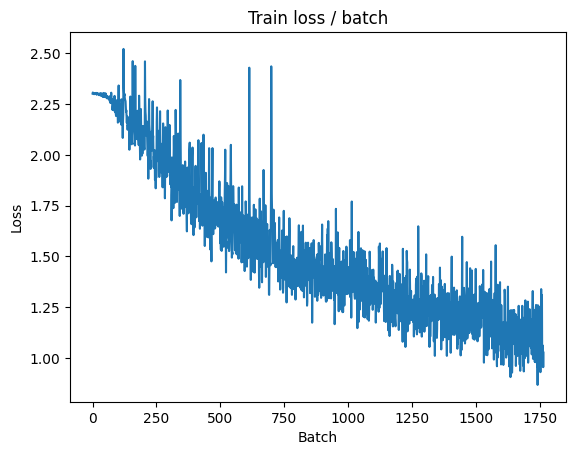


===============> Total time 6s	Avg loss 1.1042	Avg Prec@1 60.95 %	Avg Prec@5 96.01 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 1.0156 (1.0156)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0978	Avg Prec@1 60.77 %	Avg Prec@5 96.19 %



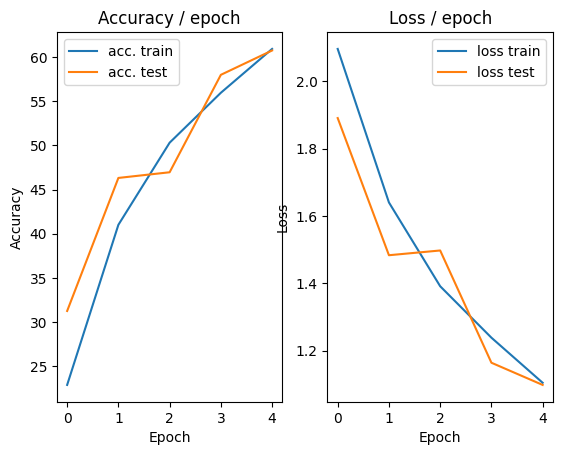

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.098s (0.098s)	Loss 1.0716 (1.0716)	Prec@1  66.4 ( 66.4)	Prec@5  93.8 ( 93.8)


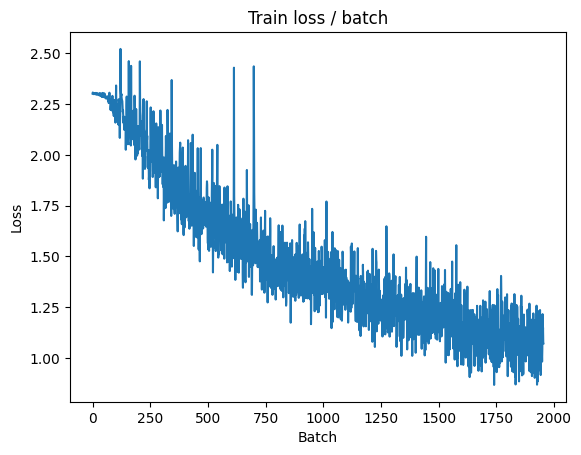

[TRAIN Batch 200/391]	Time 0.013s (0.017s)	Loss 1.0249 (0.9958)	Prec@1  67.2 ( 65.2)	Prec@5  93.8 ( 96.8)


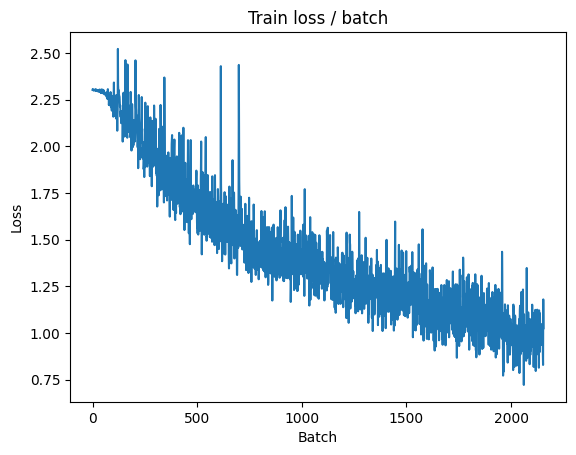


===============> Total time 6s	Avg loss 0.9776	Avg Prec@1 65.72 %	Avg Prec@5 96.99 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.9044 (0.9044)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0431	Avg Prec@1 62.98 %	Avg Prec@5 96.61 %



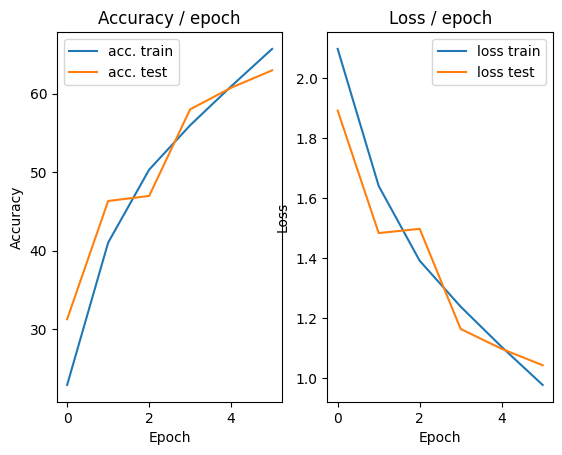

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.095s (0.095s)	Loss 0.9392 (0.9392)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)


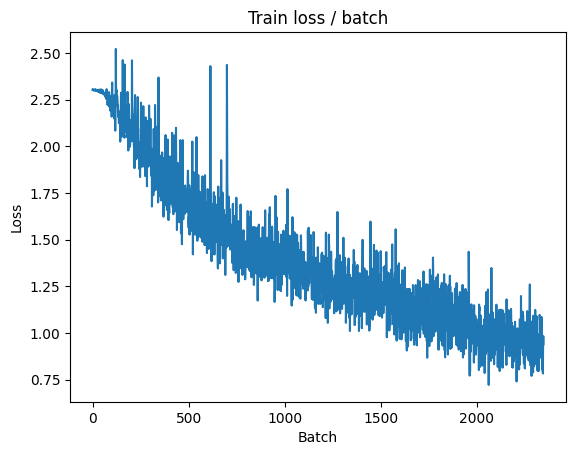

[TRAIN Batch 200/391]	Time 0.006s (0.015s)	Loss 0.8784 (0.8832)	Prec@1  67.2 ( 68.8)	Prec@5  98.4 ( 97.6)


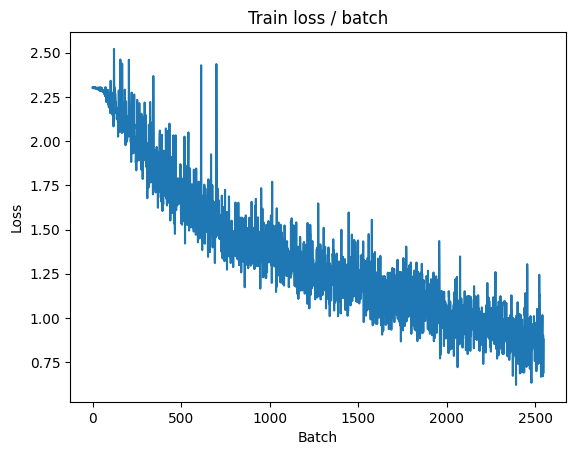


===============> Total time 5s	Avg loss 0.8770	Avg Prec@1 69.09 %	Avg Prec@5 97.65 %

[EVAL Batch 000/079]	Time 0.065s (0.065s)	Loss 0.9139 (0.9139)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9751	Avg Prec@1 65.57 %	Avg Prec@5 96.90 %



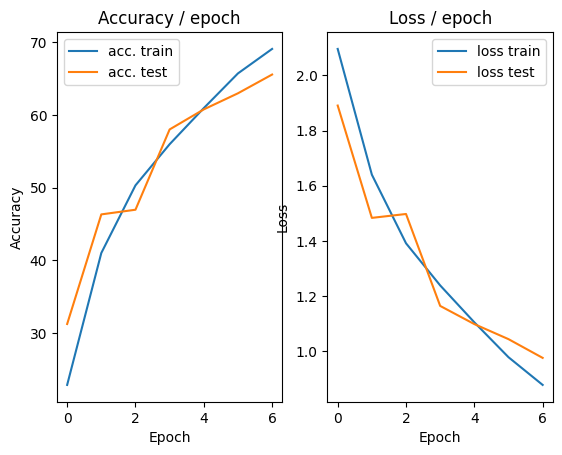

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.098s (0.098s)	Loss 0.7115 (0.7115)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)


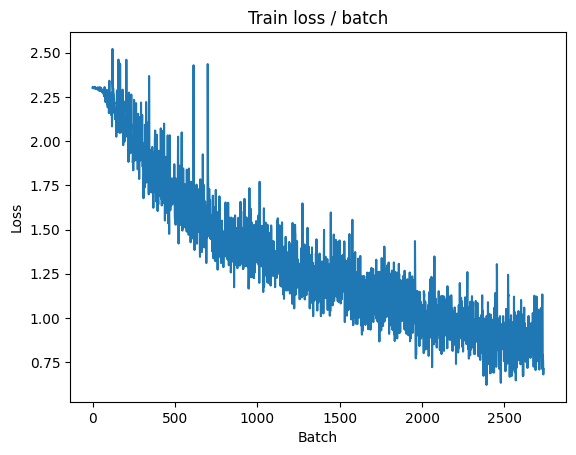

[TRAIN Batch 200/391]	Time 0.032s (0.022s)	Loss 0.6860 (0.7764)	Prec@1  73.4 ( 72.8)	Prec@5  99.2 ( 98.1)


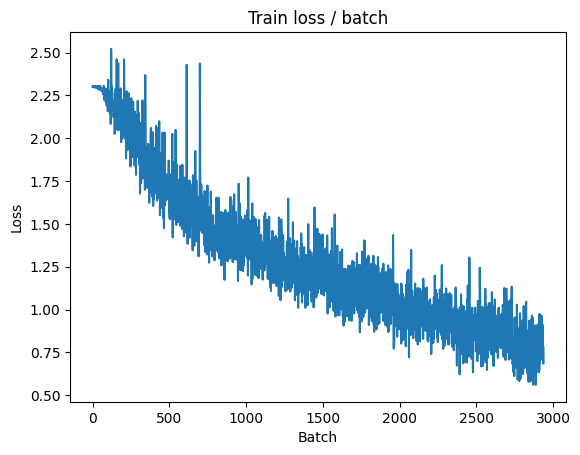


===============> Total time 7s	Avg loss 0.7728	Avg Prec@1 72.87 %	Avg Prec@5 98.22 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.9060 (0.9060)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0463	Avg Prec@1 63.52 %	Avg Prec@5 96.74 %



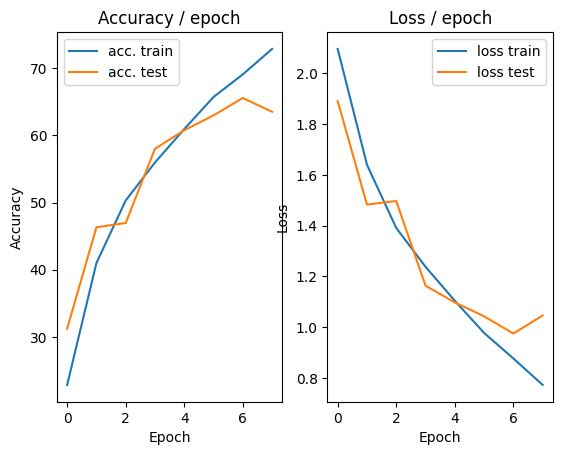

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.092s (0.092s)	Loss 0.6533 (0.6533)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)


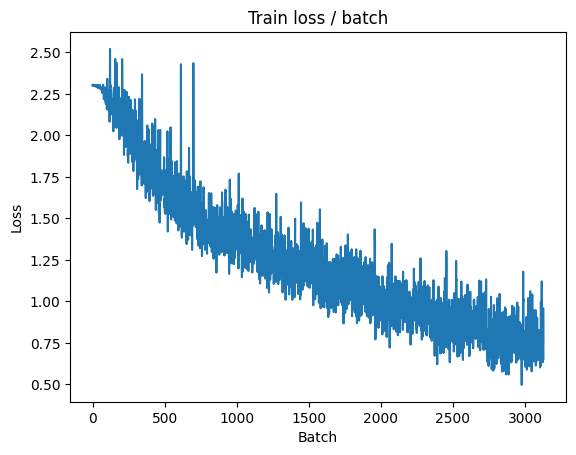

[TRAIN Batch 200/391]	Time 0.007s (0.015s)	Loss 0.6845 (0.6624)	Prec@1  76.6 ( 76.7)	Prec@5  98.4 ( 98.9)


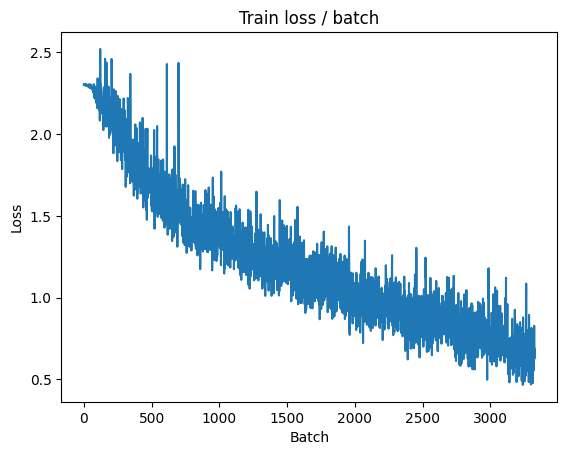


===============> Total time 5s	Avg loss 0.6764	Avg Prec@1 76.20 %	Avg Prec@5 98.76 %

[EVAL Batch 000/079]	Time 0.067s (0.067s)	Loss 0.9514 (0.9514)	Prec@1  68.8 ( 68.8)	Prec@5  99.2 ( 99.2)

===============> Total time 0s	Avg loss 0.9929	Avg Prec@1 66.31 %	Avg Prec@5 96.88 %



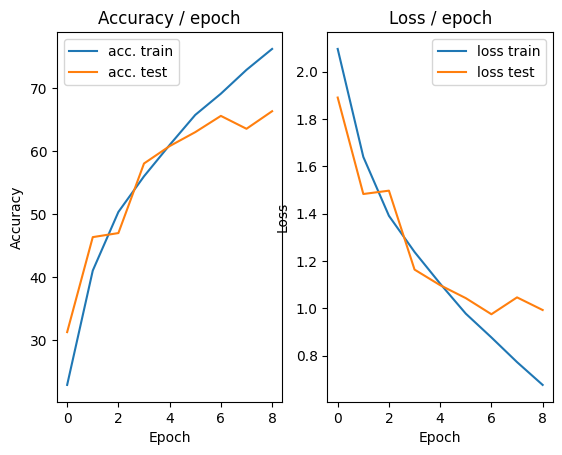

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.083s (0.083s)	Loss 0.6749 (0.6749)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


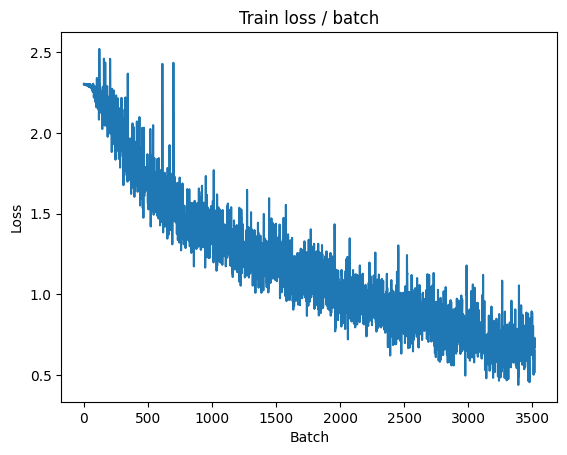

[TRAIN Batch 200/391]	Time 0.008s (0.013s)	Loss 0.4887 (0.5816)	Prec@1  82.0 ( 79.7)	Prec@5  99.2 ( 99.1)


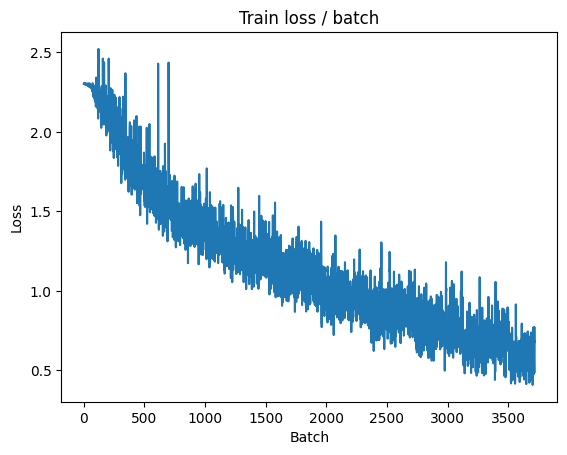


===============> Total time 5s	Avg loss 0.5959	Avg Prec@1 79.24 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.068s (0.068s)	Loss 0.8989 (0.8989)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9225	Avg Prec@1 68.72 %	Avg Prec@5 97.18 %



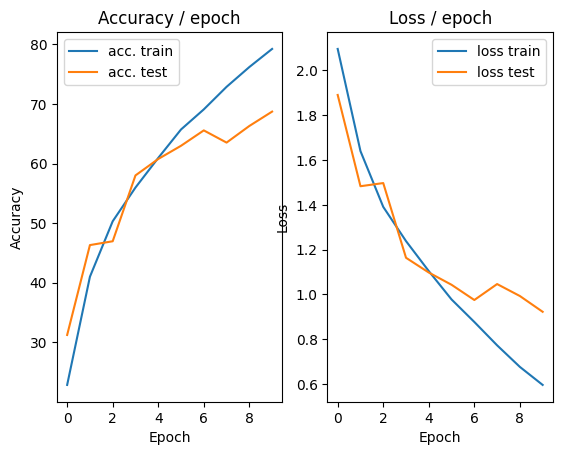

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.080s (0.080s)	Loss 0.5784 (0.5784)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


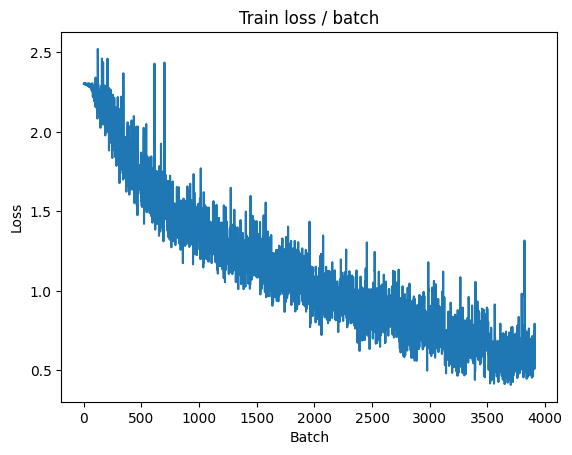

[TRAIN Batch 200/391]	Time 0.008s (0.014s)	Loss 0.4685 (0.4870)	Prec@1  81.2 ( 82.9)	Prec@5 100.0 ( 99.4)


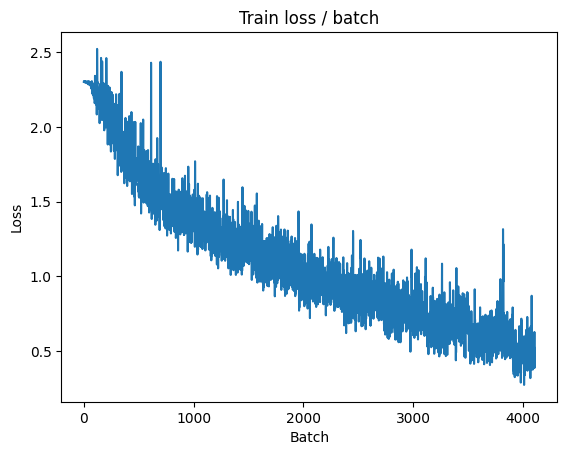


===============> Total time 6s	Avg loss 0.4938	Avg Prec@1 82.76 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 0.8136 (0.8136)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9103	Avg Prec@1 69.93 %	Avg Prec@5 97.38 %



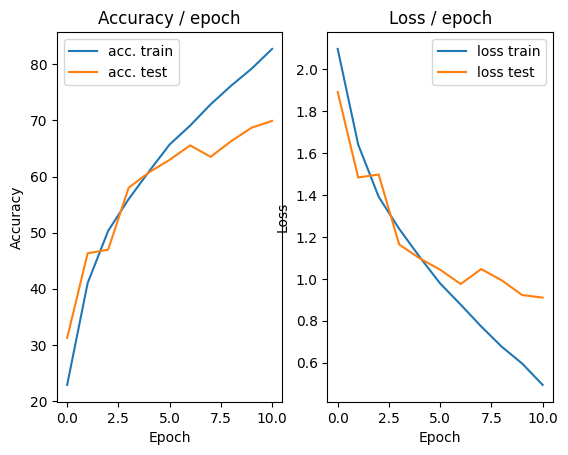

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.101s (0.101s)	Loss 0.3508 (0.3508)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


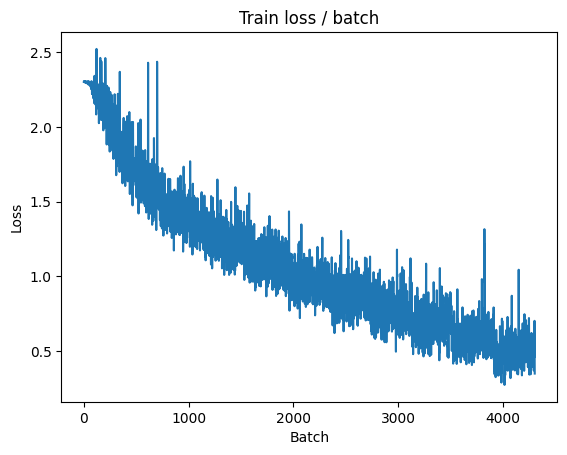

[TRAIN Batch 200/391]	Time 0.030s (0.025s)	Loss 0.5257 (0.3733)	Prec@1  82.0 ( 87.0)	Prec@5 100.0 ( 99.8)


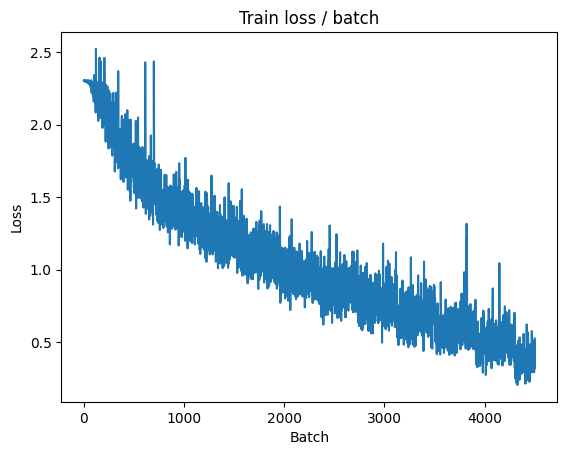


===============> Total time 8s	Avg loss 0.3974	Avg Prec@1 86.17 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 0.9544 (0.9544)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.1071	Avg Prec@1 66.66 %	Avg Prec@5 96.95 %



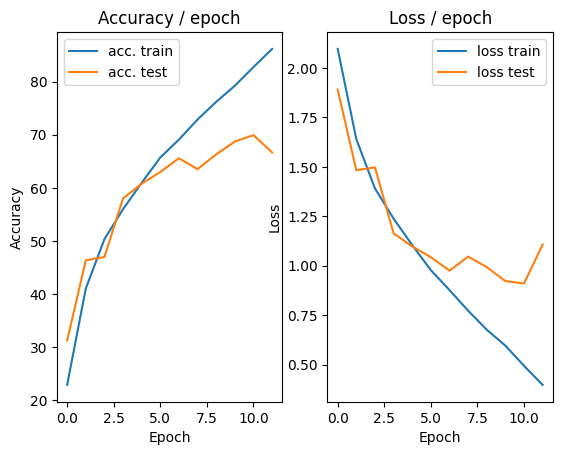

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.088s (0.088s)	Loss 0.2791 (0.2791)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


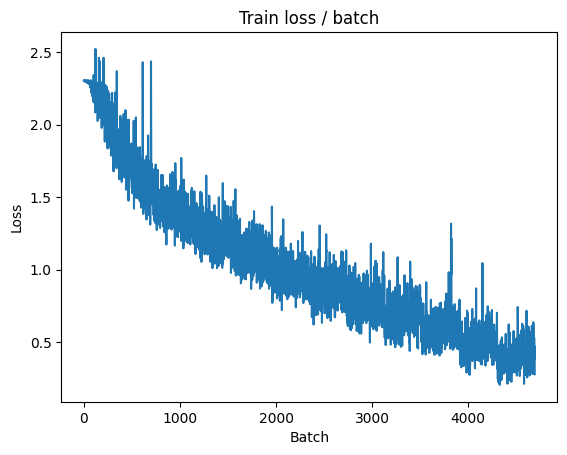

[TRAIN Batch 200/391]	Time 0.009s (0.013s)	Loss 0.3678 (0.2754)	Prec@1  88.3 ( 90.5)	Prec@5 100.0 ( 99.9)


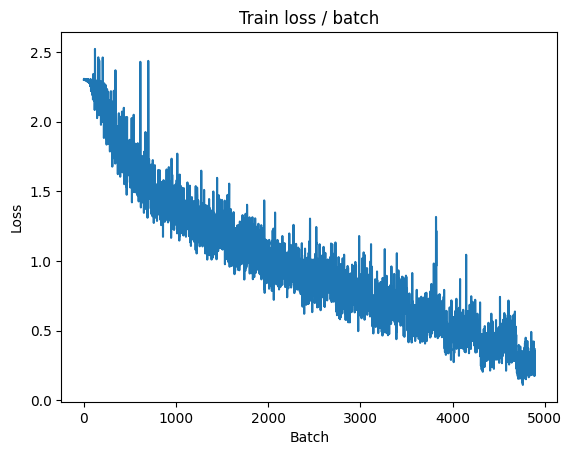


===============> Total time 4s	Avg loss 0.3045	Avg Prec@1 89.52 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.068s (0.068s)	Loss 0.7776 (0.7776)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 0s	Avg loss 1.0435	Avg Prec@1 69.79 %	Avg Prec@5 96.97 %



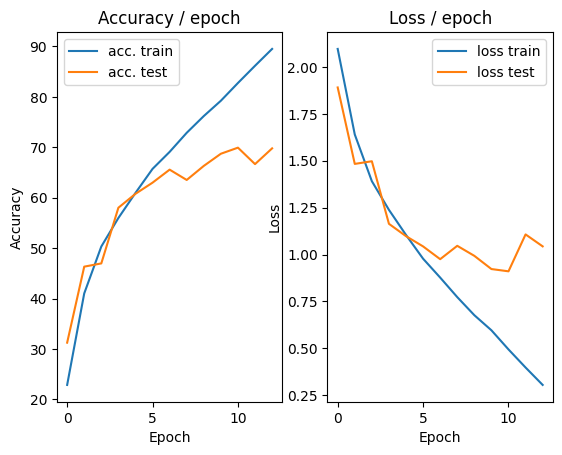

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.089s (0.089s)	Loss 0.1684 (0.1684)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


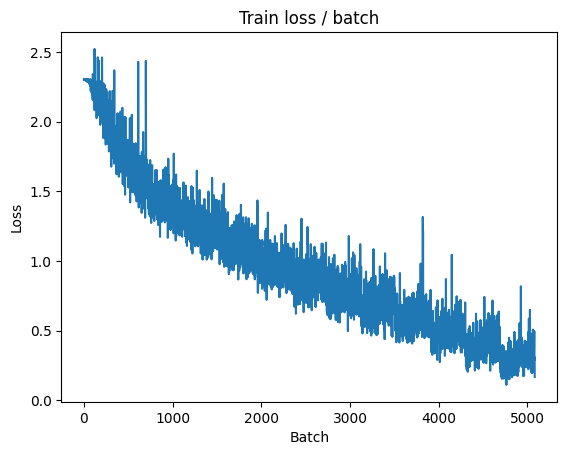

[TRAIN Batch 200/391]	Time 0.005s (0.013s)	Loss 0.2732 (0.2076)	Prec@1  89.8 ( 93.1)	Prec@5 100.0 ( 99.9)


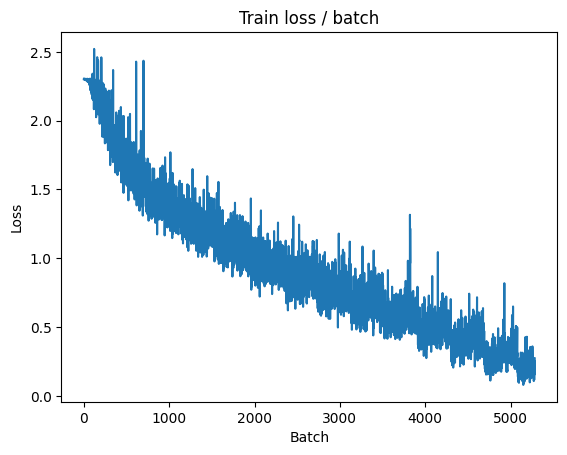


===============> Total time 5s	Avg loss 0.2285	Avg Prec@1 92.20 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 1.1363 (1.1363)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 0s	Avg loss 1.1876	Avg Prec@1 69.85 %	Avg Prec@5 97.21 %



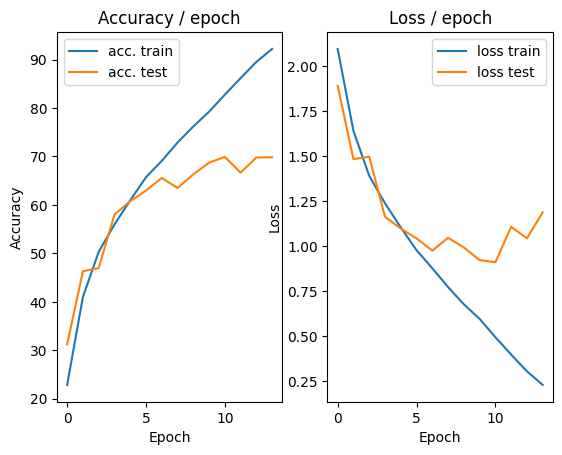

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.105s (0.105s)	Loss 0.2490 (0.2490)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


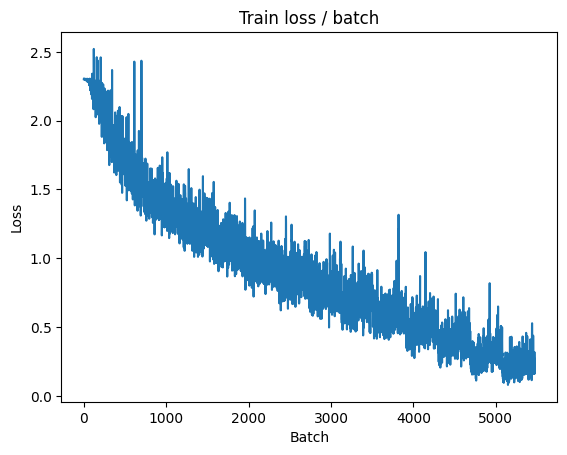

[TRAIN Batch 200/391]	Time 0.007s (0.013s)	Loss 0.1326 (0.1372)	Prec@1  95.3 ( 95.5)	Prec@5 100.0 (100.0)


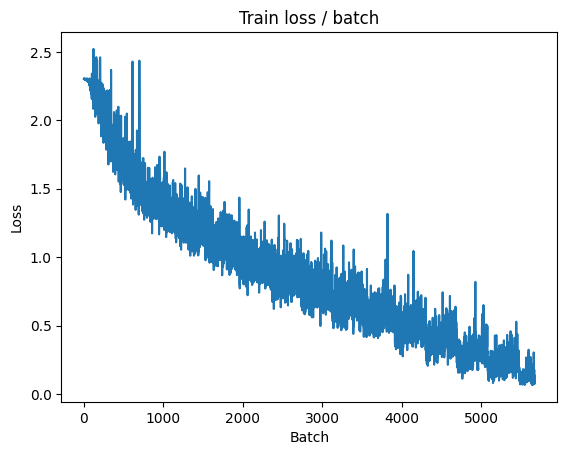


===============> Total time 5s	Avg loss 0.1636	Avg Prec@1 94.53 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 1.0278 (1.0278)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 0s	Avg loss 1.1992	Avg Prec@1 70.16 %	Avg Prec@5 97.07 %



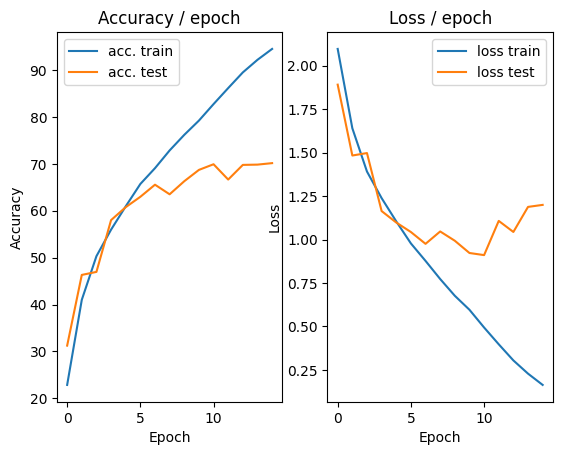

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 0.0782 (0.0782)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


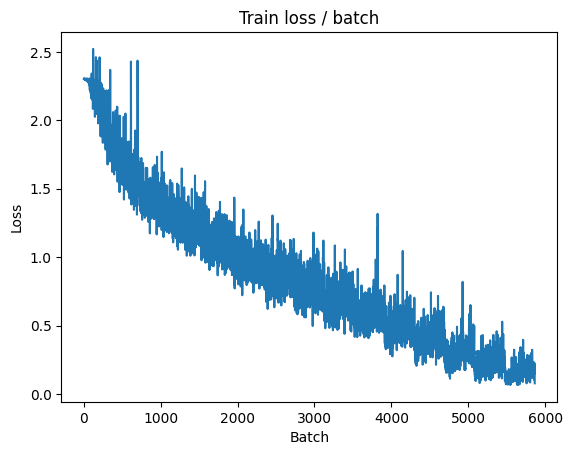

[TRAIN Batch 200/391]	Time 0.011s (0.013s)	Loss 0.0938 (0.0884)	Prec@1  96.9 ( 97.3)	Prec@5 100.0 (100.0)


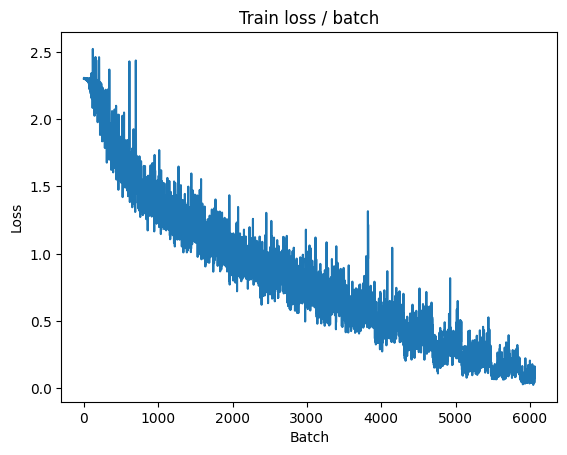


===============> Total time 5s	Avg loss 0.1119	Avg Prec@1 96.46 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 1.1941 (1.1941)	Prec@1  75.0 ( 75.0)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.3666	Avg Prec@1 70.15 %	Avg Prec@5 97.01 %



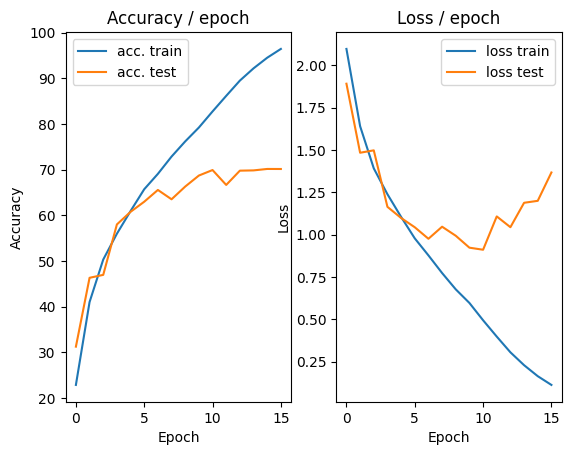

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.0711 (0.0711)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


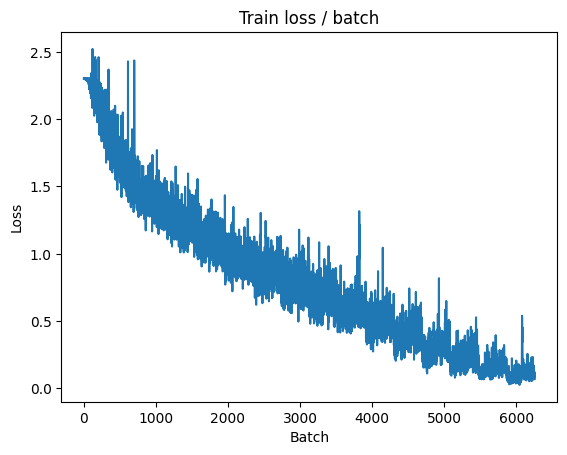

[TRAIN Batch 200/391]	Time 0.010s (0.015s)	Loss 0.0718 (0.0545)	Prec@1  97.7 ( 98.4)	Prec@5 100.0 (100.0)


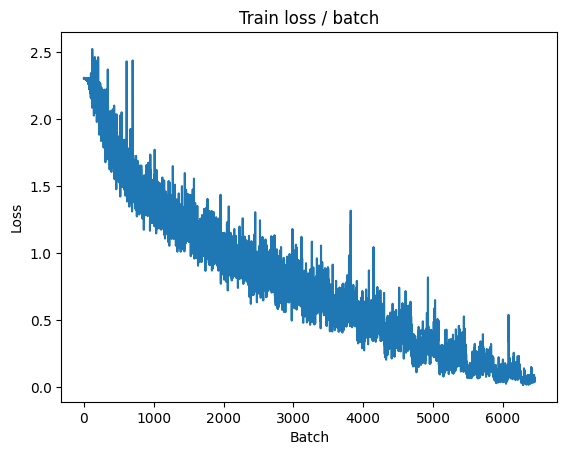


===============> Total time 5s	Avg loss 0.0776	Avg Prec@1 97.59 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 1.3658 (1.3658)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.4113	Avg Prec@1 70.38 %	Avg Prec@5 97.19 %



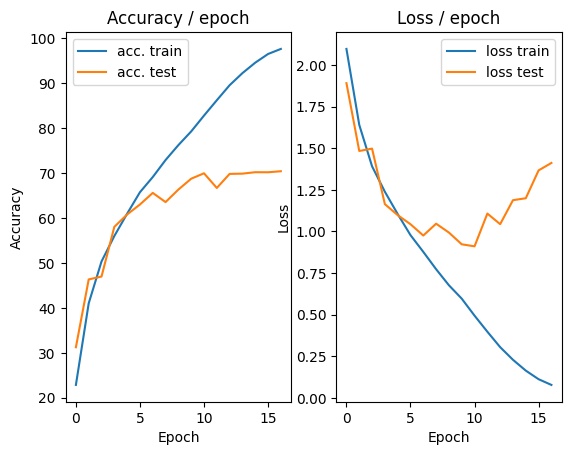

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.0744 (0.0744)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


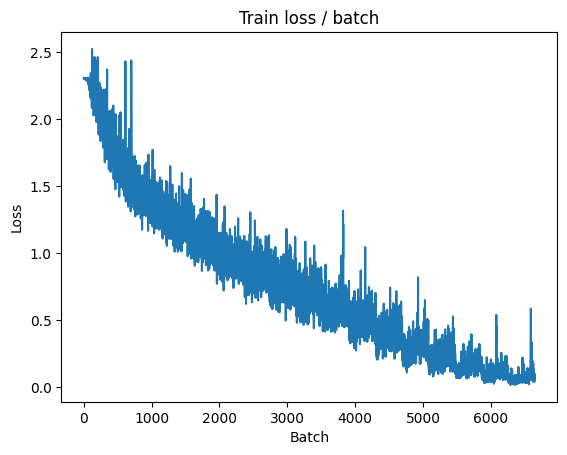

[TRAIN Batch 200/391]	Time 0.013s (0.016s)	Loss 0.0476 (0.0396)	Prec@1  98.4 ( 98.9)	Prec@5 100.0 (100.0)


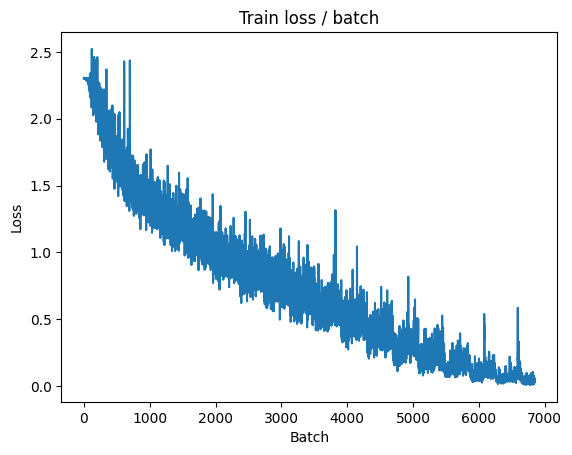


===============> Total time 6s	Avg loss 0.0694	Avg Prec@1 98.00 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 1.3763 (1.3763)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.4551	Avg Prec@1 70.66 %	Avg Prec@5 97.12 %



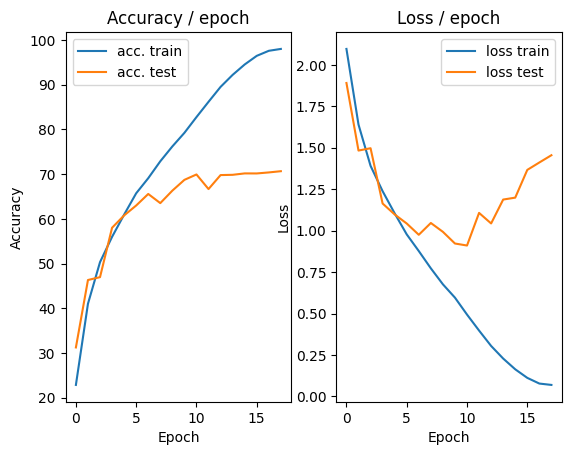

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.105s (0.105s)	Loss 0.0545 (0.0545)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


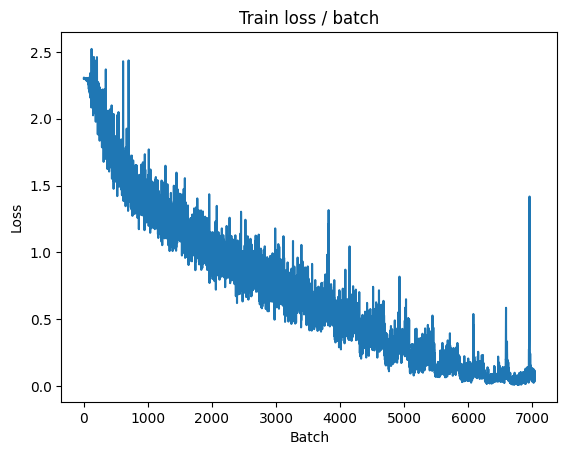

[TRAIN Batch 200/391]	Time 0.009s (0.016s)	Loss 0.0361 (0.0264)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


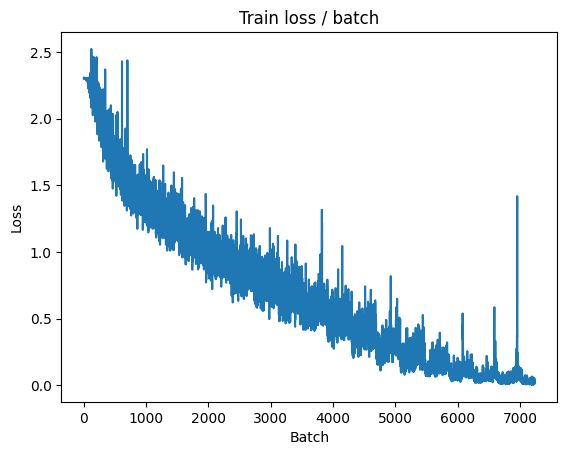


===============> Total time 6s	Avg loss 0.0338	Avg Prec@1 99.04 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 1.4765 (1.4765)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.7029	Avg Prec@1 71.08 %	Avg Prec@5 97.16 %



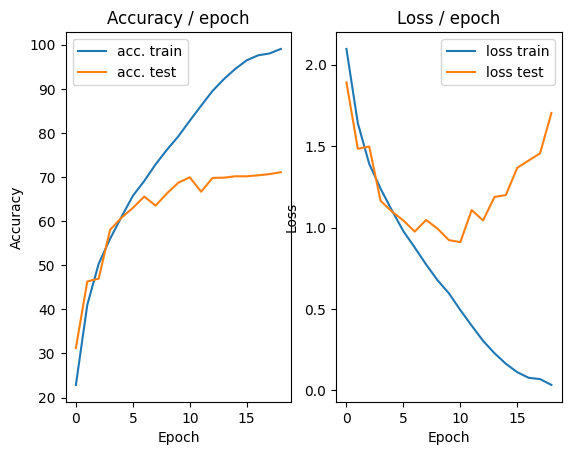

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.090s (0.090s)	Loss 0.0478 (0.0478)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


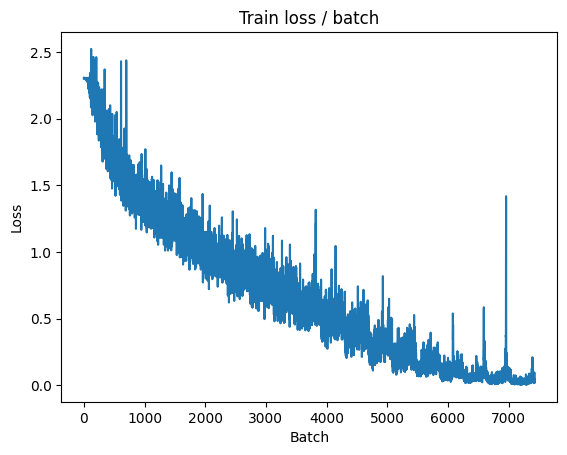

[TRAIN Batch 200/391]	Time 0.016s (0.016s)	Loss 0.0182 (0.0195)	Prec@1  99.2 ( 99.5)	Prec@5 100.0 (100.0)


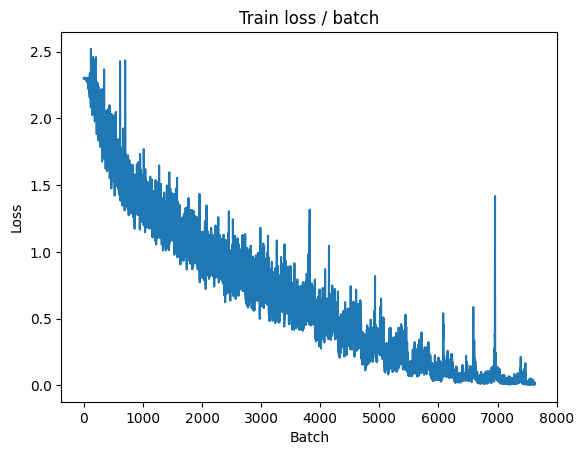


===============> Total time 5s	Avg loss 0.0171	Avg Prec@1 99.60 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 1.4691 (1.4691)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.7216	Avg Prec@1 71.78 %	Avg Prec@5 97.28 %



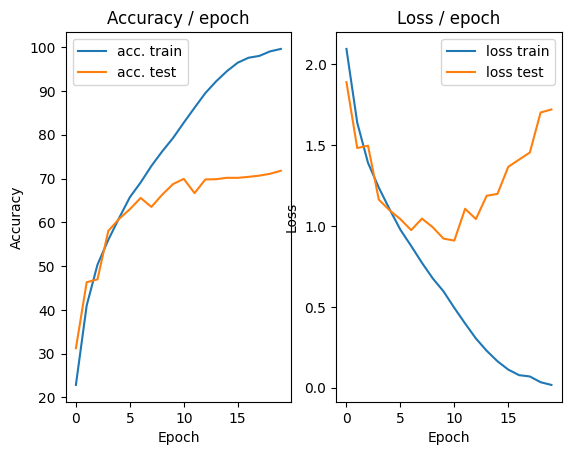

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.101s (0.101s)	Loss 0.0062 (0.0062)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


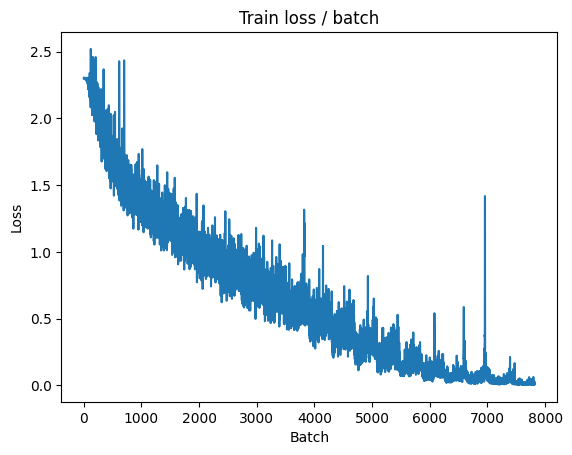

[TRAIN Batch 200/391]	Time 0.015s (0.016s)	Loss 0.0097 (0.0060)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


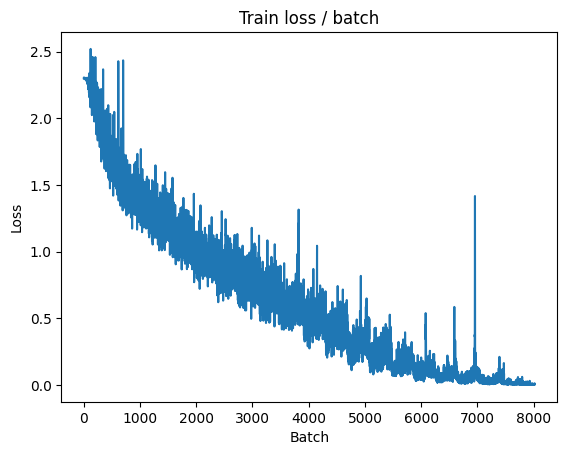


===============> Total time 5s	Avg loss 0.0047	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 1.4476 (1.4476)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.8169	Avg Prec@1 72.50 %	Avg Prec@5 97.34 %



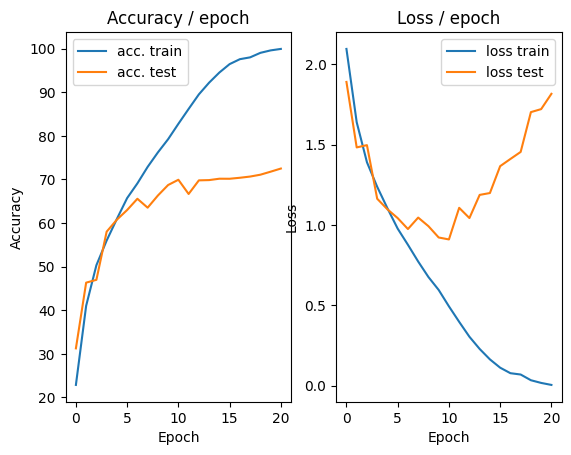

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.088s (0.088s)	Loss 0.0014 (0.0014)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


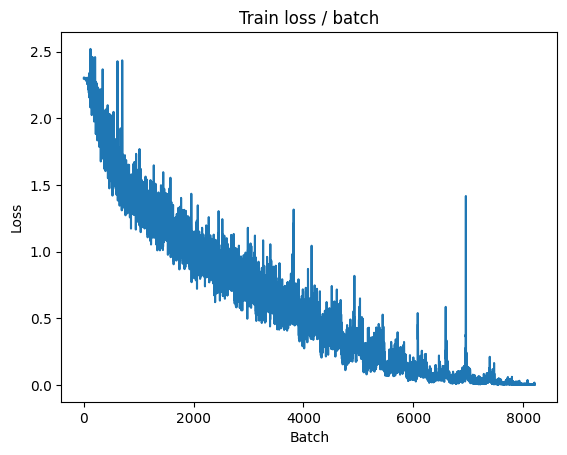

[TRAIN Batch 200/391]	Time 0.023s (0.019s)	Loss 0.0021 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


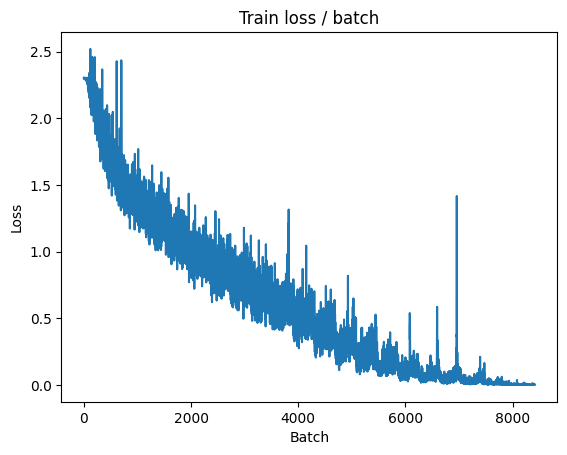


===============> Total time 7s	Avg loss 0.0014	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.5293 (1.5293)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.9059	Avg Prec@1 72.90 %	Avg Prec@5 97.38 %



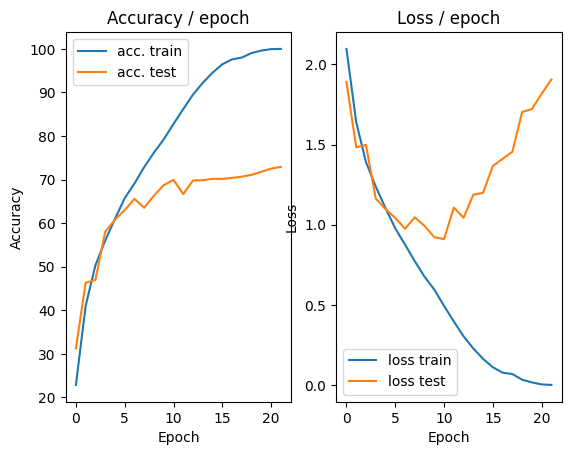

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


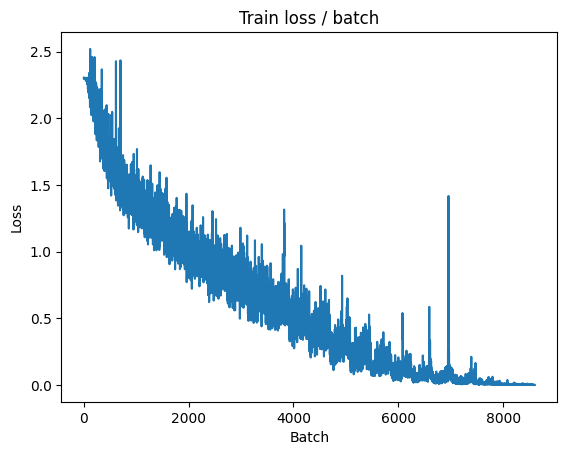

[TRAIN Batch 200/391]	Time 0.027s (0.020s)	Loss 0.0015 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


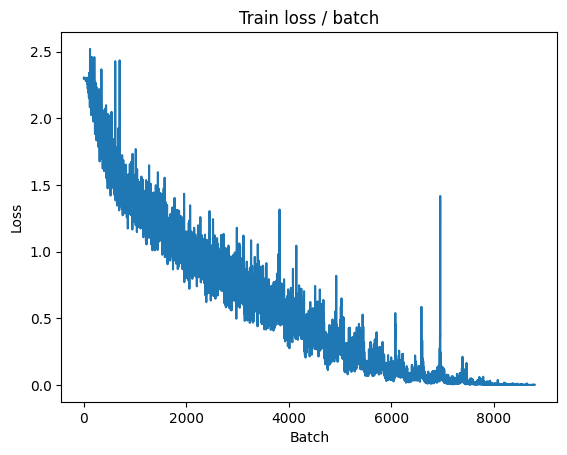


===============> Total time 7s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.5570 (1.5570)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.9523	Avg Prec@1 72.90 %	Avg Prec@5 97.41 %



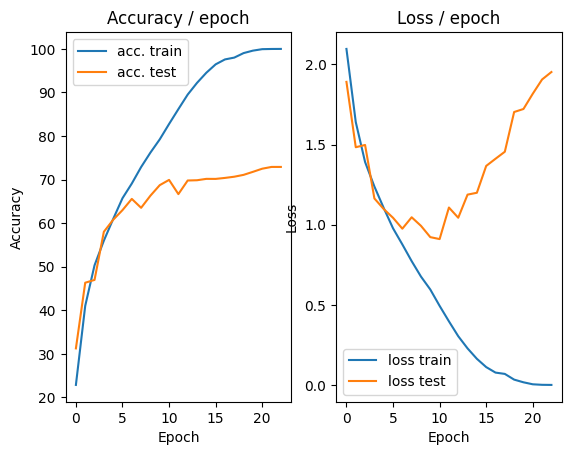

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


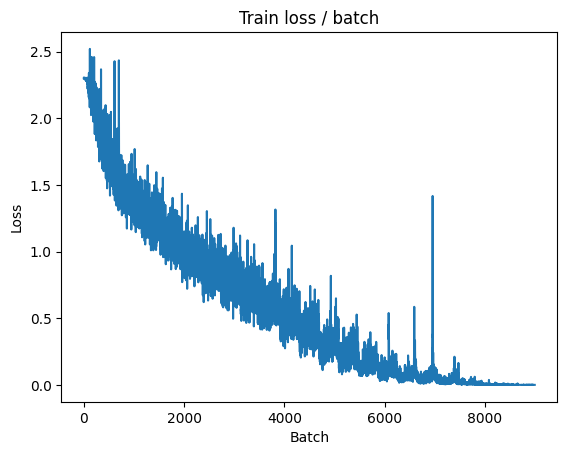

[TRAIN Batch 200/391]	Time 0.014s (0.017s)	Loss 0.0003 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


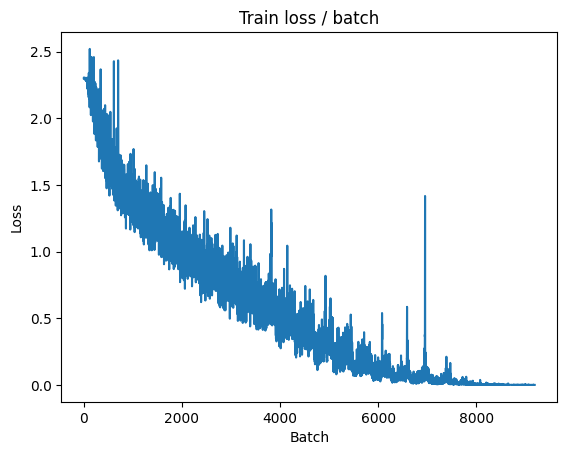


===============> Total time 6s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 1.5913 (1.5913)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.9990	Avg Prec@1 72.93 %	Avg Prec@5 97.40 %



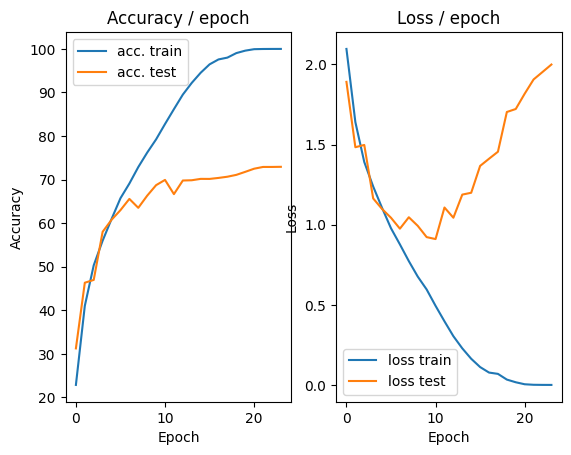

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


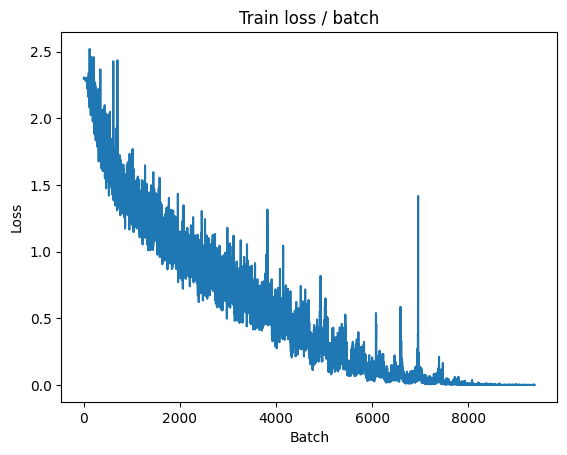

[TRAIN Batch 200/391]	Time 0.011s (0.018s)	Loss 0.0006 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


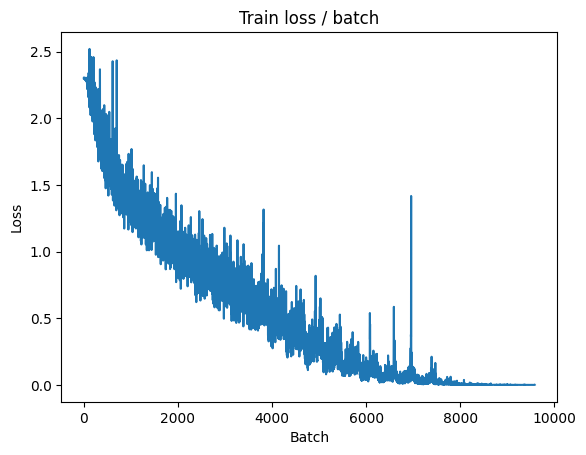


===============> Total time 6s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 1.6261 (1.6261)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.0427	Avg Prec@1 72.84 %	Avg Prec@5 97.37 %



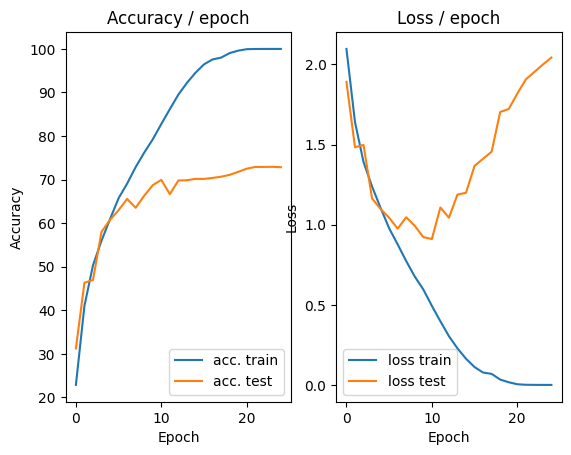

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


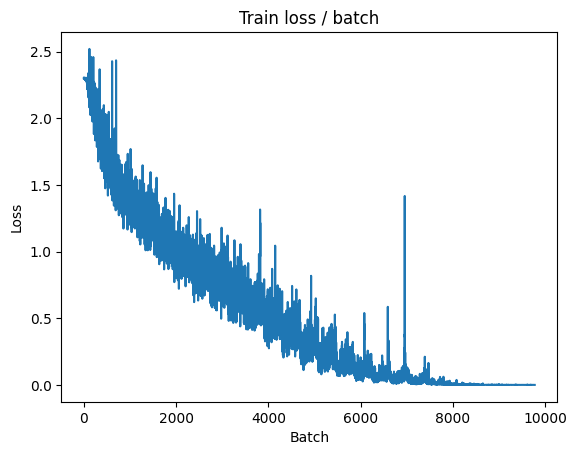

[TRAIN Batch 200/391]	Time 0.020s (0.015s)	Loss 0.0004 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


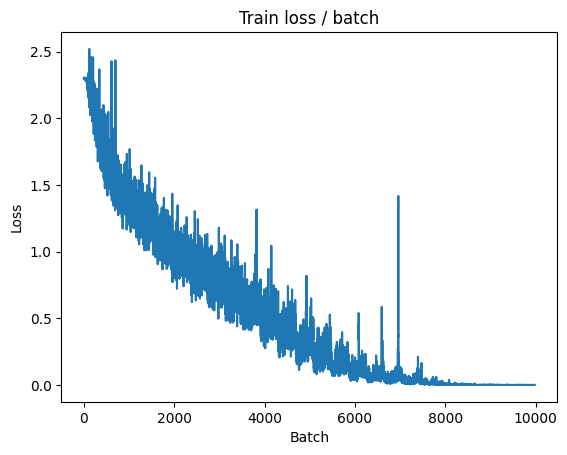


===============> Total time 5s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 1.6374 (1.6374)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.0661	Avg Prec@1 72.83 %	Avg Prec@5 97.37 %



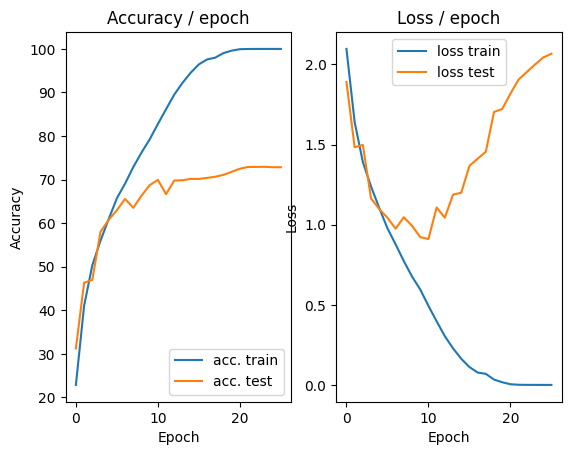

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.087s (0.087s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


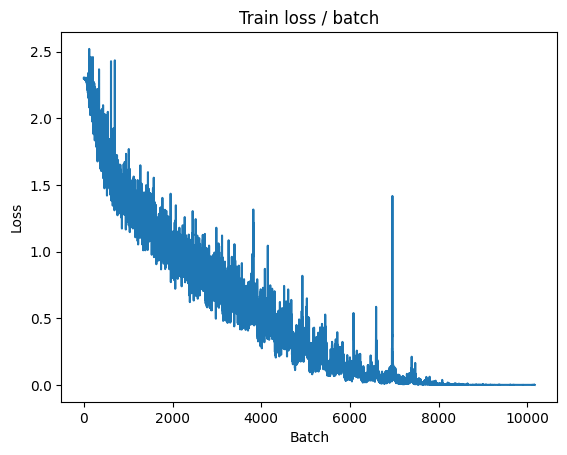

[TRAIN Batch 200/391]	Time 0.020s (0.017s)	Loss 0.0004 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


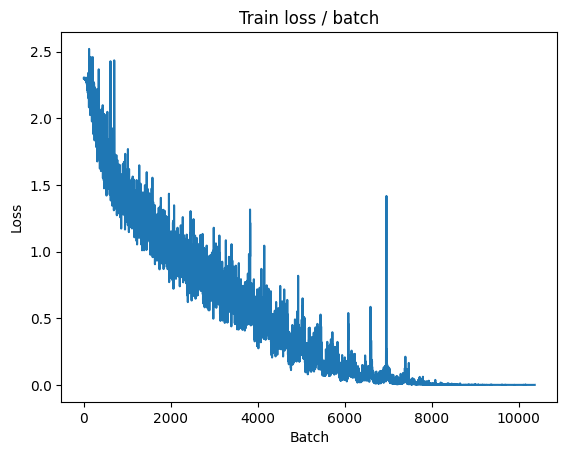


===============> Total time 6s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 1.6547 (1.6547)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.0936	Avg Prec@1 72.82 %	Avg Prec@5 97.37 %



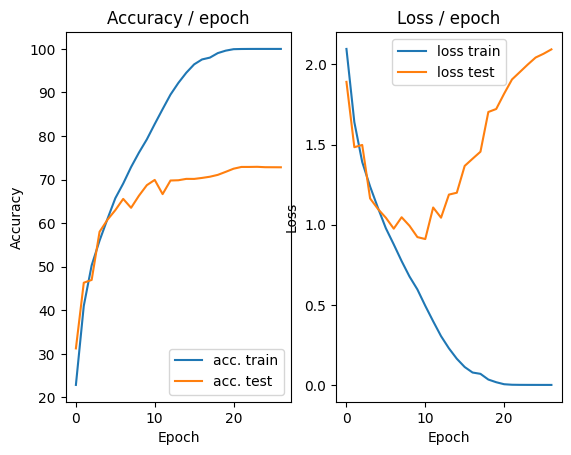

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


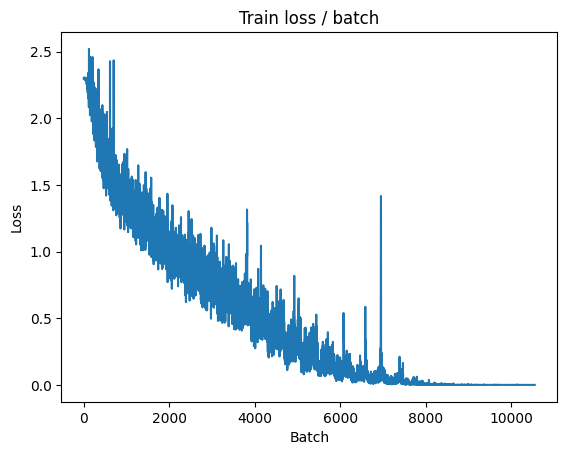

[TRAIN Batch 200/391]	Time 0.007s (0.017s)	Loss 0.0005 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


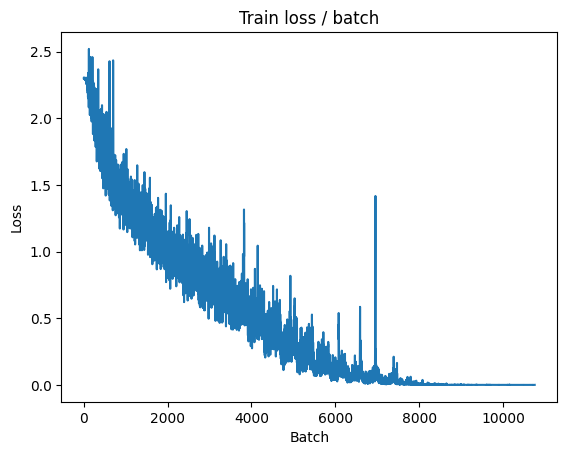


===============> Total time 6s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 1.6804 (1.6804)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1200	Avg Prec@1 72.84 %	Avg Prec@5 97.40 %



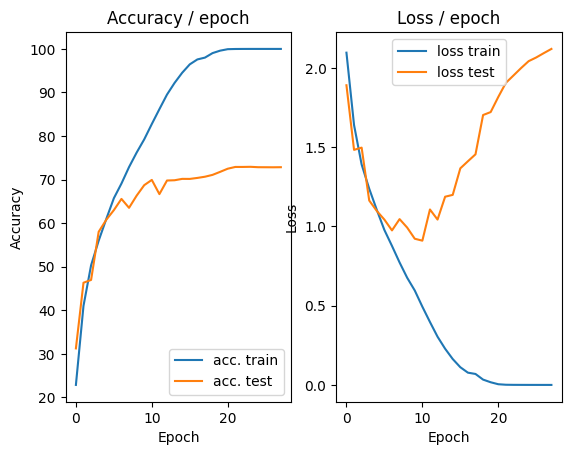

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


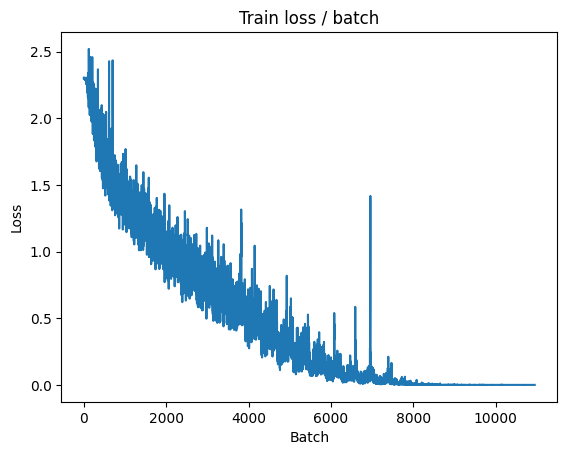

[TRAIN Batch 200/391]	Time 0.009s (0.018s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


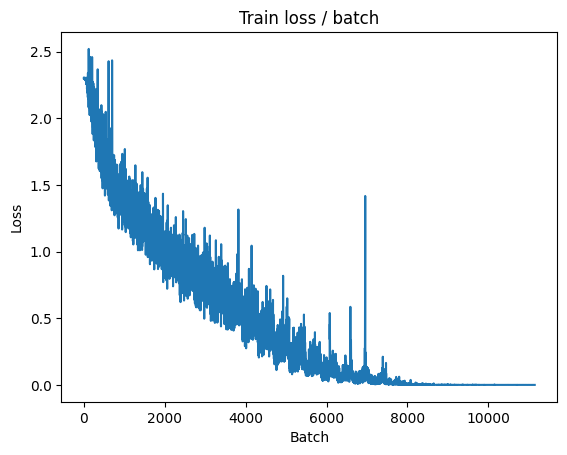


===============> Total time 6s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 1.6940 (1.6940)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1391	Avg Prec@1 72.79 %	Avg Prec@5 97.40 %



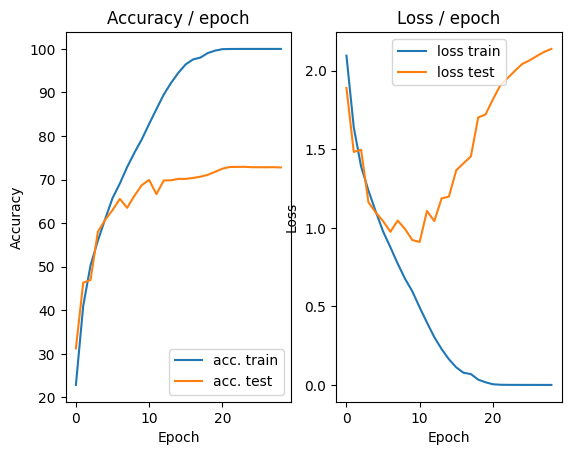

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


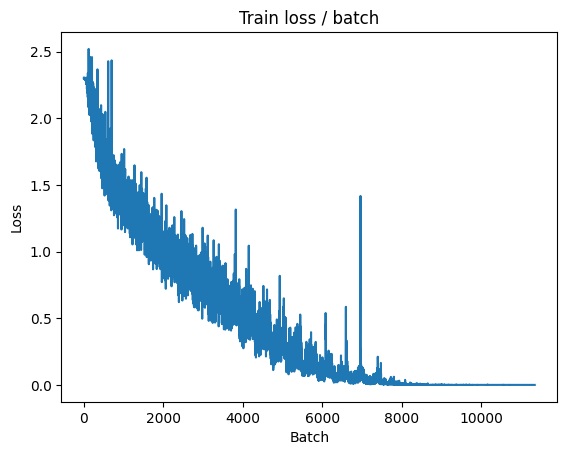

[TRAIN Batch 200/391]	Time 0.006s (0.014s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


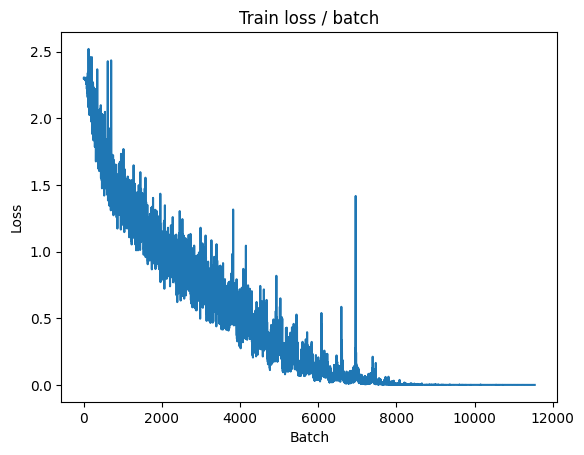


===============> Total time 6s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 1.7140 (1.7140)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1596	Avg Prec@1 72.82 %	Avg Prec@5 97.38 %



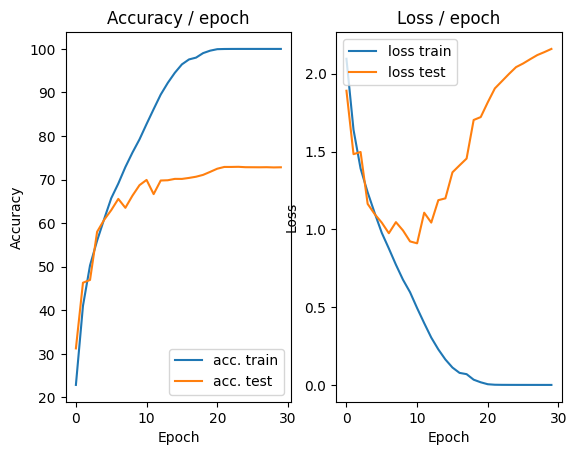

In [5]:
main(128, 0.1, 30, cuda=True)

# Partie 3.1 Standardization of examples

In [6]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    
    mean = [0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]
    # Transformations à appliquer sur les images
    train_transform = transforms.Compose([
        # transforms.RandomHorizontalFlip(),  # Flips aléatoires pour augmenter les données
        # transforms.RandomCrop(32, padding=4),  # Découpage aléatoire
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)  # Normalisation
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Chargement des jeux de données d'entraînement et de validation
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True, transform=val_transform)
    
    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 2.3038 (2.3038)	Prec@1   4.7 (  4.7)	Prec@5  45.3 ( 45.3)


<Figure size 640x480 with 0 Axes>

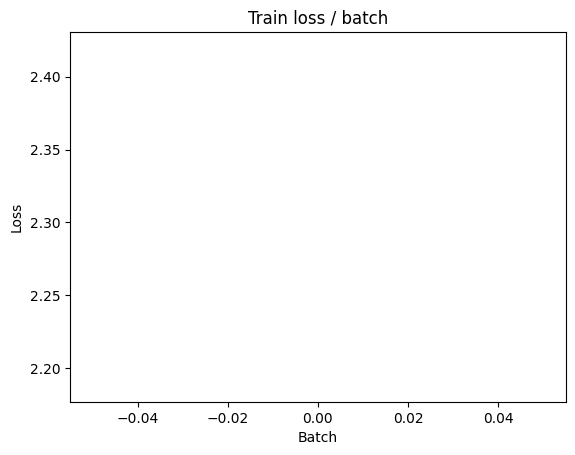

[TRAIN Batch 200/391]	Time 0.015s (0.024s)	Loss 1.8141 (1.9695)	Prec@1  35.9 ( 28.3)	Prec@5  78.9 ( 78.3)


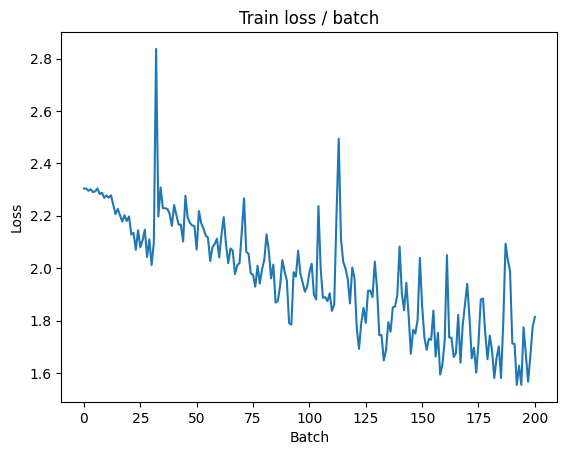


===============> Total time 8s	Avg loss 1.7630	Avg Prec@1 35.96 %	Avg Prec@5 84.41 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 1.6031 (1.6031)	Prec@1  35.9 ( 35.9)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.6233	Avg Prec@1 39.88 %	Avg Prec@5 90.59 %



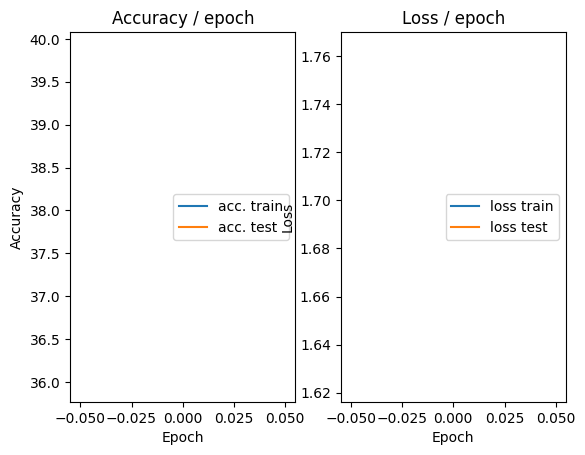

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.088s (0.088s)	Loss 1.5995 (1.5995)	Prec@1  44.5 ( 44.5)	Prec@5  92.2 ( 92.2)


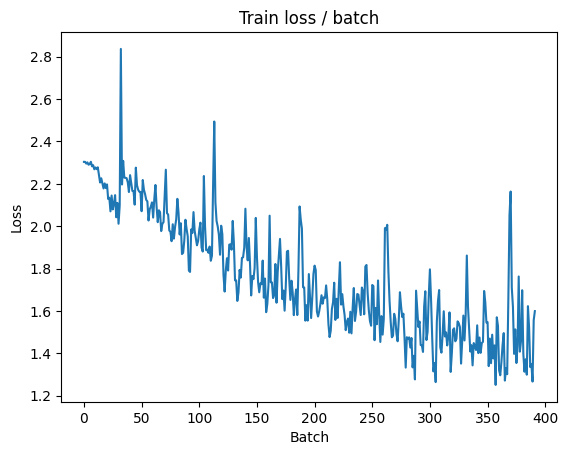

[TRAIN Batch 200/391]	Time 0.109s (0.054s)	Loss 1.2244 (1.3390)	Prec@1  52.3 ( 52.4)	Prec@5  96.9 ( 93.7)


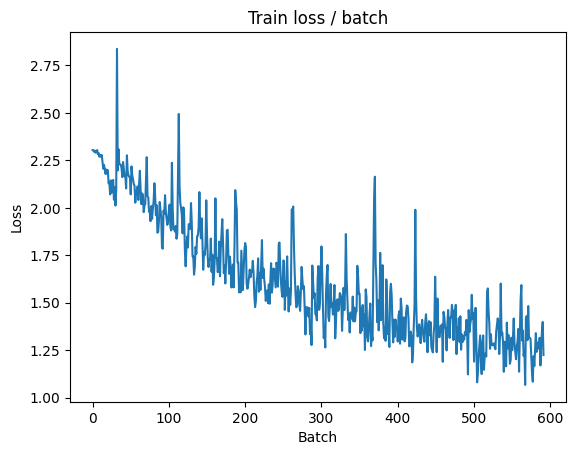


===============> Total time 21s	Avg loss 1.2781	Avg Prec@1 54.68 %	Avg Prec@5 94.41 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 1.1274 (1.1274)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.2107	Avg Prec@1 57.23 %	Avg Prec@5 95.63 %



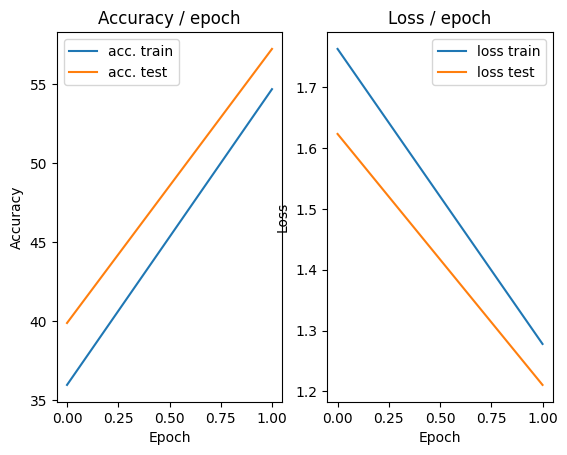

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.3193 (1.3193)	Prec@1  56.2 ( 56.2)	Prec@5  97.7 ( 97.7)


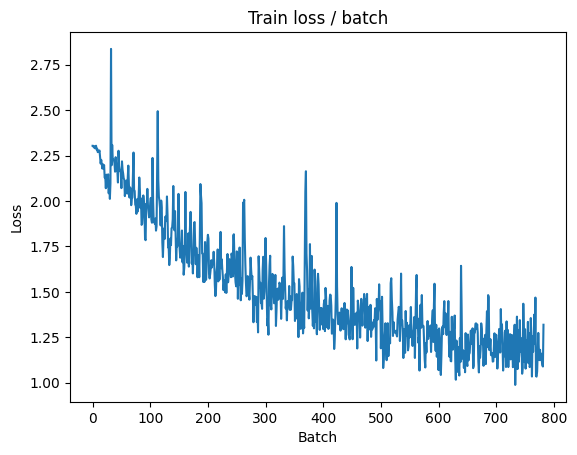

[TRAIN Batch 200/391]	Time 0.034s (0.029s)	Loss 0.9359 (1.0760)	Prec@1  66.4 ( 62.0)	Prec@5  96.1 ( 96.5)


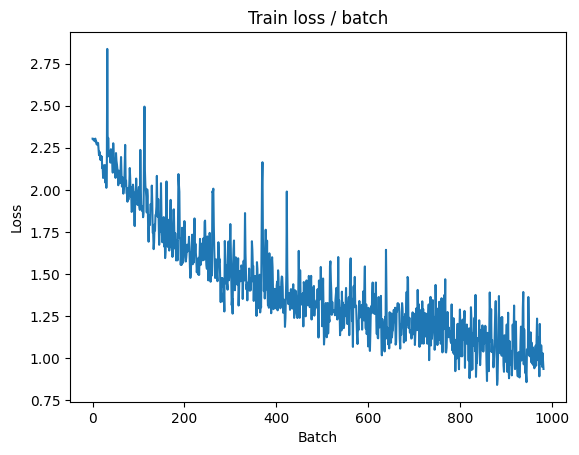


===============> Total time 10s	Avg loss 1.0400	Avg Prec@1 63.40 %	Avg Prec@5 96.59 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.9534 (0.9534)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.1100	Avg Prec@1 61.38 %	Avg Prec@5 95.89 %



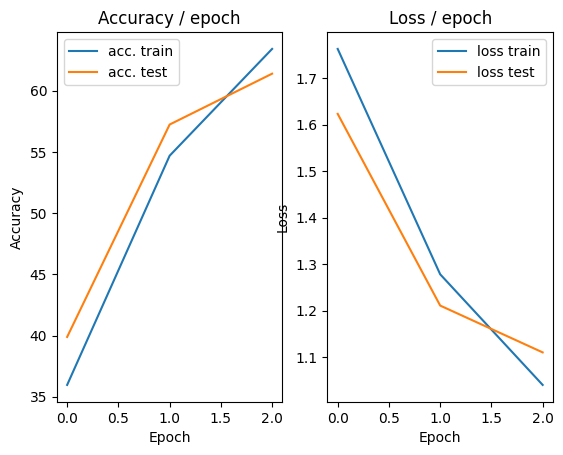

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.110s (0.110s)	Loss 1.0868 (1.0868)	Prec@1  60.2 ( 60.2)	Prec@5  95.3 ( 95.3)


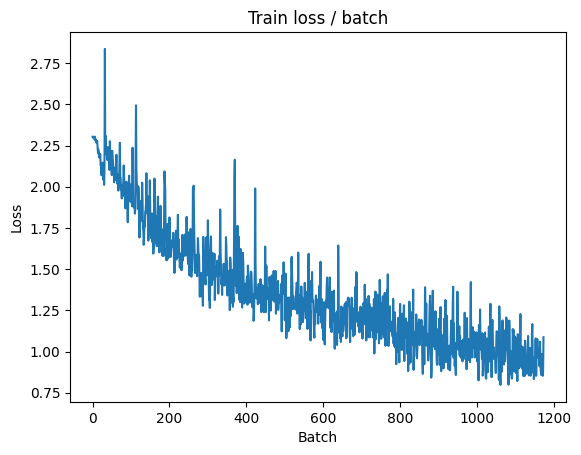

[TRAIN Batch 200/391]	Time 0.014s (0.024s)	Loss 0.8271 (0.8778)	Prec@1  75.8 ( 69.3)	Prec@5  95.3 ( 97.6)


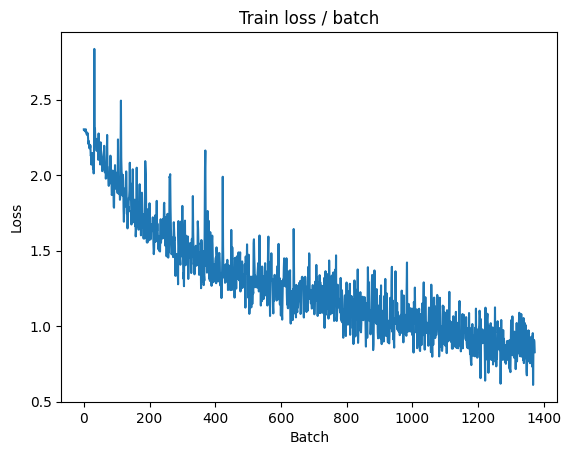


===============> Total time 8s	Avg loss 0.8599	Avg Prec@1 70.03 %	Avg Prec@5 97.71 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.8433 (0.8433)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8857	Avg Prec@1 69.74 %	Avg Prec@5 97.15 %



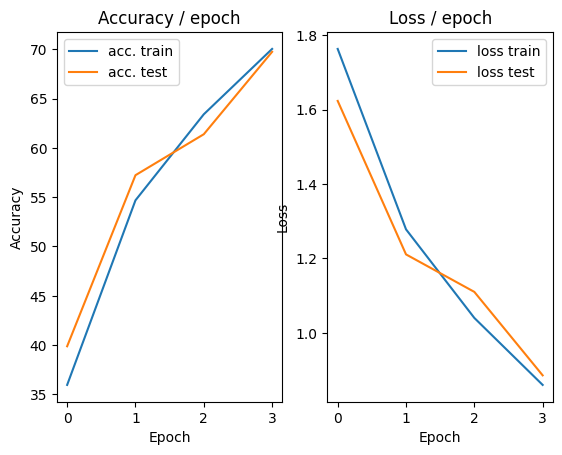

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.8334 (0.8334)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)


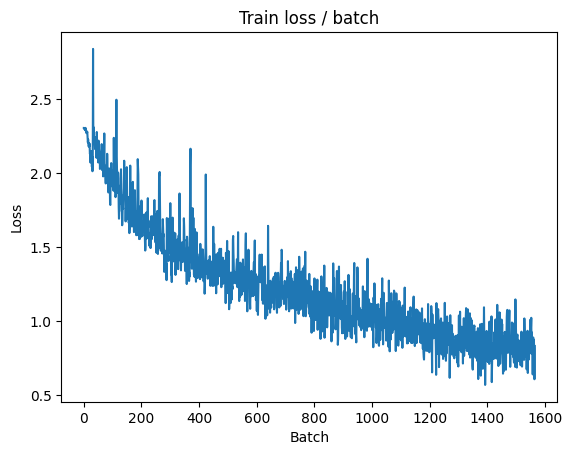

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.7393 (0.7248)	Prec@1  75.0 ( 74.7)	Prec@5  98.4 ( 98.3)


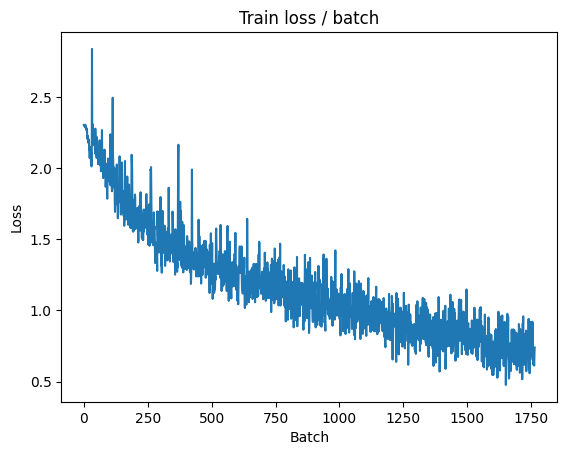


===============> Total time 7s	Avg loss 0.7212	Avg Prec@1 74.76 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.070s (0.070s)	Loss 0.8109 (0.8109)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8417	Avg Prec@1 71.42 %	Avg Prec@5 97.78 %



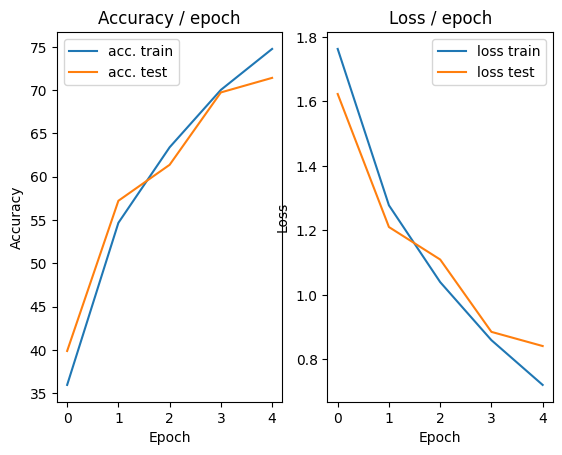

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.085s (0.085s)	Loss 0.6684 (0.6684)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)


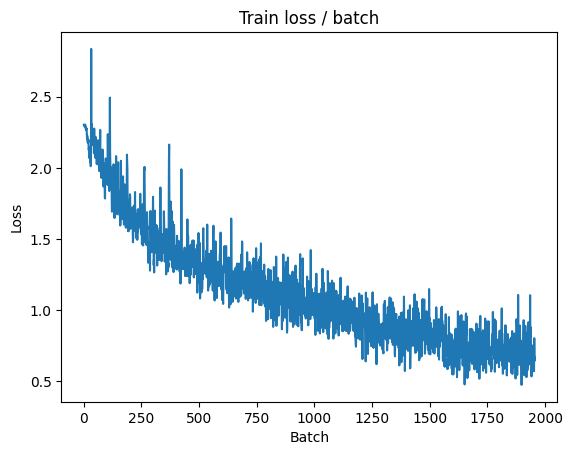

[TRAIN Batch 200/391]	Time 0.025s (0.021s)	Loss 0.6601 (0.5966)	Prec@1  76.6 ( 79.1)	Prec@5  99.2 ( 99.0)


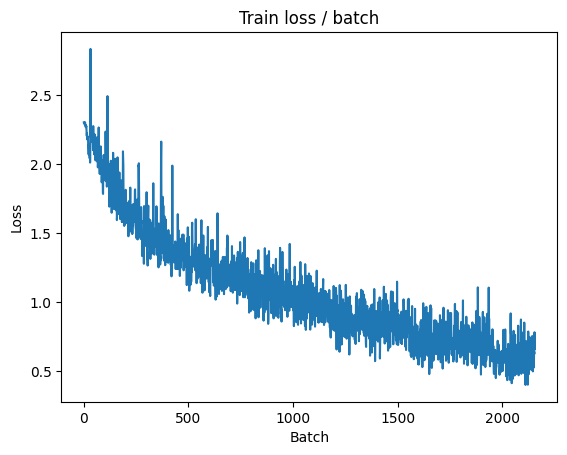


===============> Total time 8s	Avg loss 0.6020	Avg Prec@1 79.02 %	Avg Prec@5 99.00 %

[EVAL Batch 000/079]	Time 0.071s (0.071s)	Loss 0.8374 (0.8374)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8455	Avg Prec@1 70.82 %	Avg Prec@5 97.70 %



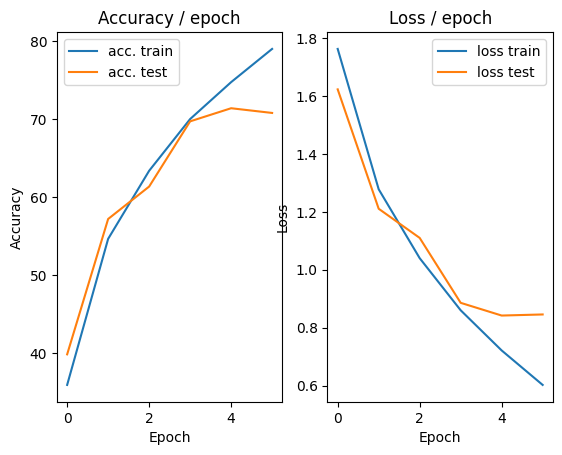

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.086s (0.086s)	Loss 0.5643 (0.5643)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


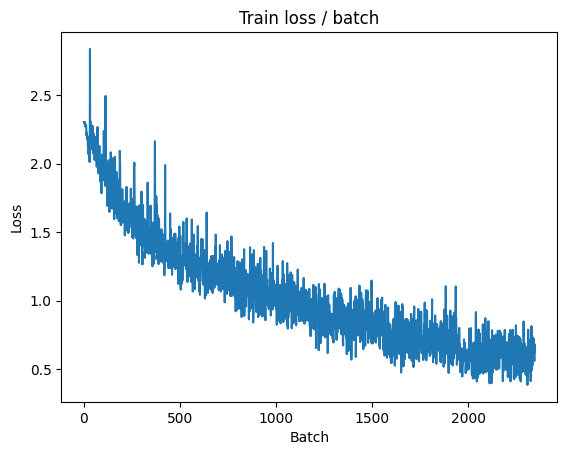

[TRAIN Batch 200/391]	Time 0.035s (0.021s)	Loss 0.4715 (0.4883)	Prec@1  78.9 ( 82.9)	Prec@5 100.0 ( 99.4)


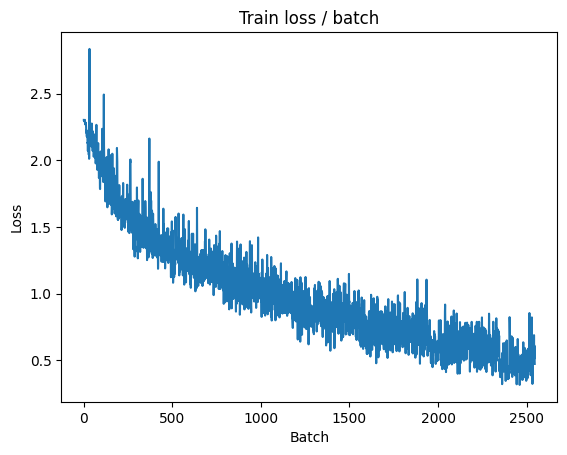


===============> Total time 8s	Avg loss 0.4935	Avg Prec@1 82.64 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.8298 (0.8298)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8107	Avg Prec@1 73.19 %	Avg Prec@5 98.04 %



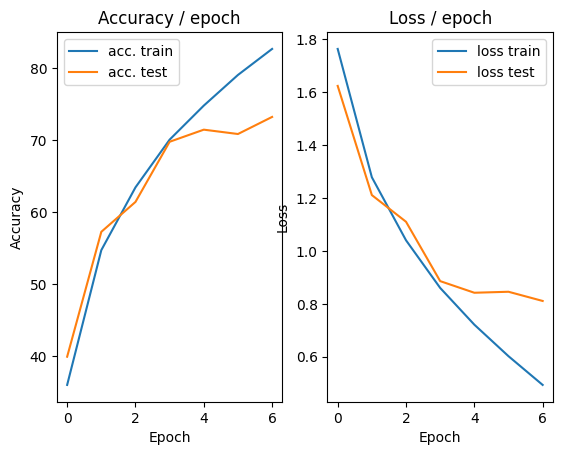

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.086s (0.086s)	Loss 0.3228 (0.3228)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


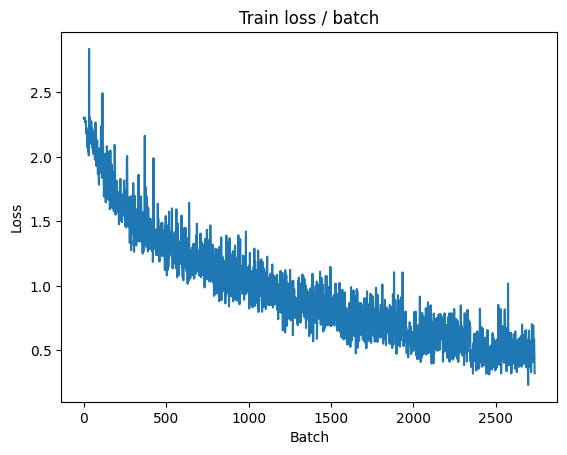

[TRAIN Batch 200/391]	Time 0.007s (0.023s)	Loss 0.3321 (0.3691)	Prec@1  89.1 ( 87.1)	Prec@5  99.2 ( 99.8)


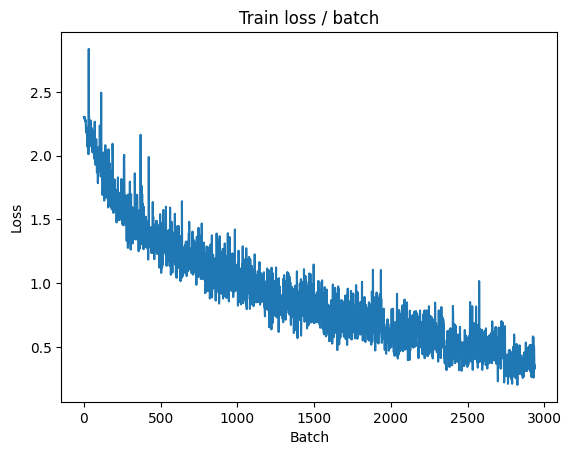


===============> Total time 8s	Avg loss 0.3886	Avg Prec@1 86.35 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.9323 (0.9323)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9701	Avg Prec@1 70.10 %	Avg Prec@5 97.32 %



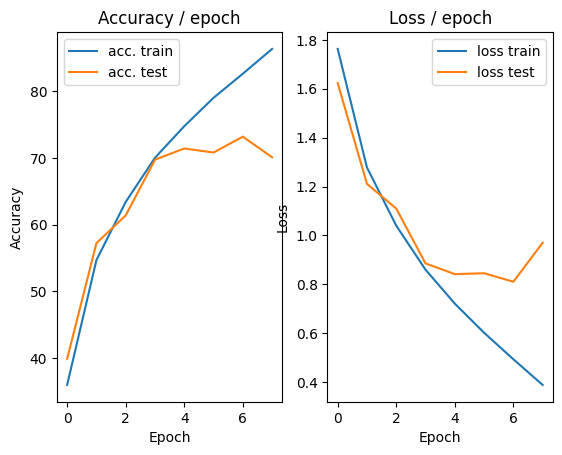

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.4091 (0.4091)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


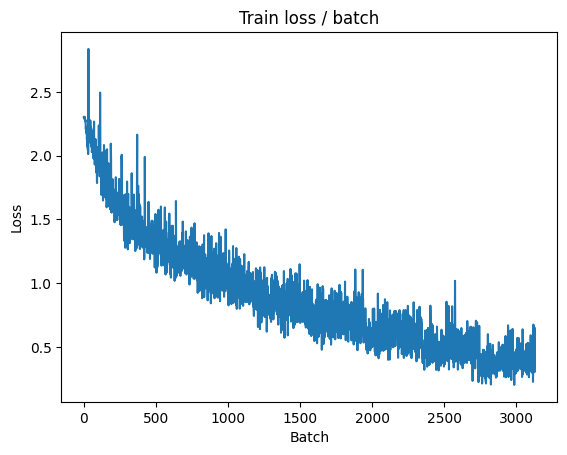

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 0.4419 (0.2693)	Prec@1  89.1 ( 90.8)	Prec@5 100.0 ( 99.9)


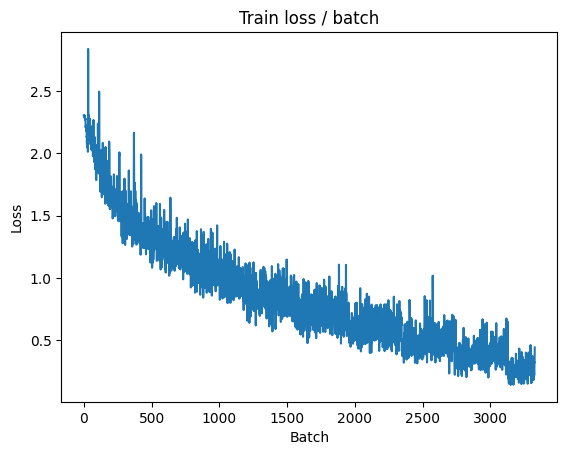


===============> Total time 7s	Avg loss 0.2948	Avg Prec@1 89.72 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.8944 (0.8944)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9199	Avg Prec@1 73.95 %	Avg Prec@5 97.85 %



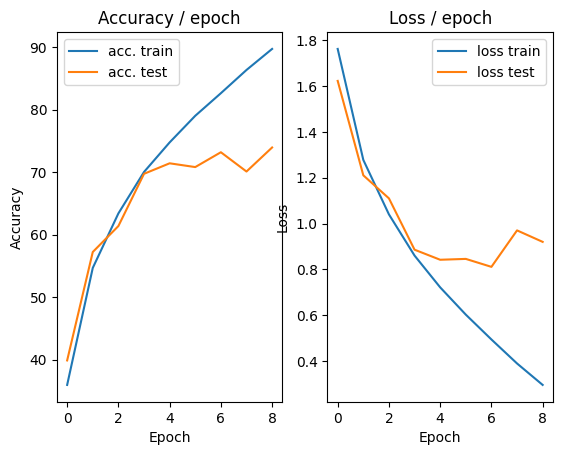

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.084s (0.084s)	Loss 0.2201 (0.2201)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


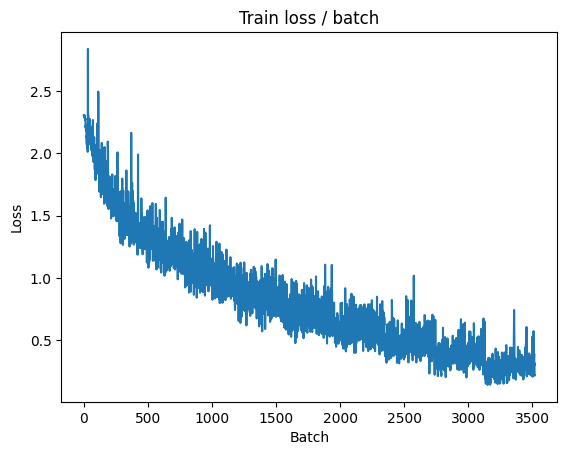

[TRAIN Batch 200/391]	Time 0.009s (0.019s)	Loss 0.1570 (0.1740)	Prec@1  96.9 ( 94.2)	Prec@5 100.0 (100.0)


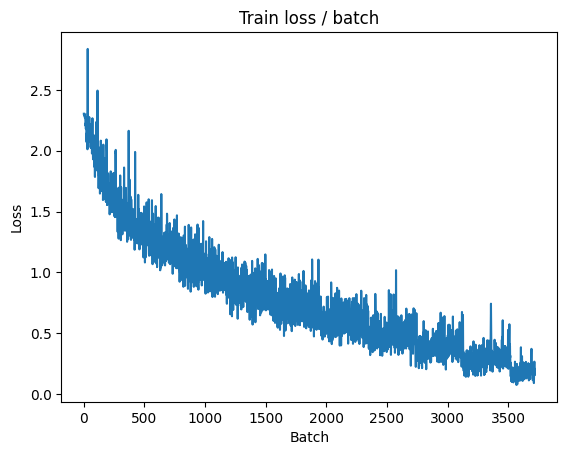


===============> Total time 7s	Avg loss 0.2005	Avg Prec@1 93.12 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 1.1774 (1.1774)	Prec@1  78.9 ( 78.9)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1135	Avg Prec@1 71.36 %	Avg Prec@5 97.42 %



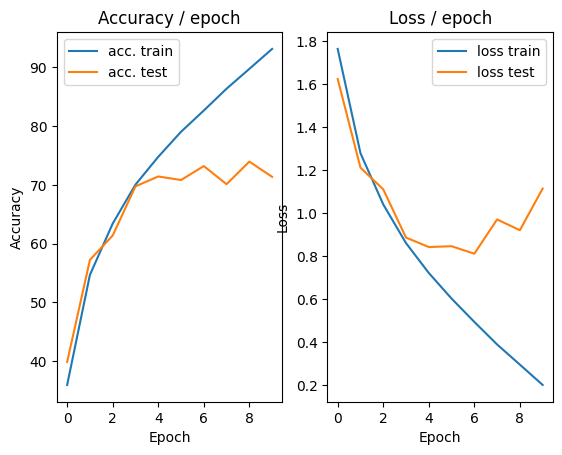

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.086s (0.086s)	Loss 0.2162 (0.2162)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


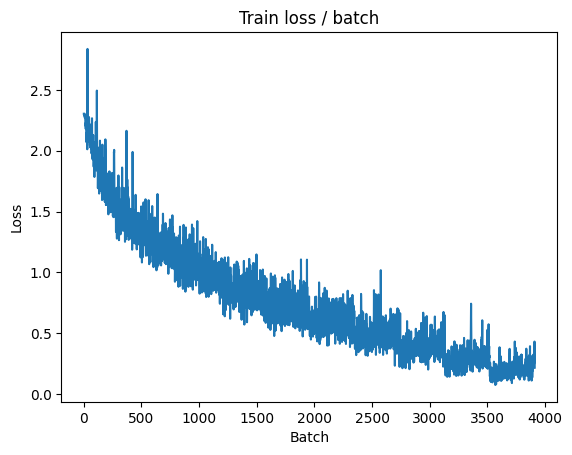

[TRAIN Batch 200/391]	Time 0.013s (0.019s)	Loss 0.1303 (0.1245)	Prec@1  94.5 ( 95.8)	Prec@5 100.0 (100.0)


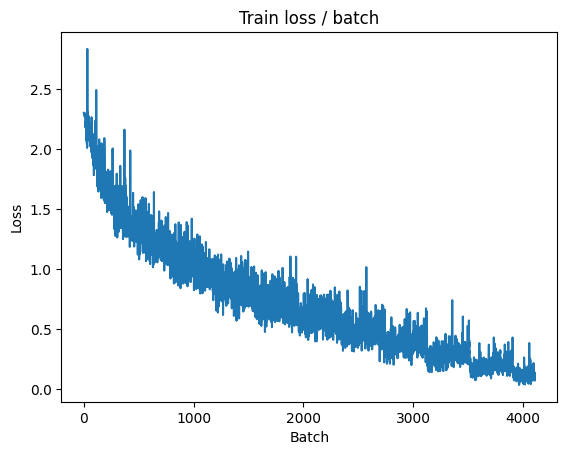


===============> Total time 7s	Avg loss 0.1500	Avg Prec@1 94.79 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 1.0255 (1.0255)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.3399	Avg Prec@1 70.99 %	Avg Prec@5 96.91 %



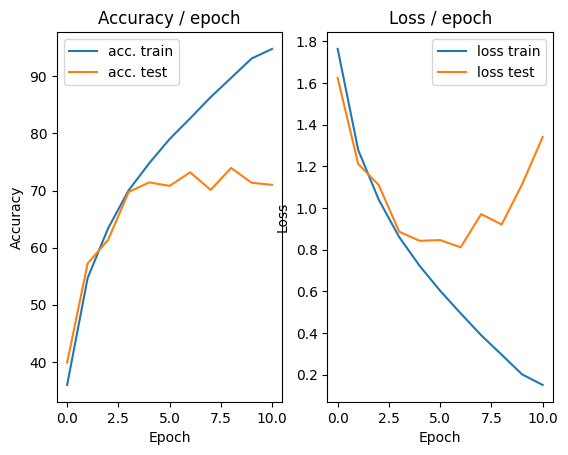

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.091s (0.091s)	Loss 0.2059 (0.2059)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


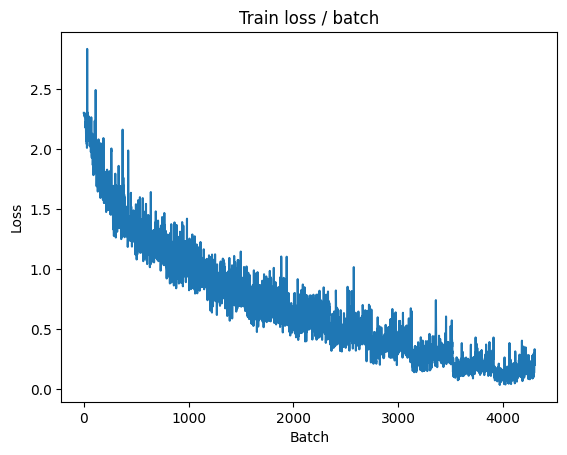

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 0.0974 (0.1001)	Prec@1  96.9 ( 96.8)	Prec@5 100.0 (100.0)


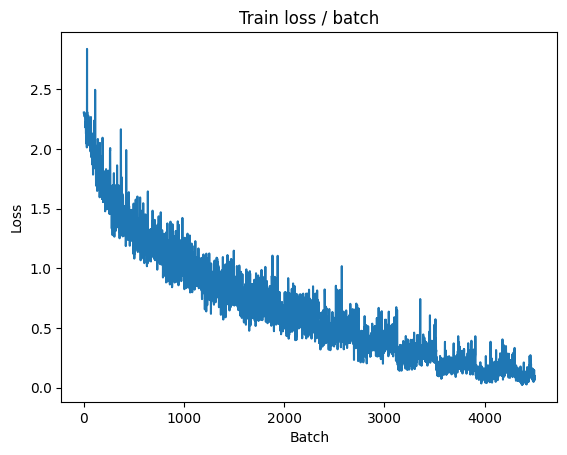


===============> Total time 8s	Avg loss 0.1264	Avg Prec@1 95.80 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 1.0225 (1.0225)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.1776	Avg Prec@1 73.32 %	Avg Prec@5 97.86 %



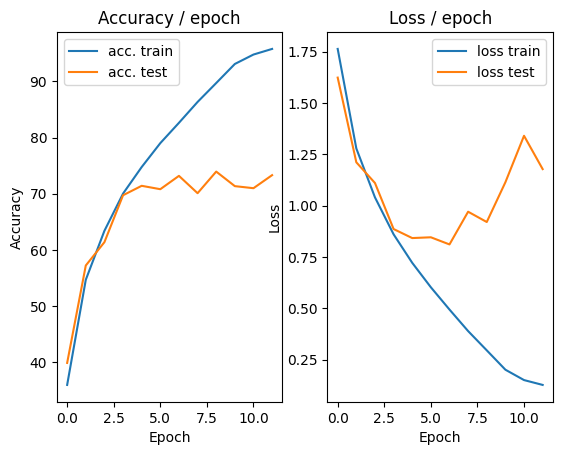

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.110s (0.110s)	Loss 0.0692 (0.0692)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


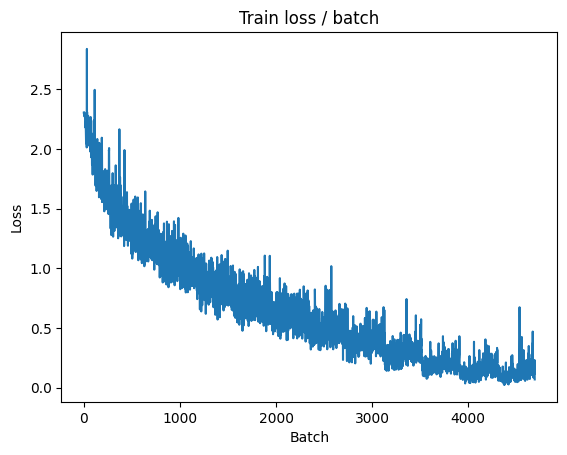

[TRAIN Batch 200/391]	Time 0.021s (0.022s)	Loss 0.1200 (0.0713)	Prec@1  96.1 ( 97.8)	Prec@5 100.0 (100.0)


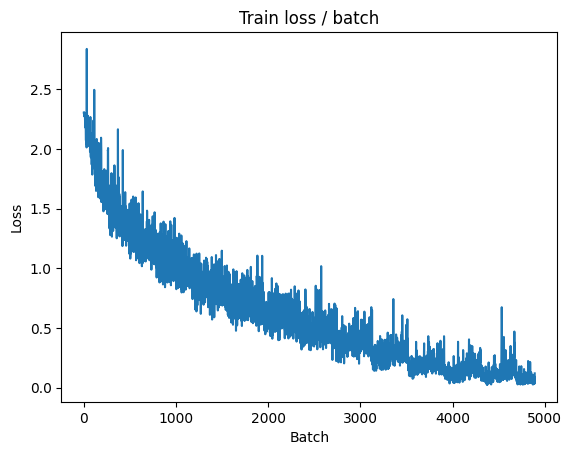


===============> Total time 9s	Avg loss 0.0876	Avg Prec@1 97.10 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 1.5857 (1.5857)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.3732	Avg Prec@1 73.29 %	Avg Prec@5 97.68 %



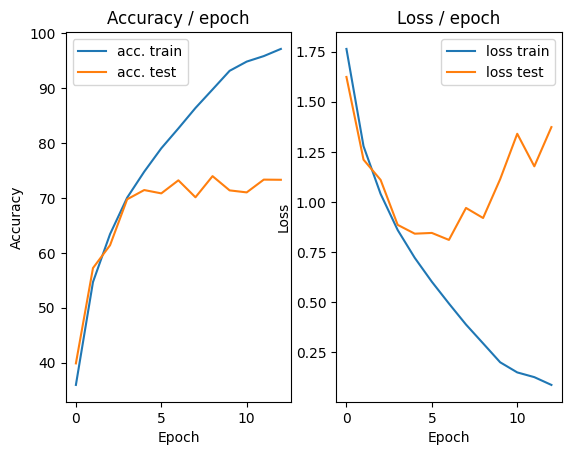

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.097s (0.097s)	Loss 0.1153 (0.1153)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


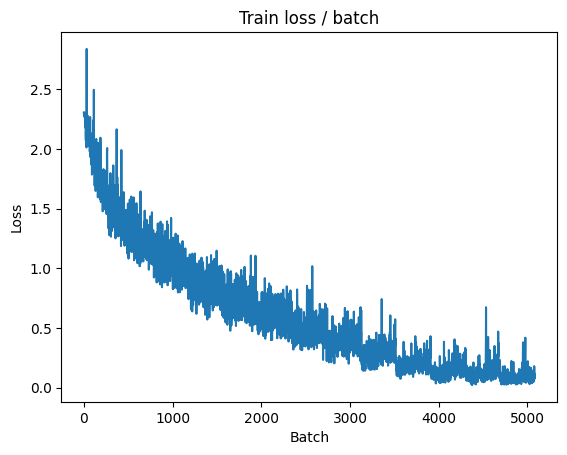

[TRAIN Batch 200/391]	Time 0.026s (0.021s)	Loss 0.0656 (0.0485)	Prec@1  96.9 ( 98.5)	Prec@5 100.0 (100.0)


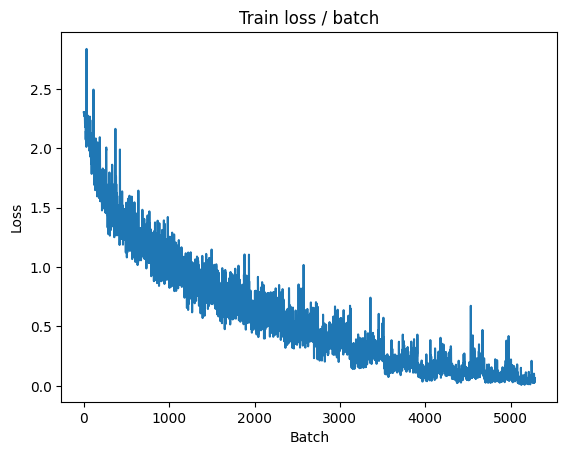


===============> Total time 7s	Avg loss 0.0641	Avg Prec@1 97.89 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 1.4385 (1.4385)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.5334	Avg Prec@1 71.33 %	Avg Prec@5 97.48 %



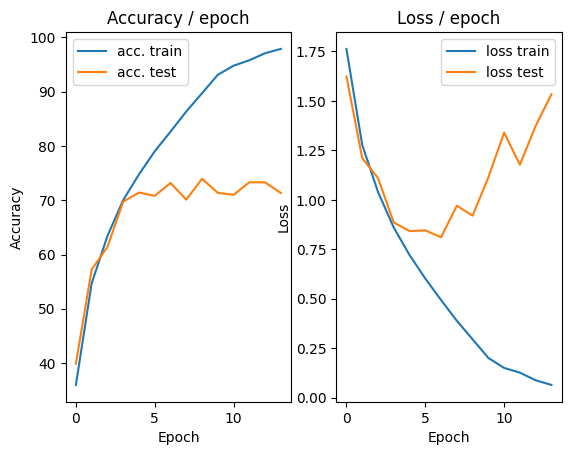

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.085s (0.085s)	Loss 0.2242 (0.2242)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


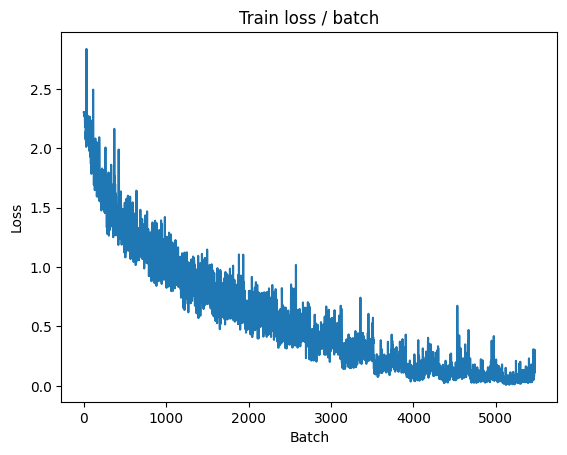

[TRAIN Batch 200/391]	Time 0.008s (0.019s)	Loss 0.0569 (0.0775)	Prec@1  99.2 ( 97.6)	Prec@5 100.0 (100.0)


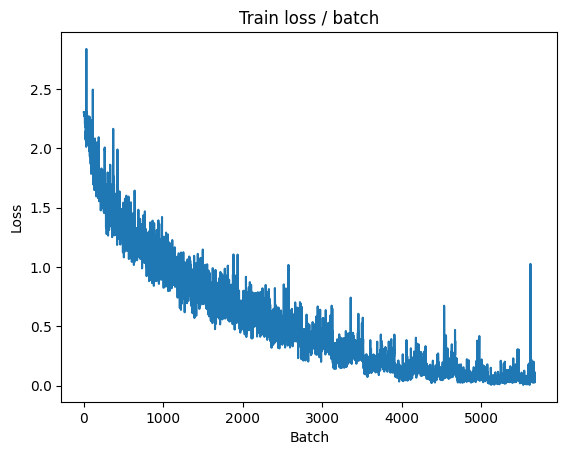


===============> Total time 7s	Avg loss 0.0755	Avg Prec@1 97.58 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 1.4827 (1.4827)	Prec@1  73.4 ( 73.4)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.4554	Avg Prec@1 72.89 %	Avg Prec@5 97.67 %



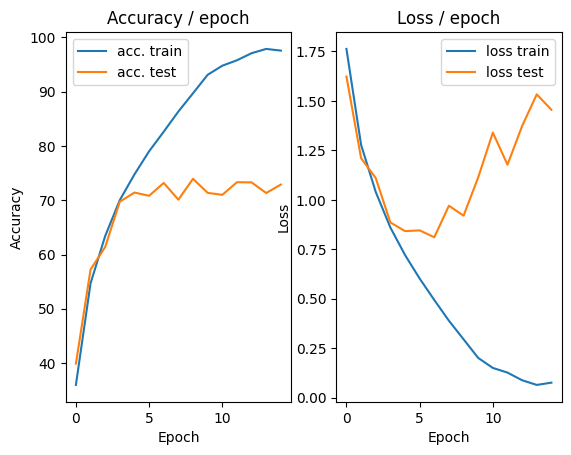

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.095s (0.095s)	Loss 0.0207 (0.0207)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


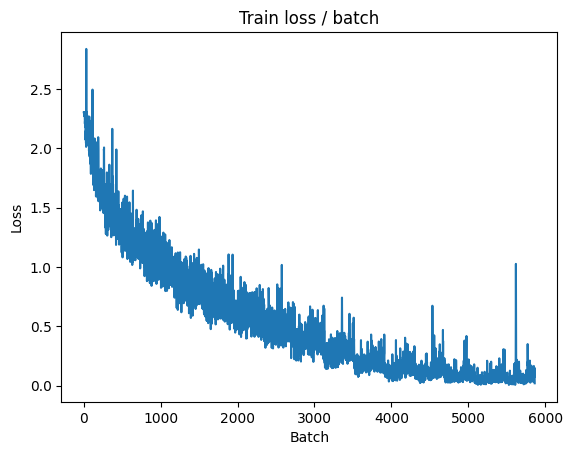

[TRAIN Batch 200/391]	Time 0.008s (0.018s)	Loss 0.0214 (0.0330)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)


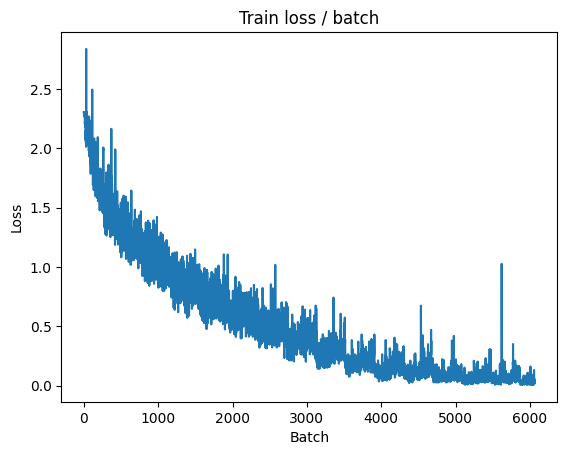


===============> Total time 7s	Avg loss 0.0650	Avg Prec@1 98.11 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 1.5644 (1.5644)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.3199	Avg Prec@1 74.51 %	Avg Prec@5 97.60 %



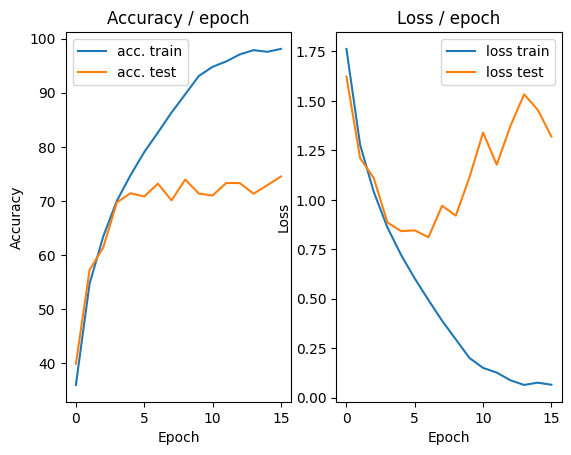

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.089s (0.089s)	Loss 0.0276 (0.0276)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


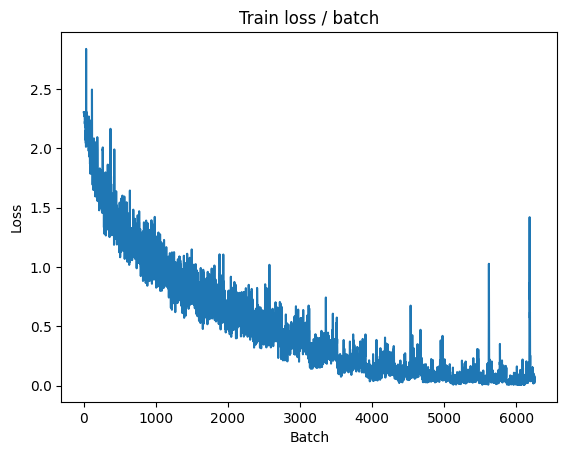

[TRAIN Batch 200/391]	Time 0.012s (0.018s)	Loss 0.0169 (0.0214)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


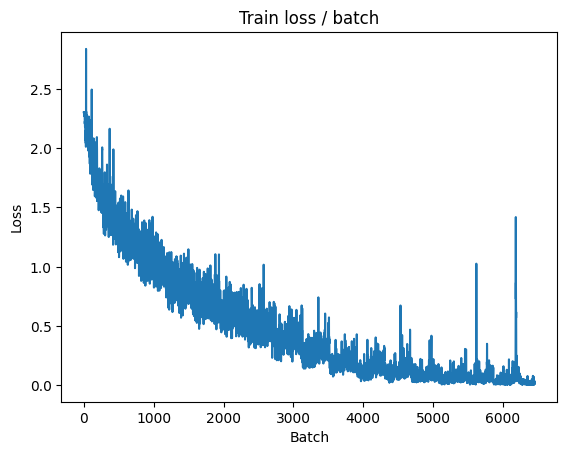


===============> Total time 7s	Avg loss 0.0306	Avg Prec@1 99.07 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 1.5425 (1.5425)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.5777	Avg Prec@1 74.67 %	Avg Prec@5 97.60 %



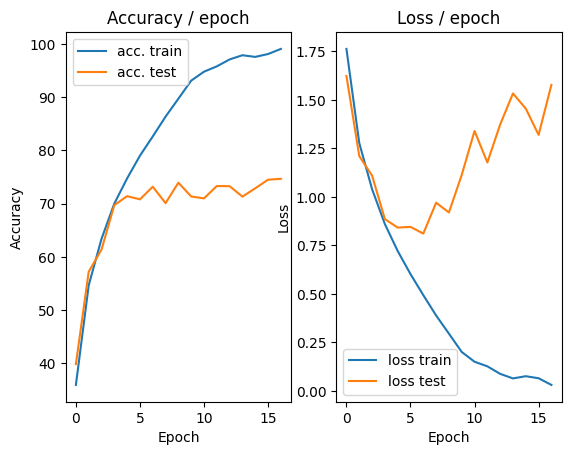

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.088s (0.088s)	Loss 0.0316 (0.0316)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


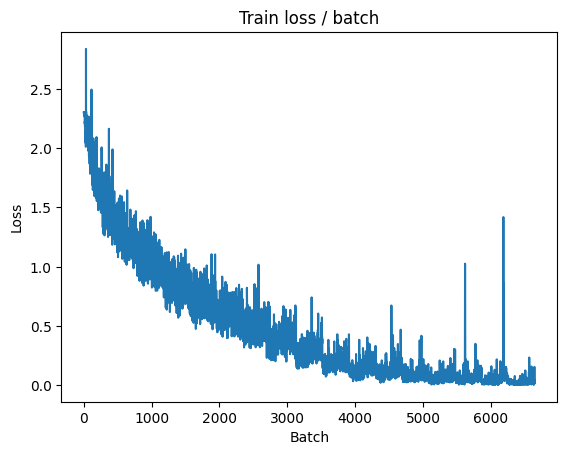

[TRAIN Batch 200/391]	Time 0.006s (0.018s)	Loss 0.0263 (0.0252)	Prec@1  98.4 ( 99.2)	Prec@5 100.0 (100.0)


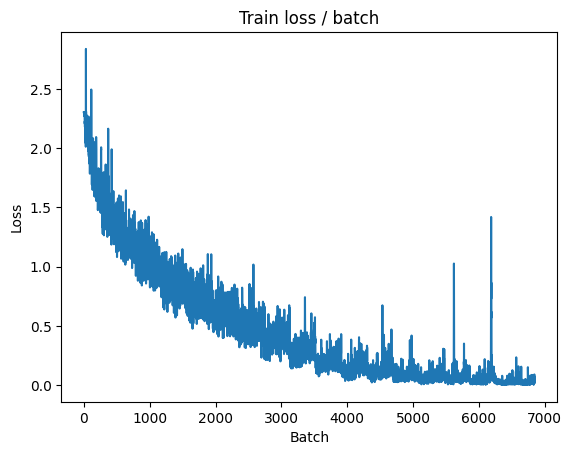


===============> Total time 7s	Avg loss 0.0247	Avg Prec@1 99.24 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 1.8827 (1.8827)	Prec@1  75.0 ( 75.0)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.6912	Avg Prec@1 73.94 %	Avg Prec@5 97.74 %



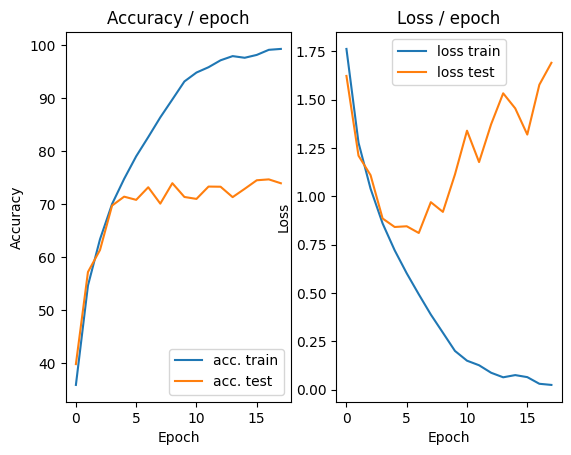

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.095s (0.095s)	Loss 0.0023 (0.0023)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


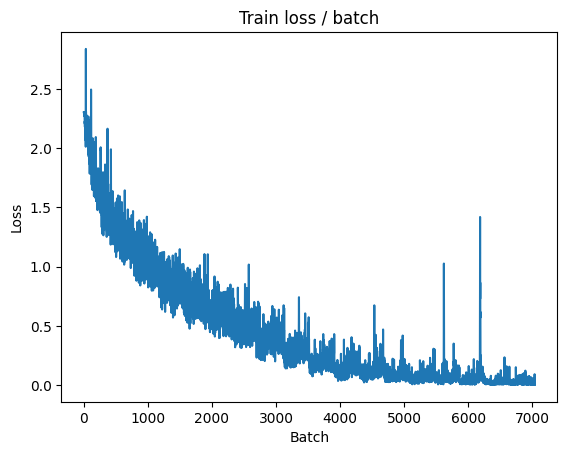

[TRAIN Batch 200/391]	Time 0.024s (0.018s)	Loss 0.0290 (0.0096)	Prec@1  99.2 ( 99.8)	Prec@5 100.0 (100.0)


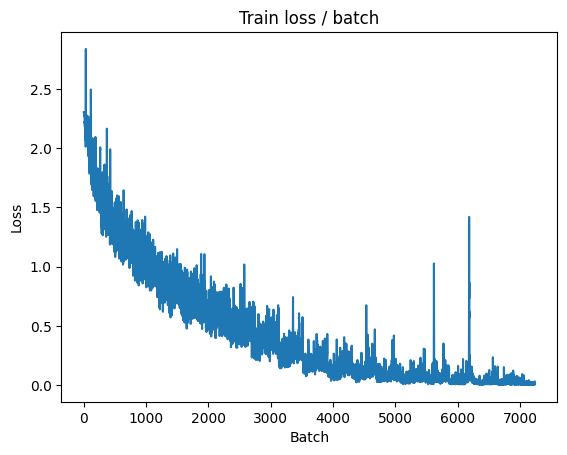


===============> Total time 7s	Avg loss 0.0299	Avg Prec@1 99.18 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 1.8777 (1.8777)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.6454	Avg Prec@1 72.89 %	Avg Prec@5 96.94 %



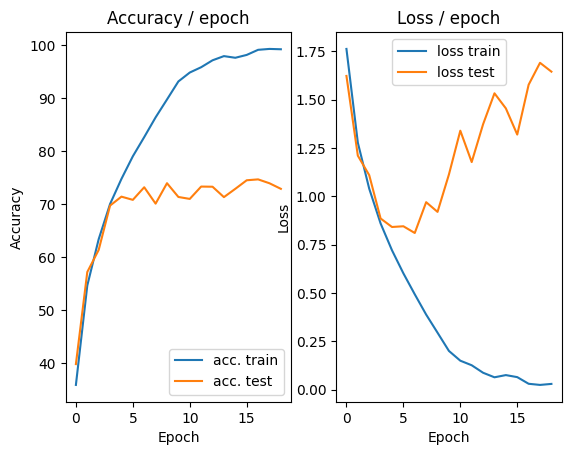

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.0801 (0.0801)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


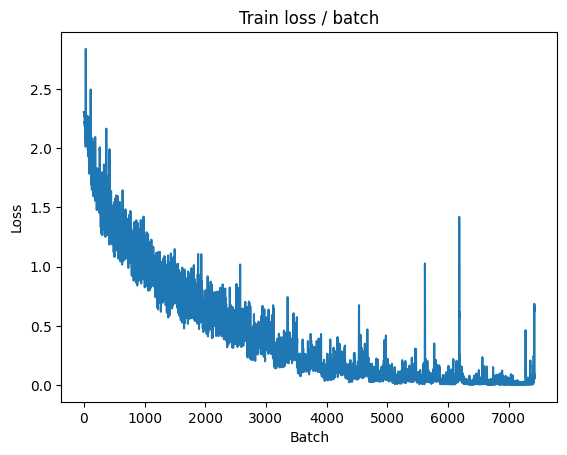

[TRAIN Batch 200/391]	Time 0.025s (0.019s)	Loss 0.0305 (0.0251)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


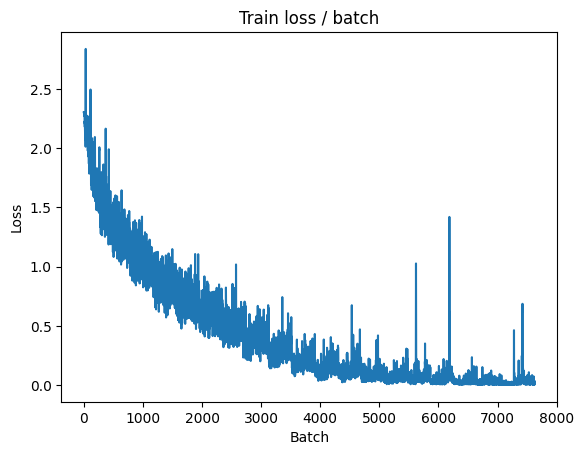


===============> Total time 7s	Avg loss 0.0227	Avg Prec@1 99.29 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 2.1792 (2.1792)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.6461	Avg Prec@1 74.83 %	Avg Prec@5 97.66 %



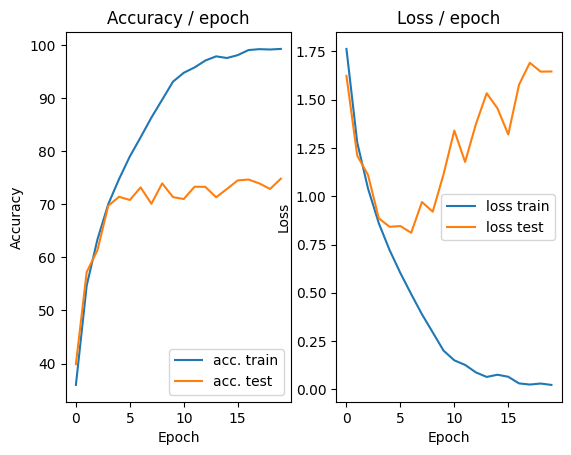

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.0040 (0.0040)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


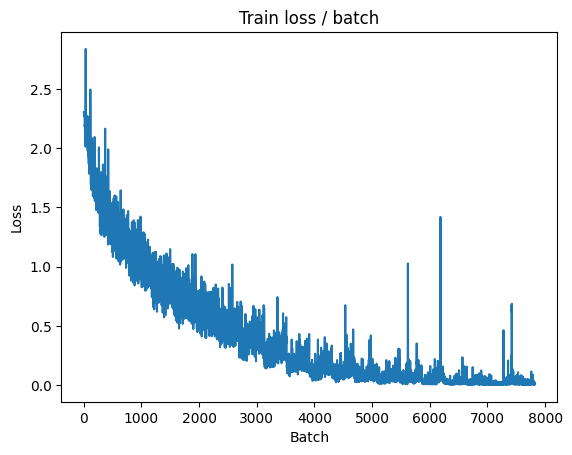

[TRAIN Batch 200/391]	Time 0.009s (0.021s)	Loss 0.0043 (0.0117)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


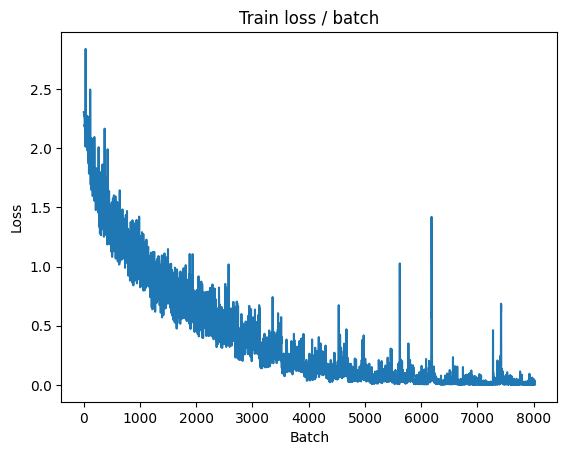


===============> Total time 8s	Avg loss 0.0158	Avg Prec@1 99.48 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.9115 (1.9115)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.7494	Avg Prec@1 74.85 %	Avg Prec@5 97.58 %



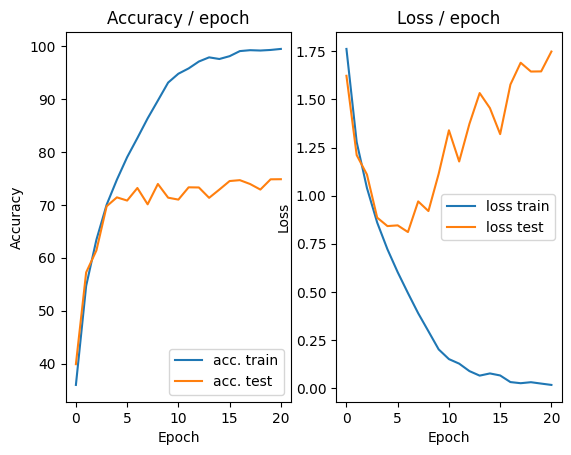

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.097s (0.097s)	Loss 0.0038 (0.0038)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


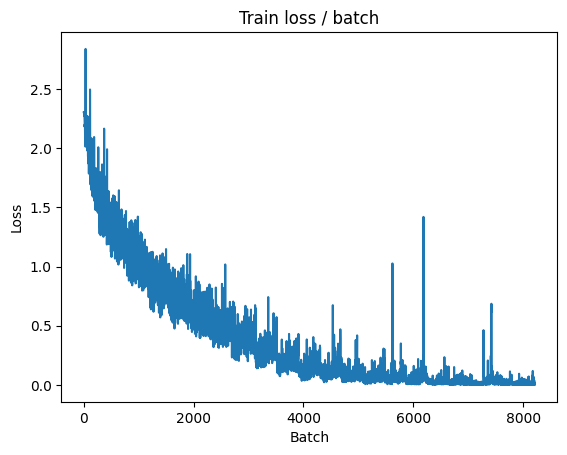

[TRAIN Batch 200/391]	Time 0.006s (0.024s)	Loss 0.1136 (0.2050)	Prec@1  96.9 ( 95.5)	Prec@5 100.0 ( 99.5)


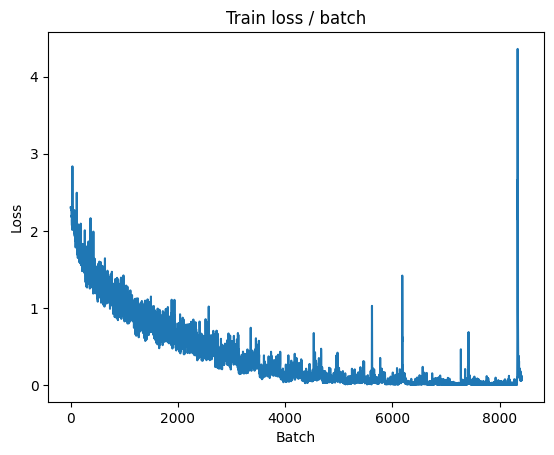


===============> Total time 8s	Avg loss 0.1277	Avg Prec@1 96.97 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 2.1115 (2.1115)	Prec@1  72.7 ( 72.7)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.5349	Avg Prec@1 73.65 %	Avg Prec@5 97.69 %



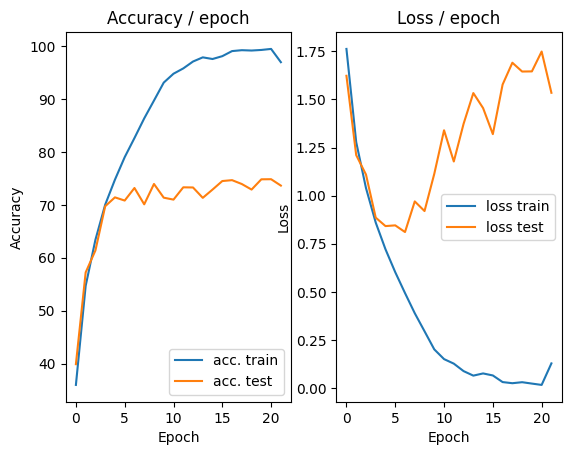

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.0551 (0.0551)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


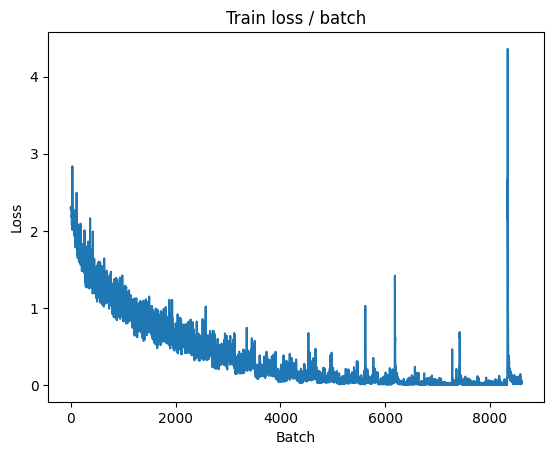

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.0428 (0.0231)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


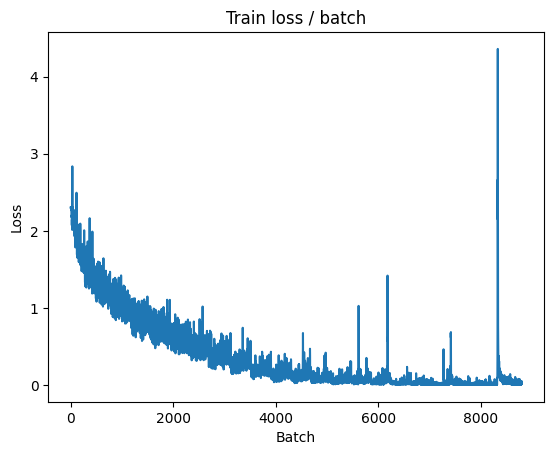


===============> Total time 7s	Avg loss 0.0236	Avg Prec@1 99.30 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.8017 (1.8017)	Prec@1  78.1 ( 78.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.6810	Avg Prec@1 74.45 %	Avg Prec@5 97.78 %



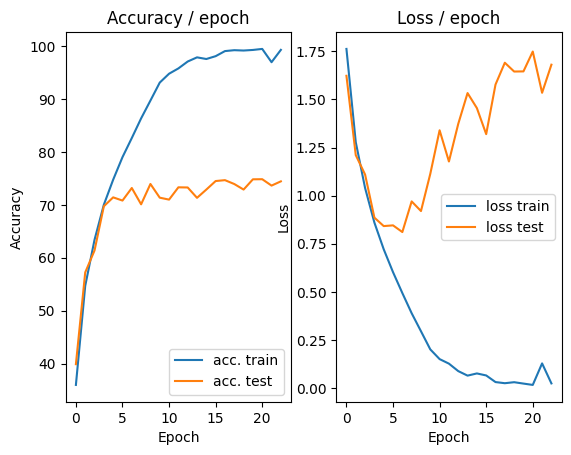

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.085s (0.085s)	Loss 0.0063 (0.0063)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


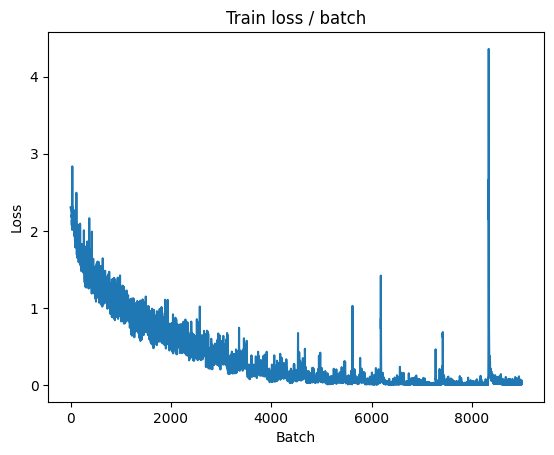

[TRAIN Batch 200/391]	Time 0.028s (0.017s)	Loss 0.0101 (0.0112)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


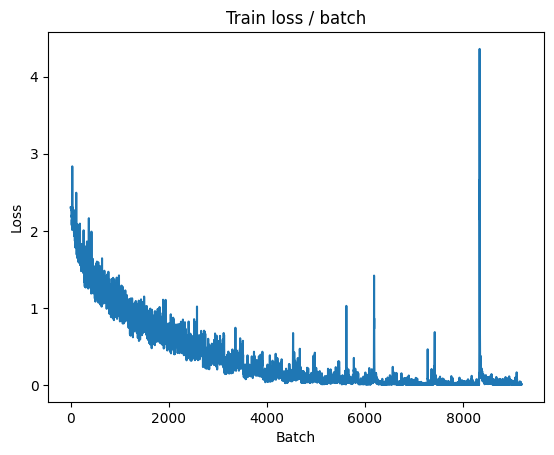


===============> Total time 7s	Avg loss 0.0101	Avg Prec@1 99.72 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 2.1425 (2.1425)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.7358	Avg Prec@1 75.84 %	Avg Prec@5 97.83 %



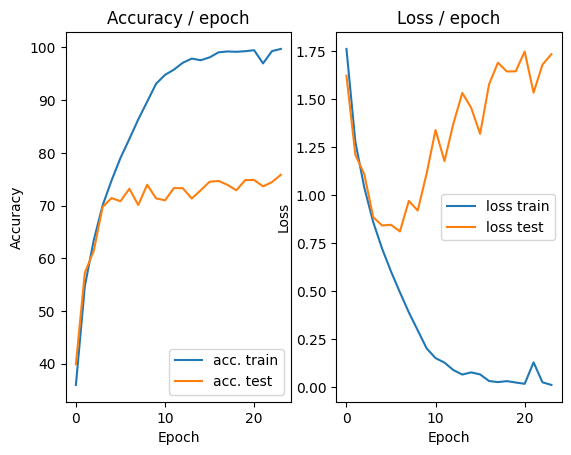

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.108s (0.108s)	Loss 0.0031 (0.0031)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


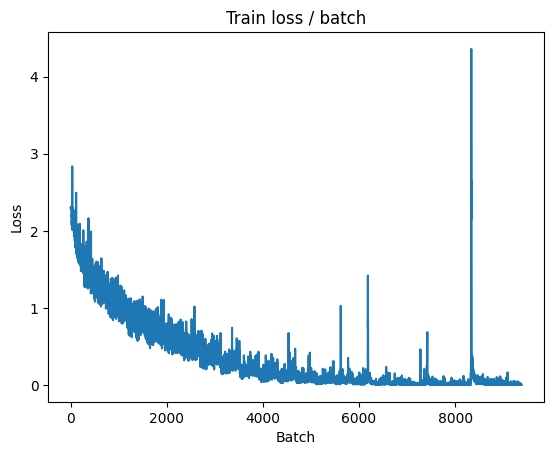

[TRAIN Batch 200/391]	Time 0.051s (0.024s)	Loss 0.0045 (0.0018)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


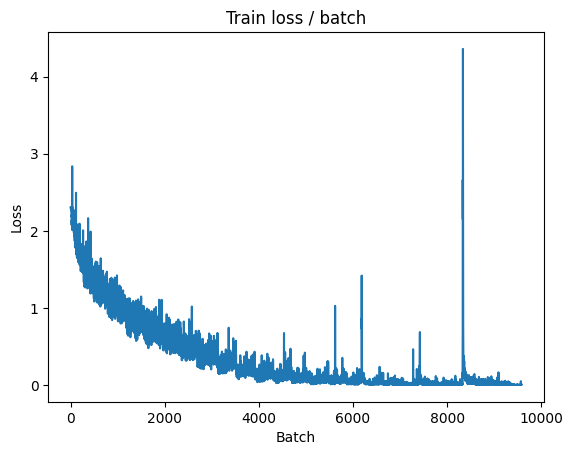


===============> Total time 8s	Avg loss 0.0070	Avg Prec@1 99.82 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 2.1309 (2.1309)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.7948	Avg Prec@1 75.46 %	Avg Prec@5 97.63 %



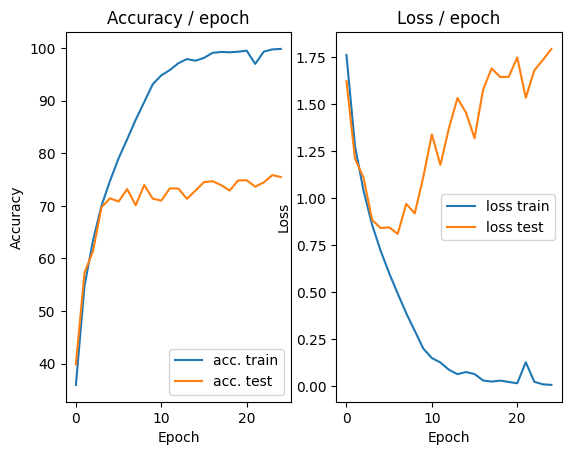

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.089s (0.089s)	Loss 0.0029 (0.0029)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


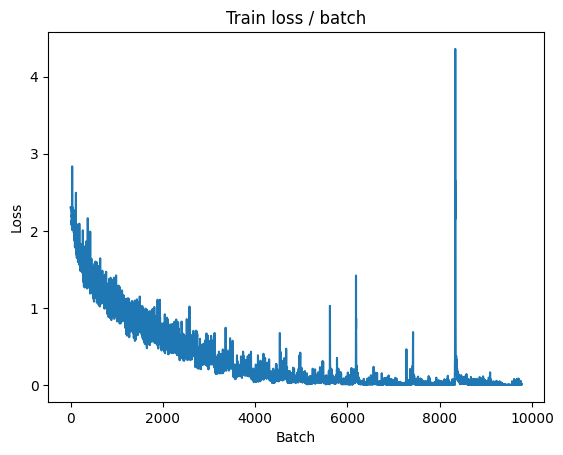

[TRAIN Batch 200/391]	Time 0.007s (0.023s)	Loss 0.0034 (0.0033)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


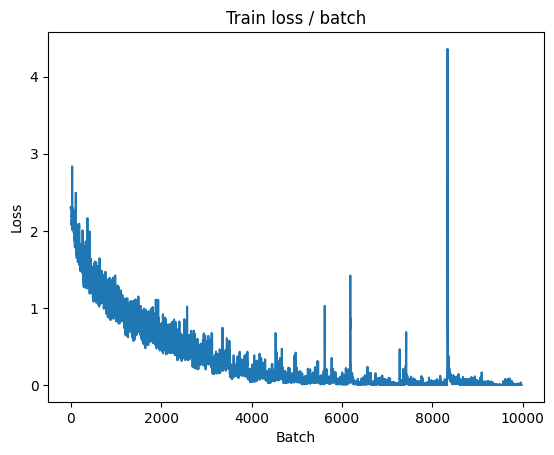


===============> Total time 9s	Avg loss 0.0025	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 2.1490 (2.1490)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.8857	Avg Prec@1 75.92 %	Avg Prec@5 97.72 %



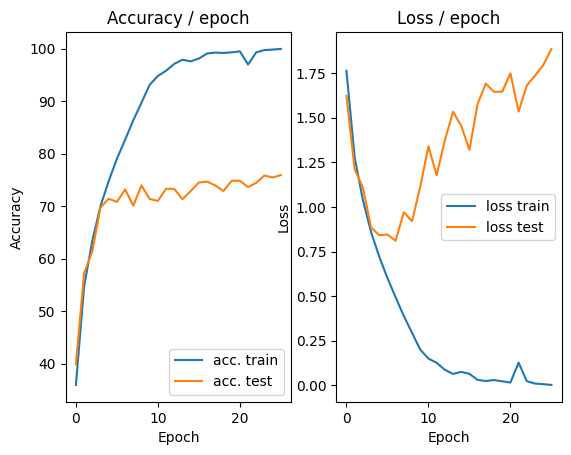

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.0014 (0.0014)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


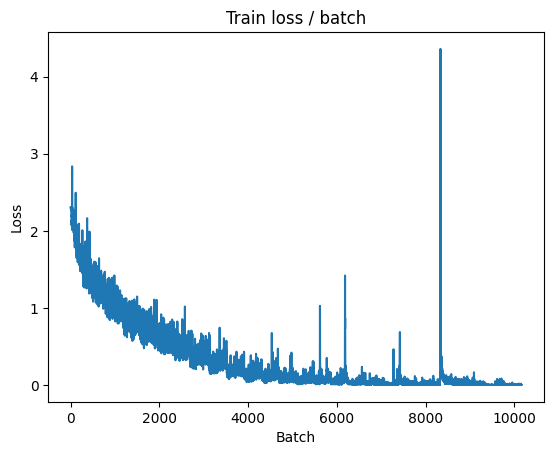

[TRAIN Batch 200/391]	Time 0.011s (0.026s)	Loss 0.0006 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


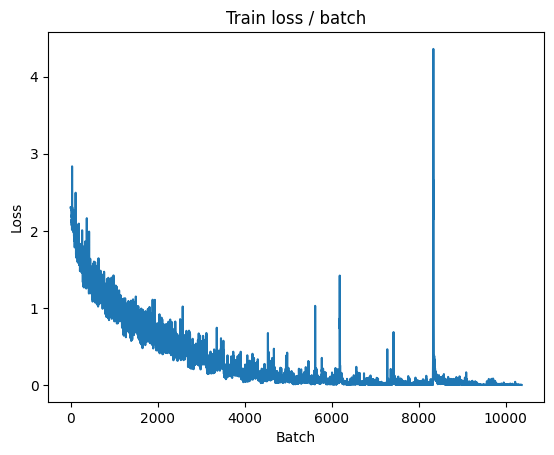


===============> Total time 8s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 2.3026 (2.3026)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.9022	Avg Prec@1 76.24 %	Avg Prec@5 97.76 %



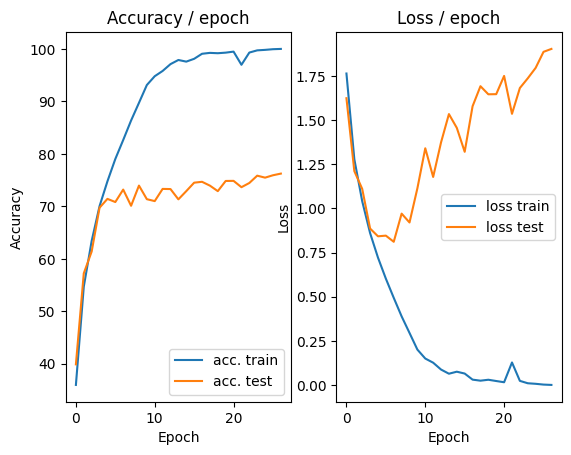

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


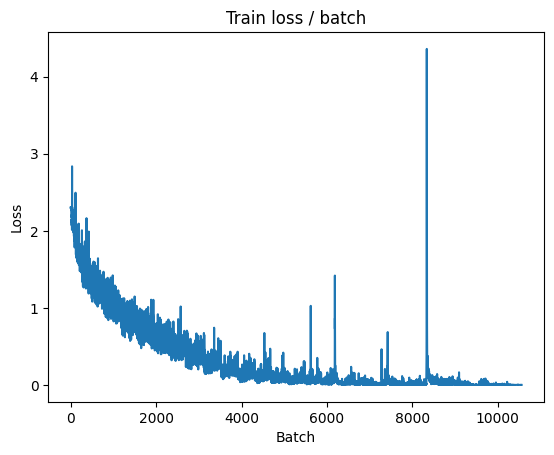

[TRAIN Batch 200/391]	Time 0.025s (0.019s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


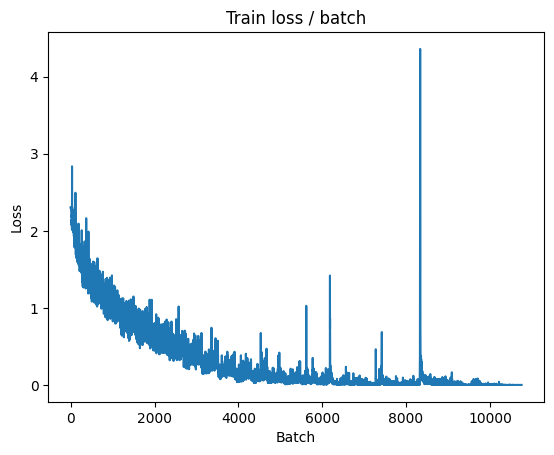


===============> Total time 7s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 2.3299 (2.3299)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.9400	Avg Prec@1 76.23 %	Avg Prec@5 97.76 %



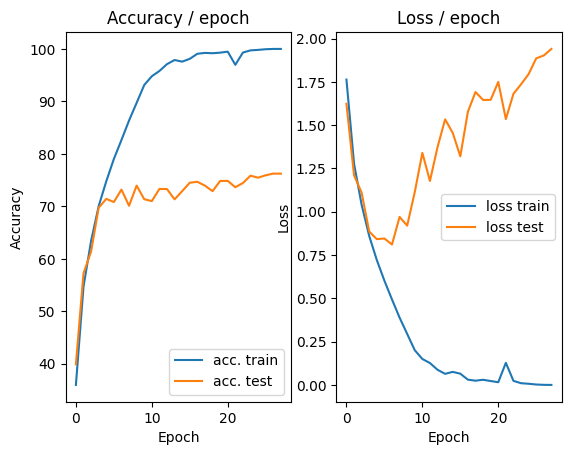

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


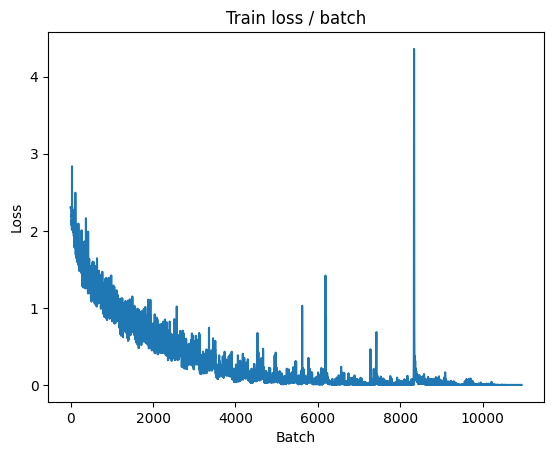

[TRAIN Batch 200/391]	Time 0.006s (0.021s)	Loss 0.0003 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


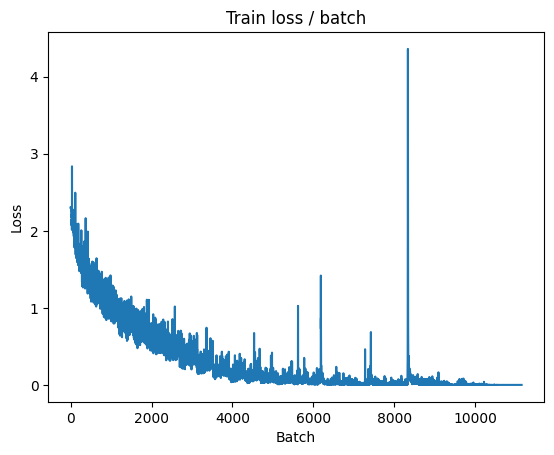


===============> Total time 7s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 2.3499 (2.3499)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.9654	Avg Prec@1 76.34 %	Avg Prec@5 97.79 %



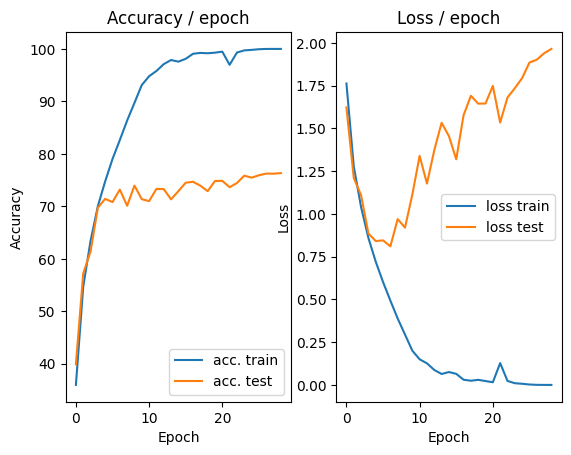

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.101s (0.101s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


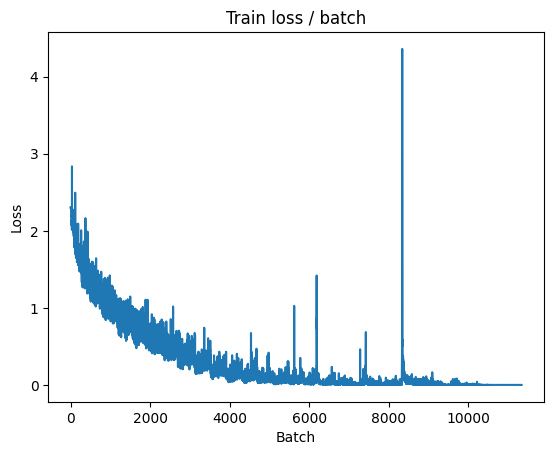

[TRAIN Batch 200/391]	Time 0.024s (0.019s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


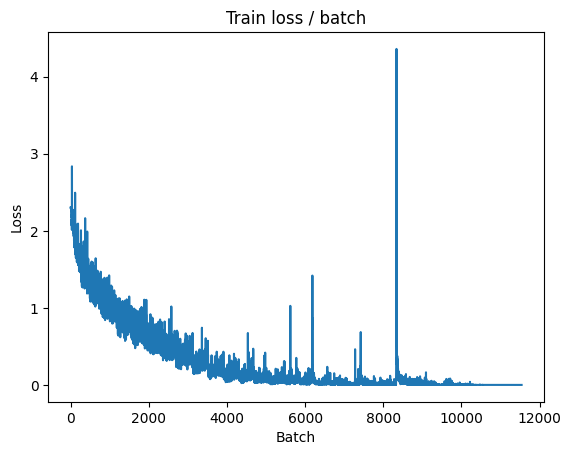


===============> Total time 7s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 2.3681 (2.3681)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.9878	Avg Prec@1 76.43 %	Avg Prec@5 97.80 %



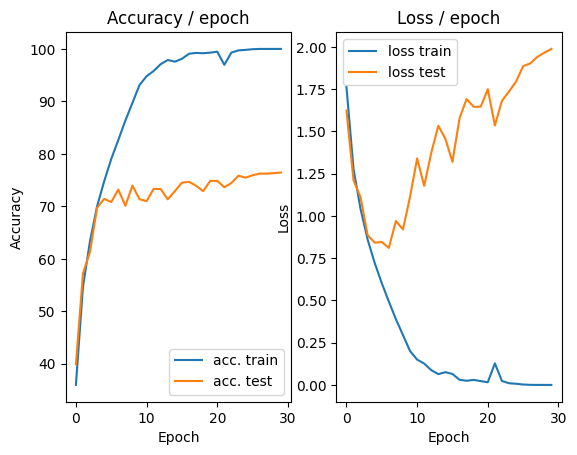

In [7]:
main(128, 0.1, 30, cuda=True)

# 3.2 Increase in the number of training examples by data increase

In [8]:
class ConvNet(nn.Module):
    """
    Cette classe définit la structure du réseau neuronal convolutif.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # Définition des couches convolutives et de pooling pour extraire les caractéristiques
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True),
        )
        # Couches fully connected pour la classification
        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Remarque : Pas besoin d'ajouter la couche softmax ici, car elle est incluse dans la fonction de perte
        )



    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le jeu de données CIFAR-10 et applique les transformations nécessaires,
    y compris la normalisation.
    """
    # Valeurs de normalisation pour CIFAR-10
    mean = [0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]

    # Transformations à appliquer sur les images
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),  # Flips aléatoires pour augmenter les données
        transforms.RandomCrop(28, padding=4),  # Découpage aléatoire
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)  # Normalisation
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Chargement des jeux de données d'entraînement et de validation
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True, transform=val_transform)

    # Création des DataLoader pour parcourir les jeux de données par batch
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                                               pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False,
                                             pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Effectue un passage (epoch) sur les données `data` avec le modèle `model`.
    Évalue la perte avec `criterion`. Si `optimizer` est fourni, fait une étape d'entraînement,
    sinon fait une évaluation.
    """
    model.eval() if optimizer is None else model.train()

    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()

    tic = time.time()
    for i, (input, target) in enumerate(data):
        if cuda:
            input = input.cuda()
            target = target.cuda()

        # Forward pass
        output = model(input)
        loss = criterion(output, target)

        # Backward pass si on est en mode entraînement
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Calcul des métriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # Mise à jour des métriques moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)

        # Affichage des informations
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time,
                   loss=avg_loss, top1=avg_top1_acc, top5=avg_top5_acc))

    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.360s (0.360s)	Loss 2.3026 (2.3026)	Prec@1  11.7 ( 11.7)	Prec@5  50.8 ( 50.8)
[TRAIN Batch 200/391]	Time 0.042s (0.030s)	Loss 1.8837 (2.0583)	Prec@1  28.1 ( 23.6)	Prec@5  82.0 ( 74.8)

===============> Total time 11s	Avg loss 1.9497	Avg Prec@1 27.90 %	Avg Prec@5 79.66 %

[EVAL Batch 000/079]	Time 0.071s (0.071s)	Loss 1.9353 (1.9353)	Prec@1  33.6 ( 33.6)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.9306	Avg Prec@1 30.26 %	Avg Prec@5 83.59 %



<Figure size 640x480 with 0 Axes>

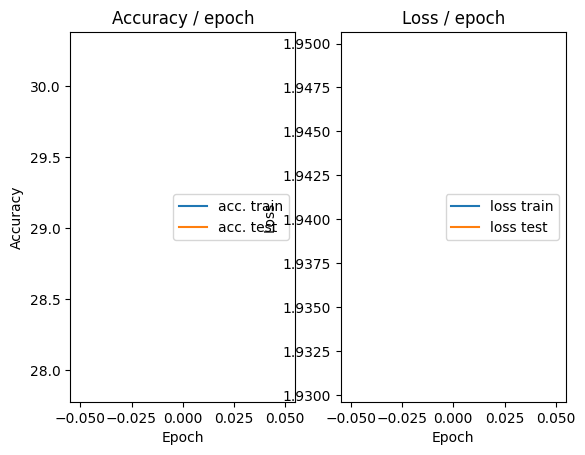

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 2.0051 (2.0051)	Prec@1  25.8 ( 25.8)	Prec@5  85.9 ( 85.9)
[TRAIN Batch 200/391]	Time 0.008s (0.028s)	Loss 1.5620 (1.6787)	Prec@1  49.2 ( 39.0)	Prec@5  90.6 ( 88.5)

===============> Total time 12s	Avg loss 1.6256	Avg Prec@1 40.81 %	Avg Prec@5 89.68 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 1.5495 (1.5495)	Prec@1  44.5 ( 44.5)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.6245	Avg Prec@1 43.10 %	Avg Prec@5 88.77 %



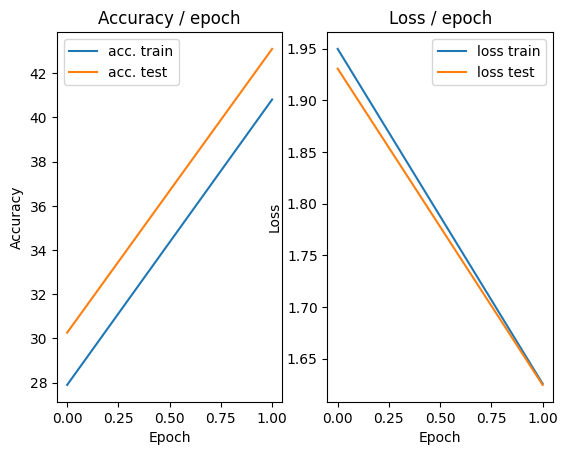

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 1.5754 (1.5754)	Prec@1  42.2 ( 42.2)	Prec@5  90.6 ( 90.6)
[TRAIN Batch 200/391]	Time 0.007s (0.036s)	Loss 1.5843 (1.4703)	Prec@1  50.0 ( 46.7)	Prec@5  85.2 ( 92.0)

===============> Total time 12s	Avg loss 1.4320	Avg Prec@1 48.32 %	Avg Prec@5 92.44 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 1.2075 (1.2075)	Prec@1  55.5 ( 55.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.2359	Avg Prec@1 55.41 %	Avg Prec@5 95.06 %



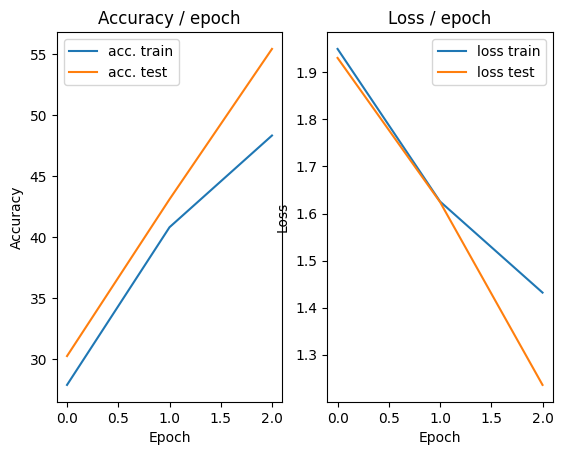

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.111s (0.111s)	Loss 1.4648 (1.4648)	Prec@1  49.2 ( 49.2)	Prec@5  92.2 ( 92.2)
[TRAIN Batch 200/391]	Time 0.037s (0.028s)	Loss 1.2089 (1.3291)	Prec@1  60.9 ( 52.1)	Prec@5  94.5 ( 93.6)

===============> Total time 10s	Avg loss 1.2956	Avg Prec@1 53.27 %	Avg Prec@5 94.09 %

[EVAL Batch 000/079]	Time 0.072s (0.072s)	Loss 1.2816 (1.2816)	Prec@1  52.3 ( 52.3)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.3309	Avg Prec@1 53.39 %	Avg Prec@5 93.46 %



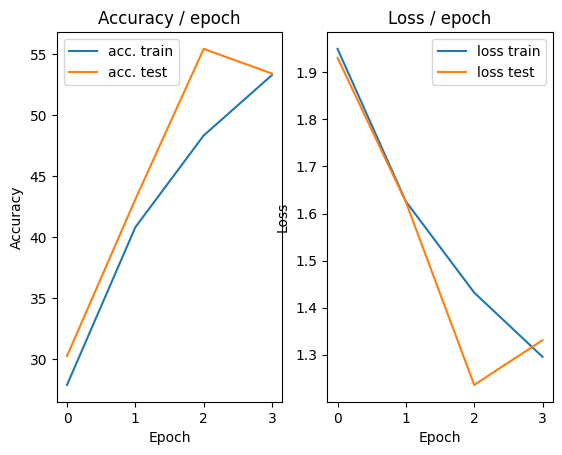

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.096s (0.096s)	Loss 1.1656 (1.1656)	Prec@1  59.4 ( 59.4)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.008s (0.028s)	Loss 1.3792 (1.2036)	Prec@1  47.7 ( 57.1)	Prec@5  95.3 ( 95.1)

===============> Total time 10s	Avg loss 1.1858	Avg Prec@1 57.82 %	Avg Prec@5 95.32 %

[EVAL Batch 000/079]	Time 0.070s (0.070s)	Loss 1.2636 (1.2636)	Prec@1  56.2 ( 56.2)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1888	Avg Prec@1 56.81 %	Avg Prec@5 95.33 %



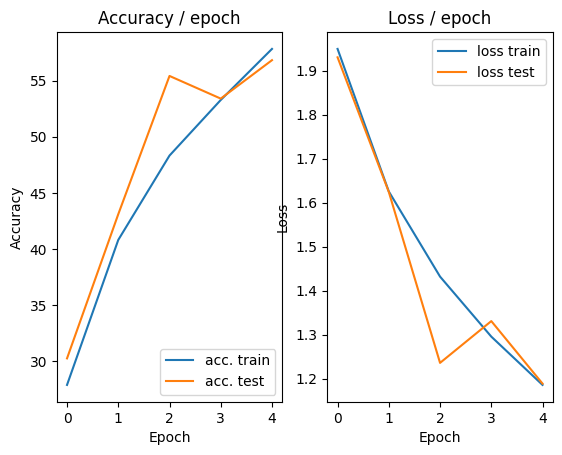

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.102s (0.102s)	Loss 1.2202 (1.2202)	Prec@1  60.9 ( 60.9)	Prec@5  92.2 ( 92.2)
[TRAIN Batch 200/391]	Time 0.017s (0.028s)	Loss 1.3274 (1.1080)	Prec@1  50.8 ( 60.8)	Prec@5  95.3 ( 95.8)

===============> Total time 12s	Avg loss 1.0858	Avg Prec@1 61.62 %	Avg Prec@5 95.93 %

[EVAL Batch 000/079]	Time 0.066s (0.066s)	Loss 1.0747 (1.0747)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1379	Avg Prec@1 60.94 %	Avg Prec@5 95.32 %



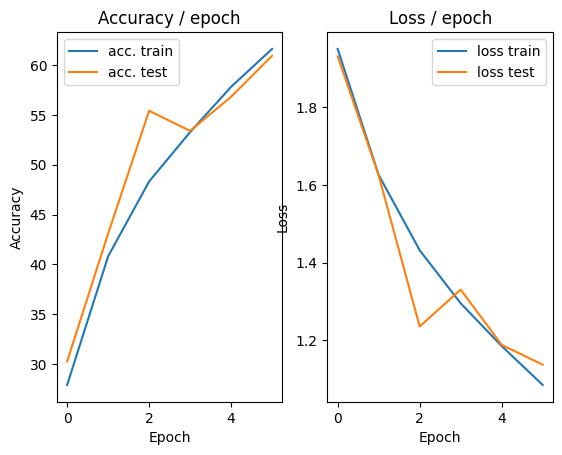

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.097s (0.097s)	Loss 1.1872 (1.1872)	Prec@1  60.9 ( 60.9)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.038s (0.024s)	Loss 0.9241 (1.0307)	Prec@1  67.2 ( 63.7)	Prec@5  96.1 ( 96.3)

===============> Total time 9s	Avg loss 1.0129	Avg Prec@1 64.60 %	Avg Prec@5 96.48 %

[EVAL Batch 000/079]	Time 0.063s (0.063s)	Loss 0.9343 (0.9343)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9391	Avg Prec@1 66.55 %	Avg Prec@5 97.32 %



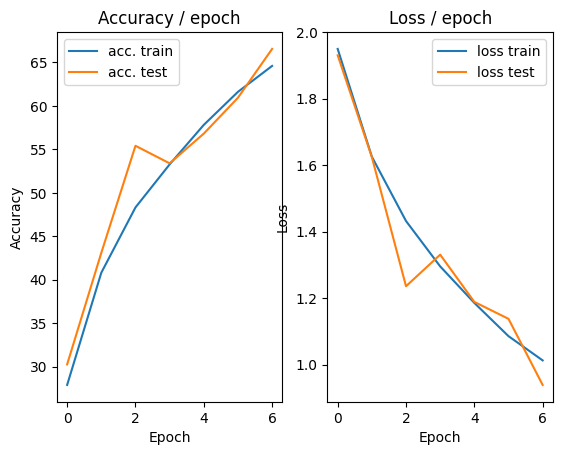

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.098s (0.098s)	Loss 1.0369 (1.0369)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.043s (0.025s)	Loss 0.7080 (0.9379)	Prec@1  78.1 ( 67.0)	Prec@5  97.7 ( 97.1)

===============> Total time 11s	Avg loss 0.9433	Avg Prec@1 66.89 %	Avg Prec@5 97.01 %

[EVAL Batch 000/079]	Time 0.072s (0.072s)	Loss 0.9385 (0.9385)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9891	Avg Prec@1 65.38 %	Avg Prec@5 97.26 %



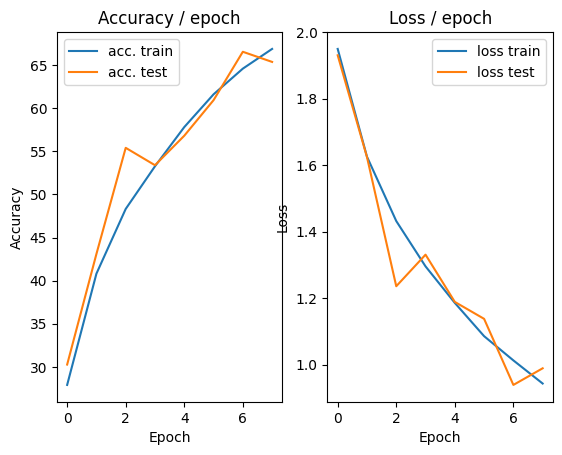

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.094s (0.094s)	Loss 1.0867 (1.0867)	Prec@1  57.0 ( 57.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.030s (0.025s)	Loss 0.8672 (0.9214)	Prec@1  69.5 ( 67.8)	Prec@5  96.9 ( 97.1)

===============> Total time 9s	Avg loss 0.9052	Avg Prec@1 68.41 %	Avg Prec@5 97.23 %

[EVAL Batch 000/079]	Time 0.065s (0.065s)	Loss 0.8743 (0.8743)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9374	Avg Prec@1 67.04 %	Avg Prec@5 97.27 %



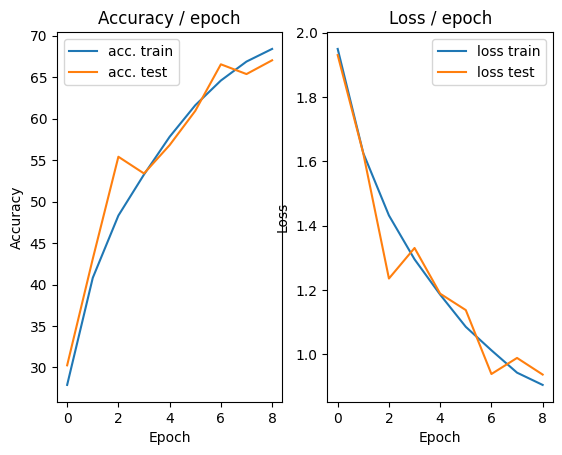

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.302s (0.302s)	Loss 0.9173 (0.9173)	Prec@1  69.5 ( 69.5)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.030s (0.028s)	Loss 0.8472 (0.8649)	Prec@1  69.5 ( 69.8)	Prec@5 100.0 ( 97.5)

===============> Total time 10s	Avg loss 0.8631	Avg Prec@1 70.06 %	Avg Prec@5 97.52 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.8143 (0.8143)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8368	Avg Prec@1 71.41 %	Avg Prec@5 97.59 %



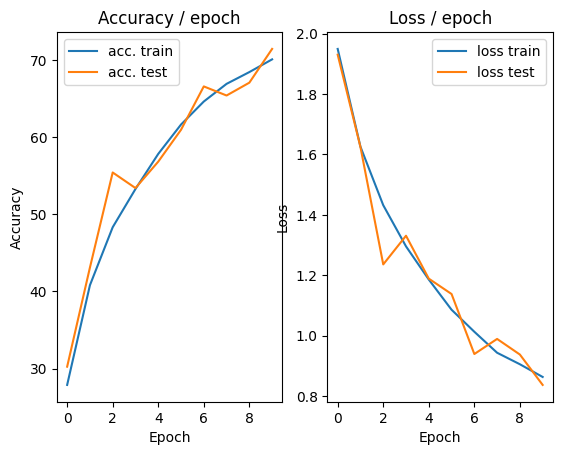

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.099s (0.099s)	Loss 0.7674 (0.7674)	Prec@1  71.1 ( 71.1)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.026s)	Loss 0.9372 (0.8293)	Prec@1  72.7 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 9s	Avg loss 0.8235	Avg Prec@1 71.26 %	Avg Prec@5 97.74 %

[EVAL Batch 000/079]	Time 0.065s (0.065s)	Loss 1.0503 (1.0503)	Prec@1  68.0 ( 68.0)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 0.9621	Avg Prec@1 66.99 %	Avg Prec@5 97.24 %



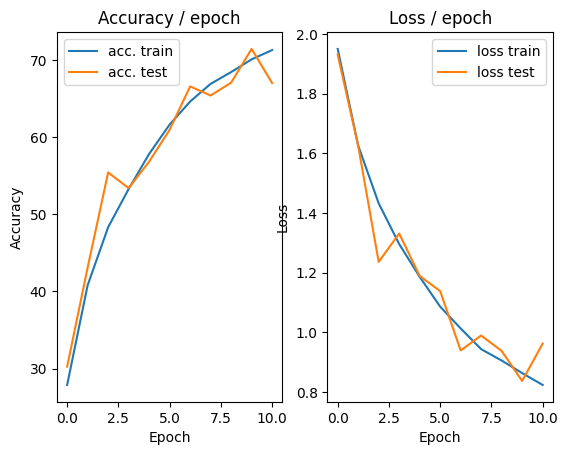

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.8276 (0.8276)	Prec@1  68.0 ( 68.0)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.069s (0.030s)	Loss 0.9196 (0.7896)	Prec@1  64.8 ( 72.3)	Prec@5  96.9 ( 97.8)

===============> Total time 11s	Avg loss 0.7913	Avg Prec@1 72.35 %	Avg Prec@5 97.79 %

[EVAL Batch 000/079]	Time 0.068s (0.068s)	Loss 0.7785 (0.7785)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7514	Avg Prec@1 73.91 %	Avg Prec@5 97.98 %



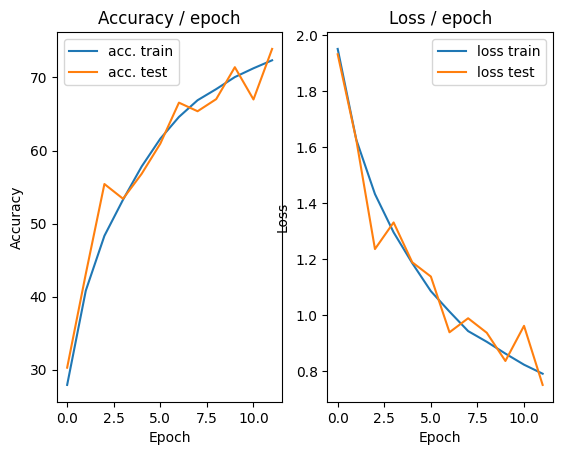

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.097s (0.097s)	Loss 0.7202 (0.7202)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.046s (0.026s)	Loss 0.7376 (0.7811)	Prec@1  73.4 ( 72.7)	Prec@5  98.4 ( 97.9)

===============> Total time 10s	Avg loss 0.7695	Avg Prec@1 73.21 %	Avg Prec@5 98.06 %

[EVAL Batch 000/079]	Time 0.070s (0.070s)	Loss 0.8961 (0.8961)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8567	Avg Prec@1 70.42 %	Avg Prec@5 97.96 %



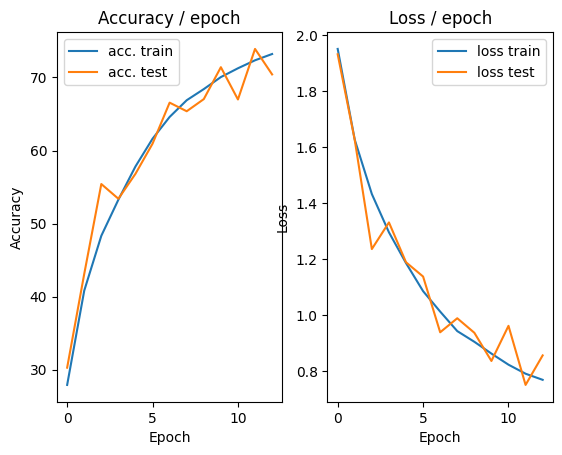

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.111s (0.111s)	Loss 0.9128 (0.9128)	Prec@1  64.8 ( 64.8)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.006s (0.028s)	Loss 0.7084 (0.7423)	Prec@1  73.4 ( 74.3)	Prec@5 100.0 ( 98.1)

===============> Total time 10s	Avg loss 0.7432	Avg Prec@1 74.24 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.066s (0.066s)	Loss 0.7541 (0.7541)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7313	Avg Prec@1 74.97 %	Avg Prec@5 98.27 %



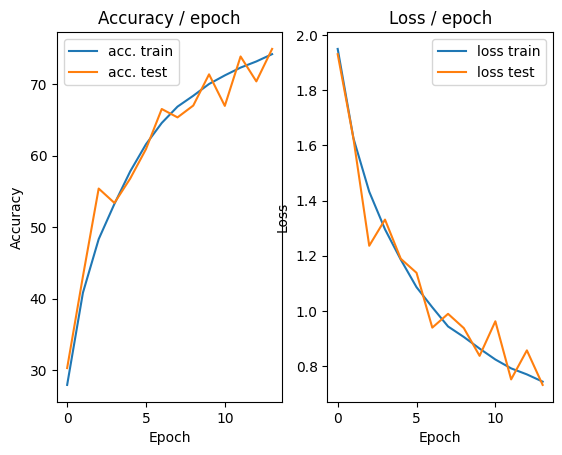

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.105s (0.105s)	Loss 0.7674 (0.7674)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.038s (0.030s)	Loss 0.7424 (0.7254)	Prec@1  76.6 ( 74.6)	Prec@5  96.9 ( 98.3)

===============> Total time 10s	Avg loss 0.7239	Avg Prec@1 74.75 %	Avg Prec@5 98.26 %

[EVAL Batch 000/079]	Time 0.068s (0.068s)	Loss 0.7334 (0.7334)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7395	Avg Prec@1 75.04 %	Avg Prec@5 98.44 %



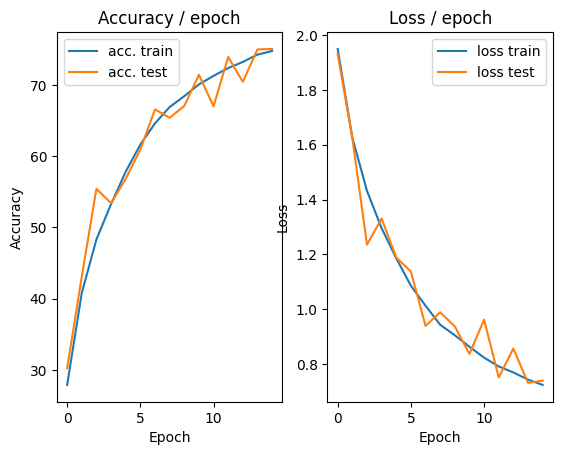

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.101s (0.101s)	Loss 0.7483 (0.7483)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.006s (0.024s)	Loss 0.8226 (0.6978)	Prec@1  75.0 ( 75.7)	Prec@5  96.1 ( 98.3)

===============> Total time 9s	Avg loss 0.6976	Avg Prec@1 75.85 %	Avg Prec@5 98.32 %

[EVAL Batch 000/079]	Time 0.073s (0.073s)	Loss 0.7006 (0.7006)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6911	Avg Prec@1 77.02 %	Avg Prec@5 98.41 %



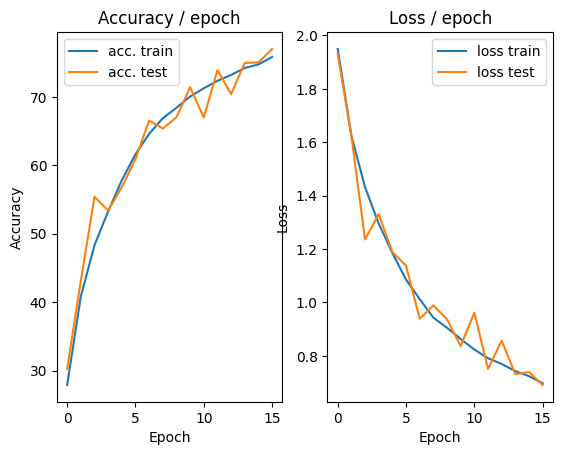

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.104s (0.104s)	Loss 0.5827 (0.5827)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.007s (0.029s)	Loss 0.6432 (0.6903)	Prec@1  77.3 ( 76.0)	Prec@5  97.7 ( 98.3)

===============> Total time 10s	Avg loss 0.6846	Avg Prec@1 76.21 %	Avg Prec@5 98.38 %

[EVAL Batch 000/079]	Time 0.068s (0.068s)	Loss 0.8906 (0.8906)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.8068	Avg Prec@1 72.71 %	Avg Prec@5 97.44 %



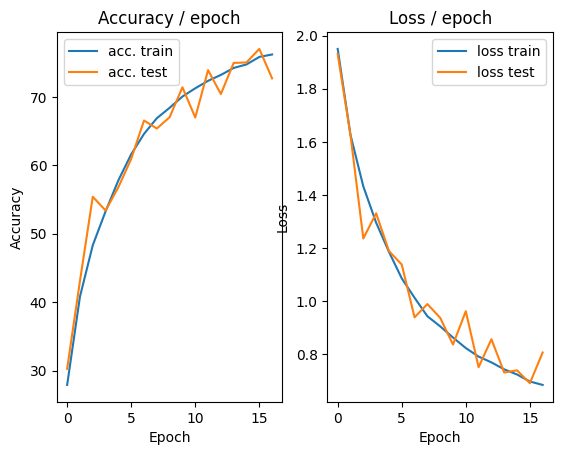

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.6411 (0.6411)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.040s (0.025s)	Loss 0.8332 (0.6640)	Prec@1  69.5 ( 76.8)	Prec@5  98.4 ( 98.5)

===============> Total time 9s	Avg loss 0.6642	Avg Prec@1 76.66 %	Avg Prec@5 98.49 %

[EVAL Batch 000/079]	Time 0.073s (0.073s)	Loss 0.6646 (0.6646)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6650	Avg Prec@1 77.29 %	Avg Prec@5 98.51 %



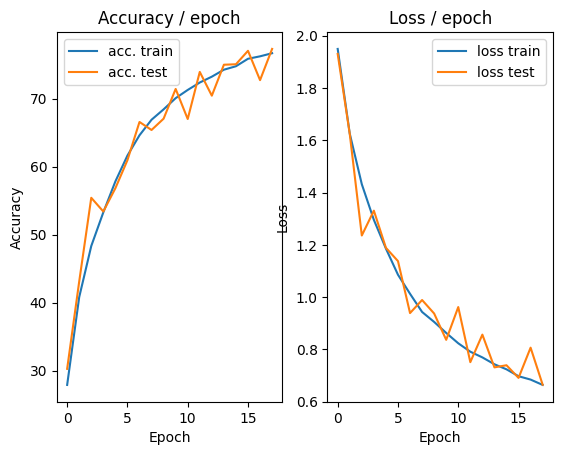

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.101s (0.101s)	Loss 0.5818 (0.5818)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.046s (0.027s)	Loss 0.6212 (0.6421)	Prec@1  78.9 ( 77.5)	Prec@5  98.4 ( 98.6)

===============> Total time 9s	Avg loss 0.6431	Avg Prec@1 77.47 %	Avg Prec@5 98.63 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.7652 (0.7652)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7397	Avg Prec@1 75.60 %	Avg Prec@5 98.42 %



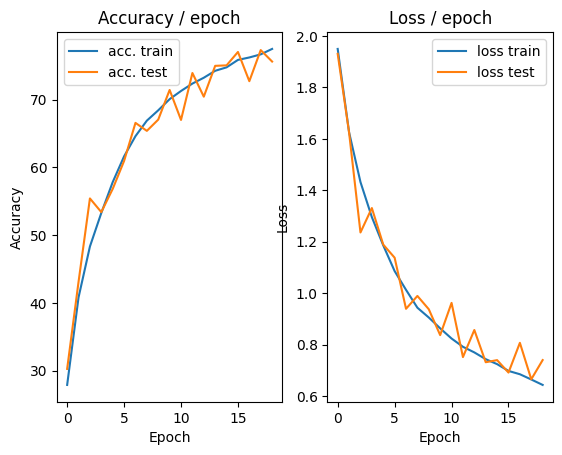

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 0.5818 (0.5818)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.039s (0.027s)	Loss 0.6440 (0.6360)	Prec@1  79.7 ( 78.1)	Prec@5  97.7 ( 98.6)

===============> Total time 10s	Avg loss 0.6367	Avg Prec@1 78.02 %	Avg Prec@5 98.58 %

[EVAL Batch 000/079]	Time 0.069s (0.069s)	Loss 0.6864 (0.6864)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7017	Avg Prec@1 76.80 %	Avg Prec@5 98.33 %



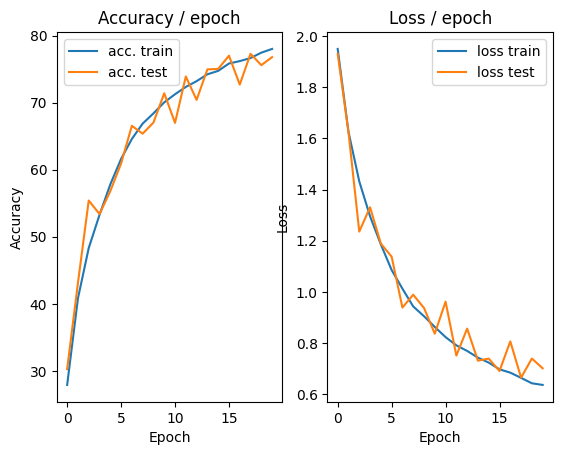

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.103s (0.103s)	Loss 0.7847 (0.7847)	Prec@1  70.3 ( 70.3)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.023s (0.023s)	Loss 0.5725 (0.6264)	Prec@1  80.5 ( 78.1)	Prec@5  99.2 ( 98.5)

===============> Total time 9s	Avg loss 0.6244	Avg Prec@1 78.12 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.066s (0.066s)	Loss 0.6522 (0.6522)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6445	Avg Prec@1 77.70 %	Avg Prec@5 98.68 %



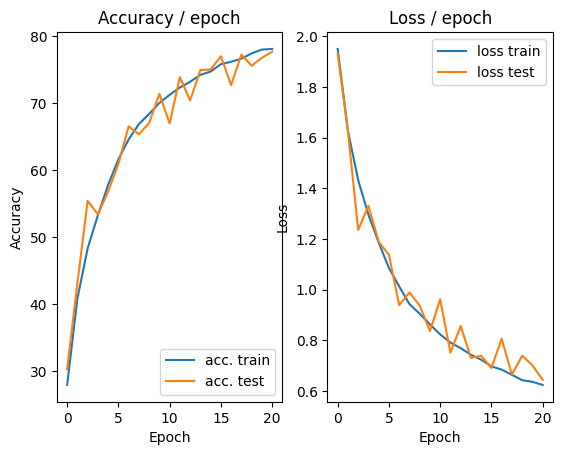

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.323s (0.323s)	Loss 0.6494 (0.6494)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.5725 (0.6074)	Prec@1  75.8 ( 78.9)	Prec@5 100.0 ( 98.8)

===============> Total time 10s	Avg loss 0.6080	Avg Prec@1 78.92 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.272s (0.272s)	Loss 0.8083 (0.8083)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6973	Avg Prec@1 77.01 %	Avg Prec@5 97.93 %



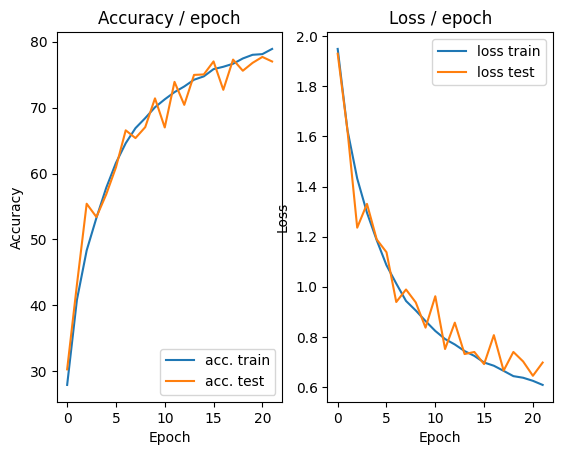

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.102s (0.102s)	Loss 0.7046 (0.7046)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.039s (0.026s)	Loss 0.6550 (0.6052)	Prec@1  79.7 ( 79.0)	Prec@5  99.2 ( 98.7)

===============> Total time 10s	Avg loss 0.6051	Avg Prec@1 78.94 %	Avg Prec@5 98.76 %

[EVAL Batch 000/079]	Time 0.095s (0.095s)	Loss 0.6774 (0.6774)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6336	Avg Prec@1 78.22 %	Avg Prec@5 98.69 %



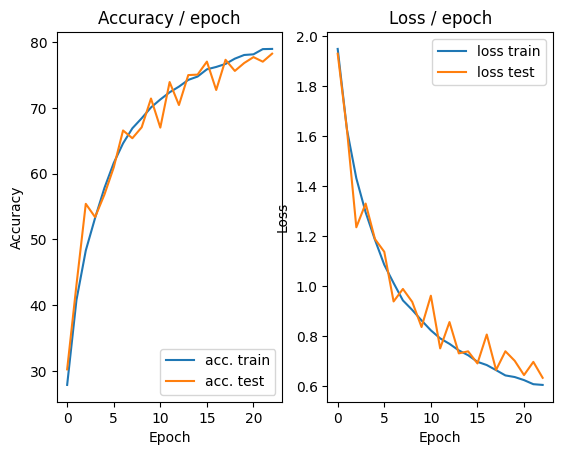

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.109s (0.109s)	Loss 0.5020 (0.5020)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.027s (0.026s)	Loss 0.3835 (0.5871)	Prec@1  89.1 ( 79.4)	Prec@5 100.0 ( 98.7)

===============> Total time 9s	Avg loss 0.5927	Avg Prec@1 79.37 %	Avg Prec@5 98.75 %

[EVAL Batch 000/079]	Time 0.071s (0.071s)	Loss 0.6491 (0.6491)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6314	Avg Prec@1 78.39 %	Avg Prec@5 98.61 %



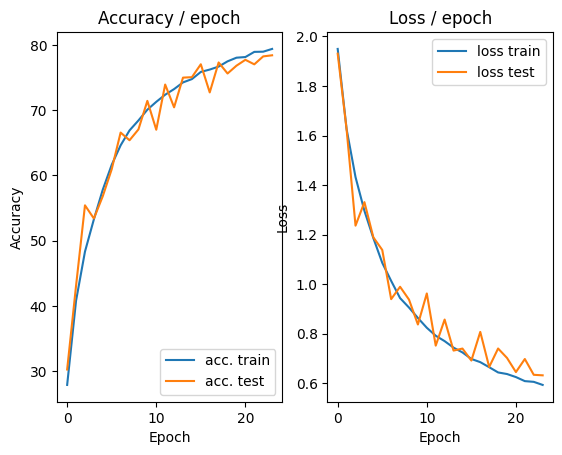

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.095s (0.095s)	Loss 0.6434 (0.6434)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.055s (0.026s)	Loss 0.6252 (0.5716)	Prec@1  78.1 ( 80.1)	Prec@5  98.4 ( 98.9)

===============> Total time 10s	Avg loss 0.5776	Avg Prec@1 79.83 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.067s (0.067s)	Loss 0.6015 (0.6015)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6320	Avg Prec@1 78.57 %	Avg Prec@5 98.85 %



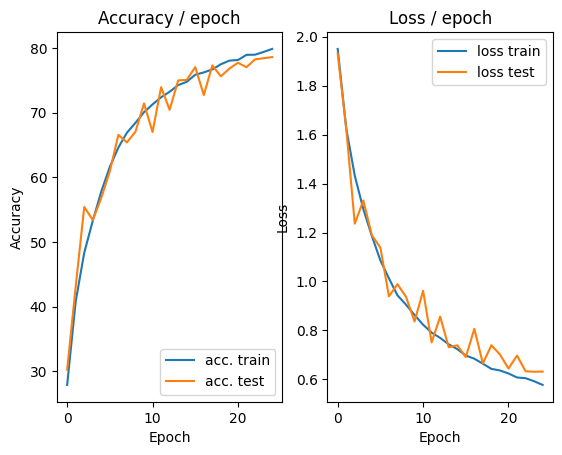

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.100s (0.100s)	Loss 0.4781 (0.4781)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.055s (0.026s)	Loss 0.4958 (0.5694)	Prec@1  82.0 ( 80.3)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.5742	Avg Prec@1 80.08 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.6313 (0.6313)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7339	Avg Prec@1 75.79 %	Avg Prec@5 98.16 %



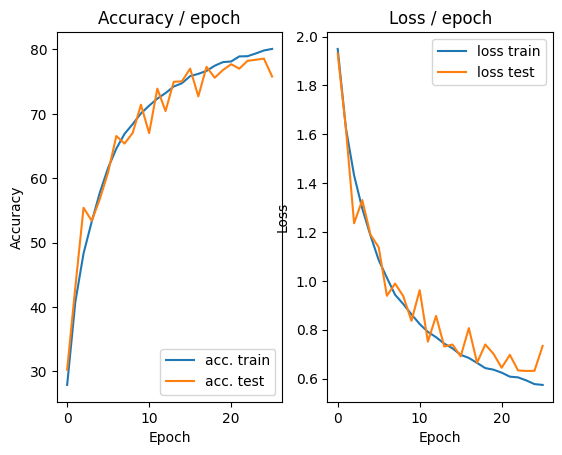

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.098s (0.098s)	Loss 0.5709 (0.5709)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.048s (0.026s)	Loss 0.6499 (0.5591)	Prec@1  78.9 ( 80.3)	Prec@5  97.7 ( 99.1)

===============> Total time 10s	Avg loss 0.5630	Avg Prec@1 80.34 %	Avg Prec@5 98.95 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.6122 (0.6122)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6399	Avg Prec@1 78.03 %	Avg Prec@5 98.82 %



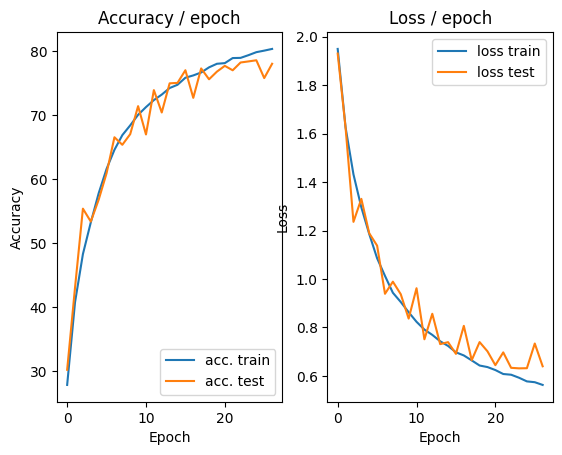

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.095s (0.095s)	Loss 0.4626 (0.4626)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.025s)	Loss 0.5405 (0.5556)	Prec@1  79.7 ( 80.8)	Prec@5 100.0 ( 98.9)

===============> Total time 9s	Avg loss 0.5552	Avg Prec@1 80.82 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.067s (0.067s)	Loss 0.6759 (0.6759)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7141	Avg Prec@1 76.44 %	Avg Prec@5 98.21 %



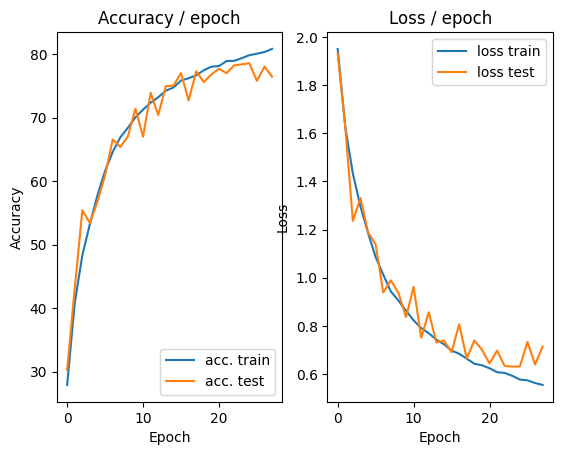

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.099s (0.099s)	Loss 0.6874 (0.6874)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.055s (0.030s)	Loss 0.5755 (0.5426)	Prec@1  79.7 ( 80.9)	Prec@5 100.0 ( 99.0)

===============> Total time 11s	Avg loss 0.5441	Avg Prec@1 80.94 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.064s (0.064s)	Loss 0.5381 (0.5381)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6771	Avg Prec@1 77.66 %	Avg Prec@5 98.30 %



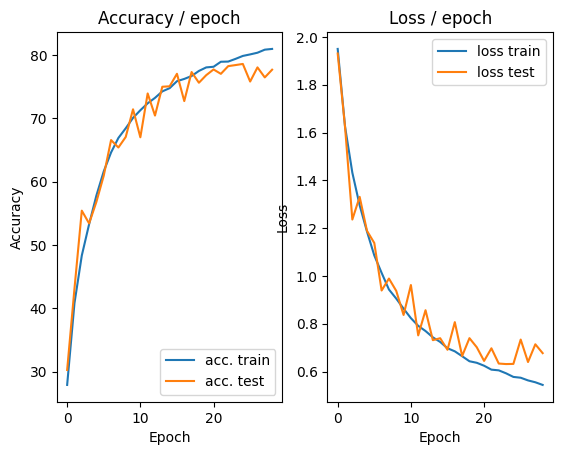

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.110s (0.110s)	Loss 0.6798 (0.6798)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.009s (0.025s)	Loss 0.4007 (0.5340)	Prec@1  85.9 ( 81.6)	Prec@5 100.0 ( 99.1)

===============> Total time 9s	Avg loss 0.5359	Avg Prec@1 81.51 %	Avg Prec@5 99.08 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.7303 (0.7303)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6845	Avg Prec@1 77.60 %	Avg Prec@5 98.42 %



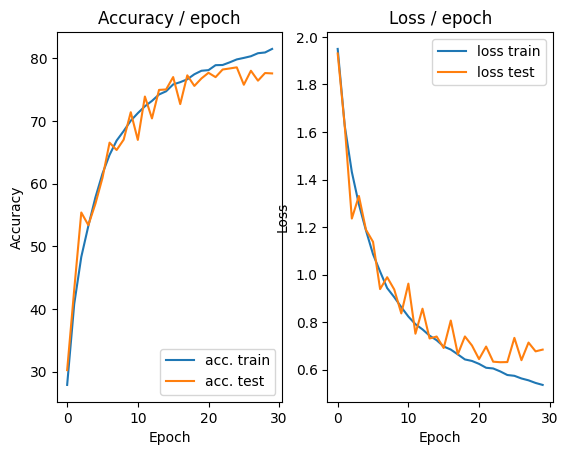

In [9]:
main(128, 0.1, 30, cuda=True)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.102s (0.102s)	Loss 2.3061 (2.3061)	Prec@1  12.5 ( 12.5)	Prec@5  43.0 ( 43.0)
[TRAIN Batch 200/391]	Time 0.037s (0.028s)	Loss 1.8423 (2.0436)	Prec@1  32.8 ( 23.7)	Prec@5  85.9 ( 75.7)

===============> Total time 11s	Avg loss 1.9341	Avg Prec@1 28.12 %	Avg Prec@5 80.51 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 1.6122 (1.6122)	Prec@1  42.2 ( 42.2)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.6449	Avg Prec@1 37.45 %	Avg Prec@5 89.83 %



<Figure size 640x480 with 0 Axes>

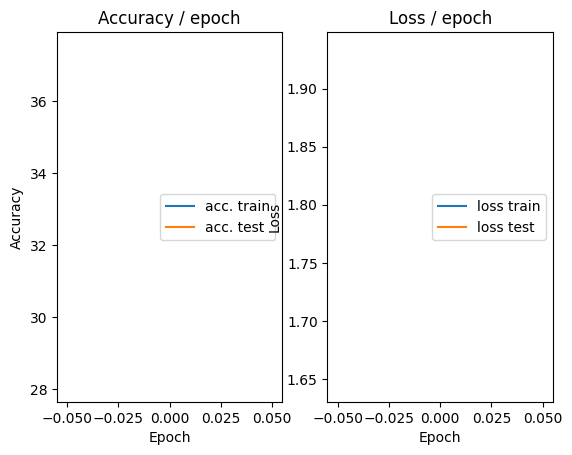

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.103s (0.103s)	Loss 1.7417 (1.7417)	Prec@1  31.2 ( 31.2)	Prec@5  84.4 ( 84.4)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 1.3799 (1.6686)	Prec@1  51.6 ( 38.6)	Prec@5  95.3 ( 88.7)

===============> Total time 10s	Avg loss 1.6097	Avg Prec@1 41.19 %	Avg Prec@5 89.72 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 1.4425 (1.4425)	Prec@1  56.2 ( 56.2)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.4640	Avg Prec@1 48.15 %	Avg Prec@5 91.91 %



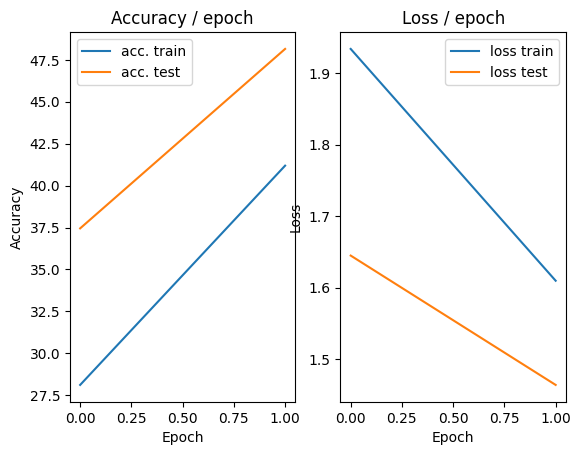

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.110s (0.110s)	Loss 1.6673 (1.6673)	Prec@1  35.9 ( 35.9)	Prec@5  88.3 ( 88.3)
[TRAIN Batch 200/391]	Time 0.042s (0.028s)	Loss 1.4645 (1.4469)	Prec@1  53.1 ( 48.0)	Prec@5  91.4 ( 92.3)

===============> Total time 10s	Avg loss 1.4166	Avg Prec@1 49.18 %	Avg Prec@5 92.66 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 1.3590 (1.3590)	Prec@1  57.8 ( 57.8)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.4044	Avg Prec@1 51.74 %	Avg Prec@5 92.43 %



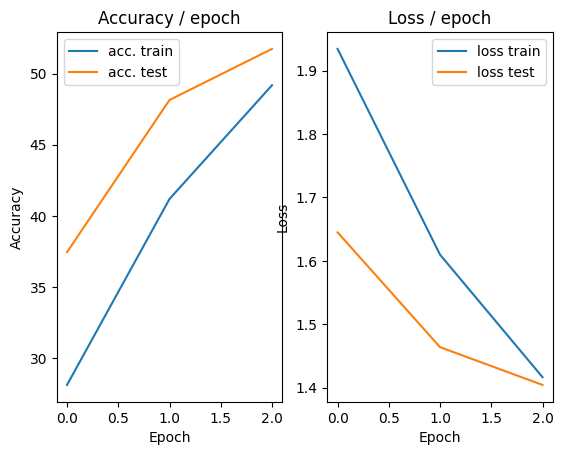

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.114s (0.114s)	Loss 1.3264 (1.3264)	Prec@1  55.5 ( 55.5)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.037s (0.027s)	Loss 1.2372 (1.3077)	Prec@1  53.1 ( 53.3)	Prec@5  98.4 ( 94.0)

===============> Total time 10s	Avg loss 1.2702	Avg Prec@1 54.68 %	Avg Prec@5 94.40 %

[EVAL Batch 000/079]	Time 0.070s (0.070s)	Loss 1.2683 (1.2683)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.3395	Avg Prec@1 51.93 %	Avg Prec@5 95.20 %



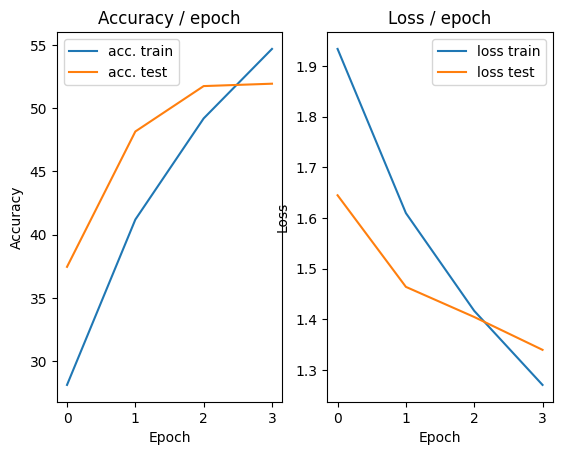

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.113s (0.113s)	Loss 1.2499 (1.2499)	Prec@1  57.8 ( 57.8)	Prec@5  93.0 ( 93.0)
[TRAIN Batch 200/391]	Time 0.007s (0.029s)	Loss 1.2169 (1.1964)	Prec@1  55.5 ( 57.6)	Prec@5  95.3 ( 94.9)

===============> Total time 10s	Avg loss 1.1755	Avg Prec@1 58.35 %	Avg Prec@5 95.18 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 1.0705 (1.0705)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0958	Avg Prec@1 61.99 %	Avg Prec@5 96.22 %



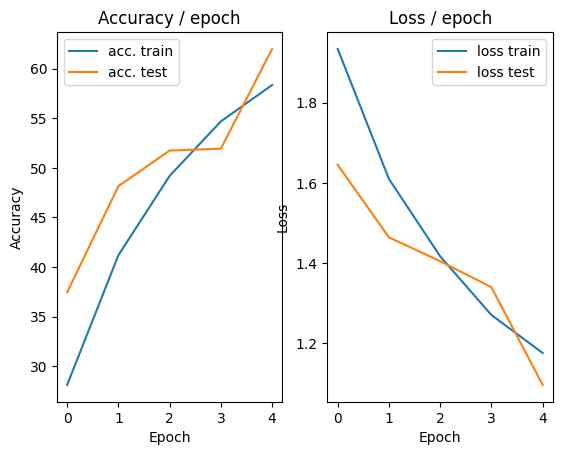

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 1.0930 (1.0930)	Prec@1  61.7 ( 61.7)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.036s (0.027s)	Loss 1.0743 (1.1011)	Prec@1  69.5 ( 61.1)	Prec@5  97.7 ( 96.0)

===============> Total time 10s	Avg loss 1.0809	Avg Prec@1 61.92 %	Avg Prec@5 96.17 %

[EVAL Batch 000/079]	Time 0.073s (0.073s)	Loss 1.1187 (1.1187)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2136	Avg Prec@1 58.87 %	Avg Prec@5 95.92 %



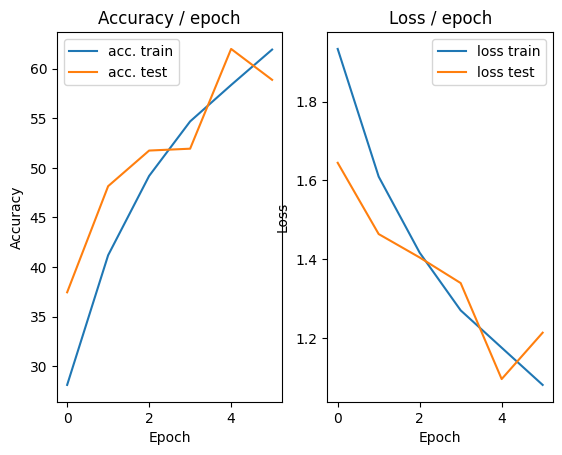

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 1.1847 (1.1847)	Prec@1  60.9 ( 60.9)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.006s (0.030s)	Loss 0.9546 (1.0157)	Prec@1  68.8 ( 64.3)	Prec@5  95.3 ( 96.4)

===============> Total time 13s	Avg loss 1.0117	Avg Prec@1 64.43 %	Avg Prec@5 96.46 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.8729 (0.8729)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9896	Avg Prec@1 65.77 %	Avg Prec@5 96.72 %



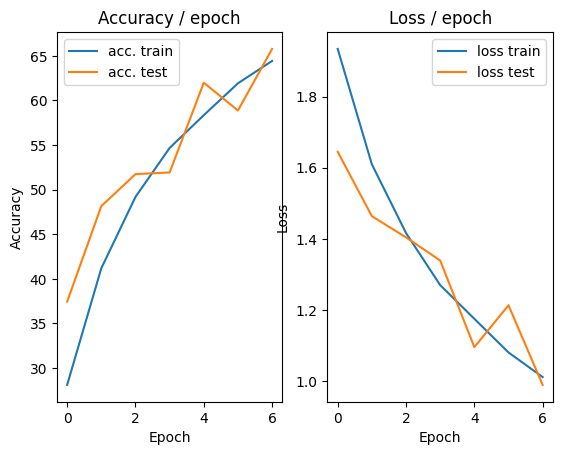

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 1.1397 (1.1397)	Prec@1  55.5 ( 55.5)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.030s (0.033s)	Loss 1.1443 (0.9595)	Prec@1  60.2 ( 66.4)	Prec@5  96.9 ( 96.8)

===============> Total time 13s	Avg loss 0.9525	Avg Prec@1 66.39 %	Avg Prec@5 96.96 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.9485 (0.9485)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9370	Avg Prec@1 67.52 %	Avg Prec@5 97.52 %



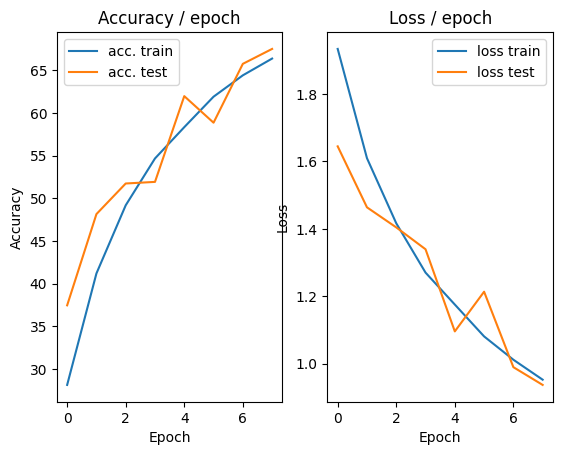

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.9400 (0.9400)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.015s (0.036s)	Loss 0.9685 (0.9255)	Prec@1  66.4 ( 67.8)	Prec@5  99.2 ( 97.2)

===============> Total time 12s	Avg loss 0.9098	Avg Prec@1 68.23 %	Avg Prec@5 97.29 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.9302 (0.9302)	Prec@1  65.6 ( 65.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.9323	Avg Prec@1 67.03 %	Avg Prec@5 97.59 %



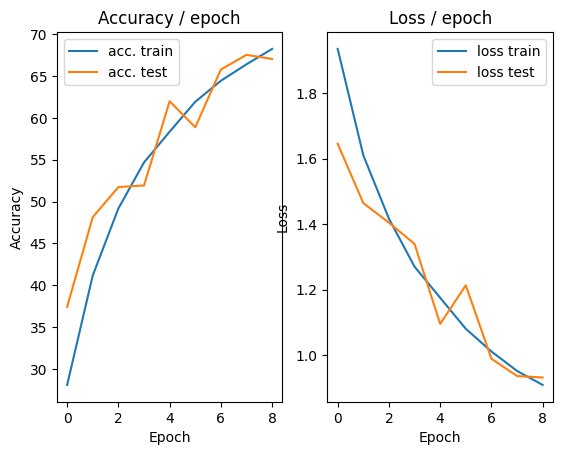

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.7634 (0.7634)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.048s (0.031s)	Loss 0.8361 (0.8849)	Prec@1  72.7 ( 69.2)	Prec@5  98.4 ( 97.3)

===============> Total time 11s	Avg loss 0.8671	Avg Prec@1 69.72 %	Avg Prec@5 97.47 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.8869 (0.8869)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9707	Avg Prec@1 67.63 %	Avg Prec@5 96.58 %



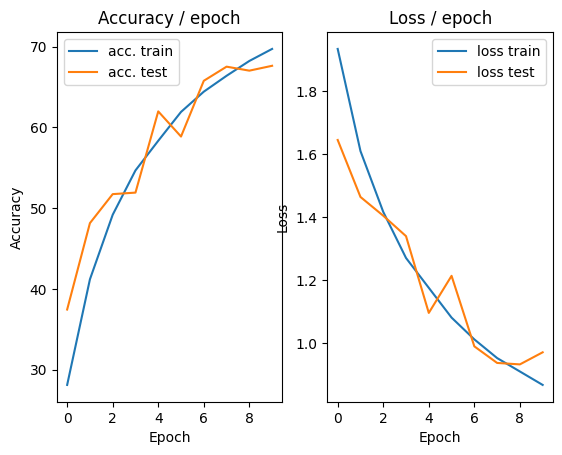

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 1.1591 (1.1591)	Prec@1  64.1 ( 64.1)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.040s (0.037s)	Loss 0.6997 (0.8362)	Prec@1  74.2 ( 70.9)	Prec@5  98.4 ( 97.7)

===============> Total time 12s	Avg loss 0.8334	Avg Prec@1 71.05 %	Avg Prec@5 97.73 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.8173 (0.8173)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7594	Avg Prec@1 74.16 %	Avg Prec@5 97.98 %



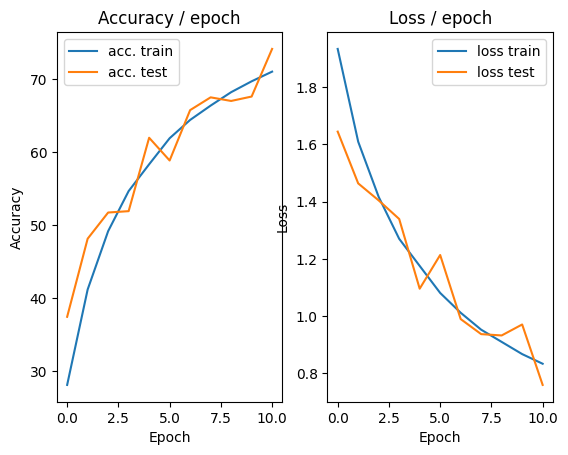

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.6419 (0.6419)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.039s (0.028s)	Loss 0.7853 (0.8086)	Prec@1  75.8 ( 71.6)	Prec@5  97.7 ( 98.0)

===============> Total time 10s	Avg loss 0.8003	Avg Prec@1 72.06 %	Avg Prec@5 97.94 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.8484 (0.8484)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8141	Avg Prec@1 72.12 %	Avg Prec@5 97.73 %



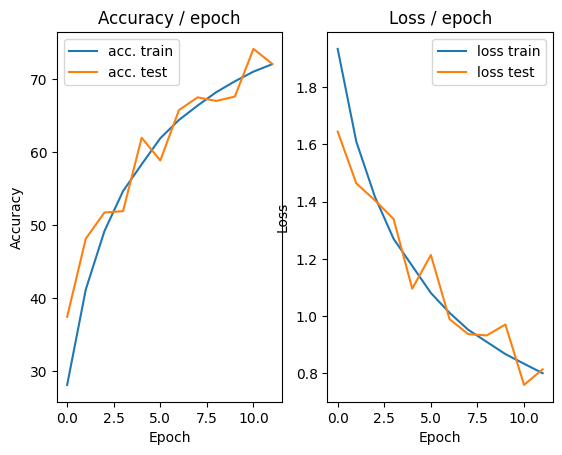

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.6616 (0.6616)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.055s (0.034s)	Loss 0.8834 (0.7817)	Prec@1  69.5 ( 72.7)	Prec@5  98.4 ( 98.1)

===============> Total time 11s	Avg loss 0.7716	Avg Prec@1 72.97 %	Avg Prec@5 98.09 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.7927 (0.7927)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7393	Avg Prec@1 74.78 %	Avg Prec@5 98.19 %



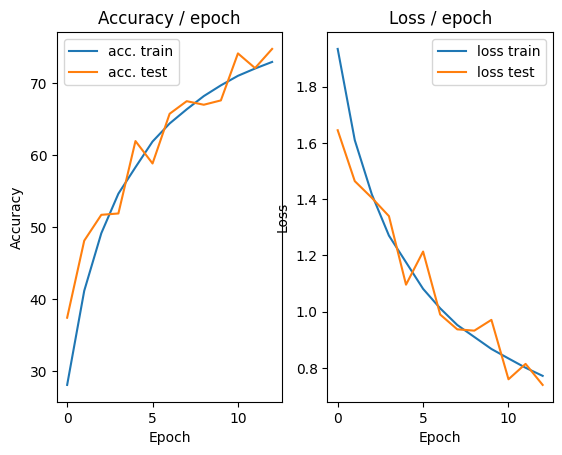

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.6787 (0.6787)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.044s (0.027s)	Loss 0.7859 (0.7523)	Prec@1  76.6 ( 73.9)	Prec@5  97.7 ( 98.0)

===============> Total time 10s	Avg loss 0.7483	Avg Prec@1 73.92 %	Avg Prec@5 98.14 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.8990 (0.8990)	Prec@1  69.5 ( 69.5)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 0.8483	Avg Prec@1 71.59 %	Avg Prec@5 97.65 %



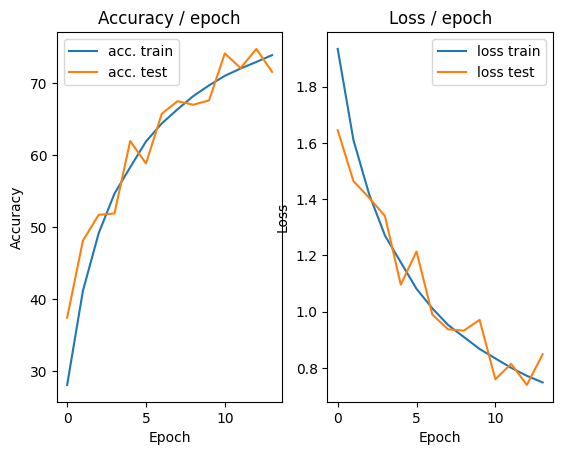

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.8395 (0.8395)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.080s (0.030s)	Loss 0.8156 (0.7290)	Prec@1  72.7 ( 74.7)	Prec@5  98.4 ( 98.3)

===============> Total time 12s	Avg loss 0.7315	Avg Prec@1 74.56 %	Avg Prec@5 98.24 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.7710 (0.7710)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7283	Avg Prec@1 74.99 %	Avg Prec@5 98.36 %



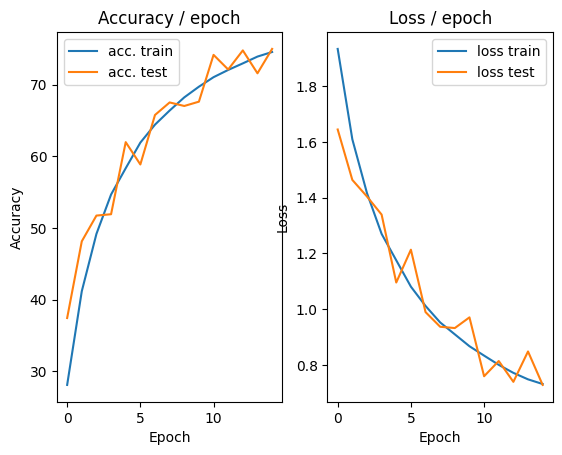

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.7344 (0.7344)	Prec@1  71.1 ( 71.1)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.010s (0.033s)	Loss 0.5891 (0.7033)	Prec@1  81.2 ( 75.7)	Prec@5  98.4 ( 98.4)

===============> Total time 12s	Avg loss 0.7090	Avg Prec@1 75.47 %	Avg Prec@5 98.31 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 0.7521 (0.7521)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7274	Avg Prec@1 75.26 %	Avg Prec@5 98.30 %



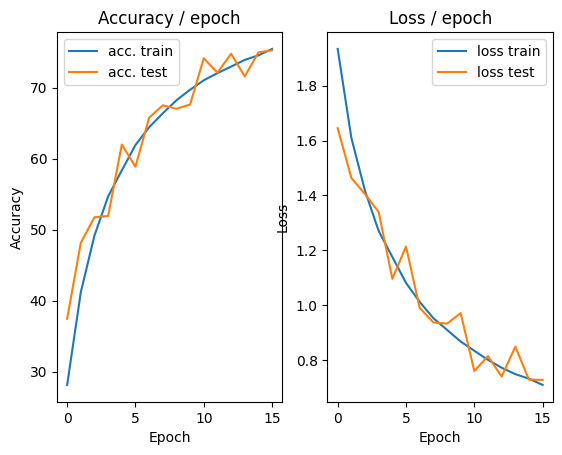

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.6963 (0.6963)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.043s (0.030s)	Loss 0.5522 (0.6973)	Prec@1  81.2 ( 75.9)	Prec@5  97.7 ( 98.5)

===============> Total time 11s	Avg loss 0.6944	Avg Prec@1 75.91 %	Avg Prec@5 98.52 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.7661 (0.7661)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7407	Avg Prec@1 74.23 %	Avg Prec@5 98.60 %



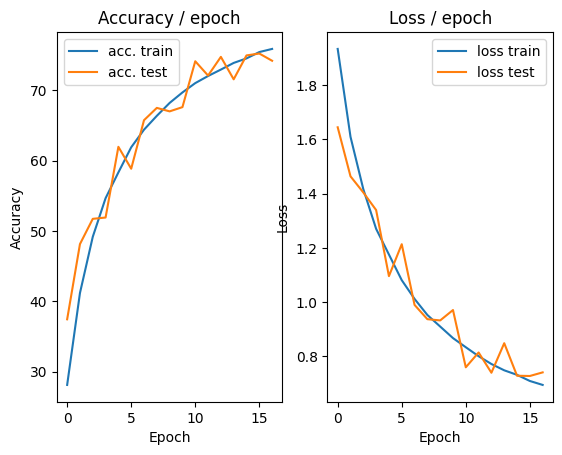

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.6604 (0.6604)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.038s (0.034s)	Loss 0.6536 (0.6809)	Prec@1  78.1 ( 76.4)	Prec@5  98.4 ( 98.4)

===============> Total time 13s	Avg loss 0.6772	Avg Prec@1 76.33 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.8592 (0.8592)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6839	Avg Prec@1 76.77 %	Avg Prec@5 98.60 %



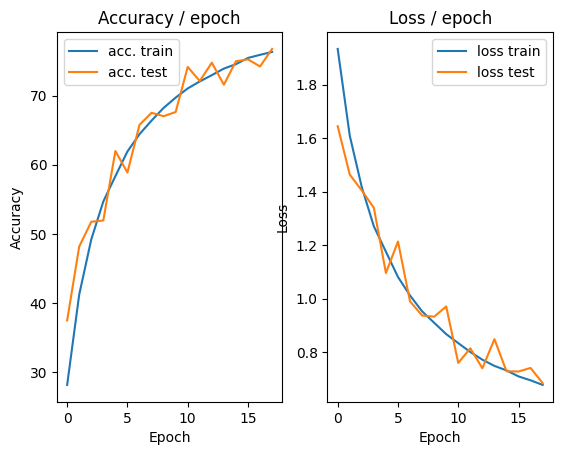

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.6703 (0.6703)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.050s (0.032s)	Loss 0.7782 (0.6621)	Prec@1  72.7 ( 76.9)	Prec@5  96.9 ( 98.6)

===============> Total time 12s	Avg loss 0.6575	Avg Prec@1 77.02 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.094s (0.094s)	Loss 0.8009 (0.8009)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6759	Avg Prec@1 76.94 %	Avg Prec@5 98.60 %



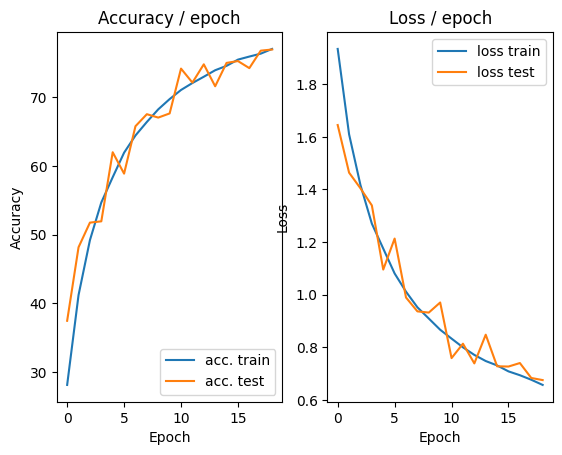

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.6844 (0.6844)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.042s (0.035s)	Loss 0.6941 (0.6402)	Prec@1  74.2 ( 77.5)	Prec@5  97.7 ( 98.7)

===============> Total time 12s	Avg loss 0.6432	Avg Prec@1 77.48 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.7889 (0.7889)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6982	Avg Prec@1 76.20 %	Avg Prec@5 98.61 %



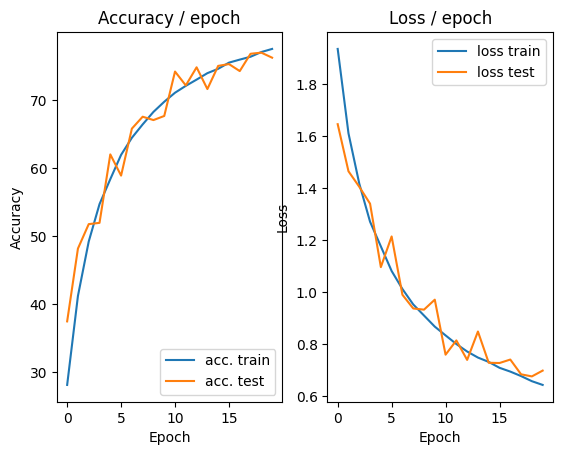

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.6348 (0.6348)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.033s)	Loss 0.7124 (0.6287)	Prec@1  77.3 ( 77.8)	Prec@5  97.7 ( 98.7)

===============> Total time 12s	Avg loss 0.6342	Avg Prec@1 77.76 %	Avg Prec@5 98.71 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.6757 (0.6757)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6662	Avg Prec@1 77.65 %	Avg Prec@5 98.60 %



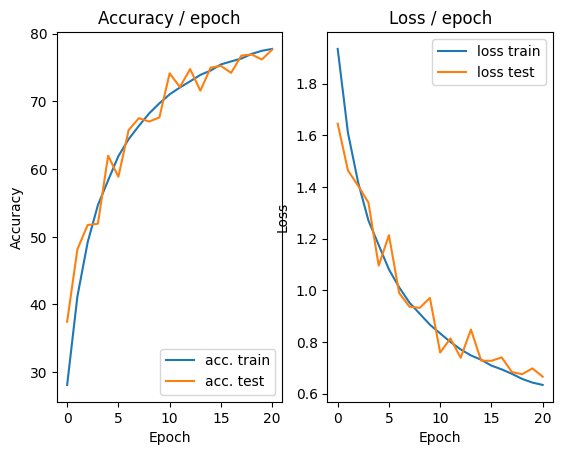

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.4410 (0.4410)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.013s (0.029s)	Loss 0.6965 (0.6222)	Prec@1  72.7 ( 78.2)	Prec@5 100.0 ( 98.6)

===============> Total time 11s	Avg loss 0.6224	Avg Prec@1 78.19 %	Avg Prec@5 98.71 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 0.6884 (0.6884)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6558	Avg Prec@1 77.86 %	Avg Prec@5 98.53 %



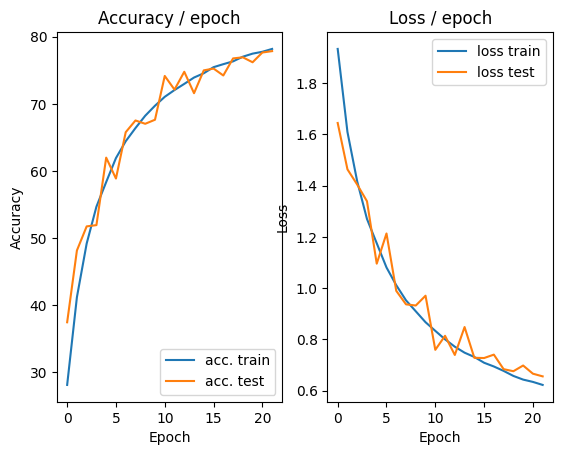

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.6188 (0.6188)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.135s (0.029s)	Loss 0.4757 (0.6066)	Prec@1  82.8 ( 78.9)	Prec@5  98.4 ( 98.8)

===============> Total time 11s	Avg loss 0.6123	Avg Prec@1 78.80 %	Avg Prec@5 98.78 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 0.7192 (0.7192)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6284	Avg Prec@1 78.96 %	Avg Prec@5 98.66 %



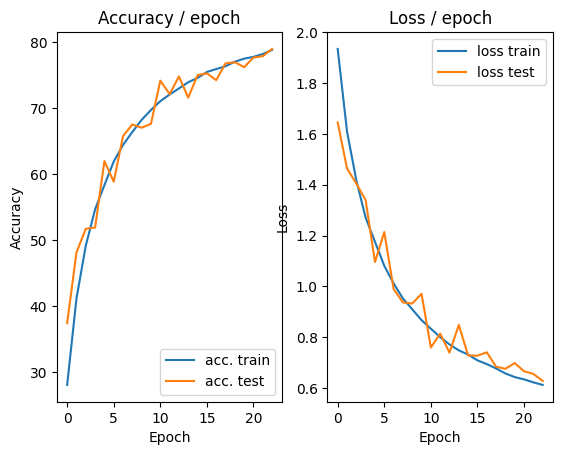

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.4995 (0.4995)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.057s (0.031s)	Loss 0.4823 (0.5931)	Prec@1  85.2 ( 79.1)	Prec@5  99.2 ( 98.8)

===============> Total time 11s	Avg loss 0.5957	Avg Prec@1 79.14 %	Avg Prec@5 98.78 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.7598 (0.7598)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.6969	Avg Prec@1 76.43 %	Avg Prec@5 98.38 %



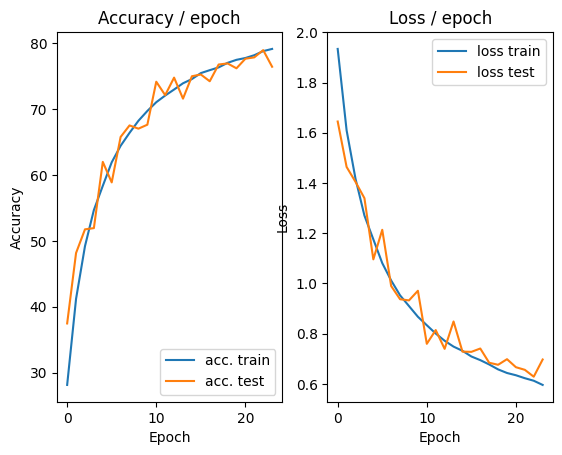

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.7375 (0.7375)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.066s (0.034s)	Loss 0.4827 (0.6018)	Prec@1  85.9 ( 79.2)	Prec@5  97.7 ( 98.9)

===============> Total time 12s	Avg loss 0.5960	Avg Prec@1 79.38 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.094s (0.094s)	Loss 0.7188 (0.7188)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6379	Avg Prec@1 78.47 %	Avg Prec@5 98.64 %



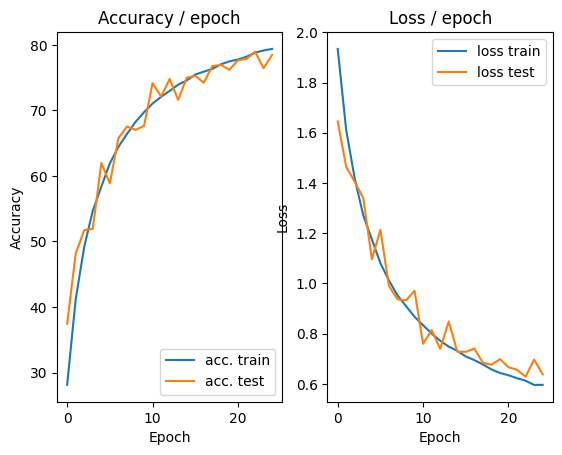

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.7406 (0.7406)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.020s (0.032s)	Loss 0.6158 (0.5780)	Prec@1  79.7 ( 79.8)	Prec@5  98.4 ( 98.9)

===============> Total time 11s	Avg loss 0.5803	Avg Prec@1 79.80 %	Avg Prec@5 98.87 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.7828 (0.7828)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6738	Avg Prec@1 77.48 %	Avg Prec@5 98.49 %



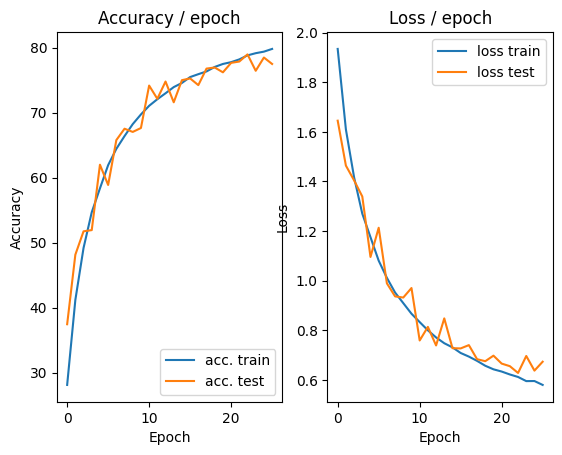

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.6606 (0.6606)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.043s (0.030s)	Loss 0.5506 (0.5700)	Prec@1  82.0 ( 80.1)	Prec@5  97.7 ( 99.0)

===============> Total time 11s	Avg loss 0.5721	Avg Prec@1 80.03 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.6264 (0.6264)	Prec@1  80.5 ( 80.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.6752	Avg Prec@1 77.19 %	Avg Prec@5 98.67 %



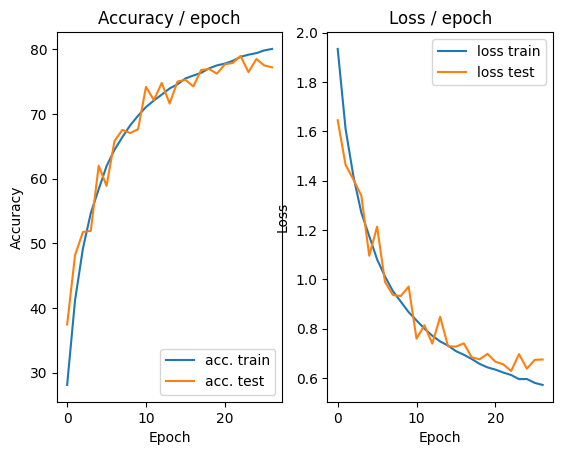

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.5527 (0.5527)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.042s (0.036s)	Loss 0.5740 (0.5594)	Prec@1  79.7 ( 80.4)	Prec@5  99.2 ( 99.0)

===============> Total time 12s	Avg loss 0.5639	Avg Prec@1 80.16 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.6117 (0.6117)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5978	Avg Prec@1 79.91 %	Avg Prec@5 98.56 %



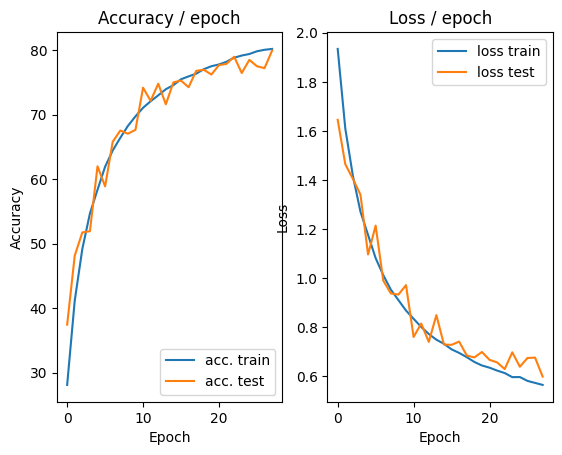

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.5508 (0.5508)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.039s (0.028s)	Loss 0.4998 (0.5376)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5500	Avg Prec@1 80.97 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 0.5610 (0.5610)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6053	Avg Prec@1 79.94 %	Avg Prec@5 98.69 %



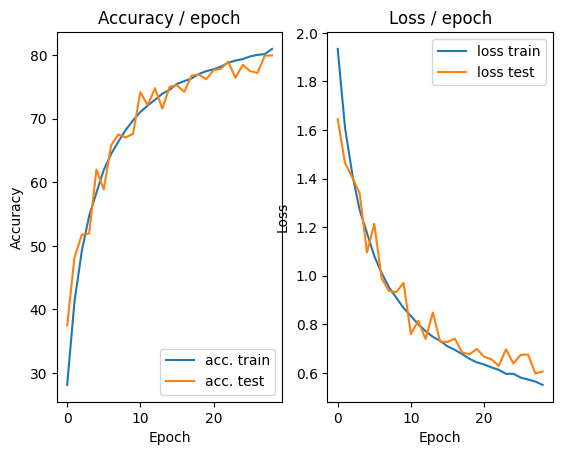

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.5360 (0.5360)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.042s (0.028s)	Loss 0.5763 (0.5454)	Prec@1  79.7 ( 80.8)	Prec@5  99.2 ( 99.1)

===============> Total time 11s	Avg loss 0.5458	Avg Prec@1 80.83 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 0.6589 (0.6589)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5888	Avg Prec@1 80.14 %	Avg Prec@5 98.74 %



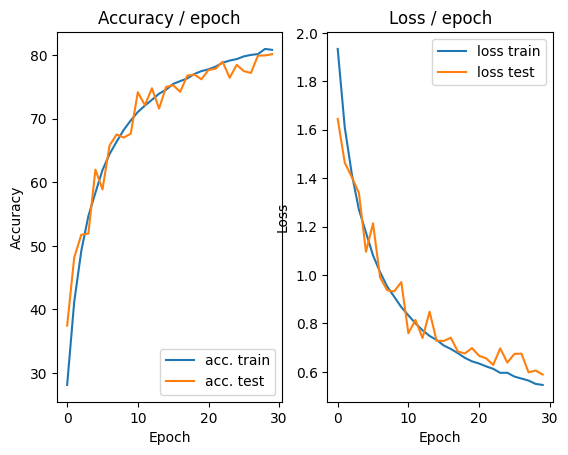

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.4161 (0.4161)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.043s (0.029s)	Loss 0.4774 (0.5316)	Prec@1  84.4 ( 81.6)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5376	Avg Prec@1 81.25 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.6318 (0.6318)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6130	Avg Prec@1 79.77 %	Avg Prec@5 98.85 %



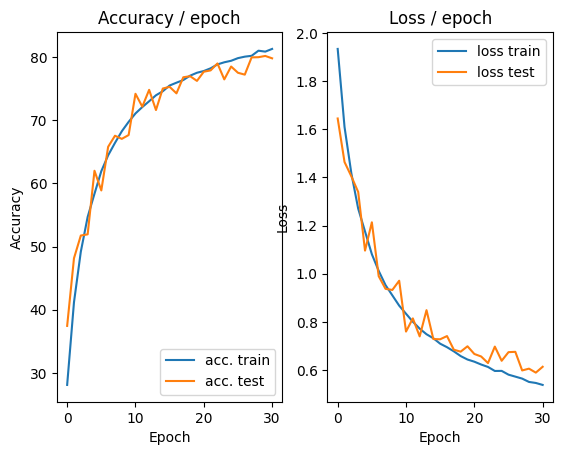

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 0.4786 (0.4786)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.043s (0.026s)	Loss 0.3335 (0.5213)	Prec@1  90.6 ( 81.8)	Prec@5 100.0 ( 99.1)

===============> Total time 10s	Avg loss 0.5271	Avg Prec@1 81.59 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 0.5571 (0.5571)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5941	Avg Prec@1 80.33 %	Avg Prec@5 98.64 %



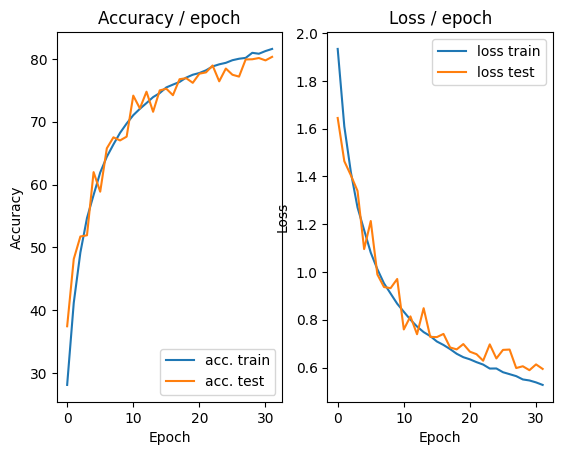

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.4675 (0.4675)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.017s (0.027s)	Loss 0.5060 (0.5202)	Prec@1  81.2 ( 81.8)	Prec@5  98.4 ( 99.1)

===============> Total time 10s	Avg loss 0.5217	Avg Prec@1 81.75 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.6597 (0.6597)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6205	Avg Prec@1 79.14 %	Avg Prec@5 98.72 %



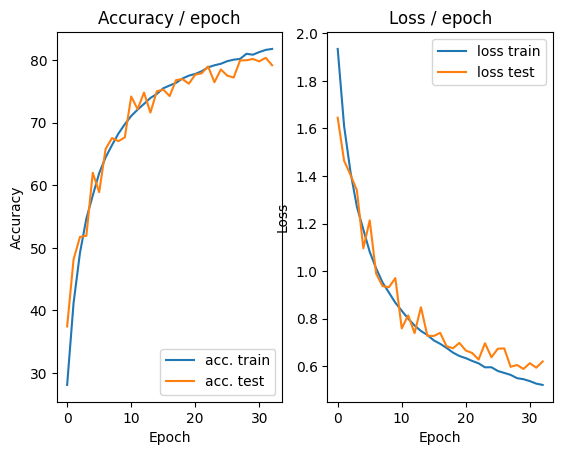

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.6436 (0.6436)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.051s (0.030s)	Loss 0.5107 (0.5134)	Prec@1  81.2 ( 81.8)	Prec@5  99.2 ( 99.2)

===============> Total time 13s	Avg loss 0.5166	Avg Prec@1 81.73 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.6515 (0.6515)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6094	Avg Prec@1 79.88 %	Avg Prec@5 98.57 %



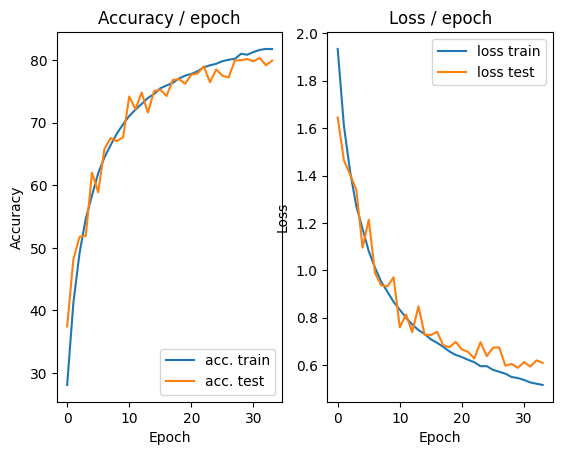

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.5062 (0.5062)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.006s (0.031s)	Loss 0.4273 (0.5038)	Prec@1  86.7 ( 82.5)	Prec@5  99.2 ( 99.3)

===============> Total time 11s	Avg loss 0.5063	Avg Prec@1 82.38 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.5677 (0.5677)	Prec@1  85.2 ( 85.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5953	Avg Prec@1 80.16 %	Avg Prec@5 98.75 %



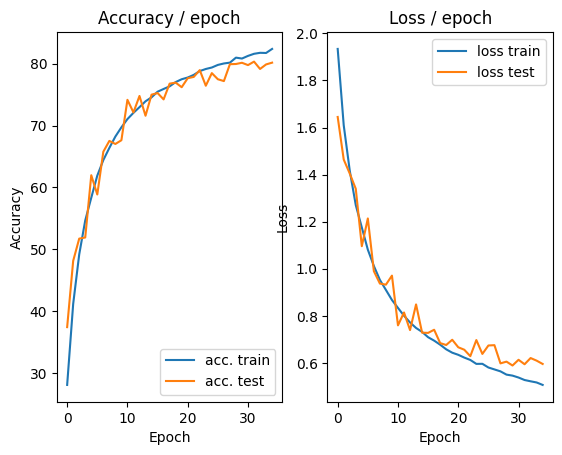

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.4627 (0.4627)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.042s (0.029s)	Loss 0.5003 (0.5053)	Prec@1  80.5 ( 82.3)	Prec@5  99.2 ( 99.3)

===============> Total time 11s	Avg loss 0.5057	Avg Prec@1 82.31 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 0.6560 (0.6560)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6018	Avg Prec@1 80.41 %	Avg Prec@5 98.48 %



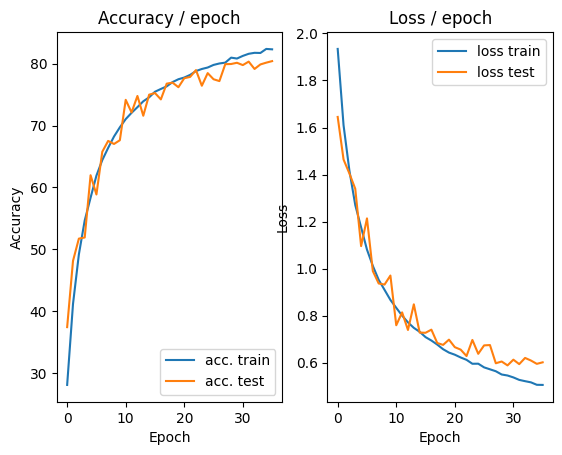

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.5215 (0.5215)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.089s (0.027s)	Loss 0.3581 (0.4948)	Prec@1  85.9 ( 82.6)	Prec@5 100.0 ( 99.2)

===============> Total time 11s	Avg loss 0.4965	Avg Prec@1 82.74 %	Avg Prec@5 99.20 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 0.5663 (0.5663)	Prec@1  84.4 ( 84.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6218	Avg Prec@1 80.25 %	Avg Prec@5 98.64 %



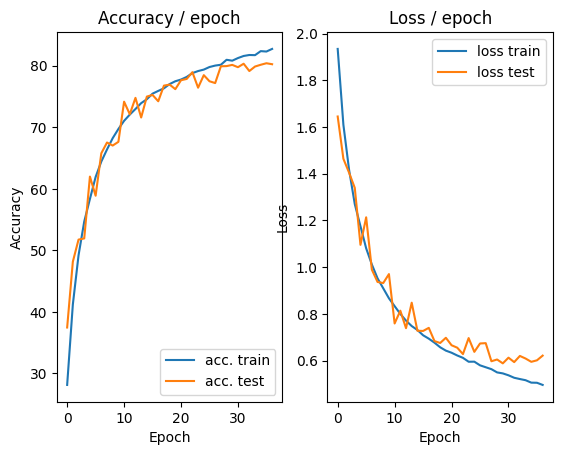

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 0.4629 (0.4629)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.075s (0.040s)	Loss 0.4845 (0.4822)	Prec@1  85.2 ( 83.1)	Prec@5  99.2 ( 99.3)

===============> Total time 14s	Avg loss 0.4914	Avg Prec@1 82.79 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 0.5945 (0.5945)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6056	Avg Prec@1 80.40 %	Avg Prec@5 98.51 %



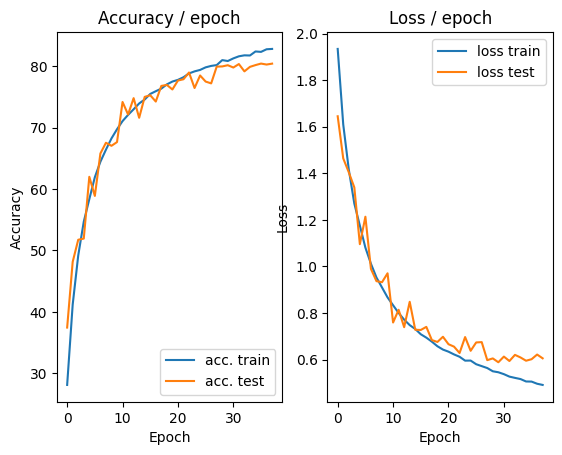

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.4981 (0.4981)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.008s (0.037s)	Loss 0.4033 (0.4894)	Prec@1  84.4 ( 83.0)	Prec@5  99.2 ( 99.2)

===============> Total time 13s	Avg loss 0.4851	Avg Prec@1 83.04 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.7557 (0.7557)	Prec@1  78.1 ( 78.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.6585	Avg Prec@1 78.25 %	Avg Prec@5 98.34 %



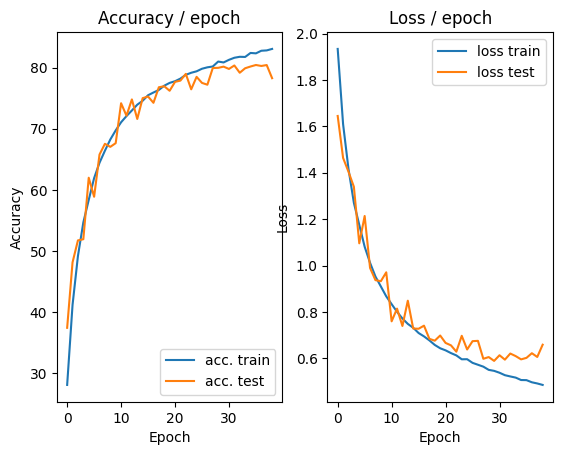

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.5759 (0.5759)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.048s (0.034s)	Loss 0.4640 (0.4826)	Prec@1  82.0 ( 83.3)	Prec@5 100.0 ( 99.3)

===============> Total time 12s	Avg loss 0.4776	Avg Prec@1 83.46 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.6685 (0.6685)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.6457	Avg Prec@1 78.39 %	Avg Prec@5 98.42 %



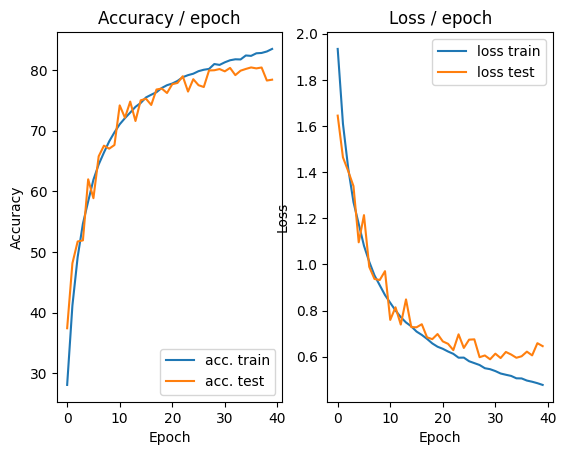

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.5606 (0.5606)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.022s (0.030s)	Loss 0.4400 (0.4748)	Prec@1  85.2 ( 83.5)	Prec@5 100.0 ( 99.3)

===============> Total time 11s	Avg loss 0.4792	Avg Prec@1 83.30 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.6761 (0.6761)	Prec@1  81.2 ( 81.2)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.6183	Avg Prec@1 80.11 %	Avg Prec@5 98.59 %



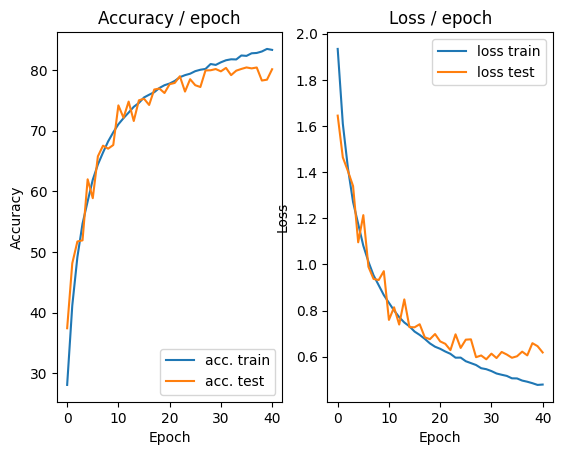

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3531 (0.3531)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.012s (0.030s)	Loss 0.4901 (0.4735)	Prec@1  86.7 ( 83.4)	Prec@5  98.4 ( 99.3)

===============> Total time 11s	Avg loss 0.4760	Avg Prec@1 83.40 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.5749 (0.5749)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5712	Avg Prec@1 81.52 %	Avg Prec@5 98.82 %



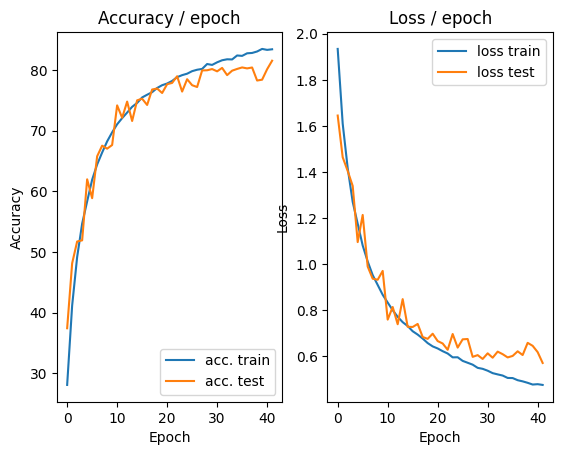

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.3968 (0.3968)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.038s (0.031s)	Loss 0.2942 (0.4573)	Prec@1  91.4 ( 84.1)	Prec@5  99.2 ( 99.3)

===============> Total time 11s	Avg loss 0.4617	Avg Prec@1 83.92 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.6339 (0.6339)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6093	Avg Prec@1 80.69 %	Avg Prec@5 98.85 %



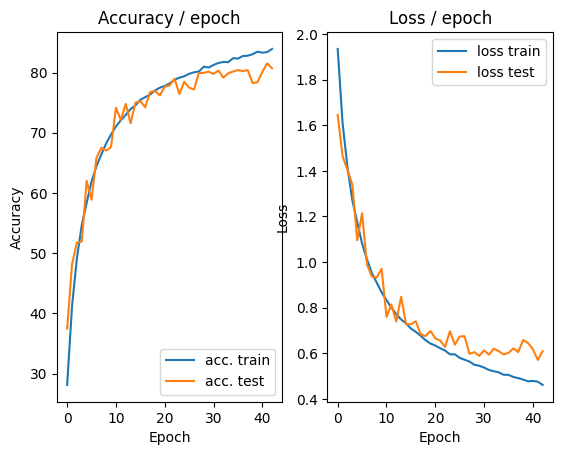

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.5185 (0.5185)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.047s (0.029s)	Loss 0.4141 (0.4614)	Prec@1  82.0 ( 83.8)	Prec@5  99.2 ( 99.4)

===============> Total time 11s	Avg loss 0.4639	Avg Prec@1 83.87 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.7672 (0.7672)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6346	Avg Prec@1 79.43 %	Avg Prec@5 98.66 %



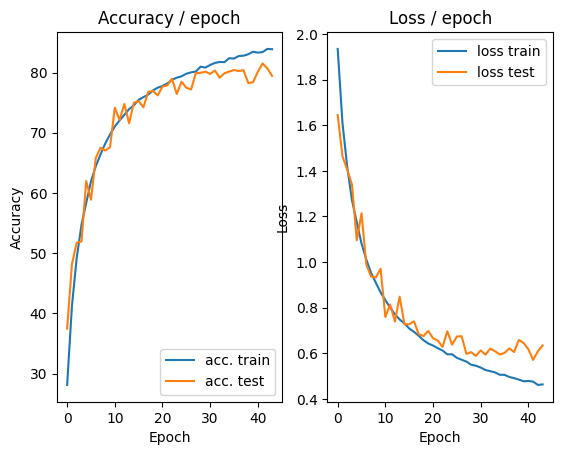

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.5680 (0.5680)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.009s (0.031s)	Loss 0.3639 (0.4494)	Prec@1  86.7 ( 84.3)	Prec@5  99.2 ( 99.4)

===============> Total time 11s	Avg loss 0.4622	Avg Prec@1 83.84 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.6037 (0.6037)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5844	Avg Prec@1 81.13 %	Avg Prec@5 98.92 %



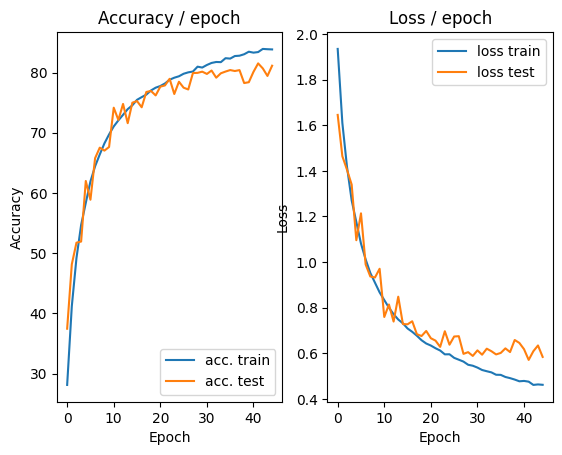

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 0.3190 (0.3190)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.051s (0.035s)	Loss 0.3750 (0.4482)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 ( 99.3)

===============> Total time 12s	Avg loss 0.4548	Avg Prec@1 84.20 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.6167 (0.6167)	Prec@1  82.0 ( 82.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.6116	Avg Prec@1 80.90 %	Avg Prec@5 98.66 %



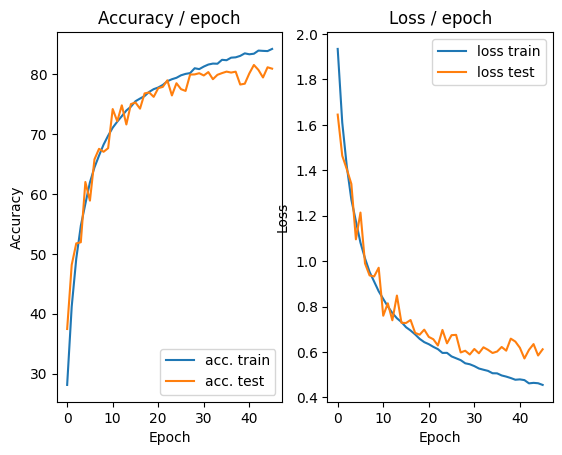

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.3945 (0.3945)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.117s (0.031s)	Loss 0.3486 (0.4514)	Prec@1  89.8 ( 84.5)	Prec@5 100.0 ( 99.3)

===============> Total time 11s	Avg loss 0.4506	Avg Prec@1 84.26 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.5689 (0.5689)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5692	Avg Prec@1 81.80 %	Avg Prec@5 98.91 %



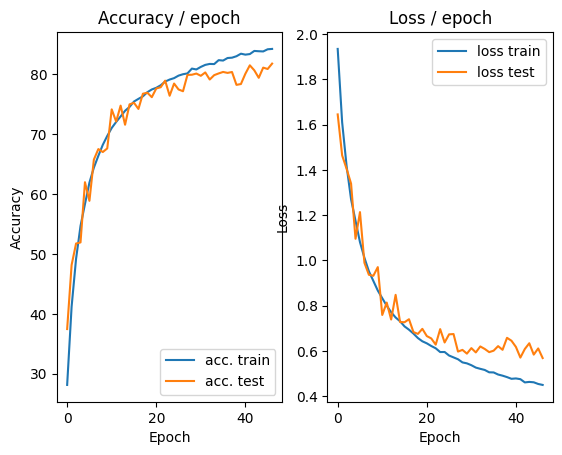

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.4226 (0.4226)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.047s (0.029s)	Loss 0.4958 (0.4423)	Prec@1  82.0 ( 84.3)	Prec@5  99.2 ( 99.4)

===============> Total time 11s	Avg loss 0.4410	Avg Prec@1 84.45 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.5717 (0.5717)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5945	Avg Prec@1 81.35 %	Avg Prec@5 98.79 %



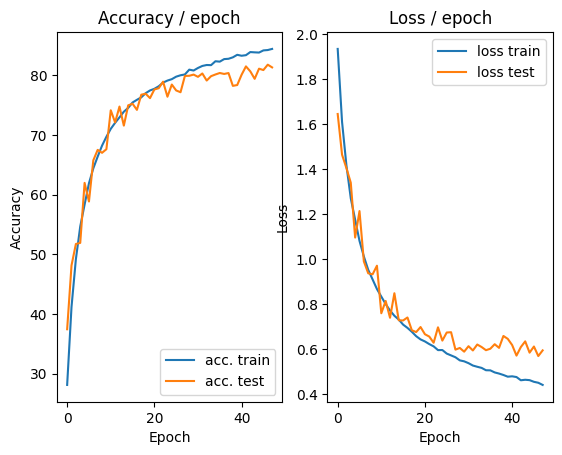

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.4744 (0.4744)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.048s (0.030s)	Loss 0.4502 (0.4388)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.4)

===============> Total time 11s	Avg loss 0.4466	Avg Prec@1 84.25 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.5651 (0.5651)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5612	Avg Prec@1 81.21 %	Avg Prec@5 98.91 %



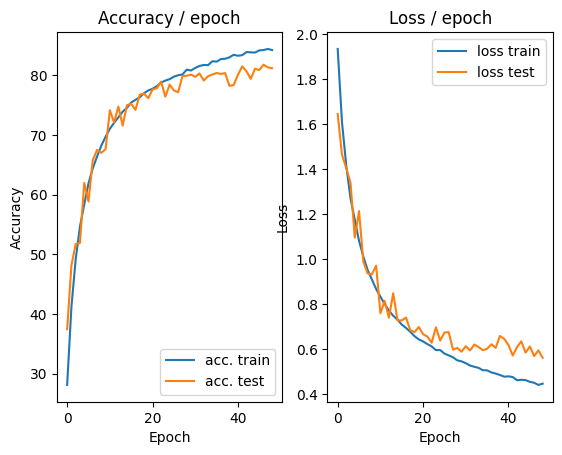

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.3838 (0.3838)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.043s (0.029s)	Loss 0.4528 (0.4327)	Prec@1  82.8 ( 84.9)	Prec@5 100.0 ( 99.4)

===============> Total time 11s	Avg loss 0.4385	Avg Prec@1 84.70 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.6473 (0.6473)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5946	Avg Prec@1 81.34 %	Avg Prec@5 98.70 %



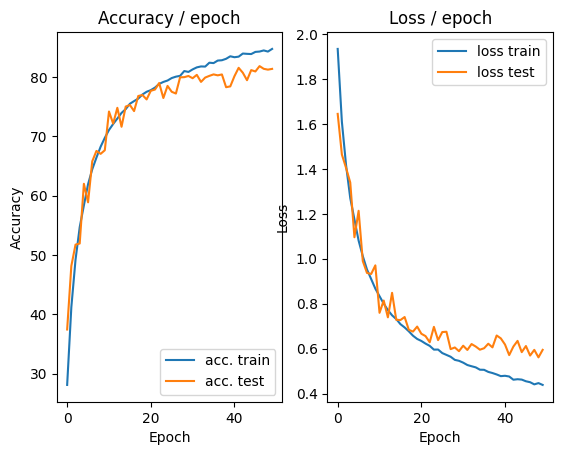

In [10]:
main(128, 0.1, 50, cuda=True)

# 3.3 Variants on the optimization algorithm

In [11]:
class ConvNet(nn.Module):
    """
    Cette classe définit la structure du réseau neuronal convolutif.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # Définition des couches convolutives et de pooling pour extraire les caractéristiques
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True),
        )
        # Couches fully connected pour la classification
        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Remarque : Pas besoin d'ajouter la couche softmax ici, car elle est incluse dans la fonction de perte
        )



    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le jeu de données CIFAR-10 et applique les transformations nécessaires,
    y compris la normalisation.
    """
    # Valeurs de normalisation pour CIFAR-10
    mean = [0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]

    # Transformations à appliquer sur les images
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),  # Flips aléatoires pour augmenter les données
        transforms.RandomCrop(28, padding=4),  # Découpage aléatoire
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)  # Normalisation
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Chargement des jeux de données d'entraînement et de validation
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True, transform=val_transform)

    # Création des DataLoader pour parcourir les jeux de données par batch
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                                               pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False,
                                             pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Effectue un passage (epoch) sur les données `data` avec le modèle `model`.
    Évalue la perte avec `criterion`. Si `optimizer` est fourni, fait une étape d'entraînement,
    sinon fait une évaluation.
    """
    model.eval() if optimizer is None else model.train()

    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()

    tic = time.time()
    for i, (input, target) in enumerate(data):
        if cuda:
            input = input.cuda()
            target = target.cuda()

        # Forward pass
        output = model(input)
        loss = criterion(output, target)

        # Backward pass si on est en mode entraînement
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Calcul des métriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # Mise à jour des métriques moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)

        # Affichage des informations
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time,
                   loss=avg_loss, top1=avg_top1_acc, top5=avg_top5_acc))

    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss

import torch.optim.lr_scheduler

def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        print(f"Current learning rate: {optimizer.param_groups[0]['lr']:.6f}")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # Update the learning rate
        lr_scheduler.step()
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

Current learning rate: 0.100000
[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 2.3062 (2.3062)	Prec@1   8.6 (  8.6)	Prec@5  48.4 ( 48.4)
[TRAIN Batch 200/391]	Time 0.032s (0.032s)	Loss 1.9940 (2.0334)	Prec@1  29.7 ( 24.1)	Prec@5  78.9 ( 76.1)

===============> Total time 12s	Avg loss 1.9283	Avg Prec@1 28.46 %	Avg Prec@5 80.71 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 1.6488 (1.6488)	Prec@1  39.1 ( 39.1)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.6362	Avg Prec@1 40.57 %	Avg Prec@5 90.47 %



<Figure size 640x480 with 0 Axes>

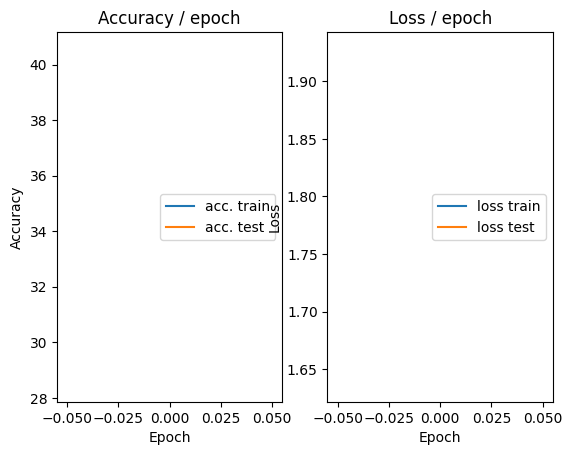

=== EPOCH 2 =====

Current learning rate: 0.095000
[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.7814 (1.7814)	Prec@1  37.5 ( 37.5)	Prec@5  84.4 ( 84.4)
[TRAIN Batch 200/391]	Time 0.049s (0.035s)	Loss 1.8489 (1.6562)	Prec@1  39.1 ( 39.2)	Prec@5  82.0 ( 89.4)

===============> Total time 12s	Avg loss 1.6044	Avg Prec@1 41.43 %	Avg Prec@5 90.09 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 1.4731 (1.4731)	Prec@1  51.6 ( 51.6)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.4919	Avg Prec@1 47.38 %	Avg Prec@5 92.48 %



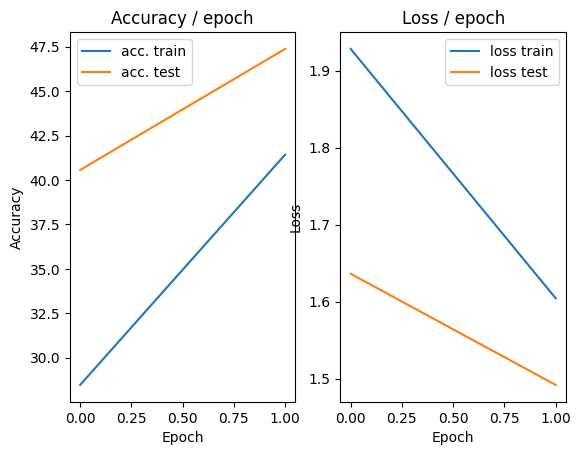

=== EPOCH 3 =====

Current learning rate: 0.090250
[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 1.5424 (1.5424)	Prec@1  44.5 ( 44.5)	Prec@5  90.6 ( 90.6)
[TRAIN Batch 200/391]	Time 0.037s (0.027s)	Loss 1.4259 (1.4512)	Prec@1  46.9 ( 47.6)	Prec@5  94.5 ( 92.4)

===============> Total time 10s	Avg loss 1.4174	Avg Prec@1 48.80 %	Avg Prec@5 92.80 %

[EVAL Batch 000/079]	Time 0.073s (0.073s)	Loss 1.2766 (1.2766)	Prec@1  58.6 ( 58.6)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.3667	Avg Prec@1 51.25 %	Avg Prec@5 92.99 %



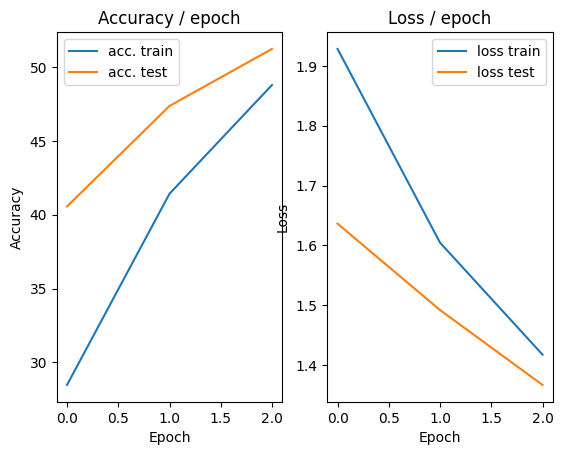

=== EPOCH 4 =====

Current learning rate: 0.085737
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 1.6184 (1.6184)	Prec@1  46.1 ( 46.1)	Prec@5  91.4 ( 91.4)
[TRAIN Batch 200/391]	Time 0.033s (0.027s)	Loss 1.1846 (1.3001)	Prec@1  58.6 ( 53.7)	Prec@5  97.7 ( 94.1)

===============> Total time 10s	Avg loss 1.2771	Avg Prec@1 54.38 %	Avg Prec@5 94.40 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.9995 (0.9995)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1487	Avg Prec@1 58.53 %	Avg Prec@5 95.56 %



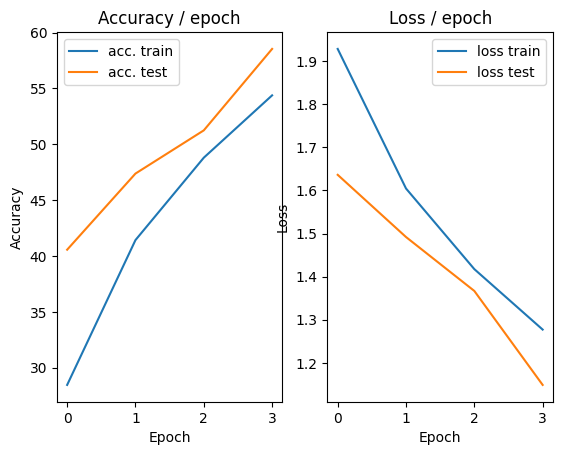

=== EPOCH 5 =====

Current learning rate: 0.081451
[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 1.0418 (1.0418)	Prec@1  59.4 ( 59.4)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.038s (0.027s)	Loss 1.1172 (1.1751)	Prec@1  59.4 ( 58.3)	Prec@5  96.1 ( 95.4)

===============> Total time 10s	Avg loss 1.1660	Avg Prec@1 58.57 %	Avg Prec@5 95.40 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 1.0571 (1.0571)	Prec@1  69.5 ( 69.5)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1431	Avg Prec@1 60.73 %	Avg Prec@5 95.96 %



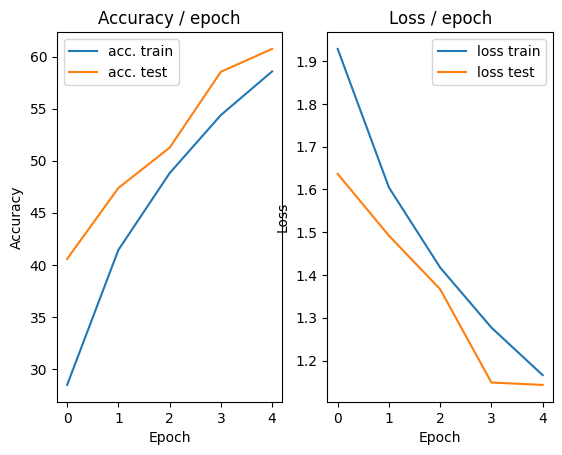

=== EPOCH 6 =====

Current learning rate: 0.077378
[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 1.1520 (1.1520)	Prec@1  53.1 ( 53.1)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.045s (0.030s)	Loss 0.9757 (1.0808)	Prec@1  64.1 ( 61.9)	Prec@5  99.2 ( 95.9)

===============> Total time 11s	Avg loss 1.0712	Avg Prec@1 62.45 %	Avg Prec@5 96.04 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.9432 (0.9432)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0034	Avg Prec@1 64.74 %	Avg Prec@5 96.61 %



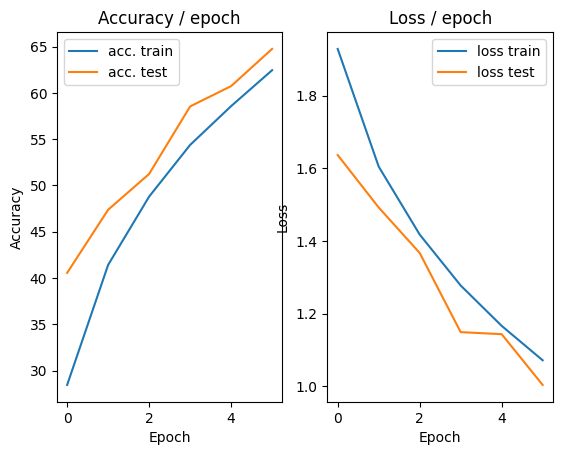

=== EPOCH 7 =====

Current learning rate: 0.073509
[TRAIN Batch 000/391]	Time 0.113s (0.113s)	Loss 1.1416 (1.1416)	Prec@1  60.9 ( 60.9)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.009s (0.027s)	Loss 1.0681 (0.9961)	Prec@1  60.2 ( 64.6)	Prec@5  96.9 ( 96.8)

===============> Total time 10s	Avg loss 0.9931	Avg Prec@1 64.96 %	Avg Prec@5 96.78 %

[EVAL Batch 000/079]	Time 0.070s (0.070s)	Loss 0.9724 (0.9724)	Prec@1  64.1 ( 64.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0109	Avg Prec@1 63.72 %	Avg Prec@5 96.98 %



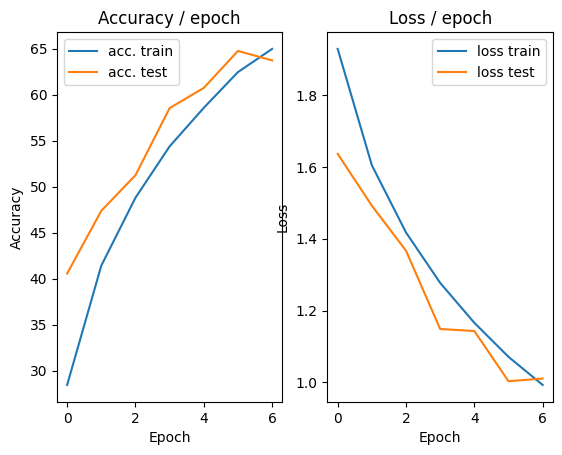

=== EPOCH 8 =====

Current learning rate: 0.069834
[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.9340 (0.9340)	Prec@1  65.6 ( 65.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.087s (0.030s)	Loss 0.8862 (0.9558)	Prec@1  72.7 ( 66.5)	Prec@5  96.1 ( 97.0)

===============> Total time 12s	Avg loss 0.9428	Avg Prec@1 66.90 %	Avg Prec@5 97.09 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8161 (0.8161)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9297	Avg Prec@1 67.69 %	Avg Prec@5 97.16 %



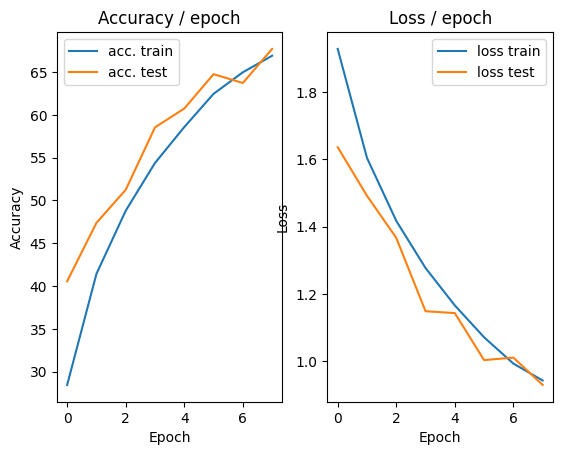

=== EPOCH 9 =====

Current learning rate: 0.066342
[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.9979 (0.9979)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.046s (0.030s)	Loss 1.0791 (0.9010)	Prec@1  60.9 ( 68.9)	Prec@5  97.7 ( 97.3)

===============> Total time 11s	Avg loss 0.8909	Avg Prec@1 68.95 %	Avg Prec@5 97.29 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.8858 (0.8858)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0367	Avg Prec@1 66.86 %	Avg Prec@5 96.30 %



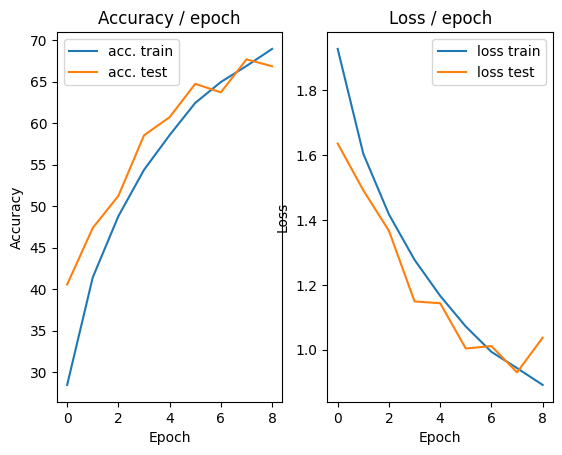

=== EPOCH 10 =====

Current learning rate: 0.063025
[TRAIN Batch 000/391]	Time 0.113s (0.113s)	Loss 1.0036 (1.0036)	Prec@1  68.8 ( 68.8)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.7382 (0.8537)	Prec@1  75.0 ( 70.0)	Prec@5  98.4 ( 97.5)

===============> Total time 10s	Avg loss 0.8529	Avg Prec@1 70.06 %	Avg Prec@5 97.64 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.7295 (0.7295)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8454	Avg Prec@1 70.38 %	Avg Prec@5 97.60 %



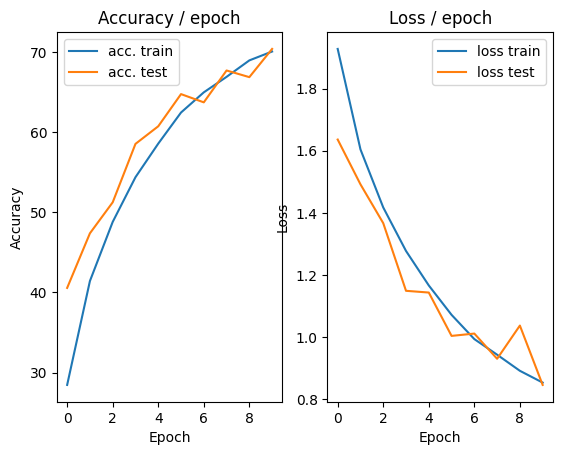

=== EPOCH 11 =====

Current learning rate: 0.059874
[TRAIN Batch 000/391]	Time 0.109s (0.109s)	Loss 0.6424 (0.6424)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.027s)	Loss 0.9107 (0.8184)	Prec@1  66.4 ( 71.3)	Prec@5  97.7 ( 97.8)

===============> Total time 10s	Avg loss 0.8135	Avg Prec@1 71.60 %	Avg Prec@5 97.80 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.9307 (0.9307)	Prec@1  71.9 ( 71.9)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 0.9023	Avg Prec@1 70.13 %	Avg Prec@5 97.31 %



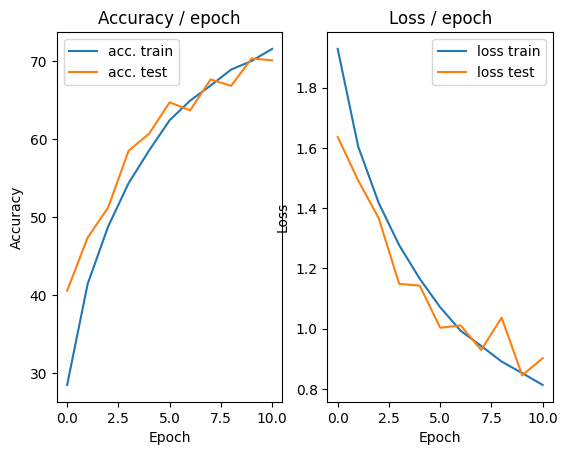

=== EPOCH 12 =====

Current learning rate: 0.056880
[TRAIN Batch 000/391]	Time 0.110s (0.110s)	Loss 0.8074 (0.8074)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.055s (0.027s)	Loss 0.8130 (0.7875)	Prec@1  71.9 ( 72.5)	Prec@5  99.2 ( 97.9)

===============> Total time 10s	Avg loss 0.7792	Avg Prec@1 72.65 %	Avg Prec@5 97.94 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.8344 (0.8344)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8025	Avg Prec@1 72.14 %	Avg Prec@5 97.89 %



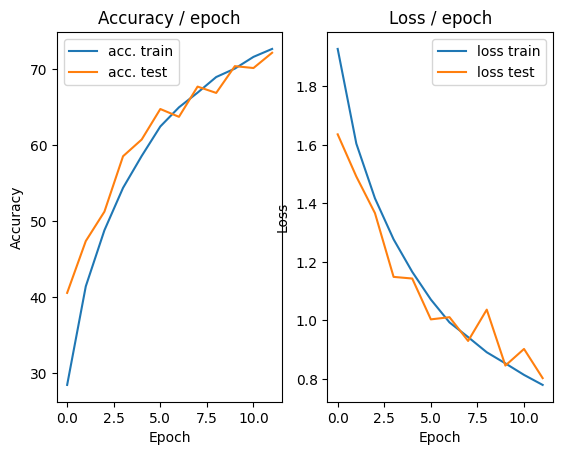

=== EPOCH 13 =====

Current learning rate: 0.054036
[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.6548 (0.6548)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.006s (0.027s)	Loss 0.7008 (0.7614)	Prec@1  73.4 ( 73.2)	Prec@5 100.0 ( 98.2)

===============> Total time 11s	Avg loss 0.7557	Avg Prec@1 73.46 %	Avg Prec@5 98.17 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.7923 (0.7923)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7855	Avg Prec@1 72.68 %	Avg Prec@5 98.10 %



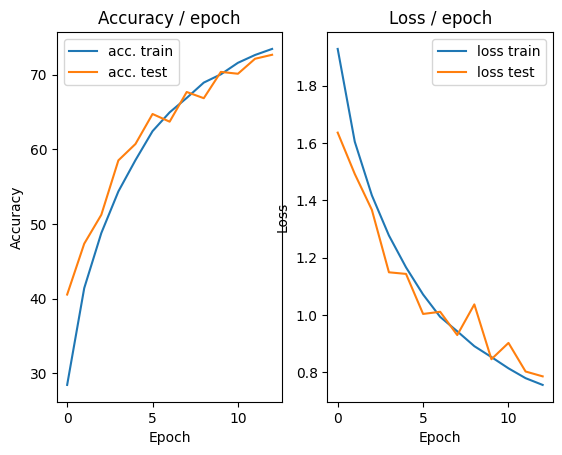

=== EPOCH 14 =====

Current learning rate: 0.051334
[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.7330 (0.7330)	Prec@1  68.8 ( 68.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.049s (0.028s)	Loss 0.6115 (0.7328)	Prec@1  76.6 ( 74.2)	Prec@5 100.0 ( 98.4)

===============> Total time 10s	Avg loss 0.7339	Avg Prec@1 74.31 %	Avg Prec@5 98.34 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.6992 (0.6992)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7100	Avg Prec@1 75.24 %	Avg Prec@5 98.33 %



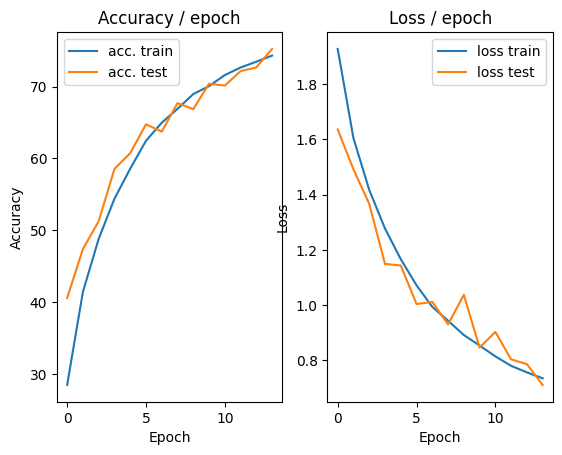

=== EPOCH 15 =====

Current learning rate: 0.048767
[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.6311 (0.6311)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.049s (0.028s)	Loss 0.7845 (0.7030)	Prec@1  74.2 ( 75.5)	Prec@5  96.9 ( 98.4)

===============> Total time 10s	Avg loss 0.7056	Avg Prec@1 75.34 %	Avg Prec@5 98.44 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.6386 (0.6386)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7146	Avg Prec@1 75.21 %	Avg Prec@5 98.39 %



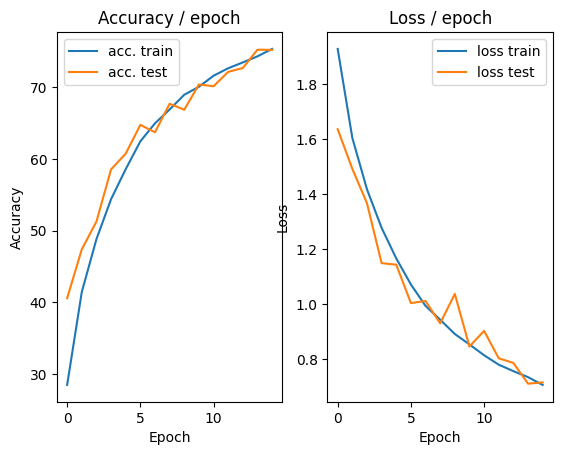

=== EPOCH 16 =====

Current learning rate: 0.046329
[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.7672 (0.7672)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.6098 (0.6947)	Prec@1  75.0 ( 75.6)	Prec@5  98.4 ( 98.4)

===============> Total time 10s	Avg loss 0.6926	Avg Prec@1 75.87 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.7171 (0.7171)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6834	Avg Prec@1 76.51 %	Avg Prec@5 98.76 %



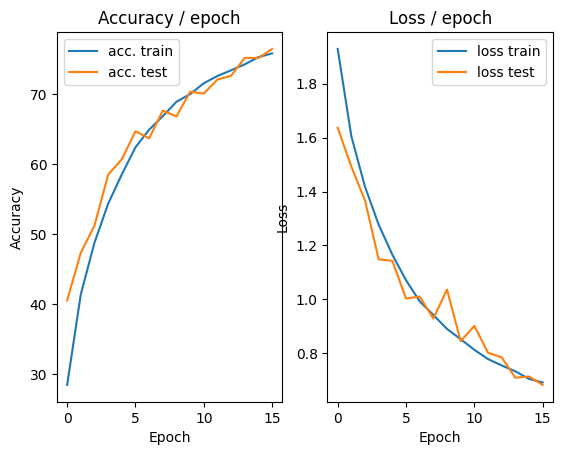

=== EPOCH 17 =====

Current learning rate: 0.044013
[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 0.6745 (0.6745)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.048s (0.027s)	Loss 0.6467 (0.6711)	Prec@1  75.8 ( 76.6)	Prec@5  97.7 ( 98.6)

===============> Total time 10s	Avg loss 0.6748	Avg Prec@1 76.32 %	Avg Prec@5 98.56 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.7049 (0.7049)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7052	Avg Prec@1 75.70 %	Avg Prec@5 98.26 %



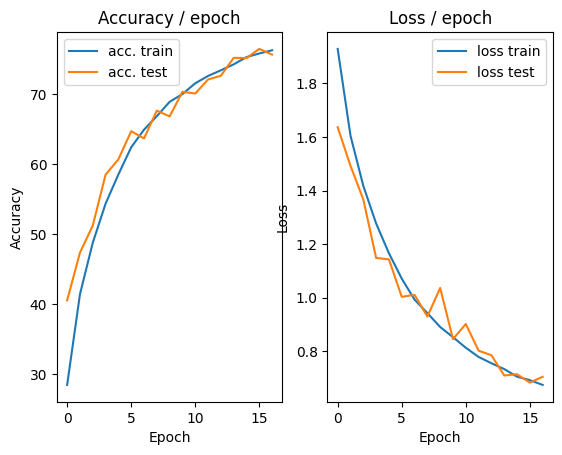

=== EPOCH 18 =====

Current learning rate: 0.041812
[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.7036 (0.7036)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.047s (0.027s)	Loss 0.5612 (0.6551)	Prec@1  83.6 ( 77.1)	Prec@5  99.2 ( 98.6)

===============> Total time 10s	Avg loss 0.6568	Avg Prec@1 77.03 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.6882 (0.6882)	Prec@1  81.2 ( 81.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.6676	Avg Prec@1 77.46 %	Avg Prec@5 98.61 %



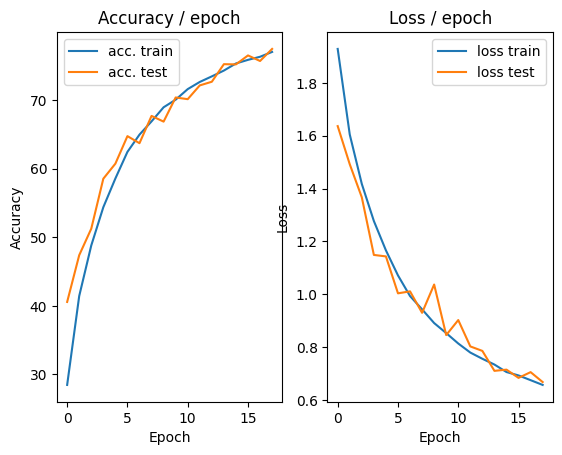

=== EPOCH 19 =====

Current learning rate: 0.039721
[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.6285 (0.6285)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.026s (0.027s)	Loss 0.5914 (0.6384)	Prec@1  82.0 ( 77.7)	Prec@5  98.4 ( 98.6)

===============> Total time 10s	Avg loss 0.6391	Avg Prec@1 77.75 %	Avg Prec@5 98.67 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.7463 (0.7463)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6852	Avg Prec@1 76.41 %	Avg Prec@5 98.61 %



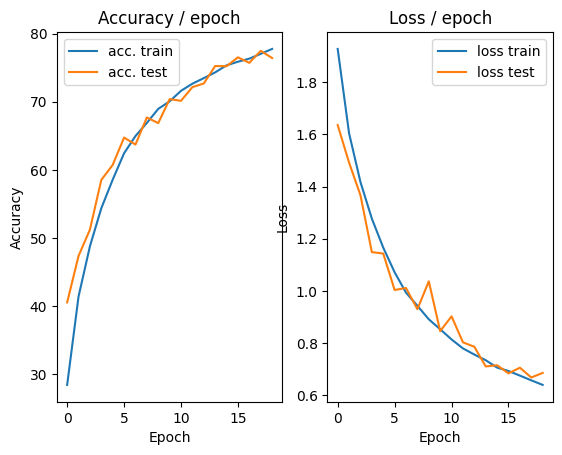

=== EPOCH 20 =====

Current learning rate: 0.037735
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.7926 (0.7926)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.5588 (0.6307)	Prec@1  79.7 ( 78.0)	Prec@5 100.0 ( 98.8)

===============> Total time 10s	Avg loss 0.6236	Avg Prec@1 78.26 %	Avg Prec@5 98.78 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.6082 (0.6082)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6326	Avg Prec@1 78.43 %	Avg Prec@5 98.75 %



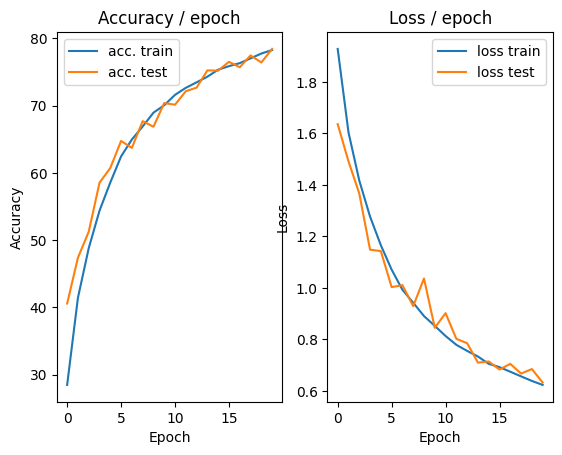

=== EPOCH 21 =====

Current learning rate: 0.035849
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.5715 (0.5715)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.049s (0.028s)	Loss 0.4744 (0.6120)	Prec@1  85.9 ( 78.6)	Prec@5  99.2 ( 98.8)

===============> Total time 10s	Avg loss 0.6079	Avg Prec@1 78.78 %	Avg Prec@5 98.83 %

[EVAL Batch 000/079]	Time 0.071s (0.071s)	Loss 0.7053 (0.7053)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6661	Avg Prec@1 77.27 %	Avg Prec@5 98.47 %



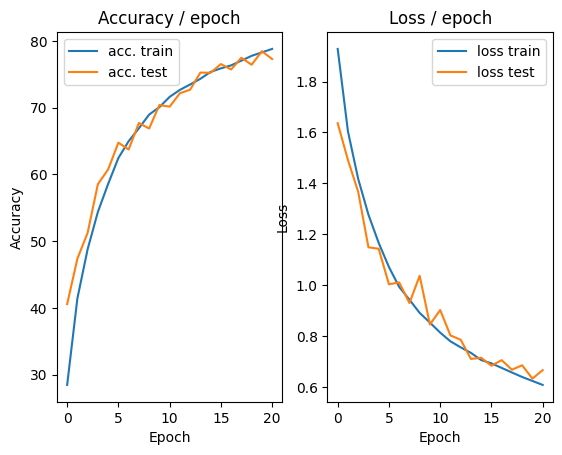

=== EPOCH 22 =====

Current learning rate: 0.034056
[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.7069 (0.7069)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.017s (0.026s)	Loss 0.6961 (0.6036)	Prec@1  75.0 ( 78.5)	Prec@5  99.2 ( 98.8)

===============> Total time 10s	Avg loss 0.6002	Avg Prec@1 78.80 %	Avg Prec@5 98.84 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.7428 (0.7428)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6442	Avg Prec@1 78.36 %	Avg Prec@5 98.89 %



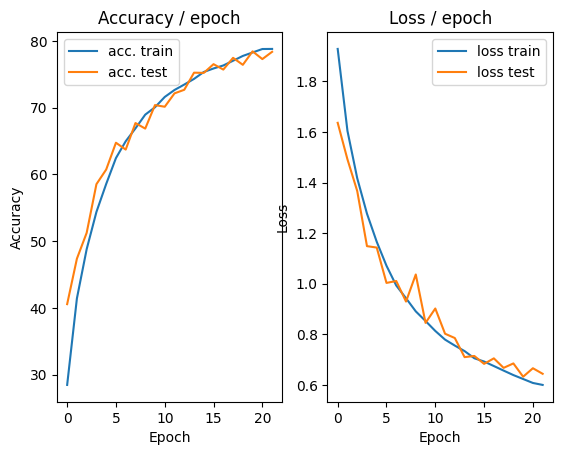

=== EPOCH 23 =====

Current learning rate: 0.032353
[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.4885 (0.4885)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.042s (0.027s)	Loss 0.6522 (0.5944)	Prec@1  77.3 ( 78.9)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.5863	Avg Prec@1 79.23 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.6839 (0.6839)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6659	Avg Prec@1 77.52 %	Avg Prec@5 98.66 %



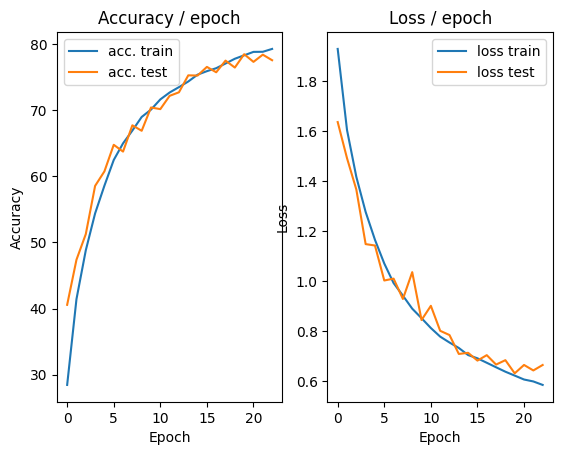

=== EPOCH 24 =====

Current learning rate: 0.030736
[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 0.5928 (0.5928)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.046s (0.028s)	Loss 0.5687 (0.5757)	Prec@1  82.0 ( 80.0)	Prec@5  99.2 ( 99.0)

===============> Total time 11s	Avg loss 0.5764	Avg Prec@1 79.82 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.070s (0.070s)	Loss 0.7299 (0.7299)	Prec@1  80.5 ( 80.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.6432	Avg Prec@1 78.20 %	Avg Prec@5 98.76 %



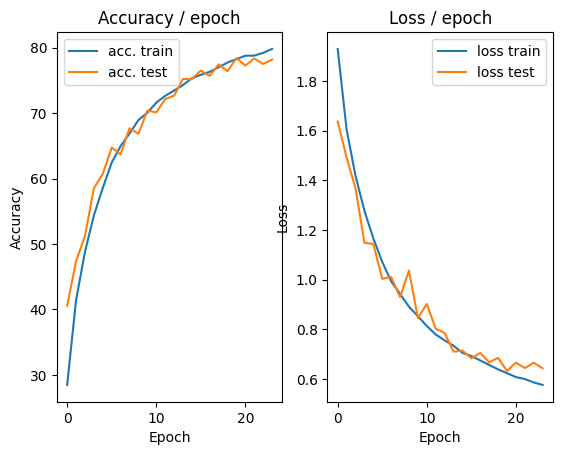

=== EPOCH 25 =====

Current learning rate: 0.029199
[TRAIN Batch 000/391]	Time 0.114s (0.114s)	Loss 0.4414 (0.4414)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.050s (0.030s)	Loss 0.7658 (0.5622)	Prec@1  73.4 ( 80.3)	Prec@5  99.2 ( 99.0)

===============> Total time 13s	Avg loss 0.5656	Avg Prec@1 80.22 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.6367 (0.6367)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6098	Avg Prec@1 78.94 %	Avg Prec@5 98.75 %



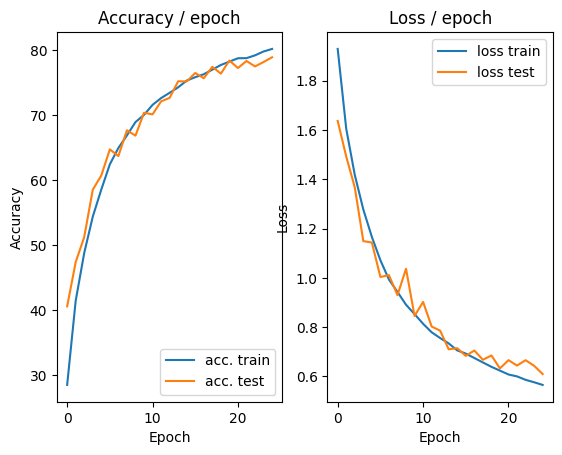

=== EPOCH 26 =====

Current learning rate: 0.027739
[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.5645 (0.5645)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.040s (0.029s)	Loss 0.4390 (0.5439)	Prec@1  85.2 ( 80.8)	Prec@5  99.2 ( 99.0)

===============> Total time 10s	Avg loss 0.5505	Avg Prec@1 80.70 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.6630 (0.6630)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6222	Avg Prec@1 78.77 %	Avg Prec@5 98.76 %



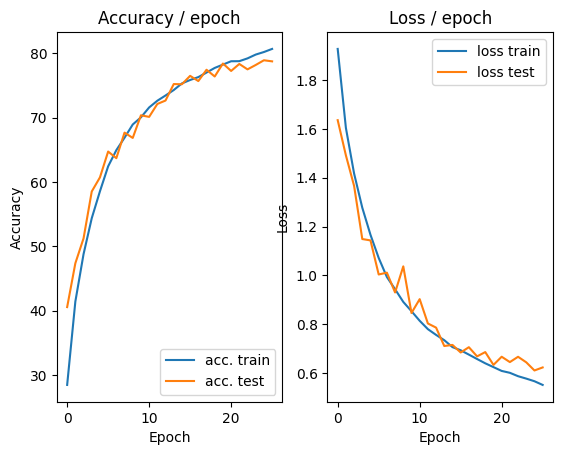

=== EPOCH 27 =====

Current learning rate: 0.026352
[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.5382 (0.5382)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.007s (0.027s)	Loss 0.5772 (0.5392)	Prec@1  79.7 ( 81.2)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5453	Avg Prec@1 80.95 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.067s (0.067s)	Loss 0.6104 (0.6104)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5917	Avg Prec@1 79.84 %	Avg Prec@5 98.88 %



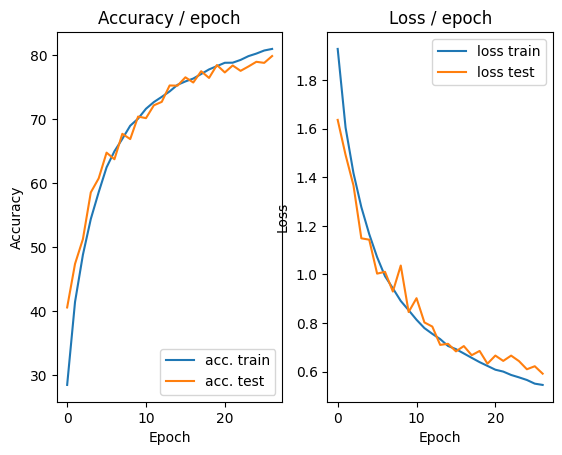

=== EPOCH 28 =====

Current learning rate: 0.025034
[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.5006 (0.5006)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.049s (0.028s)	Loss 0.4739 (0.5412)	Prec@1  81.2 ( 81.0)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5373	Avg Prec@1 81.17 %	Avg Prec@5 99.08 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.6407 (0.6407)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6206	Avg Prec@1 79.02 %	Avg Prec@5 98.76 %



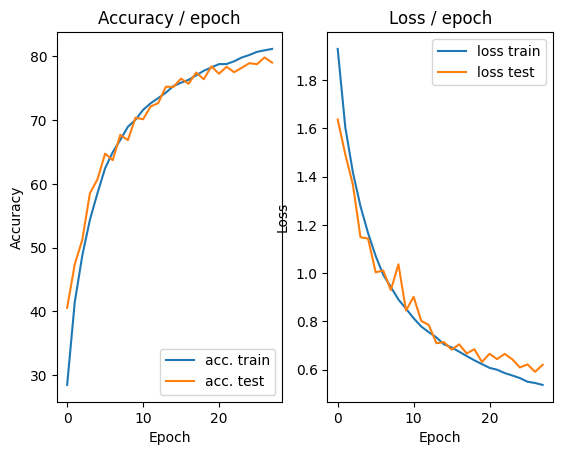

=== EPOCH 29 =====

Current learning rate: 0.023783
[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.6587 (0.6587)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.051s (0.027s)	Loss 0.5043 (0.5268)	Prec@1  83.6 ( 81.5)	Prec@5  99.2 ( 99.2)

===============> Total time 10s	Avg loss 0.5279	Avg Prec@1 81.50 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.6072 (0.6072)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5788	Avg Prec@1 80.78 %	Avg Prec@5 98.93 %



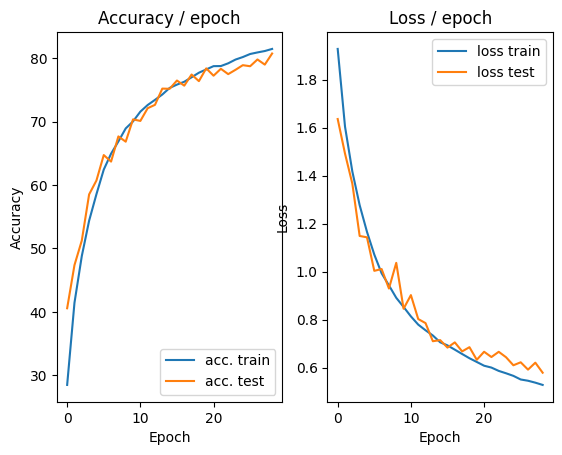

=== EPOCH 30 =====

Current learning rate: 0.022594
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.5311 (0.5311)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.006s (0.029s)	Loss 0.4337 (0.5169)	Prec@1  84.4 ( 82.1)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5163	Avg Prec@1 81.94 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.6084 (0.6084)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5972	Avg Prec@1 79.80 %	Avg Prec@5 98.83 %



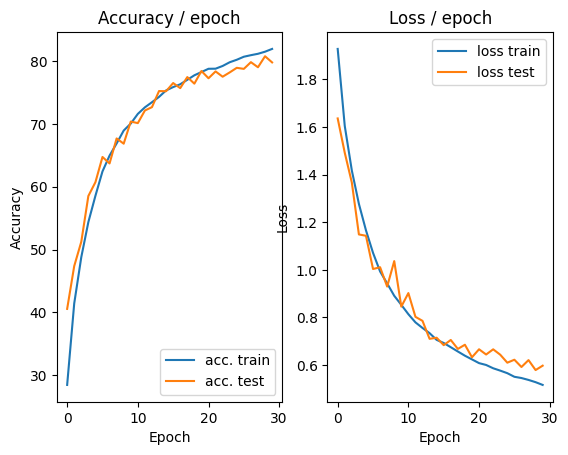

=== EPOCH 31 =====

Current learning rate: 0.021464
[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.4490 (0.4490)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.012s (0.028s)	Loss 0.6173 (0.5067)	Prec@1  79.7 ( 82.3)	Prec@5  99.2 ( 99.1)

===============> Total time 11s	Avg loss 0.5100	Avg Prec@1 82.10 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.6353 (0.6353)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5834	Avg Prec@1 80.41 %	Avg Prec@5 98.89 %



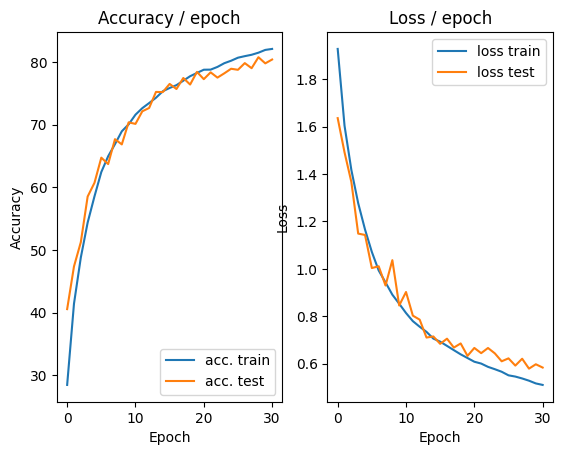

=== EPOCH 32 =====

Current learning rate: 0.020391
[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.3915 (0.3915)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.032s (0.028s)	Loss 0.5182 (0.5077)	Prec@1  82.0 ( 82.3)	Prec@5  97.7 ( 99.1)

===============> Total time 10s	Avg loss 0.5075	Avg Prec@1 82.30 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.6270 (0.6270)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5845	Avg Prec@1 80.49 %	Avg Prec@5 98.93 %



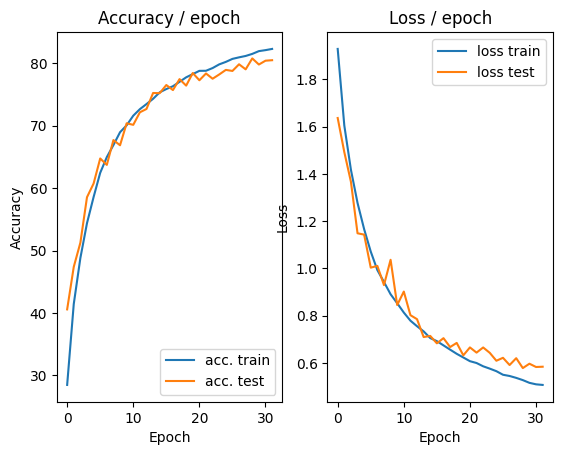

=== EPOCH 33 =====

Current learning rate: 0.019371
[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.6031 (0.6031)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.041s (0.027s)	Loss 0.5567 (0.4932)	Prec@1  79.7 ( 82.7)	Prec@5  98.4 ( 99.2)

===============> Total time 10s	Avg loss 0.4979	Avg Prec@1 82.49 %	Avg Prec@5 99.20 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.6604 (0.6604)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5790	Avg Prec@1 80.19 %	Avg Prec@5 98.91 %



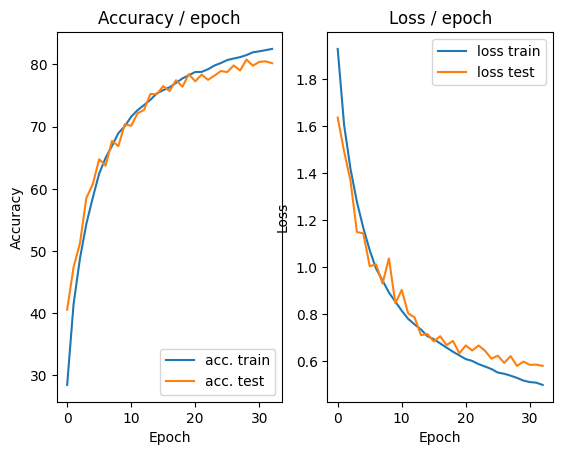

=== EPOCH 34 =====

Current learning rate: 0.018403
[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.5240 (0.5240)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.020s (0.027s)	Loss 0.3725 (0.4944)	Prec@1  83.6 ( 82.7)	Prec@5 100.0 ( 99.3)

===============> Total time 10s	Avg loss 0.4922	Avg Prec@1 82.70 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.6208 (0.6208)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5821	Avg Prec@1 80.95 %	Avg Prec@5 98.98 %



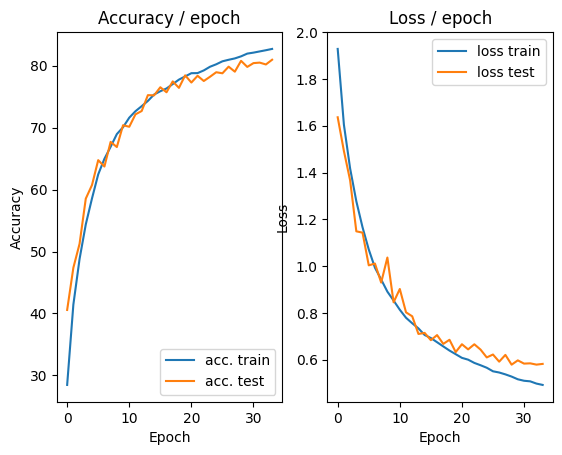

=== EPOCH 35 =====

Current learning rate: 0.017482
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.5441 (0.5441)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.043s (0.026s)	Loss 0.4330 (0.4786)	Prec@1  85.2 ( 83.2)	Prec@5  99.2 ( 99.2)

===============> Total time 10s	Avg loss 0.4836	Avg Prec@1 82.97 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.6455 (0.6455)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5691	Avg Prec@1 81.02 %	Avg Prec@5 98.99 %



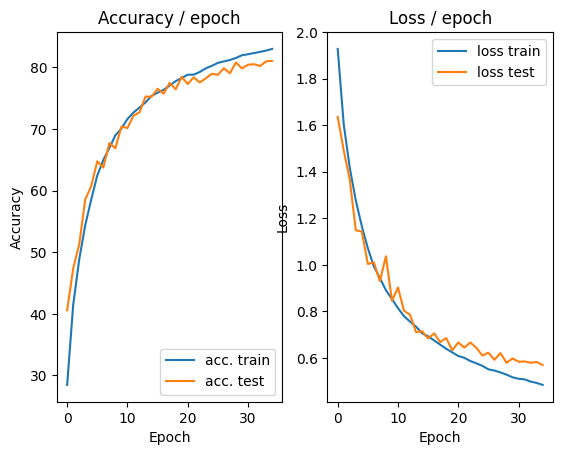

=== EPOCH 36 =====

Current learning rate: 0.016608
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.4051 (0.4051)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.029s (0.028s)	Loss 0.6272 (0.4809)	Prec@1  82.8 ( 83.1)	Prec@5  99.2 ( 99.2)

===============> Total time 10s	Avg loss 0.4833	Avg Prec@1 83.08 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.073s (0.073s)	Loss 0.6389 (0.6389)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5670	Avg Prec@1 80.94 %	Avg Prec@5 99.00 %



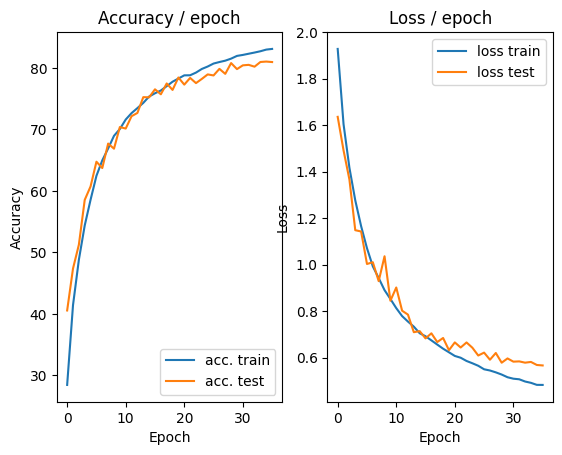

=== EPOCH 37 =====

Current learning rate: 0.015778
[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.4905 (0.4905)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.042s (0.027s)	Loss 0.5989 (0.4736)	Prec@1  80.5 ( 83.6)	Prec@5  98.4 ( 99.3)

===============> Total time 10s	Avg loss 0.4745	Avg Prec@1 83.53 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 0.6323 (0.6323)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5719	Avg Prec@1 80.42 %	Avg Prec@5 98.96 %



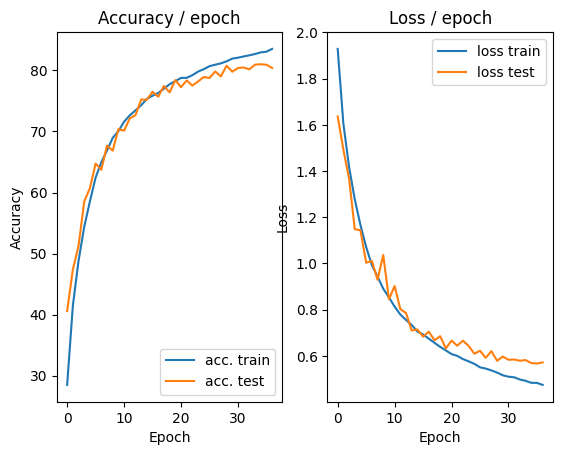

=== EPOCH 38 =====

Current learning rate: 0.014989
[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.4611 (0.4611)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.052s (0.027s)	Loss 0.4097 (0.4720)	Prec@1  87.5 ( 83.6)	Prec@5 100.0 ( 99.3)

===============> Total time 10s	Avg loss 0.4727	Avg Prec@1 83.47 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.6181 (0.6181)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5668	Avg Prec@1 80.92 %	Avg Prec@5 98.99 %



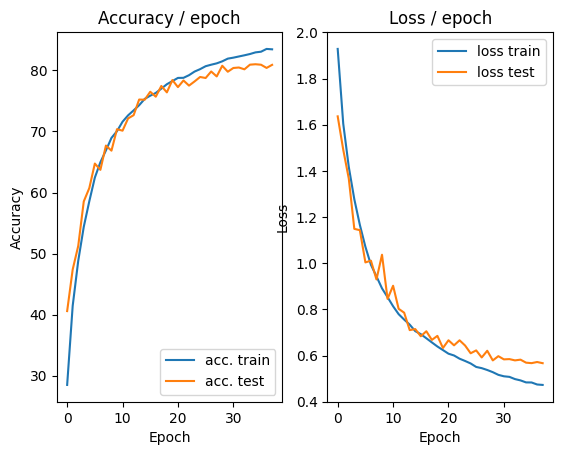

=== EPOCH 39 =====

Current learning rate: 0.014240
[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.4784 (0.4784)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.042s (0.027s)	Loss 0.5430 (0.4647)	Prec@1  82.0 ( 83.9)	Prec@5  99.2 ( 99.4)

===============> Total time 10s	Avg loss 0.4665	Avg Prec@1 83.89 %	Avg Prec@5 99.32 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.6203 (0.6203)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5674	Avg Prec@1 81.13 %	Avg Prec@5 99.01 %



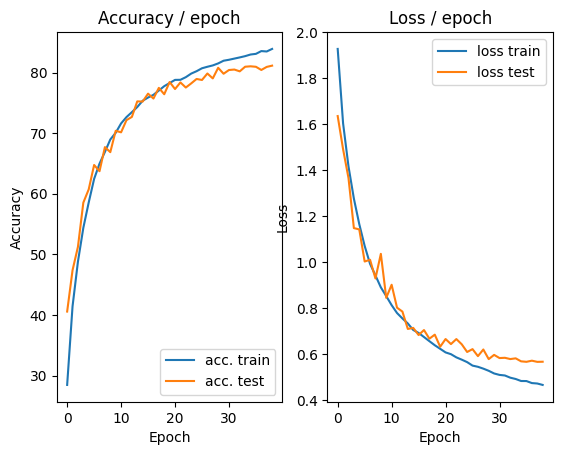

=== EPOCH 40 =====

Current learning rate: 0.013528
[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.3891 (0.3891)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.066s (0.037s)	Loss 0.3621 (0.4611)	Prec@1  87.5 ( 84.0)	Prec@5  99.2 ( 99.4)

===============> Total time 13s	Avg loss 0.4602	Avg Prec@1 83.95 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.6372 (0.6372)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5788	Avg Prec@1 80.80 %	Avg Prec@5 98.92 %



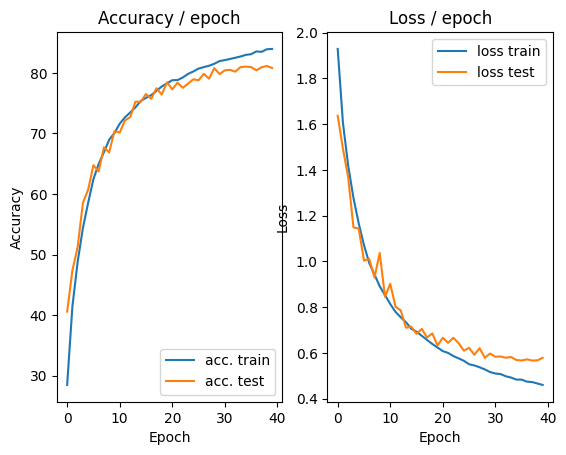

=== EPOCH 41 =====

Current learning rate: 0.012851
[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.5856 (0.5856)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.069s (0.033s)	Loss 0.4591 (0.4556)	Prec@1  82.8 ( 84.1)	Prec@5  99.2 ( 99.4)

===============> Total time 13s	Avg loss 0.4530	Avg Prec@1 84.15 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.6091 (0.6091)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5469	Avg Prec@1 81.70 %	Avg Prec@5 99.03 %



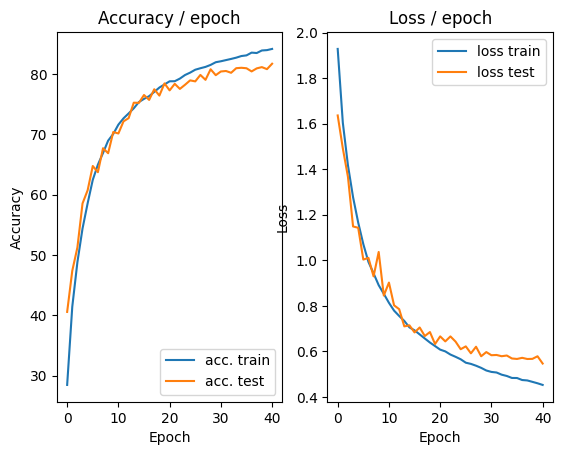

=== EPOCH 42 =====

Current learning rate: 0.012209
[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.4011 (0.4011)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.038s (0.028s)	Loss 0.4065 (0.4469)	Prec@1  85.2 ( 84.4)	Prec@5 100.0 ( 99.4)

===============> Total time 10s	Avg loss 0.4500	Avg Prec@1 84.27 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.5993 (0.5993)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5685	Avg Prec@1 81.34 %	Avg Prec@5 98.81 %



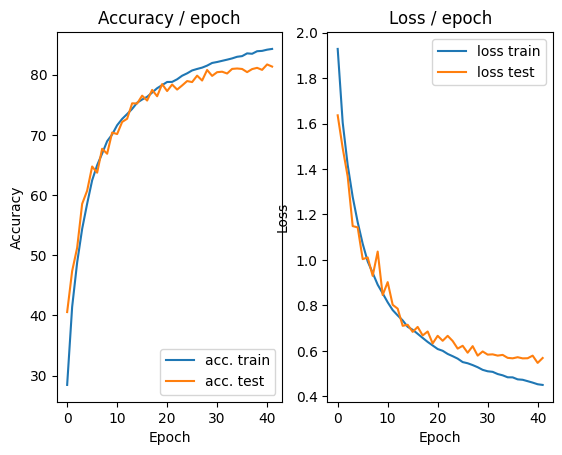

=== EPOCH 43 =====

Current learning rate: 0.011598
[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.4737 (0.4737)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.026s)	Loss 0.3826 (0.4479)	Prec@1  85.2 ( 84.4)	Prec@5 100.0 ( 99.4)

===============> Total time 9s	Avg loss 0.4473	Avg Prec@1 84.43 %	Avg Prec@5 99.42 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.5747 (0.5747)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5708	Avg Prec@1 81.01 %	Avg Prec@5 98.90 %



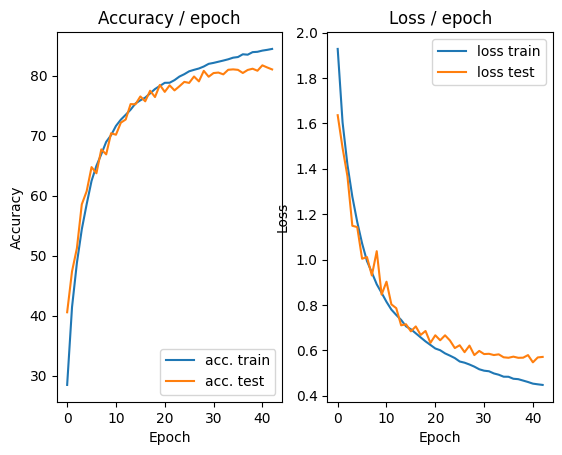

=== EPOCH 44 =====

Current learning rate: 0.011018
[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.4674 (0.4674)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.041s (0.025s)	Loss 0.4080 (0.4514)	Prec@1  86.7 ( 84.4)	Prec@5  98.4 ( 99.4)

===============> Total time 9s	Avg loss 0.4472	Avg Prec@1 84.48 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.5612 (0.5612)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5522	Avg Prec@1 81.52 %	Avg Prec@5 99.03 %



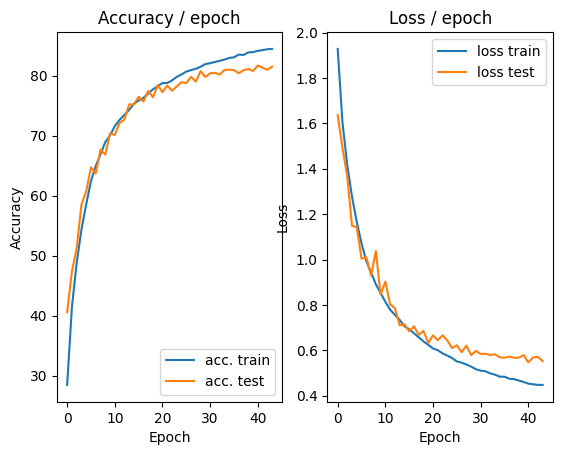

=== EPOCH 45 =====

Current learning rate: 0.010467
[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.4676 (0.4676)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.042s (0.026s)	Loss 0.3908 (0.4409)	Prec@1  83.6 ( 84.4)	Prec@5 100.0 ( 99.4)

===============> Total time 9s	Avg loss 0.4393	Avg Prec@1 84.57 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.6241 (0.6241)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5619	Avg Prec@1 81.43 %	Avg Prec@5 99.08 %



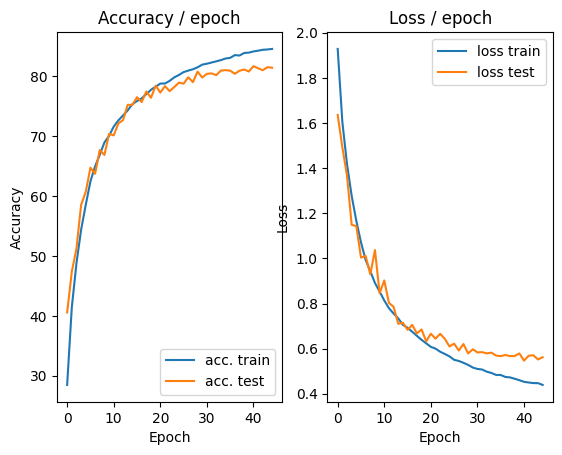

=== EPOCH 46 =====

Current learning rate: 0.009944
[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.4209 (0.4209)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.023s (0.026s)	Loss 0.3724 (0.4327)	Prec@1  88.3 ( 84.8)	Prec@5 100.0 ( 99.4)

===============> Total time 9s	Avg loss 0.4322	Avg Prec@1 84.88 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.5830 (0.5830)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5546	Avg Prec@1 81.20 %	Avg Prec@5 98.99 %



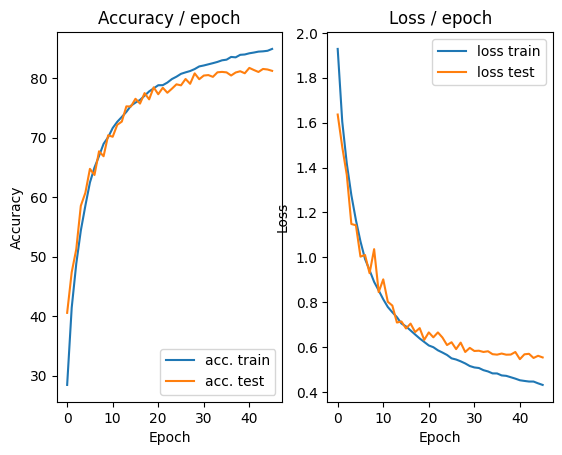

=== EPOCH 47 =====

Current learning rate: 0.009447
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.5818 (0.5818)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.025s)	Loss 0.3415 (0.4307)	Prec@1  91.4 ( 84.9)	Prec@5  98.4 ( 99.4)

===============> Total time 9s	Avg loss 0.4312	Avg Prec@1 84.98 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.6305 (0.6305)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5559	Avg Prec@1 81.62 %	Avg Prec@5 99.01 %



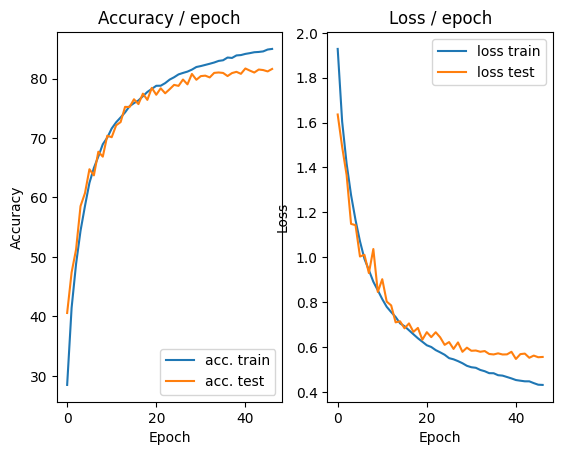

=== EPOCH 48 =====

Current learning rate: 0.008974
[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.4172 (0.4172)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.009s (0.028s)	Loss 0.3419 (0.4311)	Prec@1  86.7 ( 84.9)	Prec@5 100.0 ( 99.5)

===============> Total time 10s	Avg loss 0.4301	Avg Prec@1 84.95 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 0.6100 (0.6100)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5547	Avg Prec@1 81.80 %	Avg Prec@5 98.99 %



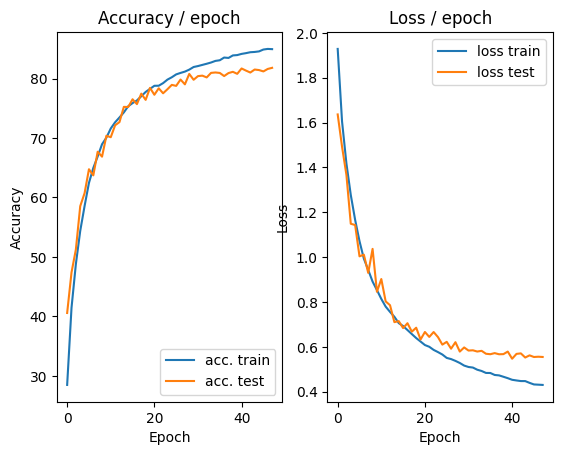

=== EPOCH 49 =====

Current learning rate: 0.008526
[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.3639 (0.3639)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.047s (0.027s)	Loss 0.4151 (0.4197)	Prec@1  85.2 ( 85.3)	Prec@5 100.0 ( 99.5)

===============> Total time 10s	Avg loss 0.4261	Avg Prec@1 85.00 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.071s (0.071s)	Loss 0.5921 (0.5921)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5534	Avg Prec@1 81.66 %	Avg Prec@5 98.97 %



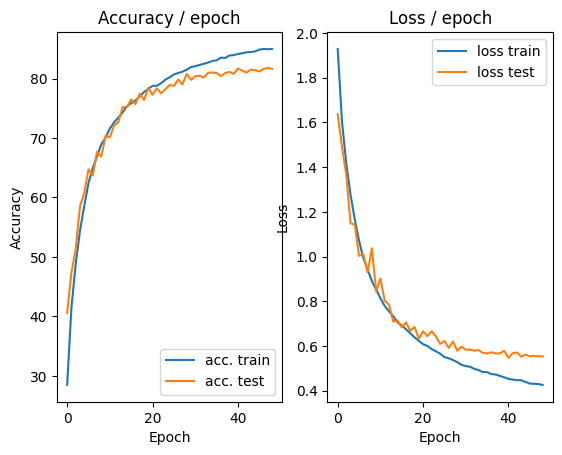

=== EPOCH 50 =====

Current learning rate: 0.008099
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.4054 (0.4054)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.041s (0.025s)	Loss 0.4190 (0.4195)	Prec@1  83.6 ( 85.4)	Prec@5  99.2 ( 99.5)

===============> Total time 9s	Avg loss 0.4226	Avg Prec@1 85.26 %	Avg Prec@5 99.45 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.5940 (0.5940)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5428	Avg Prec@1 81.88 %	Avg Prec@5 99.04 %



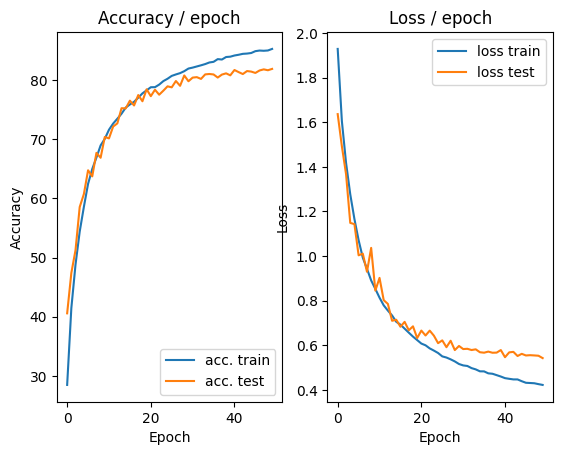

In [13]:
main(128, 0.1, 50, cuda=True)

# 3.4 Regularization of the network by dropout

In [14]:
class ConvNet(nn.Module):
    """
    Cette classe définit la structure du réseau neuronal convolutif.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # Définition des couches convolutives et de pooling pour extraire les caractéristiques
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True),
        )
        # Couches fully connected pour la classification
        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, 1000),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(1000, 10)
            # Remarque : Pas besoin d'ajouter la couche softmax ici, car elle est incluse dans la fonction de perte
        )



    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le jeu de données CIFAR-10 et applique les transformations nécessaires,
    y compris la normalisation.
    """
    # Valeurs de normalisation pour CIFAR-10
    mean = [0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]

    # Transformations à appliquer sur les images
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),  # Flips aléatoires pour augmenter les données
        transforms.RandomCrop(28, padding=4),  # Découpage aléatoire
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)  # Normalisation
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Chargement des jeux de données d'entraînement et de validation
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True, transform=val_transform)

    # Création des DataLoader pour parcourir les jeux de données par batch
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                                               pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False,
                                             pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Effectue un passage (epoch) sur les données `data` avec le modèle `model`.
    Évalue la perte avec `criterion`. Si `optimizer` est fourni, fait une étape d'entraînement,
    sinon fait une évaluation.
    """
    model.eval() if optimizer is None else model.train()

    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()

    tic = time.time()
    for i, (input, target) in enumerate(data):
        if cuda:
            input = input.cuda()
            target = target.cuda()

        # Forward pass
        output = model(input)
        loss = criterion(output, target)

        # Backward pass si on est en mode entraînement
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Calcul des métriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # Mise à jour des métriques moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)

        # Affichage des informations
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time,
                   loss=avg_loss, top1=avg_top1_acc, top5=avg_top5_acc))

    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss

import torch.optim.lr_scheduler

def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        print(f"Current learning rate: {optimizer.param_groups[0]['lr']:.6f}")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # Update the learning rate
        lr_scheduler.step()
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

Current learning rate: 0.100000
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 2.2857 (2.2857)	Prec@1  15.6 ( 15.6)	Prec@5  63.3 ( 63.3)
[TRAIN Batch 200/391]	Time 0.041s (0.035s)	Loss 1.8796 (2.0593)	Prec@1  29.7 ( 22.7)	Prec@5  85.9 ( 75.0)

===============> Total time 13s	Avg loss 1.9544	Avg Prec@1 27.24 %	Avg Prec@5 79.64 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 1.7369 (1.7369)	Prec@1  42.2 ( 42.2)	Prec@5  85.9 ( 85.9)

===============> Total time 1s	Avg loss 1.6689	Avg Prec@1 38.87 %	Avg Prec@5 87.95 %



<Figure size 640x480 with 0 Axes>

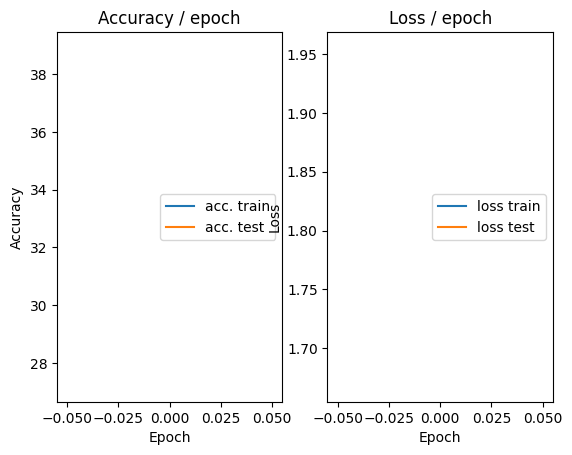

=== EPOCH 2 =====

Current learning rate: 0.095000
[TRAIN Batch 000/391]	Time 0.104s (0.104s)	Loss 1.8092 (1.8092)	Prec@1  32.8 ( 32.8)	Prec@5  85.2 ( 85.2)
[TRAIN Batch 200/391]	Time 0.006s (0.027s)	Loss 1.5372 (1.6867)	Prec@1  39.8 ( 37.8)	Prec@5  93.0 ( 88.6)

===============> Total time 10s	Avg loss 1.6352	Avg Prec@1 39.80 %	Avg Prec@5 89.39 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 1.5887 (1.5887)	Prec@1  43.8 ( 43.8)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5696	Avg Prec@1 44.01 %	Avg Prec@5 90.75 %



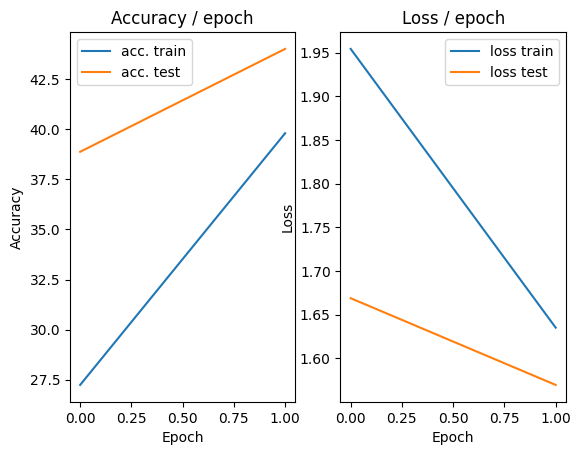

=== EPOCH 3 =====

Current learning rate: 0.090250
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 1.6031 (1.6031)	Prec@1  48.4 ( 48.4)	Prec@5  91.4 ( 91.4)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 1.4878 (1.4811)	Prec@1  46.9 ( 46.2)	Prec@5  90.6 ( 91.9)

===============> Total time 11s	Avg loss 1.4538	Avg Prec@1 47.33 %	Avg Prec@5 92.26 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.2978 (1.2978)	Prec@1  57.0 ( 57.0)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.3174	Avg Prec@1 53.39 %	Avg Prec@5 94.04 %



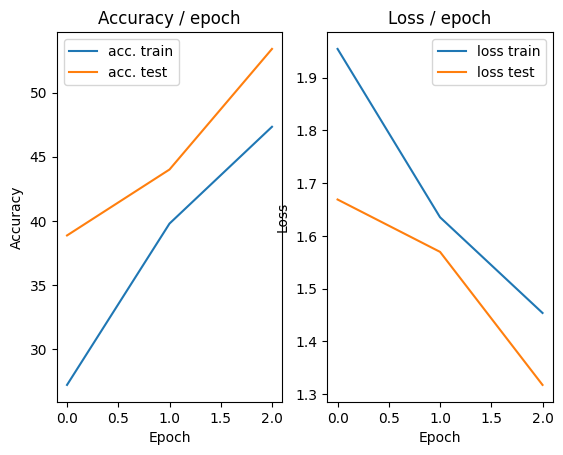

=== EPOCH 4 =====

Current learning rate: 0.085737
[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 1.2722 (1.2722)	Prec@1  57.0 ( 57.0)	Prec@5  93.0 ( 93.0)
[TRAIN Batch 200/391]	Time 0.053s (0.033s)	Loss 1.4802 (1.3576)	Prec@1  47.7 ( 51.6)	Prec@5  92.2 ( 93.5)

===============> Total time 12s	Avg loss 1.3282	Avg Prec@1 52.54 %	Avg Prec@5 93.80 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 1.2411 (1.2411)	Prec@1  58.6 ( 58.6)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.1994	Avg Prec@1 58.03 %	Avg Prec@5 94.68 %



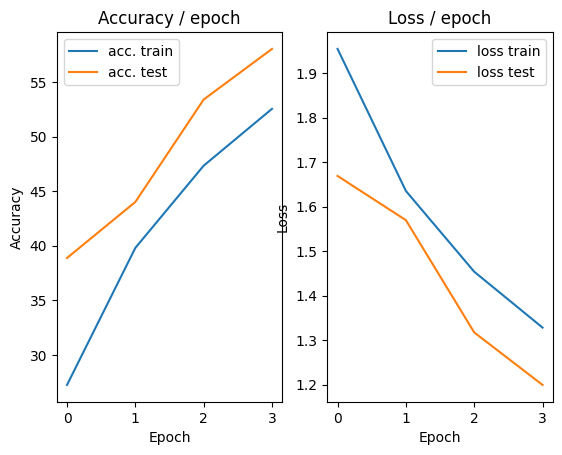

=== EPOCH 5 =====

Current learning rate: 0.081451
[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.0784 (1.0784)	Prec@1  62.5 ( 62.5)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.038s (0.028s)	Loss 1.3617 (1.2296)	Prec@1  54.7 ( 56.5)	Prec@5  93.8 ( 94.9)

===============> Total time 11s	Avg loss 1.2194	Avg Prec@1 56.91 %	Avg Prec@5 94.92 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 1.1251 (1.1251)	Prec@1  60.2 ( 60.2)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.1342	Avg Prec@1 59.95 %	Avg Prec@5 95.74 %



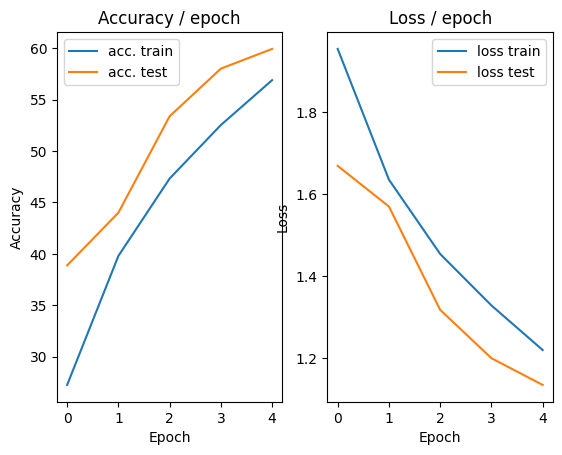

=== EPOCH 6 =====

Current learning rate: 0.077378
[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 1.0754 (1.0754)	Prec@1  58.6 ( 58.6)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.044s (0.029s)	Loss 1.2805 (1.1543)	Prec@1  58.6 ( 59.5)	Prec@5  92.2 ( 95.2)

===============> Total time 11s	Avg loss 1.1398	Avg Prec@1 59.81 %	Avg Prec@5 95.43 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 1.0232 (1.0232)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0807	Avg Prec@1 61.87 %	Avg Prec@5 96.33 %



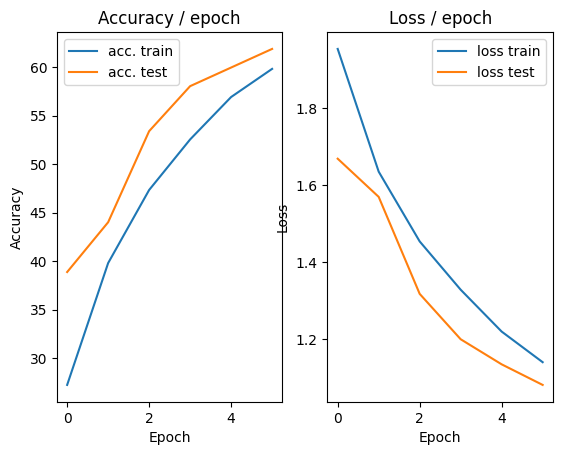

=== EPOCH 7 =====

Current learning rate: 0.073509
[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.1713 (1.1713)	Prec@1  57.0 ( 57.0)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.9797 (1.0857)	Prec@1  64.8 ( 61.7)	Prec@5  93.8 ( 96.0)

===============> Total time 10s	Avg loss 1.0701	Avg Prec@1 62.26 %	Avg Prec@5 96.15 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.9280 (0.9280)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9255	Avg Prec@1 67.86 %	Avg Prec@5 96.94 %



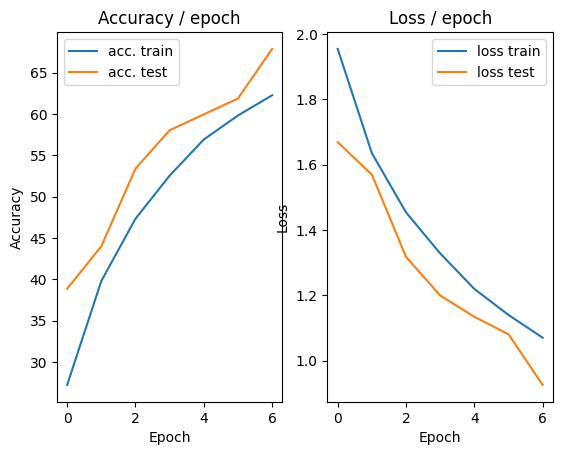

=== EPOCH 8 =====

Current learning rate: 0.069834
[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 1.1179 (1.1179)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.010s (0.026s)	Loss 1.0006 (1.0224)	Prec@1  70.3 ( 64.0)	Prec@5  99.2 ( 96.4)

===============> Total time 10s	Avg loss 1.0122	Avg Prec@1 64.44 %	Avg Prec@5 96.51 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.9325 (0.9325)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9219	Avg Prec@1 67.41 %	Avg Prec@5 97.35 %



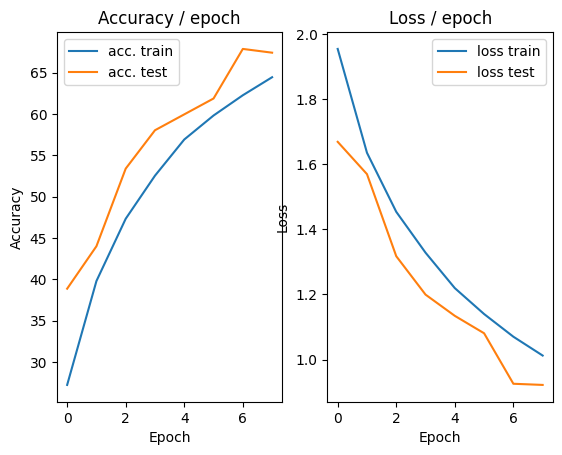

=== EPOCH 9 =====

Current learning rate: 0.066342
[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.9373 (0.9373)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.011s (0.025s)	Loss 0.9372 (0.9738)	Prec@1  68.0 ( 65.6)	Prec@5  98.4 ( 96.9)

===============> Total time 9s	Avg loss 0.9655	Avg Prec@1 66.15 %	Avg Prec@5 96.84 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.8579 (0.8579)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8905	Avg Prec@1 68.98 %	Avg Prec@5 97.58 %



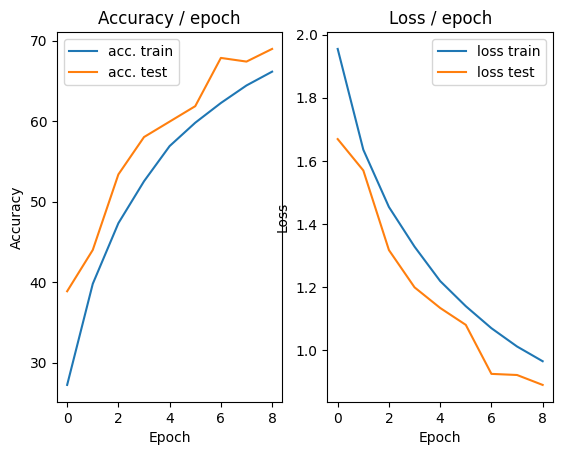

=== EPOCH 10 =====

Current learning rate: 0.063025
[TRAIN Batch 000/391]	Time 0.115s (0.115s)	Loss 1.1554 (1.1554)	Prec@1  59.4 ( 59.4)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.042s (0.026s)	Loss 0.9189 (0.9178)	Prec@1  61.7 ( 68.0)	Prec@5  99.2 ( 97.2)

===============> Total time 10s	Avg loss 0.9234	Avg Prec@1 67.63 %	Avg Prec@5 97.15 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.9818 (0.9818)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9623	Avg Prec@1 66.27 %	Avg Prec@5 96.94 %



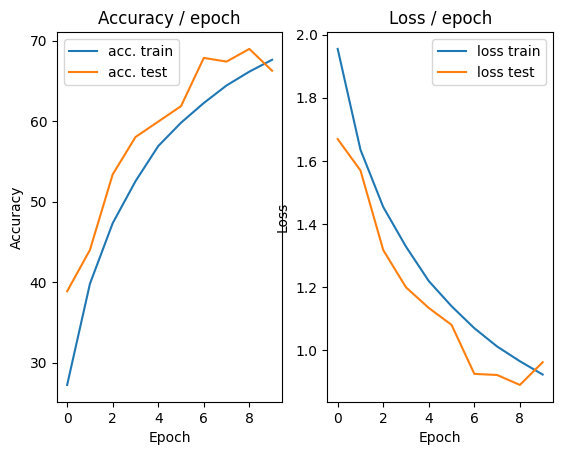

=== EPOCH 11 =====

Current learning rate: 0.059874
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 1.1142 (1.1142)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.008s (0.030s)	Loss 0.8699 (0.8868)	Prec@1  67.2 ( 69.1)	Prec@5  97.7 ( 97.4)

===============> Total time 11s	Avg loss 0.8838	Avg Prec@1 69.18 %	Avg Prec@5 97.37 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 0.8602 (0.8602)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9201	Avg Prec@1 67.63 %	Avg Prec@5 96.78 %



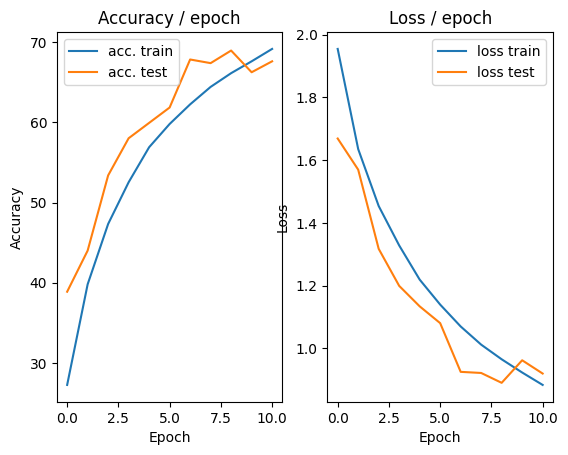

=== EPOCH 12 =====

Current learning rate: 0.056880
[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.9925 (0.9925)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.010s (0.029s)	Loss 0.7805 (0.8563)	Prec@1  73.4 ( 70.2)	Prec@5  98.4 ( 97.5)

===============> Total time 11s	Avg loss 0.8529	Avg Prec@1 70.21 %	Avg Prec@5 97.56 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.7632 (0.7632)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7589	Avg Prec@1 73.58 %	Avg Prec@5 98.03 %



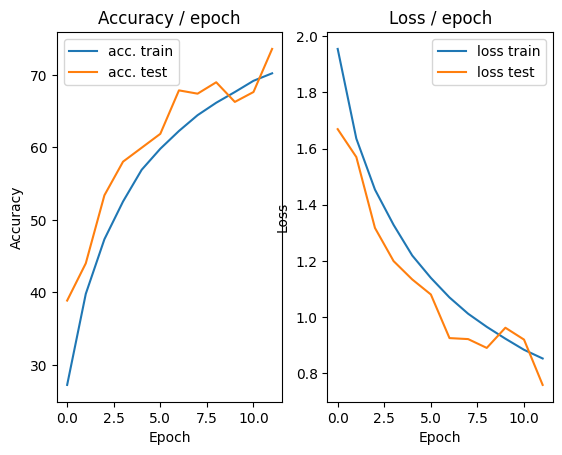

=== EPOCH 13 =====

Current learning rate: 0.054036
[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.9126 (0.9126)	Prec@1  72.7 ( 72.7)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.010s (0.031s)	Loss 0.8854 (0.8212)	Prec@1  67.2 ( 71.2)	Prec@5  94.5 ( 97.8)

===============> Total time 11s	Avg loss 0.8216	Avg Prec@1 71.43 %	Avg Prec@5 97.64 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.7030 (0.7030)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7593	Avg Prec@1 73.22 %	Avg Prec@5 98.37 %



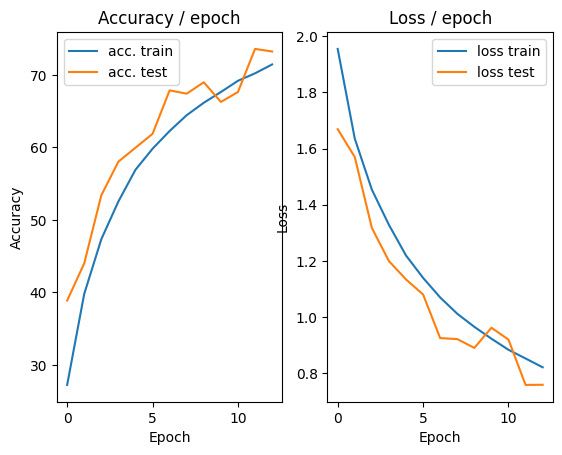

=== EPOCH 14 =====

Current learning rate: 0.051334
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.6627 (0.6627)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.050s (0.030s)	Loss 0.9084 (0.8026)	Prec@1  68.0 ( 71.8)	Prec@5  95.3 ( 97.8)

===============> Total time 11s	Avg loss 0.7975	Avg Prec@1 72.09 %	Avg Prec@5 97.78 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.7288 (0.7288)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7255	Avg Prec@1 74.70 %	Avg Prec@5 98.04 %



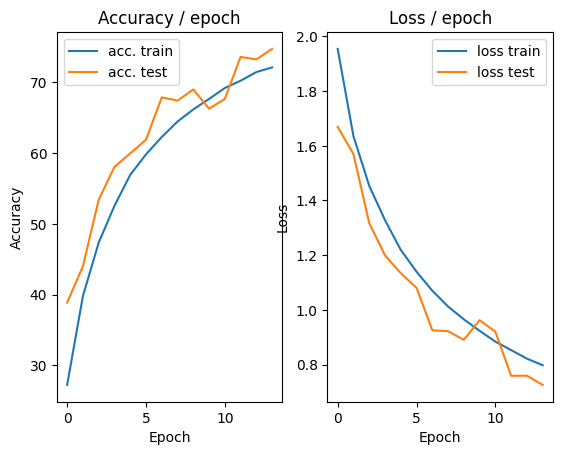

=== EPOCH 15 =====

Current learning rate: 0.048767
[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.6847 (0.6847)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.034s)	Loss 0.9023 (0.7804)	Prec@1  68.0 ( 72.8)	Prec@5  98.4 ( 97.9)

===============> Total time 13s	Avg loss 0.7768	Avg Prec@1 72.85 %	Avg Prec@5 97.97 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 0.6786 (0.6786)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7046	Avg Prec@1 75.45 %	Avg Prec@5 98.43 %



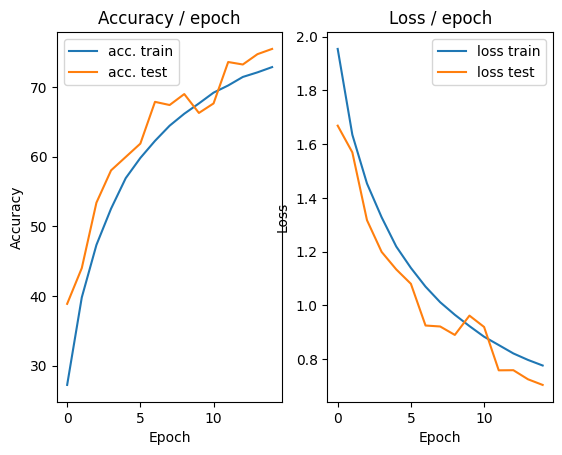

=== EPOCH 16 =====

Current learning rate: 0.046329
[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.7181 (0.7181)	Prec@1  72.7 ( 72.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.052s (0.032s)	Loss 0.5883 (0.7549)	Prec@1  77.3 ( 73.7)	Prec@5  97.7 ( 98.1)

===============> Total time 12s	Avg loss 0.7561	Avg Prec@1 73.63 %	Avg Prec@5 98.06 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 0.7138 (0.7138)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7201	Avg Prec@1 74.67 %	Avg Prec@5 98.42 %



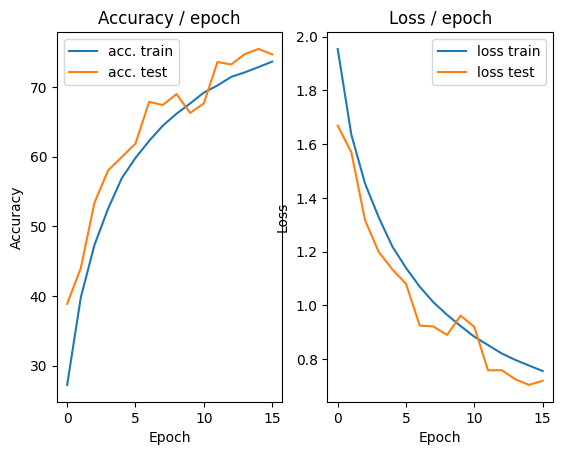

=== EPOCH 17 =====

Current learning rate: 0.044013
[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.7974 (0.7974)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.010s (0.028s)	Loss 0.6190 (0.7348)	Prec@1  82.0 ( 74.6)	Prec@5  98.4 ( 98.3)

===============> Total time 10s	Avg loss 0.7325	Avg Prec@1 74.63 %	Avg Prec@5 98.23 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.6874 (0.6874)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7078	Avg Prec@1 75.27 %	Avg Prec@5 98.34 %



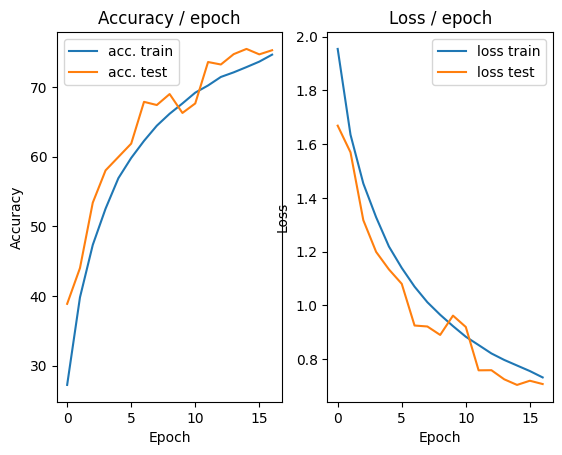

=== EPOCH 18 =====

Current learning rate: 0.041812
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.7436 (0.7436)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.042s (0.027s)	Loss 0.5483 (0.7162)	Prec@1  77.3 ( 75.1)	Prec@5  97.7 ( 98.2)

===============> Total time 10s	Avg loss 0.7219	Avg Prec@1 74.98 %	Avg Prec@5 98.23 %

[EVAL Batch 000/079]	Time 0.072s (0.072s)	Loss 0.6866 (0.6866)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7257	Avg Prec@1 75.03 %	Avg Prec@5 98.07 %



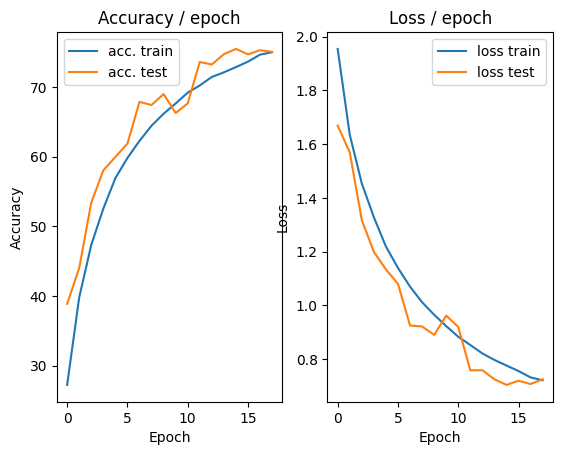

=== EPOCH 19 =====

Current learning rate: 0.039721
[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.7589 (0.7589)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.044s (0.030s)	Loss 0.6666 (0.7033)	Prec@1  78.1 ( 75.7)	Prec@5  99.2 ( 98.3)

===============> Total time 10s	Avg loss 0.7055	Avg Prec@1 75.62 %	Avg Prec@5 98.29 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.6782 (0.6782)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6742	Avg Prec@1 76.60 %	Avg Prec@5 98.52 %



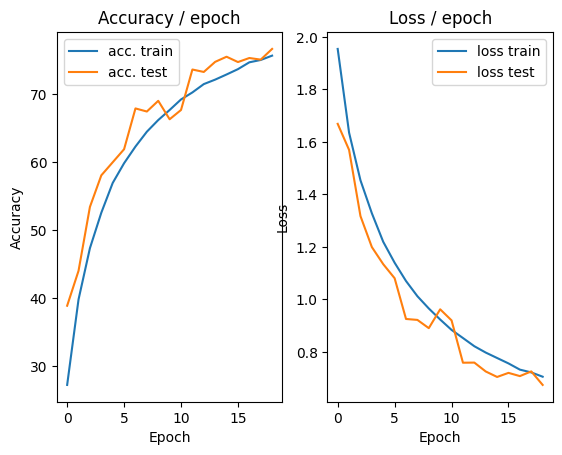

=== EPOCH 20 =====

Current learning rate: 0.037735
[TRAIN Batch 000/391]	Time 0.115s (0.115s)	Loss 0.6486 (0.6486)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.009s (0.027s)	Loss 0.7781 (0.6798)	Prec@1  74.2 ( 76.2)	Prec@5  97.7 ( 98.5)

===============> Total time 10s	Avg loss 0.6853	Avg Prec@1 76.02 %	Avg Prec@5 98.40 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 0.6045 (0.6045)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6374	Avg Prec@1 77.77 %	Avg Prec@5 98.62 %



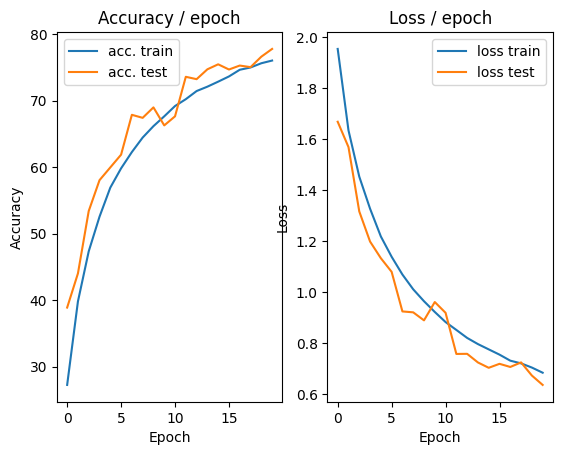

=== EPOCH 21 =====

Current learning rate: 0.035849
[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 0.6664 (0.6664)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.053s (0.026s)	Loss 0.6123 (0.6689)	Prec@1  78.1 ( 76.4)	Prec@5 100.0 ( 98.5)

===============> Total time 10s	Avg loss 0.6751	Avg Prec@1 76.39 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.6363 (0.6363)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6645	Avg Prec@1 76.63 %	Avg Prec@5 98.66 %



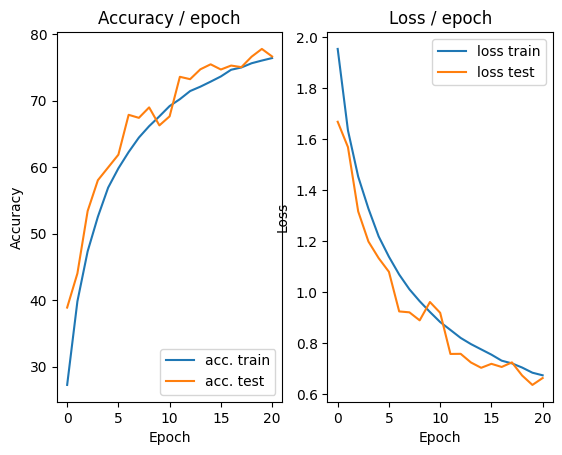

=== EPOCH 22 =====

Current learning rate: 0.034056
[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 0.7616 (0.7616)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.030s (0.026s)	Loss 0.6643 (0.6661)	Prec@1  78.9 ( 77.1)	Prec@5 100.0 ( 98.3)

===============> Total time 10s	Avg loss 0.6639	Avg Prec@1 76.99 %	Avg Prec@5 98.41 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.5772 (0.5772)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6347	Avg Prec@1 78.03 %	Avg Prec@5 98.67 %



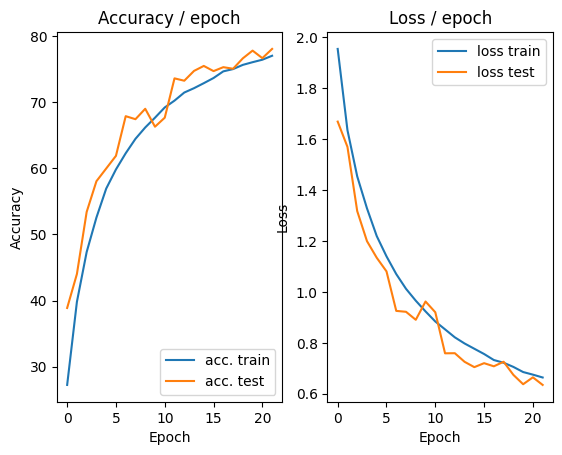

=== EPOCH 23 =====

Current learning rate: 0.032353
[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.6024 (0.6024)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.006s (0.026s)	Loss 0.7793 (0.6539)	Prec@1  72.7 ( 77.2)	Prec@5  98.4 ( 98.4)

===============> Total time 10s	Avg loss 0.6505	Avg Prec@1 77.29 %	Avg Prec@5 98.47 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.5703 (0.5703)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6274	Avg Prec@1 77.85 %	Avg Prec@5 98.71 %



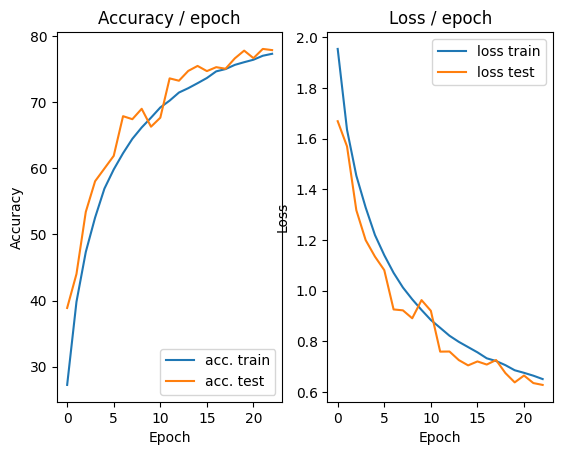

=== EPOCH 24 =====

Current learning rate: 0.030736
[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.7570 (0.7570)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.020s (0.026s)	Loss 0.5532 (0.6398)	Prec@1  78.1 ( 77.4)	Prec@5  99.2 ( 98.6)

===============> Total time 10s	Avg loss 0.6395	Avg Prec@1 77.68 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.5361 (0.5361)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6114	Avg Prec@1 78.59 %	Avg Prec@5 98.73 %



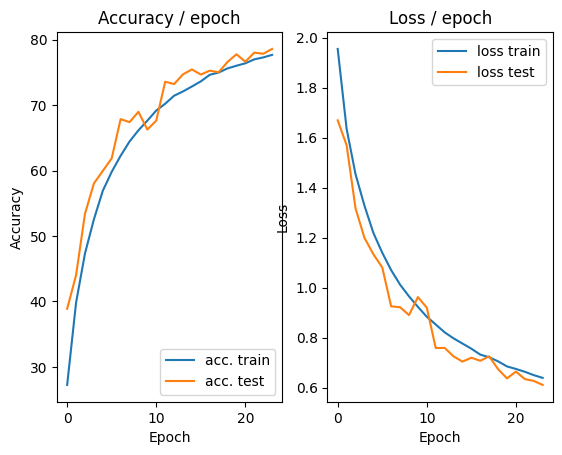

=== EPOCH 25 =====

Current learning rate: 0.029199
[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.6928 (0.6928)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.048s (0.027s)	Loss 0.6215 (0.6241)	Prec@1  80.5 ( 78.2)	Prec@5 100.0 ( 98.8)

===============> Total time 10s	Avg loss 0.6297	Avg Prec@1 78.07 %	Avg Prec@5 98.70 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.5499 (0.5499)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6177	Avg Prec@1 78.64 %	Avg Prec@5 98.70 %



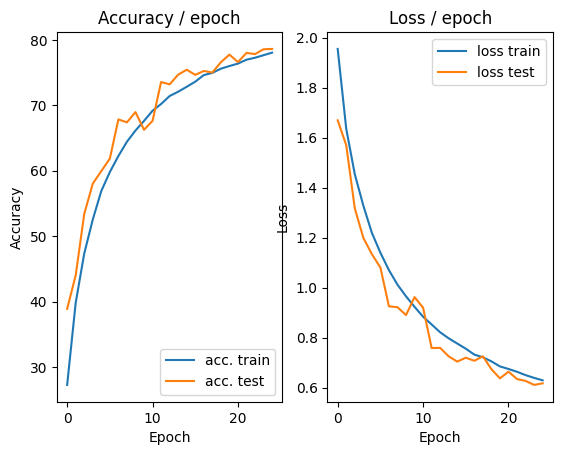

=== EPOCH 26 =====

Current learning rate: 0.027739
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.6225 (0.6225)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.007s (0.026s)	Loss 0.6315 (0.6289)	Prec@1  79.7 ( 78.0)	Prec@5  97.7 ( 98.7)

===============> Total time 10s	Avg loss 0.6195	Avg Prec@1 78.31 %	Avg Prec@5 98.70 %

[EVAL Batch 000/079]	Time 0.072s (0.072s)	Loss 0.5861 (0.5861)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6278	Avg Prec@1 78.37 %	Avg Prec@5 98.60 %



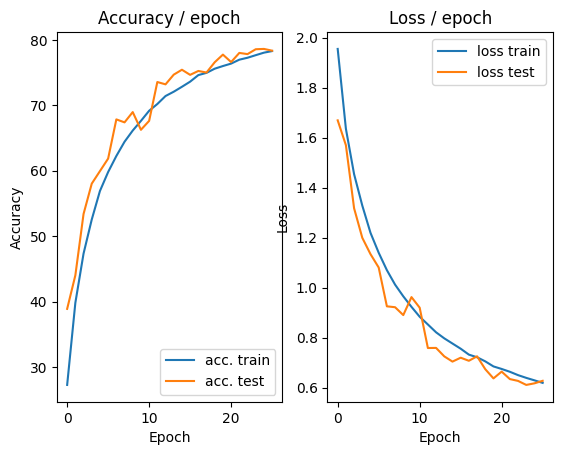

=== EPOCH 27 =====

Current learning rate: 0.026352
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.7058 (0.7058)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.026s)	Loss 0.6699 (0.6153)	Prec@1  77.3 ( 78.3)	Prec@5  99.2 ( 98.8)

===============> Total time 10s	Avg loss 0.6141	Avg Prec@1 78.35 %	Avg Prec@5 98.75 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.5339 (0.5339)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6135	Avg Prec@1 78.62 %	Avg Prec@5 98.87 %



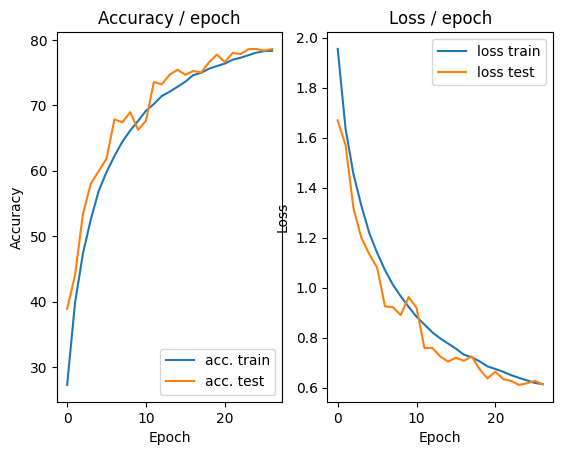

=== EPOCH 28 =====

Current learning rate: 0.025034
[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.5244 (0.5244)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.5960 (0.6079)	Prec@1  80.5 ( 78.8)	Prec@5  96.1 ( 98.8)

===============> Total time 10s	Avg loss 0.6090	Avg Prec@1 78.63 %	Avg Prec@5 98.76 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.5250 (0.5250)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6079	Avg Prec@1 78.22 %	Avg Prec@5 98.81 %



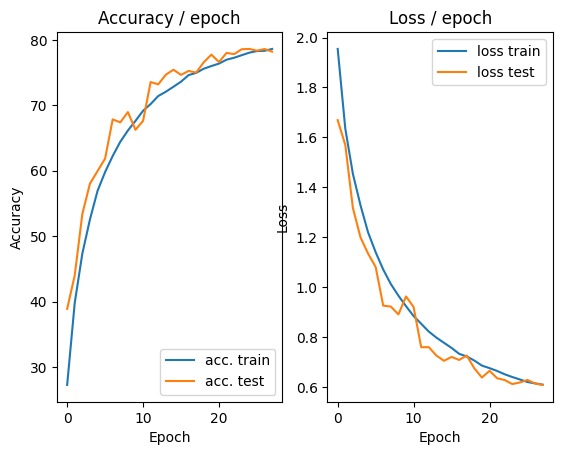

=== EPOCH 29 =====

Current learning rate: 0.023783
[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.6724 (0.6724)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.048s (0.028s)	Loss 0.5815 (0.5964)	Prec@1  78.1 ( 79.0)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.5951	Avg Prec@1 79.15 %	Avg Prec@5 98.77 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.5351 (0.5351)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.6361	Avg Prec@1 78.04 %	Avg Prec@5 98.84 %



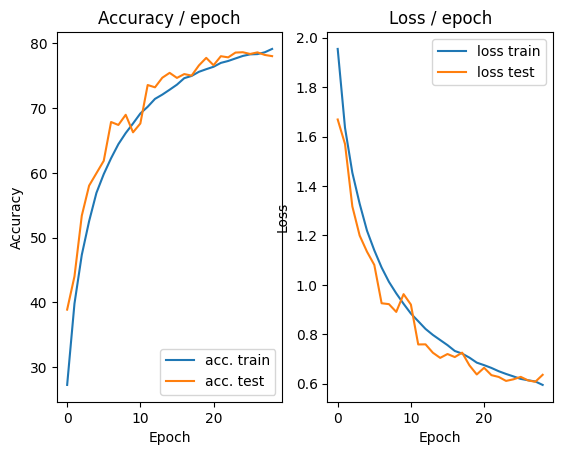

=== EPOCH 30 =====

Current learning rate: 0.022594
[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.4852 (0.4852)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.022s (0.026s)	Loss 0.5481 (0.5951)	Prec@1  79.7 ( 79.1)	Prec@5  99.2 ( 98.8)

===============> Total time 10s	Avg loss 0.5930	Avg Prec@1 79.09 %	Avg Prec@5 98.78 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.5150 (0.5150)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5671	Avg Prec@1 79.90 %	Avg Prec@5 98.93 %



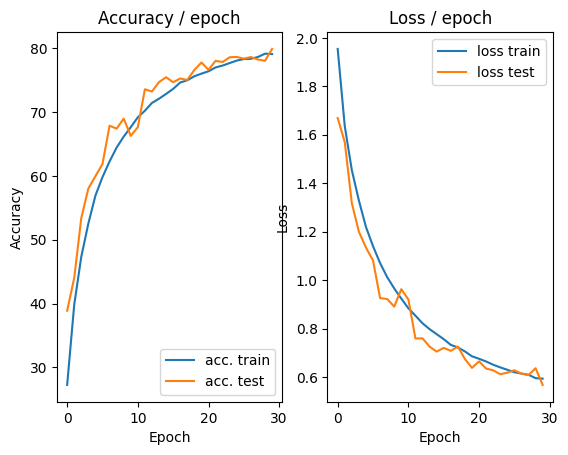

=== EPOCH 31 =====

Current learning rate: 0.021464
[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 0.3909 (0.3909)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.010s (0.026s)	Loss 0.7312 (0.5840)	Prec@1  77.3 ( 79.6)	Prec@5  99.2 ( 98.8)

===============> Total time 10s	Avg loss 0.5849	Avg Prec@1 79.53 %	Avg Prec@5 98.82 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.5401 (0.5401)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6049	Avg Prec@1 78.81 %	Avg Prec@5 98.87 %



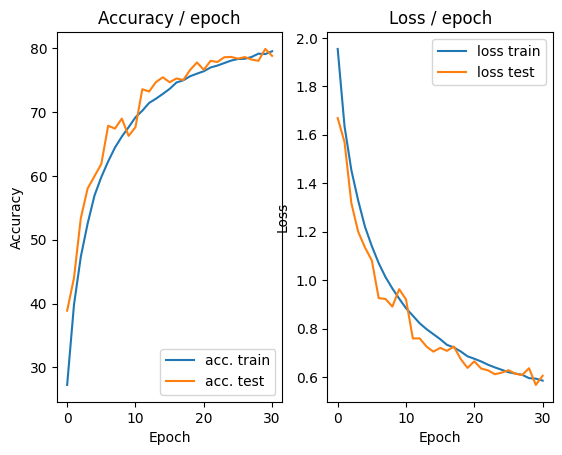

=== EPOCH 32 =====

Current learning rate: 0.020391
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.5647 (0.5647)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.026s)	Loss 0.5429 (0.5765)	Prec@1  81.2 ( 79.8)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.5735	Avg Prec@1 79.89 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.5291 (0.5291)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5842	Avg Prec@1 79.63 %	Avg Prec@5 98.93 %



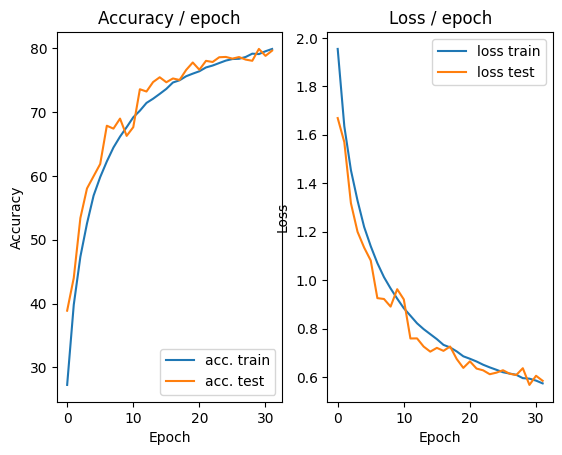

=== EPOCH 33 =====

Current learning rate: 0.019371
[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 0.6074 (0.6074)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.036s (0.028s)	Loss 0.4583 (0.5694)	Prec@1  82.0 ( 80.1)	Prec@5 100.0 ( 98.9)

===============> Total time 10s	Avg loss 0.5720	Avg Prec@1 80.11 %	Avg Prec@5 98.87 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.5459 (0.5459)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5745	Avg Prec@1 79.68 %	Avg Prec@5 98.97 %



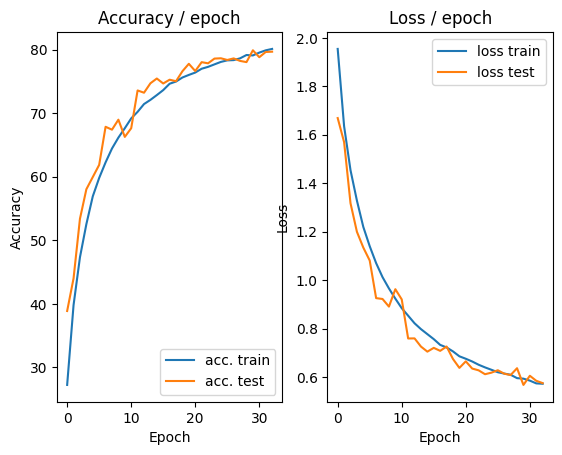

=== EPOCH 34 =====

Current learning rate: 0.018403
[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.4875 (0.4875)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.037s (0.028s)	Loss 0.6082 (0.5625)	Prec@1  77.3 ( 80.6)	Prec@5  97.7 ( 98.9)

===============> Total time 10s	Avg loss 0.5656	Avg Prec@1 80.40 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.5096 (0.5096)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5672	Avg Prec@1 80.20 %	Avg Prec@5 98.94 %



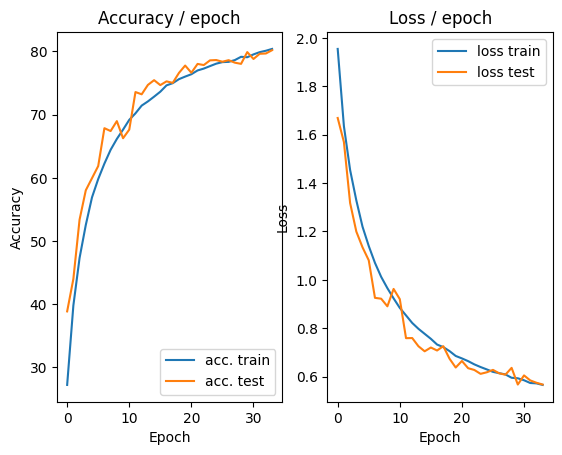

=== EPOCH 35 =====

Current learning rate: 0.017482
[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.5563 (0.5563)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.006s (0.026s)	Loss 0.5098 (0.5609)	Prec@1  79.7 ( 80.5)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.5586	Avg Prec@1 80.71 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.4705 (0.4705)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5504	Avg Prec@1 80.46 %	Avg Prec@5 98.91 %



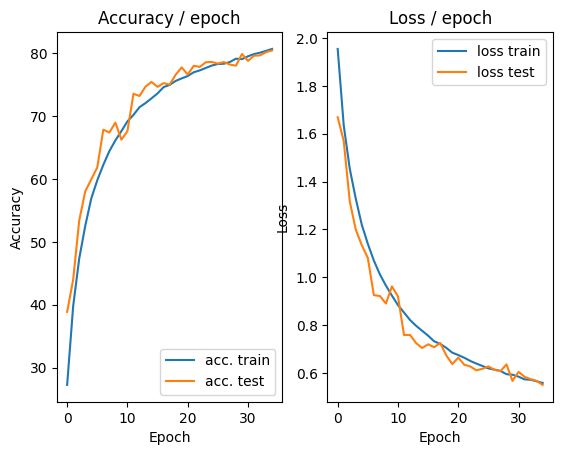

=== EPOCH 36 =====

Current learning rate: 0.016608
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.4656 (0.4656)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.011s (0.026s)	Loss 0.5388 (0.5500)	Prec@1  82.0 ( 80.5)	Prec@5 100.0 ( 98.9)

===============> Total time 10s	Avg loss 0.5520	Avg Prec@1 80.47 %	Avg Prec@5 98.95 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.5293 (0.5293)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5665	Avg Prec@1 80.11 %	Avg Prec@5 99.03 %



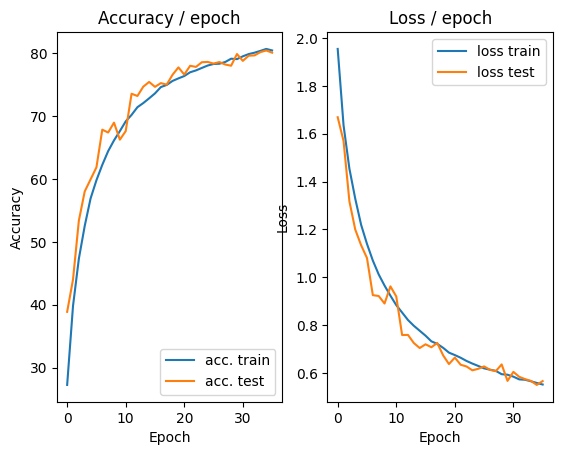

=== EPOCH 37 =====

Current learning rate: 0.015778
[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.5428 (0.5428)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.006s (0.027s)	Loss 0.5881 (0.5536)	Prec@1  78.1 ( 80.5)	Prec@5 100.0 ( 99.0)

===============> Total time 10s	Avg loss 0.5476	Avg Prec@1 80.74 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.4798 (0.4798)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5488	Avg Prec@1 80.69 %	Avg Prec@5 98.94 %



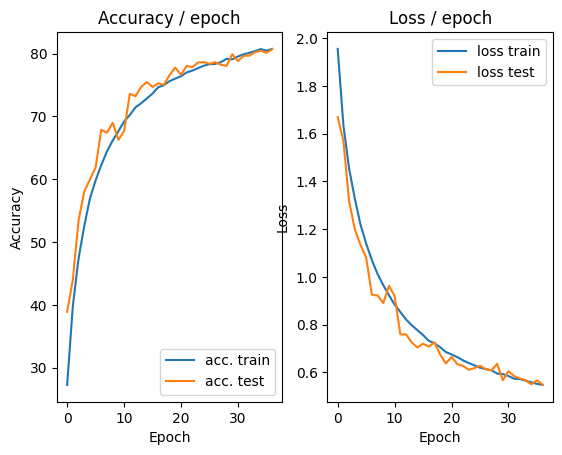

=== EPOCH 38 =====

Current learning rate: 0.014989
[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.7263 (0.7263)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.041s (0.027s)	Loss 0.4941 (0.5376)	Prec@1  82.0 ( 81.3)	Prec@5  98.4 ( 99.0)

===============> Total time 11s	Avg loss 0.5448	Avg Prec@1 81.01 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 0.5184 (0.5184)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5526	Avg Prec@1 80.68 %	Avg Prec@5 99.01 %



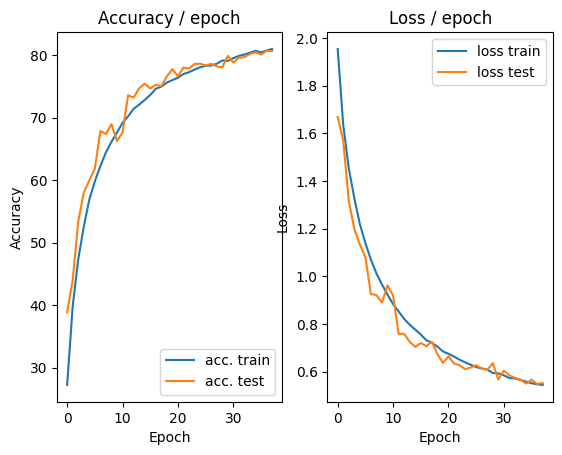

=== EPOCH 39 =====

Current learning rate: 0.014240
[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.4345 (0.4345)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.062s (0.032s)	Loss 0.6306 (0.5488)	Prec@1  77.3 ( 81.1)	Prec@5  98.4 ( 98.9)

===============> Total time 12s	Avg loss 0.5455	Avg Prec@1 81.02 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 0.4920 (0.4920)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5469	Avg Prec@1 80.76 %	Avg Prec@5 99.01 %



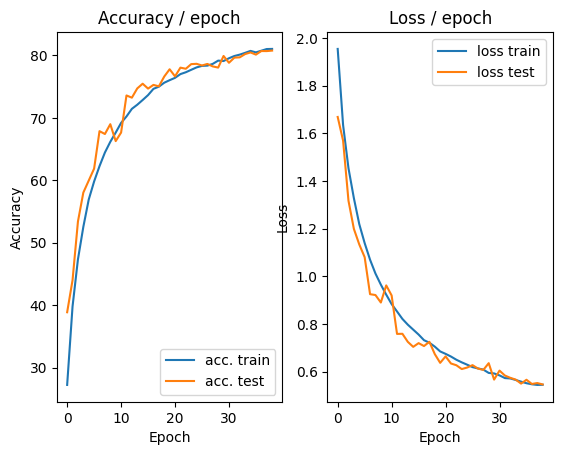

=== EPOCH 40 =====

Current learning rate: 0.013528
[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.5958 (0.5958)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.042s (0.033s)	Loss 0.4813 (0.5265)	Prec@1  85.2 ( 81.7)	Prec@5  98.4 ( 99.1)

===============> Total time 11s	Avg loss 0.5331	Avg Prec@1 81.44 %	Avg Prec@5 99.11 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.5453 (0.5453)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5600	Avg Prec@1 80.58 %	Avg Prec@5 99.00 %



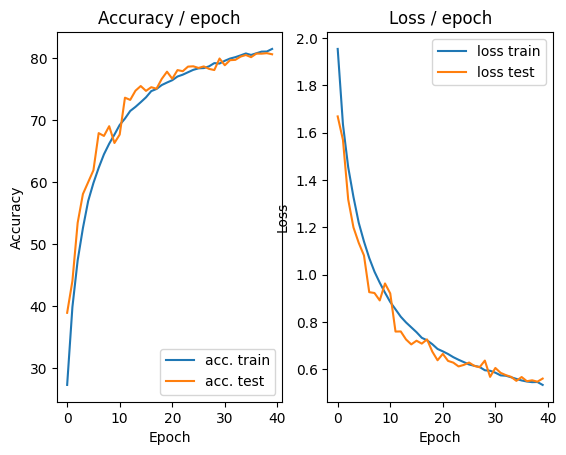

=== EPOCH 41 =====

Current learning rate: 0.012851
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.6560 (0.6560)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.009s (0.040s)	Loss 0.5060 (0.5330)	Prec@1  80.5 ( 81.5)	Prec@5  98.4 ( 99.0)

===============> Total time 14s	Avg loss 0.5321	Avg Prec@1 81.40 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 0.5480 (0.5480)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5522	Avg Prec@1 80.62 %	Avg Prec@5 99.04 %



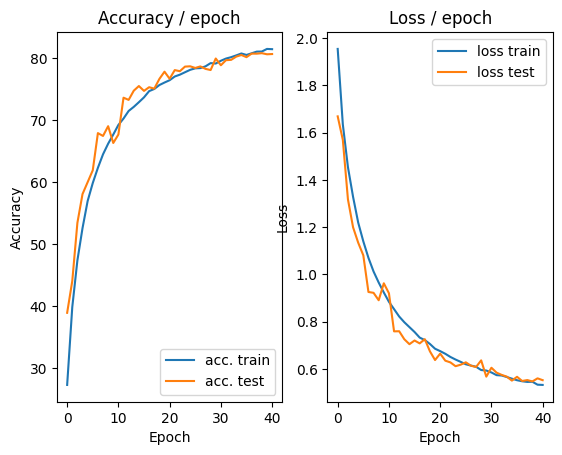

=== EPOCH 42 =====

Current learning rate: 0.012209
[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.5697 (0.5697)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.051s (0.035s)	Loss 0.6521 (0.5200)	Prec@1  76.6 ( 81.8)	Prec@5  99.2 ( 99.1)

===============> Total time 14s	Avg loss 0.5228	Avg Prec@1 81.64 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.4826 (0.4826)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5409	Avg Prec@1 81.20 %	Avg Prec@5 99.00 %



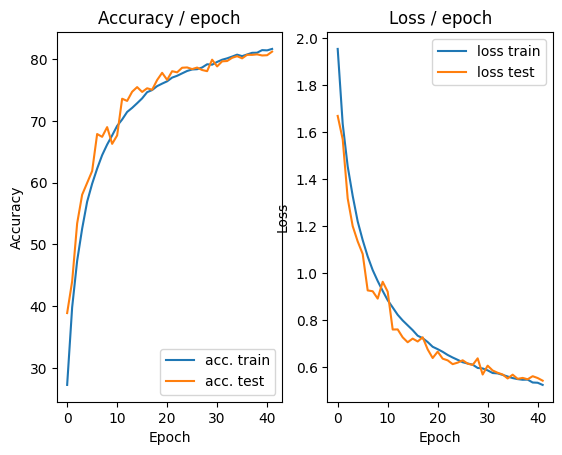

=== EPOCH 43 =====

Current learning rate: 0.011598
[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.6372 (0.6372)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.041s (0.026s)	Loss 0.5996 (0.5276)	Prec@1  79.7 ( 81.5)	Prec@5  98.4 ( 99.0)

===============> Total time 10s	Avg loss 0.5251	Avg Prec@1 81.64 %	Avg Prec@5 99.03 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.5054 (0.5054)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5419	Avg Prec@1 81.21 %	Avg Prec@5 98.97 %



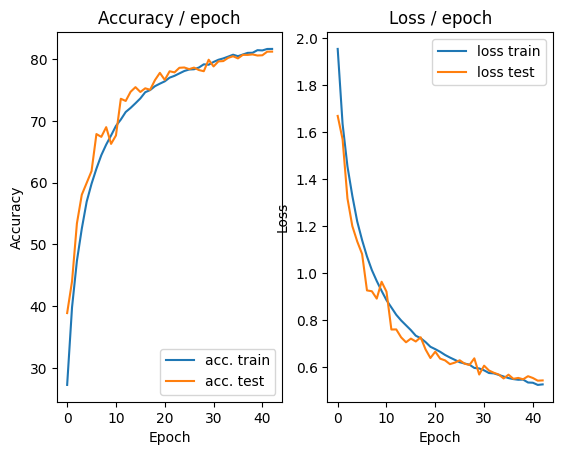

=== EPOCH 44 =====

Current learning rate: 0.011018
[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.5421 (0.5421)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.4716 (0.5243)	Prec@1  84.4 ( 81.9)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5198	Avg Prec@1 81.93 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.5002 (0.5002)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5450	Avg Prec@1 80.77 %	Avg Prec@5 99.11 %



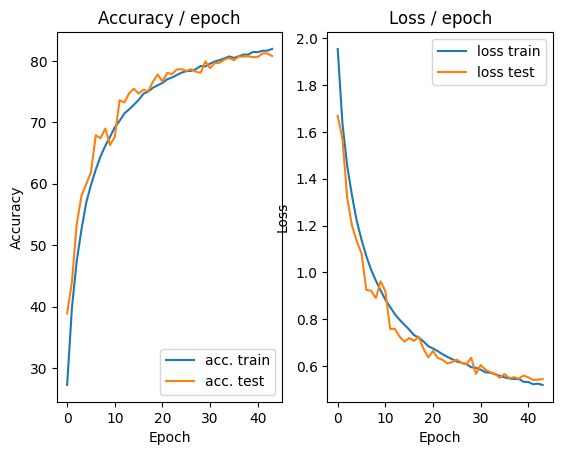

=== EPOCH 45 =====

Current learning rate: 0.010467
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.6084 (0.6084)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.047s (0.028s)	Loss 0.6562 (0.5152)	Prec@1  79.7 ( 81.8)	Prec@5 100.0 ( 99.2)

===============> Total time 10s	Avg loss 0.5173	Avg Prec@1 81.82 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.4825 (0.4825)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5303	Avg Prec@1 81.51 %	Avg Prec@5 99.03 %



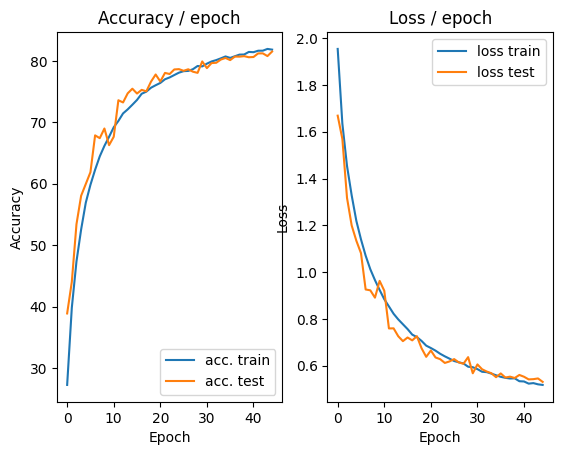

=== EPOCH 46 =====

Current learning rate: 0.009944
[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.4877 (0.4877)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.008s (0.029s)	Loss 0.4646 (0.5105)	Prec@1  82.0 ( 82.1)	Prec@5  98.4 ( 99.1)

===============> Total time 12s	Avg loss 0.5137	Avg Prec@1 81.94 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.5272 (0.5272)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5515	Avg Prec@1 80.58 %	Avg Prec@5 99.10 %



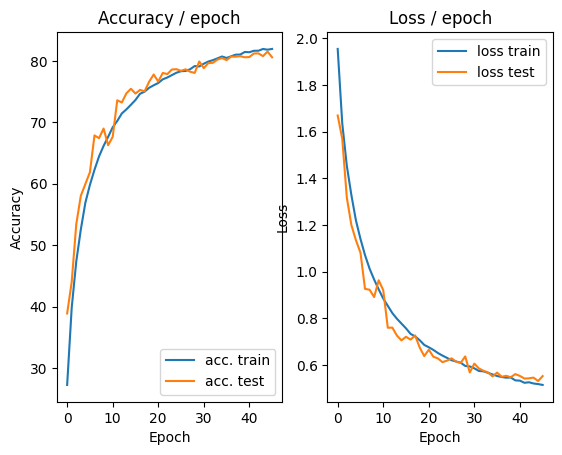

=== EPOCH 47 =====

Current learning rate: 0.009447
[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.5040 (0.5040)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.045s (0.033s)	Loss 0.3958 (0.5081)	Prec@1  85.9 ( 82.3)	Prec@5 100.0 ( 99.1)

===============> Total time 12s	Avg loss 0.5136	Avg Prec@1 82.16 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.5060 (0.5060)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5348	Avg Prec@1 81.10 %	Avg Prec@5 99.12 %



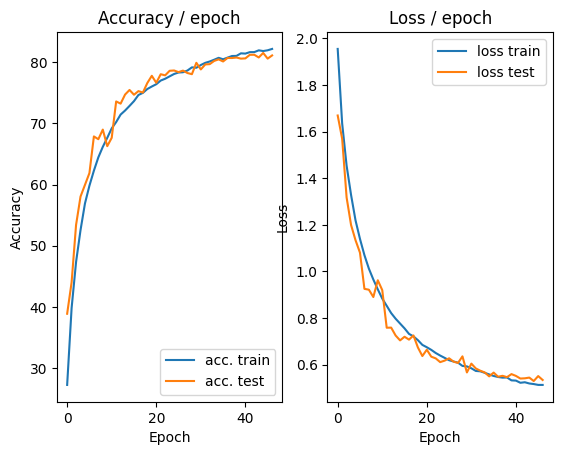

=== EPOCH 48 =====

Current learning rate: 0.008974
[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.4488 (0.4488)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.007s (0.029s)	Loss 0.5037 (0.5124)	Prec@1  81.2 ( 82.2)	Prec@5  99.2 ( 99.2)

===============> Total time 11s	Avg loss 0.5111	Avg Prec@1 82.19 %	Avg Prec@5 99.13 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.4888 (0.4888)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5321	Avg Prec@1 81.15 %	Avg Prec@5 99.06 %



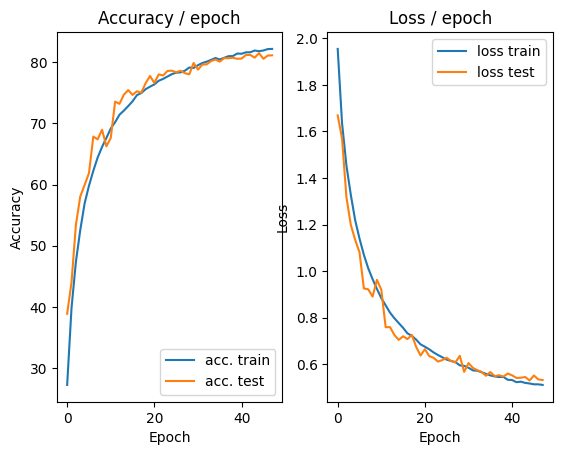

=== EPOCH 49 =====

Current learning rate: 0.008526
[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.6207 (0.6207)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.013s (0.030s)	Loss 0.4592 (0.5036)	Prec@1  82.0 ( 82.3)	Prec@5  98.4 ( 99.2)

===============> Total time 11s	Avg loss 0.5021	Avg Prec@1 82.45 %	Avg Prec@5 99.18 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.4674 (0.4674)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5269	Avg Prec@1 81.67 %	Avg Prec@5 99.15 %



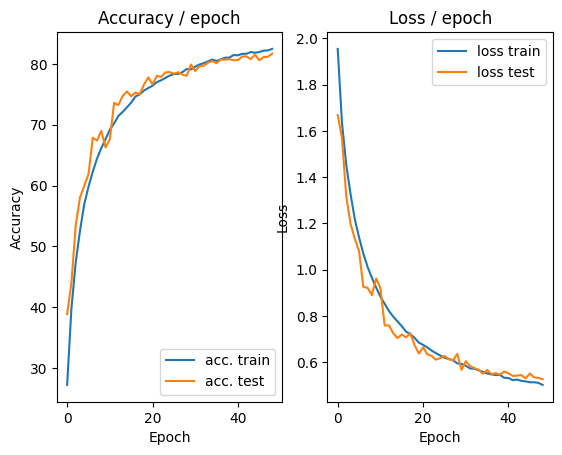

=== EPOCH 50 =====

Current learning rate: 0.008099
[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.5847 (0.5847)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.044s (0.030s)	Loss 0.5793 (0.5023)	Prec@1  82.0 ( 82.7)	Prec@5  99.2 ( 99.2)

===============> Total time 11s	Avg loss 0.5058	Avg Prec@1 82.34 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.4737 (0.4737)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5343	Avg Prec@1 81.34 %	Avg Prec@5 99.15 %



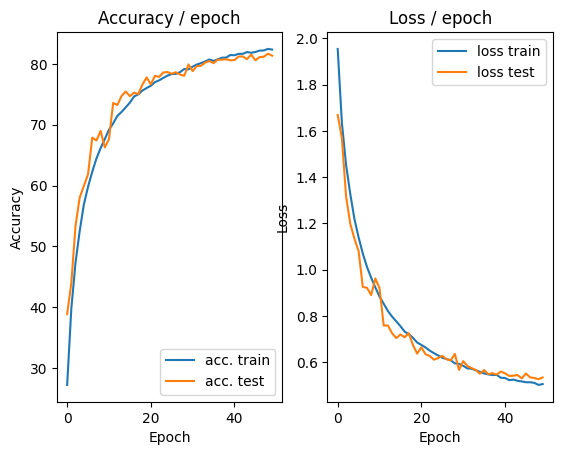

In [15]:
main(128, 0.1, 70, cuda=True)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

Current learning rate: 0.100000
[TRAIN Batch 000/391]	Time 0.110s (0.110s)	Loss 2.3013 (2.3013)	Prec@1  12.5 ( 12.5)	Prec@5  50.8 ( 50.8)
[TRAIN Batch 200/391]	Time 0.059s (0.034s)	Loss 2.0060 (2.0750)	Prec@1  21.9 ( 22.1)	Prec@5  79.7 ( 74.1)

===============> Total time 12s	Avg loss 1.9553	Avg Prec@1 27.10 %	Avg Prec@5 79.33 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 2.1131 (2.1131)	Prec@1  26.6 ( 26.6)	Prec@5  77.3 ( 77.3)

===============> Total time 1s	Avg loss 2.0992	Avg Prec@1 28.78 %	Avg Prec@5 75.91 %



<Figure size 640x480 with 0 Axes>

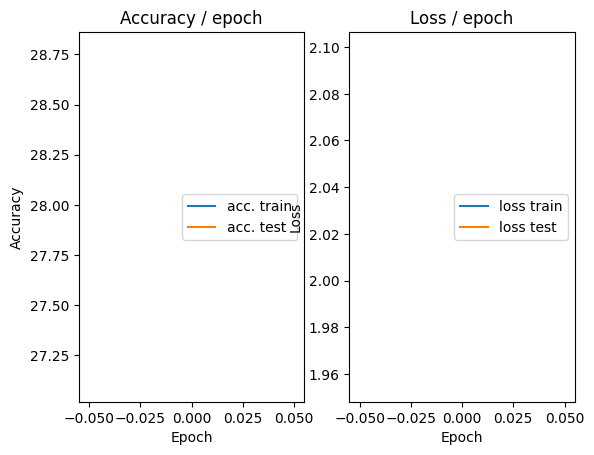

=== EPOCH 2 =====

Current learning rate: 0.095000
[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 1.9774 (1.9774)	Prec@1  32.8 ( 32.8)	Prec@5  78.9 ( 78.9)
[TRAIN Batch 200/391]	Time 0.011s (0.030s)	Loss 1.8928 (1.6852)	Prec@1  31.2 ( 37.6)	Prec@5  82.0 ( 88.6)

===============> Total time 11s	Avg loss 1.6369	Avg Prec@1 39.65 %	Avg Prec@5 89.40 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 1.4524 (1.4524)	Prec@1  53.9 ( 53.9)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.4577	Avg Prec@1 47.31 %	Avg Prec@5 92.55 %



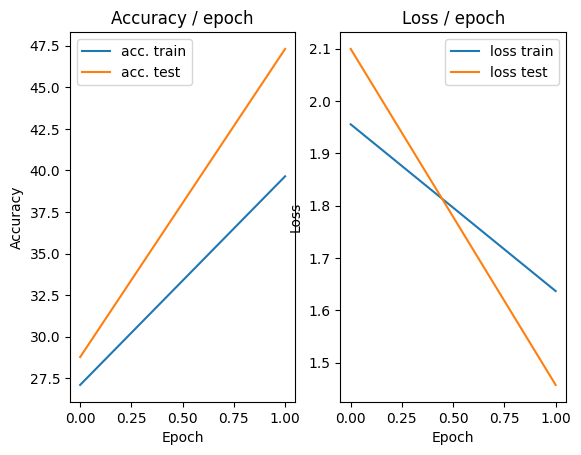

=== EPOCH 3 =====

Current learning rate: 0.090250
[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 1.5182 (1.5182)	Prec@1  47.7 ( 47.7)	Prec@5  91.4 ( 91.4)
[TRAIN Batch 200/391]	Time 0.047s (0.031s)	Loss 1.3011 (1.4833)	Prec@1  51.6 ( 46.2)	Prec@5  96.9 ( 91.8)

===============> Total time 11s	Avg loss 1.4549	Avg Prec@1 47.30 %	Avg Prec@5 92.20 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 1.2637 (1.2637)	Prec@1  54.7 ( 54.7)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.3177	Avg Prec@1 52.93 %	Avg Prec@5 94.01 %



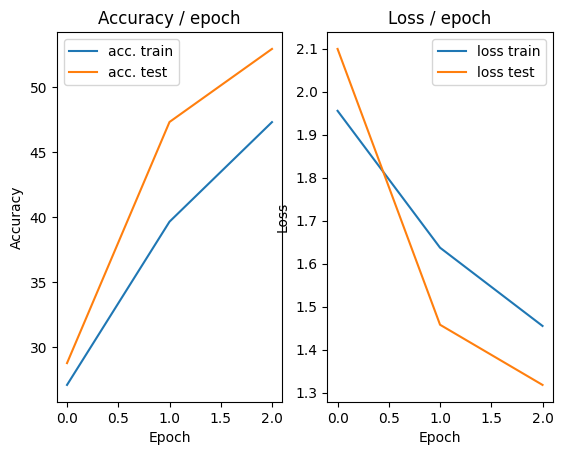

=== EPOCH 4 =====

Current learning rate: 0.085737
[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 1.3714 (1.3714)	Prec@1  44.5 ( 44.5)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.048s (0.032s)	Loss 1.3223 (1.3499)	Prec@1  52.3 ( 51.4)	Prec@5  96.1 ( 93.4)

===============> Total time 11s	Avg loss 1.3191	Avg Prec@1 52.81 %	Avg Prec@5 93.80 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 1.1697 (1.1697)	Prec@1  63.3 ( 63.3)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.2619	Avg Prec@1 54.62 %	Avg Prec@5 94.75 %



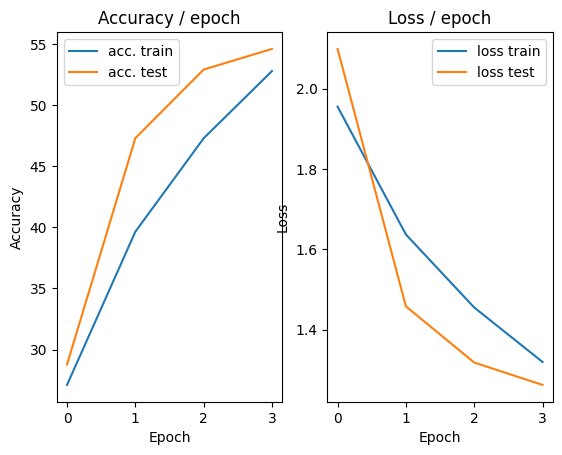

=== EPOCH 5 =====

Current learning rate: 0.081451
[TRAIN Batch 000/391]	Time 0.149s (0.149s)	Loss 1.1412 (1.1412)	Prec@1  59.4 ( 59.4)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.050s (0.030s)	Loss 1.1502 (1.2275)	Prec@1  63.3 ( 56.4)	Prec@5  93.8 ( 94.9)

===============> Total time 11s	Avg loss 1.2135	Avg Prec@1 56.93 %	Avg Prec@5 94.95 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.9772 (0.9772)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0375	Avg Prec@1 63.04 %	Avg Prec@5 96.52 %



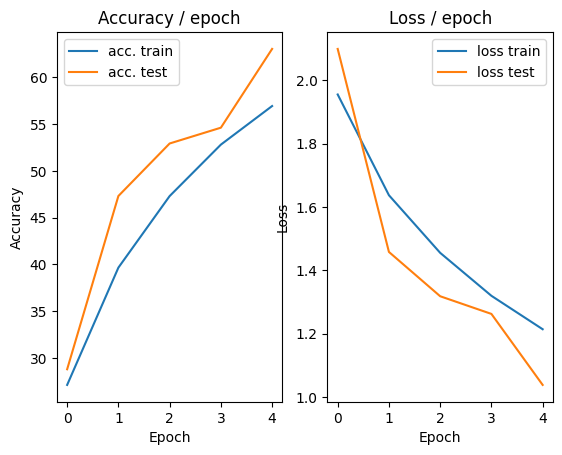

=== EPOCH 6 =====

Current learning rate: 0.077378
[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 1.0069 (1.0069)	Prec@1  60.2 ( 60.2)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.046s (0.029s)	Loss 1.0818 (1.1349)	Prec@1  59.4 ( 59.8)	Prec@5  98.4 ( 95.7)

===============> Total time 11s	Avg loss 1.1292	Avg Prec@1 60.17 %	Avg Prec@5 95.56 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.9154 (0.9154)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9521	Avg Prec@1 66.30 %	Avg Prec@5 97.07 %



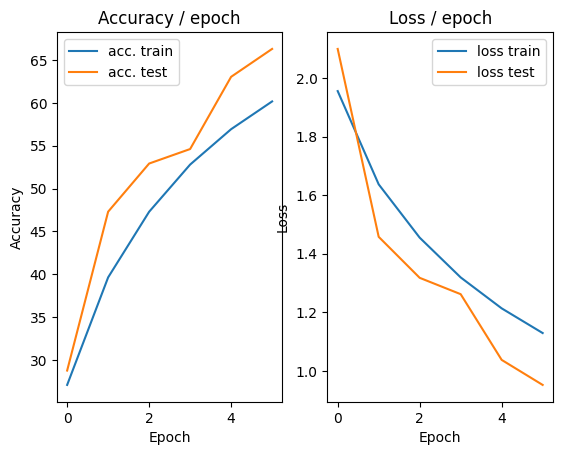

=== EPOCH 7 =====

Current learning rate: 0.073509
[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 1.0084 (1.0084)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.010s (0.036s)	Loss 0.8744 (1.0701)	Prec@1  68.8 ( 62.5)	Prec@5  98.4 ( 96.2)

===============> Total time 14s	Avg loss 1.0515	Avg Prec@1 63.07 %	Avg Prec@5 96.26 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.0833 (1.0833)	Prec@1  61.7 ( 61.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0781	Avg Prec@1 62.35 %	Avg Prec@5 96.49 %



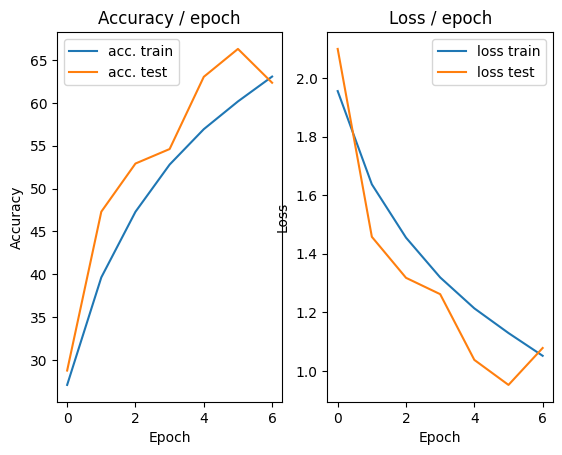

=== EPOCH 8 =====

Current learning rate: 0.069834
[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 1.1005 (1.1005)	Prec@1  63.3 ( 63.3)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.008s (0.031s)	Loss 1.0505 (1.0093)	Prec@1  61.7 ( 64.9)	Prec@5  96.1 ( 96.6)

===============> Total time 13s	Avg loss 0.9987	Avg Prec@1 65.30 %	Avg Prec@5 96.60 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.9734 (0.9734)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9913	Avg Prec@1 66.09 %	Avg Prec@5 96.58 %



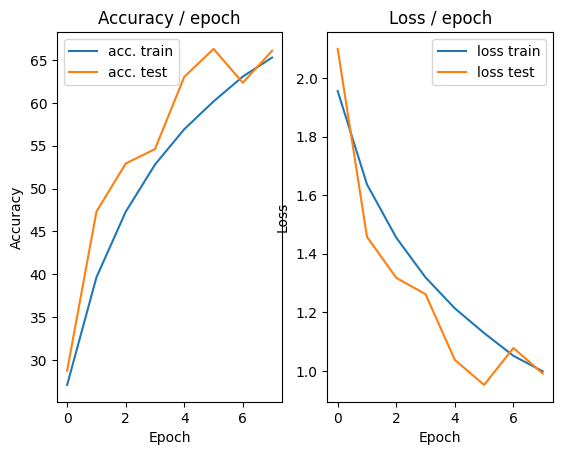

=== EPOCH 9 =====

Current learning rate: 0.066342
[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 1.0428 (1.0428)	Prec@1  57.8 ( 57.8)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.053s (0.030s)	Loss 0.9598 (0.9629)	Prec@1  64.1 ( 66.2)	Prec@5  96.1 ( 96.9)

===============> Total time 11s	Avg loss 0.9479	Avg Prec@1 66.66 %	Avg Prec@5 96.99 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.8685 (0.8685)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9240	Avg Prec@1 67.94 %	Avg Prec@5 96.86 %



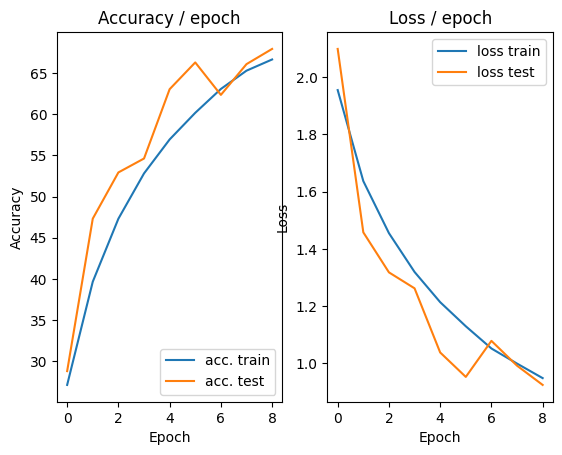

=== EPOCH 10 =====

Current learning rate: 0.063025
[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.9971 (0.9971)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.007s (0.030s)	Loss 0.9748 (0.9213)	Prec@1  62.5 ( 67.9)	Prec@5  96.1 ( 96.9)

===============> Total time 11s	Avg loss 0.9155	Avg Prec@1 68.22 %	Avg Prec@5 96.98 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.8673 (0.8673)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8414	Avg Prec@1 71.39 %	Avg Prec@5 97.82 %



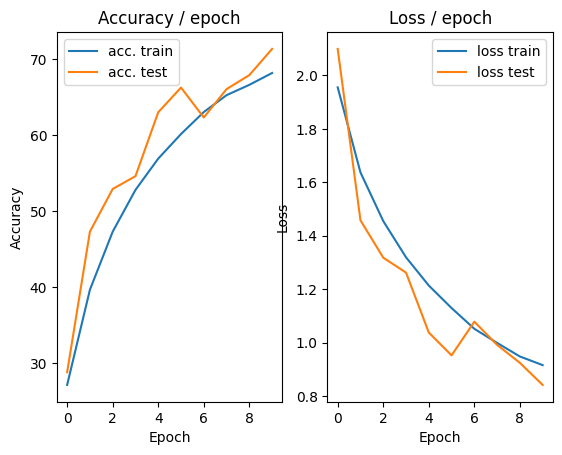

=== EPOCH 11 =====

Current learning rate: 0.059874
[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 1.0069 (1.0069)	Prec@1  67.2 ( 67.2)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.047s (0.031s)	Loss 0.9606 (0.8766)	Prec@1  67.2 ( 69.3)	Prec@5  96.1 ( 97.3)

===============> Total time 11s	Avg loss 0.8733	Avg Prec@1 69.41 %	Avg Prec@5 97.43 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.7921 (0.7921)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8063	Avg Prec@1 72.00 %	Avg Prec@5 98.05 %



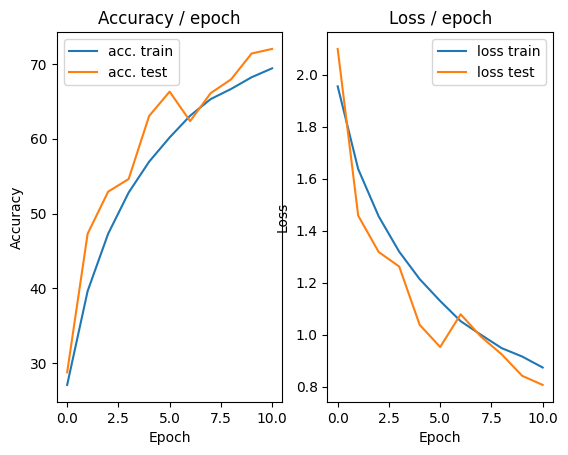

=== EPOCH 12 =====

Current learning rate: 0.056880
[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.9864 (0.9864)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.009s (0.029s)	Loss 0.6784 (0.8515)	Prec@1  74.2 ( 70.2)	Prec@5  99.2 ( 97.6)

===============> Total time 11s	Avg loss 0.8470	Avg Prec@1 70.30 %	Avg Prec@5 97.60 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.8167 (0.8167)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8032	Avg Prec@1 71.82 %	Avg Prec@5 98.00 %



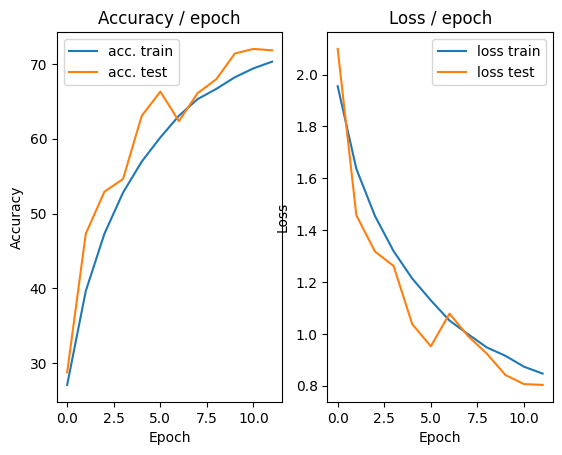

=== EPOCH 13 =====

Current learning rate: 0.054036
[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.9882 (0.9882)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.050s (0.031s)	Loss 0.7521 (0.8235)	Prec@1  73.4 ( 71.3)	Prec@5  96.9 ( 97.7)

===============> Total time 11s	Avg loss 0.8171	Avg Prec@1 71.62 %	Avg Prec@5 97.72 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.7484 (0.7484)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7991	Avg Prec@1 72.75 %	Avg Prec@5 97.96 %



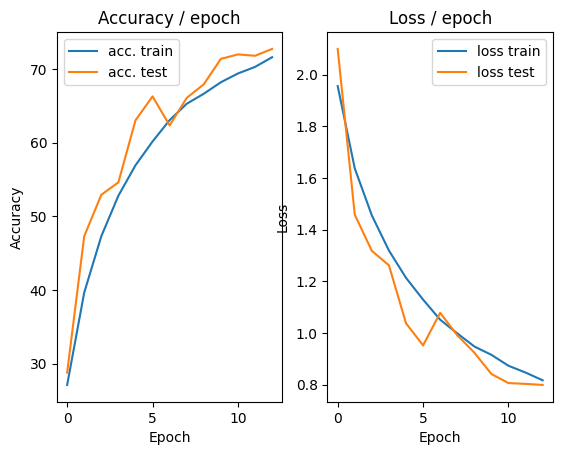

=== EPOCH 14 =====

Current learning rate: 0.051334
[TRAIN Batch 000/391]	Time 0.161s (0.161s)	Loss 0.8564 (0.8564)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.044s (0.030s)	Loss 0.7444 (0.7851)	Prec@1  75.0 ( 72.6)	Prec@5  97.7 ( 98.0)

===============> Total time 11s	Avg loss 0.7879	Avg Prec@1 72.67 %	Avg Prec@5 97.85 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 0.6198 (0.6198)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.7245	Avg Prec@1 74.86 %	Avg Prec@5 98.40 %



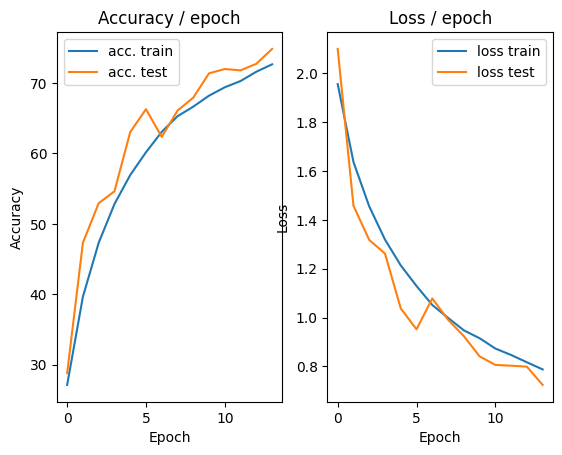

=== EPOCH 15 =====

Current learning rate: 0.048767
[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.7712 (0.7712)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.045s (0.029s)	Loss 0.8046 (0.7600)	Prec@1  68.8 ( 73.7)	Prec@5  97.7 ( 98.1)

===============> Total time 11s	Avg loss 0.7675	Avg Prec@1 73.34 %	Avg Prec@5 98.01 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.6817 (0.6817)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7527	Avg Prec@1 74.14 %	Avg Prec@5 98.30 %



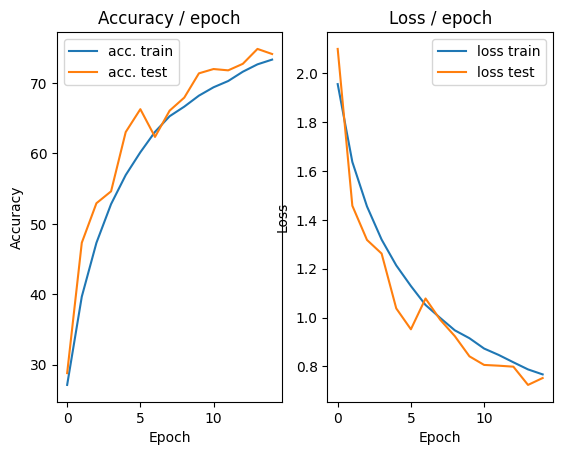

=== EPOCH 16 =====

Current learning rate: 0.046329
[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.7842 (0.7842)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.043s (0.029s)	Loss 0.6935 (0.7501)	Prec@1  75.8 ( 73.9)	Prec@5  97.7 ( 98.0)

===============> Total time 11s	Avg loss 0.7518	Avg Prec@1 73.76 %	Avg Prec@5 98.01 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.6130 (0.6130)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6937	Avg Prec@1 76.35 %	Avg Prec@5 98.57 %



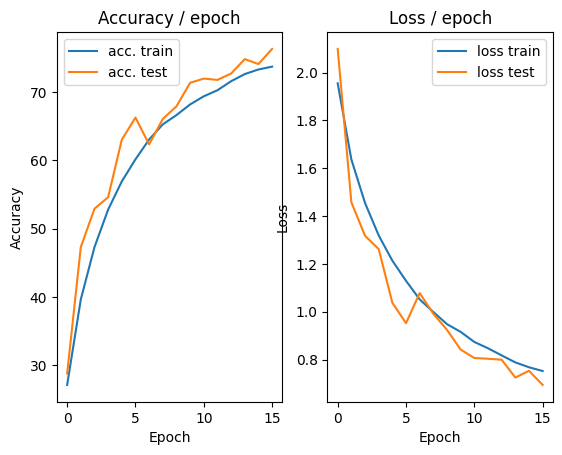

=== EPOCH 17 =====

Current learning rate: 0.044013
[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.6508 (0.6508)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.013s (0.030s)	Loss 0.6255 (0.7231)	Prec@1  76.6 ( 74.7)	Prec@5  98.4 ( 98.3)

===============> Total time 11s	Avg loss 0.7273	Avg Prec@1 74.70 %	Avg Prec@5 98.28 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.6619 (0.6619)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7045	Avg Prec@1 75.63 %	Avg Prec@5 98.58 %



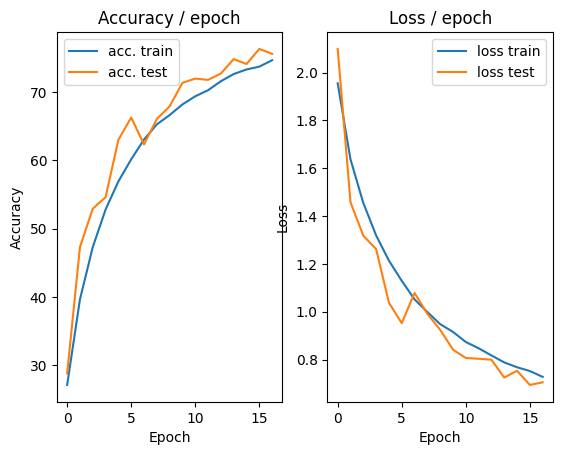

=== EPOCH 18 =====

Current learning rate: 0.041812
[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.7280 (0.7280)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.063s (0.031s)	Loss 0.8329 (0.7261)	Prec@1  73.4 ( 74.8)	Prec@5  98.4 ( 98.2)

===============> Total time 12s	Avg loss 0.7172	Avg Prec@1 75.04 %	Avg Prec@5 98.21 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.6019 (0.6019)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6947	Avg Prec@1 76.04 %	Avg Prec@5 98.50 %



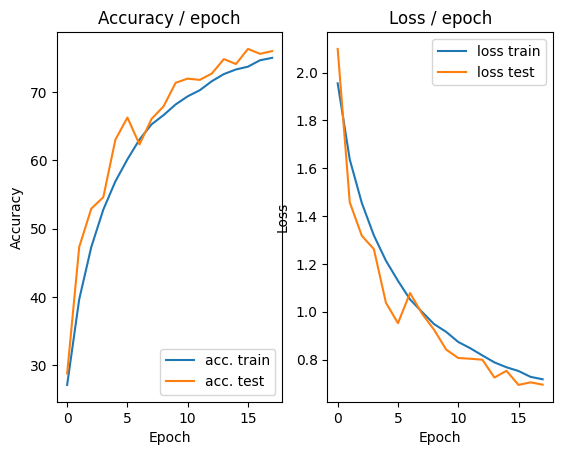

=== EPOCH 19 =====

Current learning rate: 0.039721
[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.7812 (0.7812)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.010s (0.032s)	Loss 0.7565 (0.6884)	Prec@1  75.8 ( 75.9)	Prec@5  98.4 ( 98.4)

===============> Total time 11s	Avg loss 0.6974	Avg Prec@1 75.70 %	Avg Prec@5 98.31 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.5509 (0.5509)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6450	Avg Prec@1 77.86 %	Avg Prec@5 98.66 %



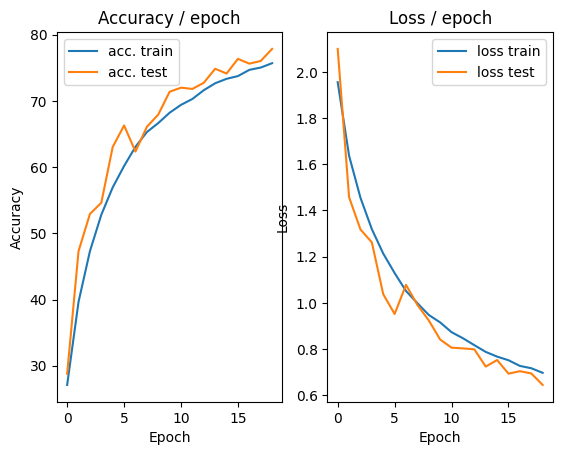

=== EPOCH 20 =====

Current learning rate: 0.037735
[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 0.6055 (0.6055)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.008s (0.043s)	Loss 0.6854 (0.6742)	Prec@1  76.6 ( 76.3)	Prec@5 100.0 ( 98.4)

===============> Total time 14s	Avg loss 0.6815	Avg Prec@1 76.10 %	Avg Prec@5 98.43 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.5474 (0.5474)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6886	Avg Prec@1 76.45 %	Avg Prec@5 98.49 %



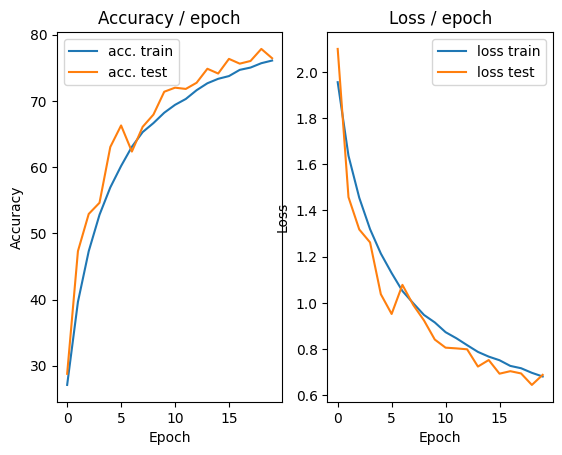

=== EPOCH 21 =====

Current learning rate: 0.035849
[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.8296 (0.8296)	Prec@1  67.2 ( 67.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.058s (0.027s)	Loss 0.7058 (0.6644)	Prec@1  74.2 ( 76.7)	Prec@5  99.2 ( 98.5)

===============> Total time 10s	Avg loss 0.6705	Avg Prec@1 76.58 %	Avg Prec@5 98.51 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 0.5373 (0.5373)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6285	Avg Prec@1 78.69 %	Avg Prec@5 98.67 %



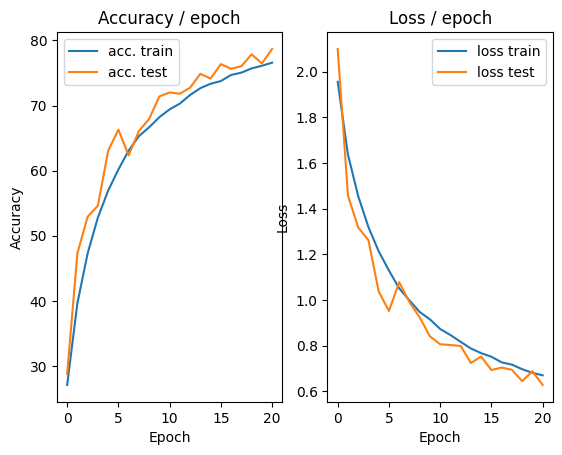

=== EPOCH 22 =====

Current learning rate: 0.034056
[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.7468 (0.7468)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.010s (0.028s)	Loss 0.5839 (0.6586)	Prec@1  78.1 ( 77.1)	Prec@5  99.2 ( 98.6)

===============> Total time 12s	Avg loss 0.6607	Avg Prec@1 76.84 %	Avg Prec@5 98.59 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 0.6030 (0.6030)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.6736	Avg Prec@1 76.56 %	Avg Prec@5 98.54 %



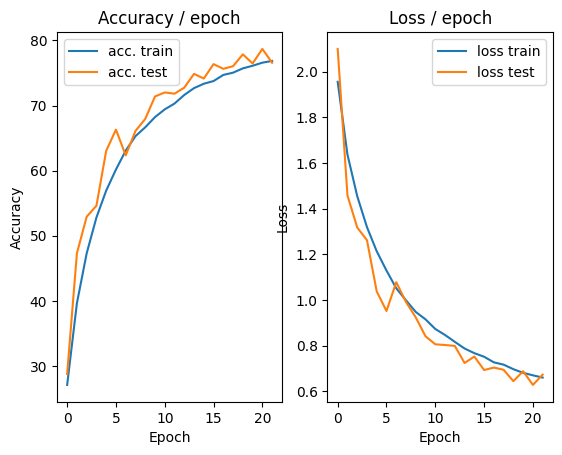

=== EPOCH 23 =====

Current learning rate: 0.032353
[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.6702 (0.6702)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.029s)	Loss 0.6506 (0.6474)	Prec@1  74.2 ( 77.3)	Prec@5  99.2 ( 98.6)

===============> Total time 11s	Avg loss 0.6487	Avg Prec@1 77.30 %	Avg Prec@5 98.60 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.5048 (0.5048)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6281	Avg Prec@1 78.62 %	Avg Prec@5 98.77 %



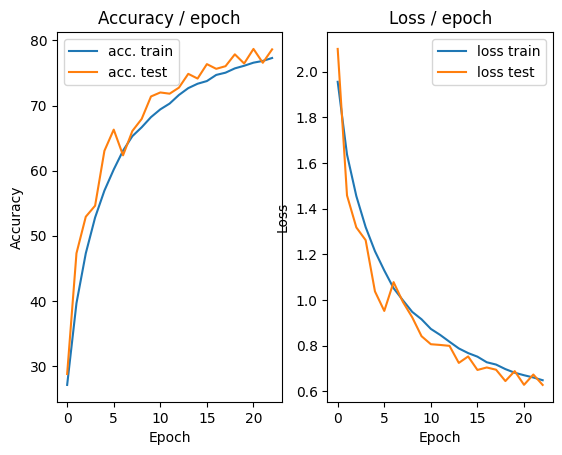

=== EPOCH 24 =====

Current learning rate: 0.030736
[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.7977 (0.7977)	Prec@1  70.3 ( 70.3)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.020s (0.029s)	Loss 0.6493 (0.6345)	Prec@1  76.6 ( 78.1)	Prec@5 100.0 ( 98.7)

===============> Total time 11s	Avg loss 0.6322	Avg Prec@1 78.16 %	Avg Prec@5 98.68 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 0.5028 (0.5028)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6005	Avg Prec@1 79.90 %	Avg Prec@5 98.91 %



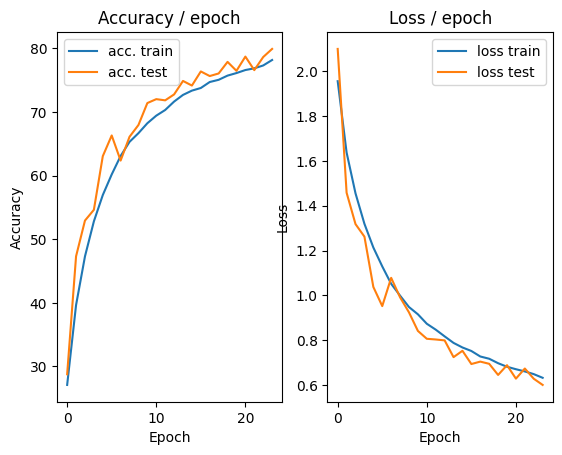

=== EPOCH 25 =====

Current learning rate: 0.029199
[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.6840 (0.6840)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.054s (0.034s)	Loss 0.6727 (0.6355)	Prec@1  76.6 ( 78.0)	Prec@5  97.7 ( 98.7)

===============> Total time 12s	Avg loss 0.6293	Avg Prec@1 78.27 %	Avg Prec@5 98.68 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.5439 (0.5439)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5950	Avg Prec@1 79.75 %	Avg Prec@5 98.91 %



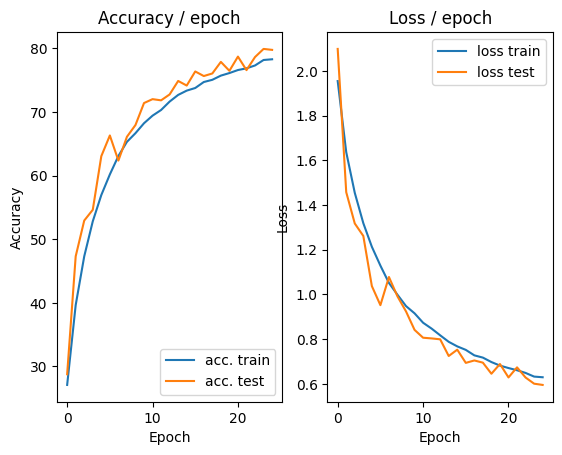

=== EPOCH 26 =====

Current learning rate: 0.027739
[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.5817 (0.5817)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.042s (0.028s)	Loss 0.6667 (0.6133)	Prec@1  73.4 ( 78.7)	Prec@5  99.2 ( 98.7)

===============> Total time 10s	Avg loss 0.6199	Avg Prec@1 78.26 %	Avg Prec@5 98.66 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.5110 (0.5110)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5920	Avg Prec@1 79.90 %	Avg Prec@5 98.89 %



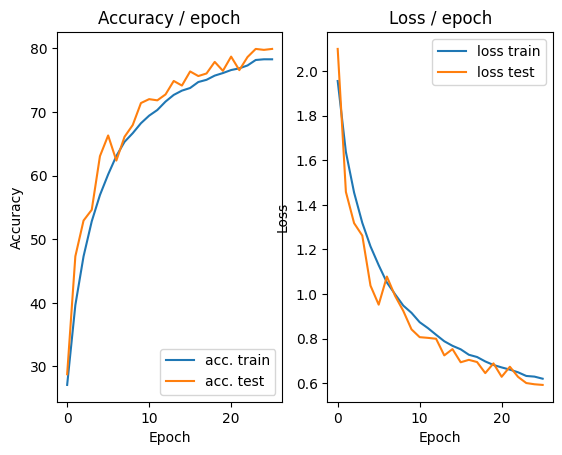

=== EPOCH 27 =====

Current learning rate: 0.026352
[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.5966 (0.5966)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.031s (0.028s)	Loss 0.6072 (0.6192)	Prec@1  77.3 ( 78.4)	Prec@5  97.7 ( 98.7)

===============> Total time 10s	Avg loss 0.6116	Avg Prec@1 78.68 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.5000 (0.5000)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6147	Avg Prec@1 78.91 %	Avg Prec@5 98.73 %



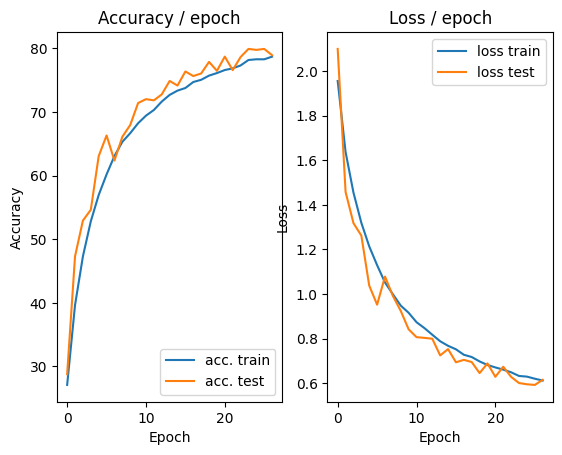

=== EPOCH 28 =====

Current learning rate: 0.025034
[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.6379 (0.6379)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.012s (0.028s)	Loss 0.4958 (0.5964)	Prec@1  84.4 ( 79.2)	Prec@5 100.0 ( 98.8)

===============> Total time 12s	Avg loss 0.6020	Avg Prec@1 79.08 %	Avg Prec@5 98.74 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 0.4664 (0.4664)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5764	Avg Prec@1 80.52 %	Avg Prec@5 98.81 %



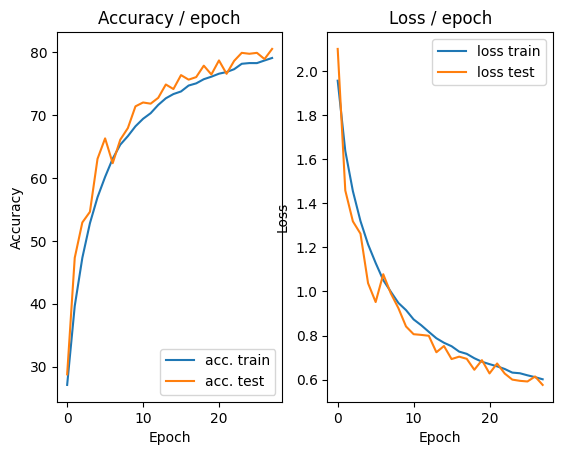

=== EPOCH 29 =====

Current learning rate: 0.023783
[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.6021 (0.6021)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.051s (0.031s)	Loss 0.6092 (0.5916)	Prec@1  78.1 ( 79.4)	Prec@5  99.2 ( 98.9)

===============> Total time 11s	Avg loss 0.5941	Avg Prec@1 79.38 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.4872 (0.4872)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5928	Avg Prec@1 79.77 %	Avg Prec@5 98.92 %



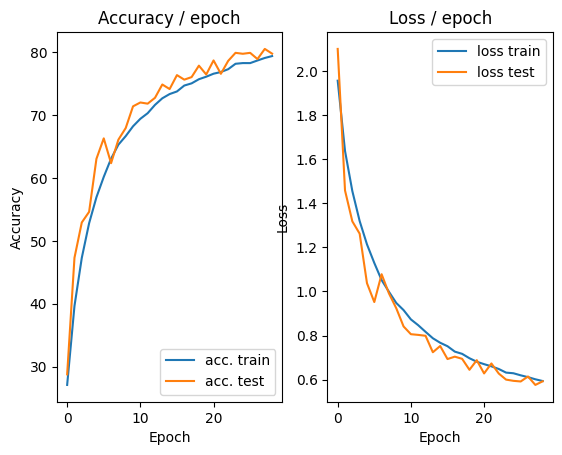

=== EPOCH 30 =====

Current learning rate: 0.022594
[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.5139 (0.5139)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.044s (0.031s)	Loss 0.4667 (0.5844)	Prec@1  82.8 ( 79.7)	Prec@5 100.0 ( 98.8)

===============> Total time 11s	Avg loss 0.5875	Avg Prec@1 79.57 %	Avg Prec@5 98.83 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 0.4637 (0.4637)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5671	Avg Prec@1 80.50 %	Avg Prec@5 99.08 %



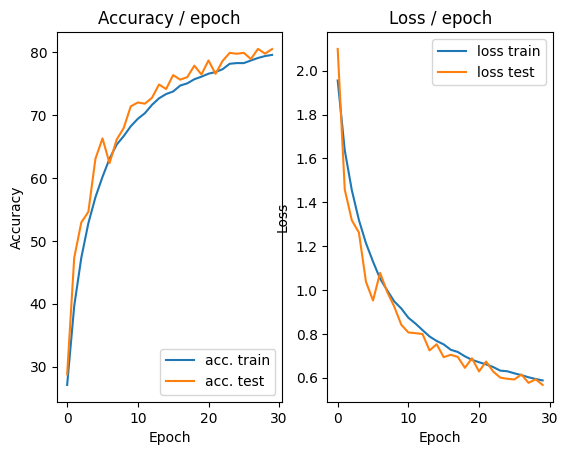

=== EPOCH 31 =====

Current learning rate: 0.021464
[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.6899 (0.6899)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.082s (0.041s)	Loss 0.4112 (0.5831)	Prec@1  82.0 ( 79.4)	Prec@5 100.0 ( 98.9)

===============> Total time 14s	Avg loss 0.5831	Avg Prec@1 79.66 %	Avg Prec@5 98.84 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.4437 (0.4437)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5660	Avg Prec@1 80.91 %	Avg Prec@5 98.85 %



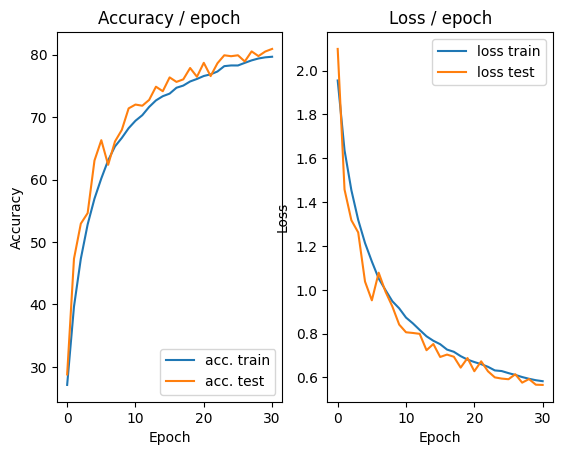

=== EPOCH 32 =====

Current learning rate: 0.020391
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.6581 (0.6581)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.007s (0.029s)	Loss 0.6581 (0.5632)	Prec@1  76.6 ( 80.3)	Prec@5  98.4 ( 98.9)

===============> Total time 12s	Avg loss 0.5705	Avg Prec@1 80.05 %	Avg Prec@5 98.91 %

[EVAL Batch 000/079]	Time 0.220s (0.220s)	Loss 0.4481 (0.4481)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5640	Avg Prec@1 80.73 %	Avg Prec@5 98.89 %



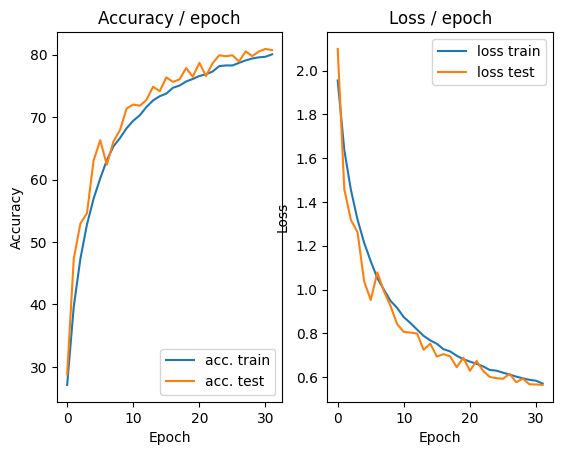

=== EPOCH 33 =====

Current learning rate: 0.019371
[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.4778 (0.4778)	Prec@1  85.9 ( 85.9)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.011s (0.046s)	Loss 0.5700 (0.5638)	Prec@1  81.2 ( 80.2)	Prec@5 100.0 ( 98.8)

===============> Total time 18s	Avg loss 0.5678	Avg Prec@1 80.17 %	Avg Prec@5 98.83 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 0.4337 (0.4337)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5657	Avg Prec@1 81.01 %	Avg Prec@5 98.88 %



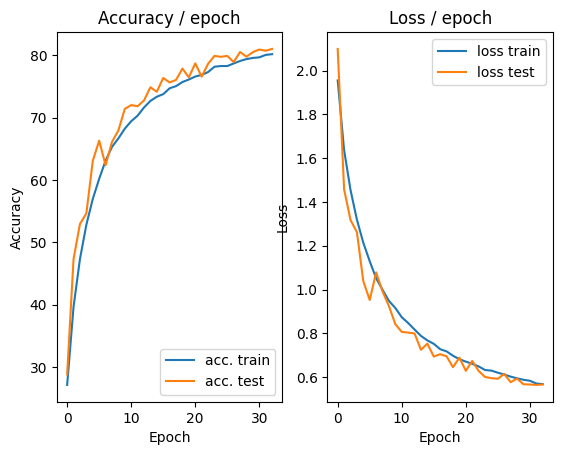

=== EPOCH 34 =====

Current learning rate: 0.018403
[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.5955 (0.5955)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.044s (0.030s)	Loss 0.6051 (0.5601)	Prec@1  76.6 ( 80.4)	Prec@5  99.2 ( 99.0)

===============> Total time 11s	Avg loss 0.5586	Avg Prec@1 80.61 %	Avg Prec@5 99.00 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.4604 (0.4604)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5648	Avg Prec@1 80.90 %	Avg Prec@5 99.00 %



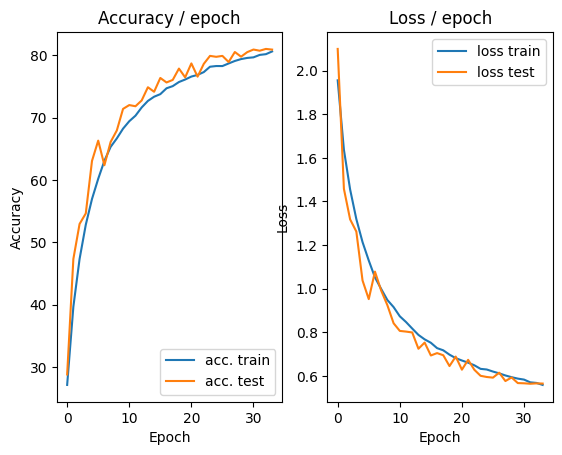

=== EPOCH 35 =====

Current learning rate: 0.017482
[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.5305 (0.5305)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.039s (0.028s)	Loss 0.5518 (0.5567)	Prec@1  79.7 ( 80.5)	Prec@5  99.2 ( 98.9)

===============> Total time 11s	Avg loss 0.5591	Avg Prec@1 80.49 %	Avg Prec@5 98.90 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.4847 (0.4847)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5810	Avg Prec@1 80.41 %	Avg Prec@5 98.99 %



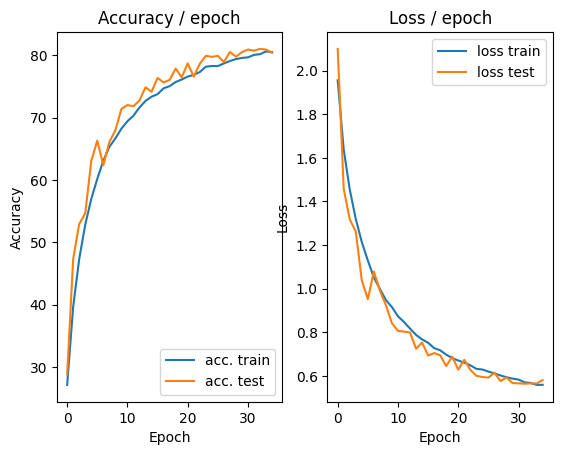

=== EPOCH 36 =====

Current learning rate: 0.016608
[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.4897 (0.4897)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.058s (0.029s)	Loss 0.6417 (0.5552)	Prec@1  78.1 ( 80.6)	Prec@5  98.4 ( 99.0)

===============> Total time 11s	Avg loss 0.5516	Avg Prec@1 80.70 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.4147 (0.4147)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5527	Avg Prec@1 81.45 %	Avg Prec@5 99.05 %



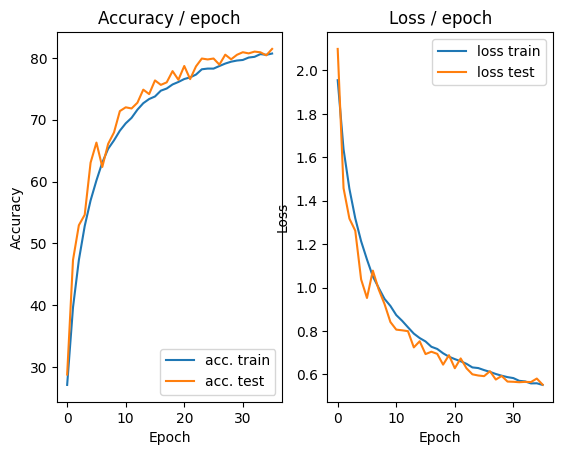

=== EPOCH 37 =====

Current learning rate: 0.015778
[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.5444 (0.5444)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.091s (0.039s)	Loss 0.5520 (0.5419)	Prec@1  82.8 ( 81.2)	Prec@5  97.7 ( 99.1)

===============> Total time 13s	Avg loss 0.5447	Avg Prec@1 80.99 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.4251 (0.4251)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5675	Avg Prec@1 81.30 %	Avg Prec@5 99.10 %



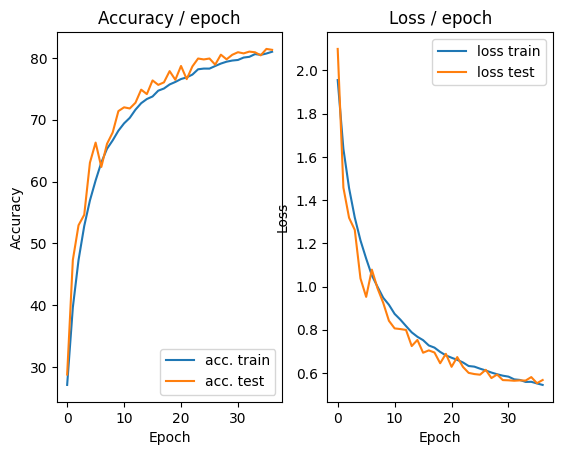

=== EPOCH 38 =====

Current learning rate: 0.014989
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.5601 (0.5601)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.047s (0.028s)	Loss 0.4534 (0.5436)	Prec@1  85.9 ( 81.1)	Prec@5 100.0 ( 98.9)

===============> Total time 11s	Avg loss 0.5408	Avg Prec@1 81.23 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 0.4340 (0.4340)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5511	Avg Prec@1 81.61 %	Avg Prec@5 98.89 %



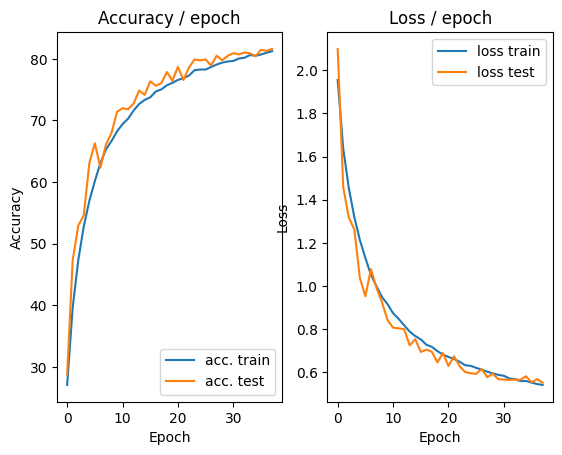

=== EPOCH 39 =====

Current learning rate: 0.014240
[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.5041 (0.5041)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.045s (0.029s)	Loss 0.3975 (0.5366)	Prec@1  88.3 ( 81.1)	Prec@5 100.0 ( 99.1)

===============> Total time 11s	Avg loss 0.5365	Avg Prec@1 81.19 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.4438 (0.4438)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5454	Avg Prec@1 81.84 %	Avg Prec@5 99.05 %



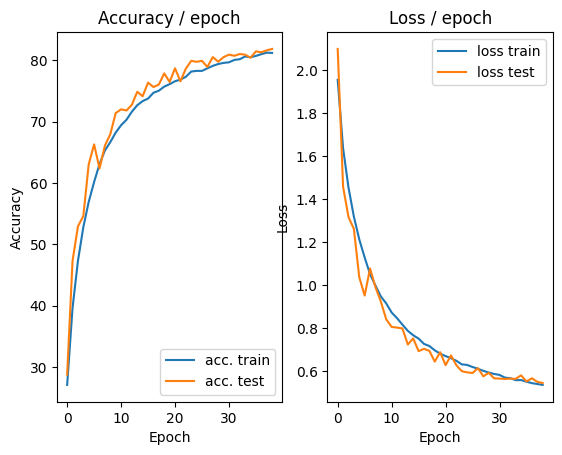

=== EPOCH 40 =====

Current learning rate: 0.013528
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.5813 (0.5813)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.058s (0.032s)	Loss 0.4685 (0.5343)	Prec@1  82.0 ( 81.7)	Prec@5  99.2 ( 99.0)

===============> Total time 12s	Avg loss 0.5317	Avg Prec@1 81.67 %	Avg Prec@5 98.99 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.4718 (0.4718)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5491	Avg Prec@1 81.42 %	Avg Prec@5 98.91 %



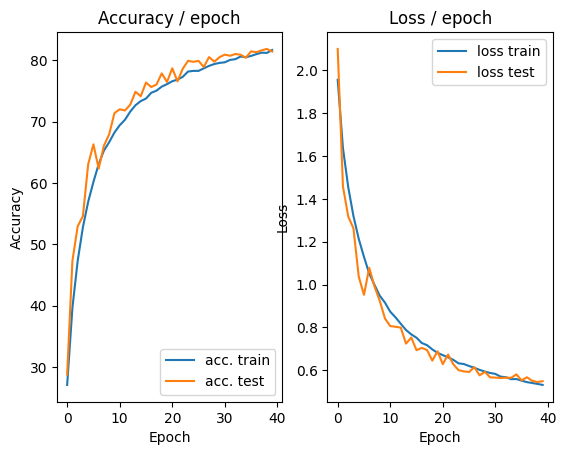

=== EPOCH 41 =====

Current learning rate: 0.012851
[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.6200 (0.6200)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.046s (0.036s)	Loss 0.5207 (0.5291)	Prec@1  84.4 ( 81.7)	Prec@5  98.4 ( 99.0)

===============> Total time 12s	Avg loss 0.5289	Avg Prec@1 81.53 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.4072 (0.4072)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5369	Avg Prec@1 82.21 %	Avg Prec@5 99.03 %



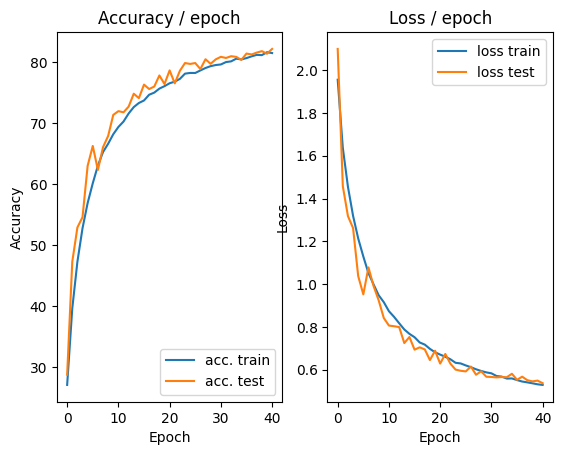

=== EPOCH 42 =====

Current learning rate: 0.012209
[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.4214 (0.4214)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.042s (0.031s)	Loss 0.5521 (0.5203)	Prec@1  79.7 ( 81.9)	Prec@5  97.7 ( 99.1)

===============> Total time 12s	Avg loss 0.5232	Avg Prec@1 81.71 %	Avg Prec@5 99.09 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 0.4190 (0.4190)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5344	Avg Prec@1 82.13 %	Avg Prec@5 99.12 %



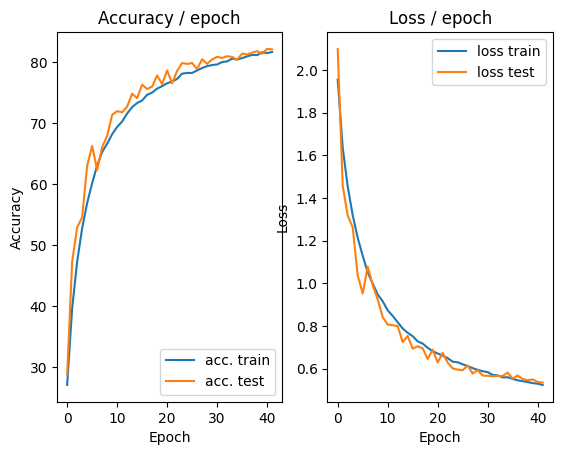

=== EPOCH 43 =====

Current learning rate: 0.011598
[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.6058 (0.6058)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.009s (0.034s)	Loss 0.4418 (0.5318)	Prec@1  89.1 ( 81.3)	Prec@5  99.2 ( 99.0)

===============> Total time 13s	Avg loss 0.5270	Avg Prec@1 81.55 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 0.4493 (0.4493)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5382	Avg Prec@1 82.14 %	Avg Prec@5 99.08 %



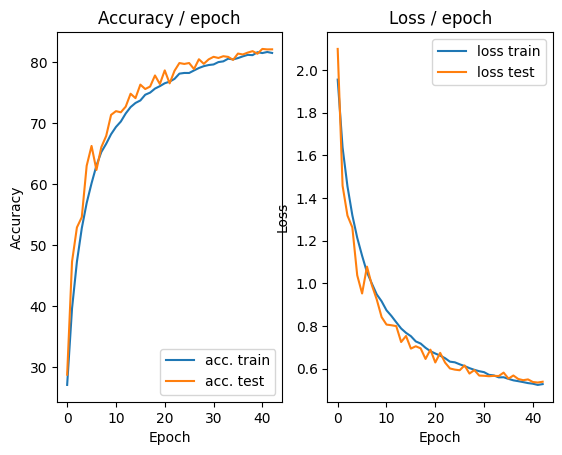

=== EPOCH 44 =====

Current learning rate: 0.011018
[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.5090 (0.5090)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.043s (0.031s)	Loss 0.6243 (0.5219)	Prec@1  79.7 ( 81.7)	Prec@5 100.0 ( 99.1)

===============> Total time 11s	Avg loss 0.5162	Avg Prec@1 81.96 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.4287 (0.4287)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5353	Avg Prec@1 82.04 %	Avg Prec@5 99.12 %



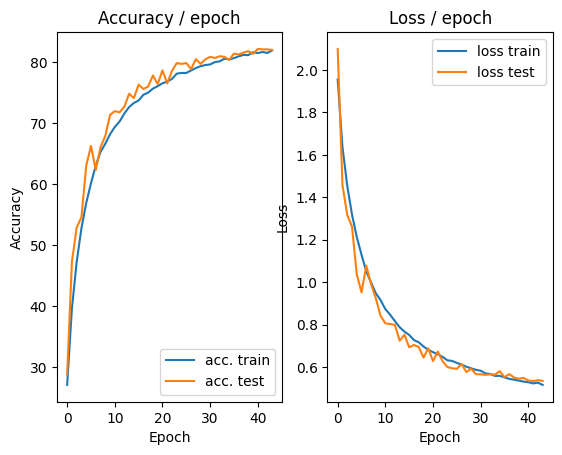

=== EPOCH 45 =====

Current learning rate: 0.010467
[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.4962 (0.4962)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.046s (0.030s)	Loss 0.4382 (0.5097)	Prec@1  87.5 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 11s	Avg loss 0.5196	Avg Prec@1 81.76 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.4340 (0.4340)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5322	Avg Prec@1 82.27 %	Avg Prec@5 99.06 %



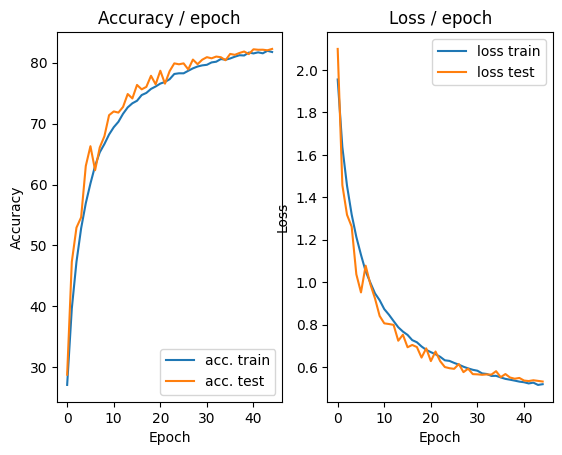

=== EPOCH 46 =====

Current learning rate: 0.009944
[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.8041 (0.8041)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.051s (0.028s)	Loss 0.6647 (0.5174)	Prec@1  78.1 ( 81.9)	Prec@5  99.2 ( 99.1)

===============> Total time 11s	Avg loss 0.5150	Avg Prec@1 82.02 %	Avg Prec@5 99.11 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.4025 (0.4025)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5384	Avg Prec@1 81.92 %	Avg Prec@5 99.12 %



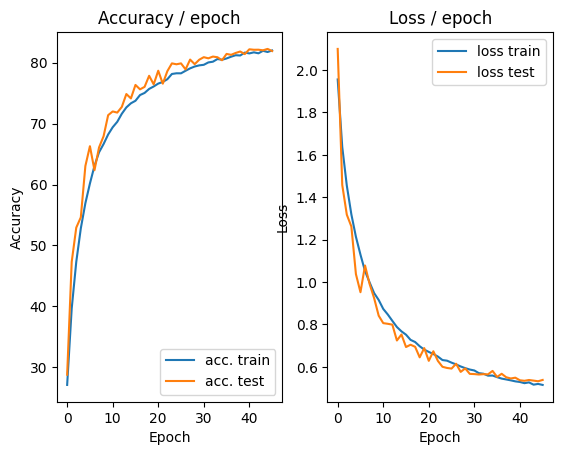

=== EPOCH 47 =====

Current learning rate: 0.009447
[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.5442 (0.5442)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.044s (0.029s)	Loss 0.4435 (0.5052)	Prec@1  85.2 ( 82.5)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5087	Avg Prec@1 82.26 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.4172 (0.4172)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5373	Avg Prec@1 81.87 %	Avg Prec@5 98.98 %



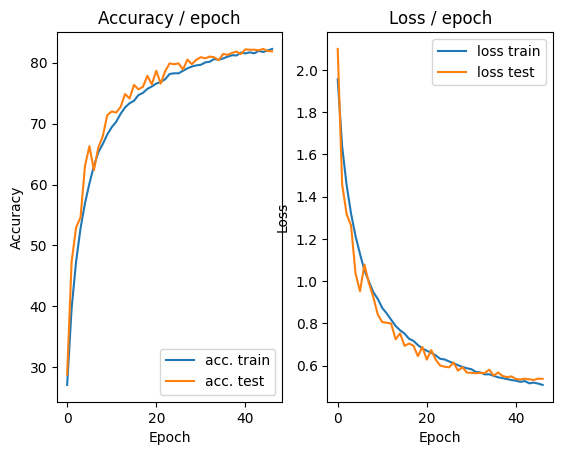

=== EPOCH 48 =====

Current learning rate: 0.008974
[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.6672 (0.6672)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.009s (0.031s)	Loss 0.4665 (0.5109)	Prec@1  82.8 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 13s	Avg loss 0.5106	Avg Prec@1 82.14 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 0.4105 (0.4105)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5448	Avg Prec@1 81.55 %	Avg Prec@5 99.07 %



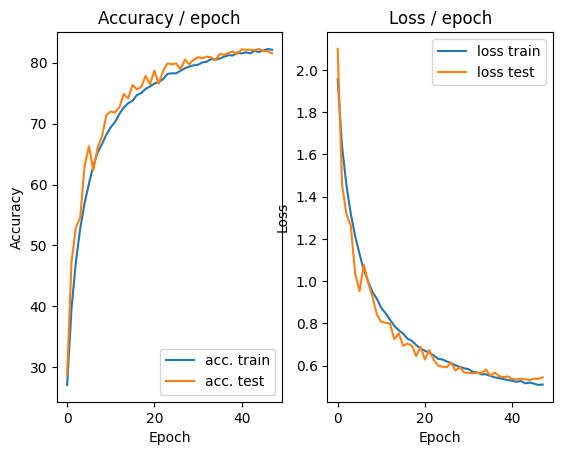

=== EPOCH 49 =====

Current learning rate: 0.008526
[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.6039 (0.6039)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.078s (0.032s)	Loss 0.4823 (0.4953)	Prec@1  80.5 ( 82.7)	Prec@5  99.2 ( 99.2)

===============> Total time 12s	Avg loss 0.5026	Avg Prec@1 82.48 %	Avg Prec@5 99.13 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 0.3928 (0.3928)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5260	Avg Prec@1 82.48 %	Avg Prec@5 99.09 %



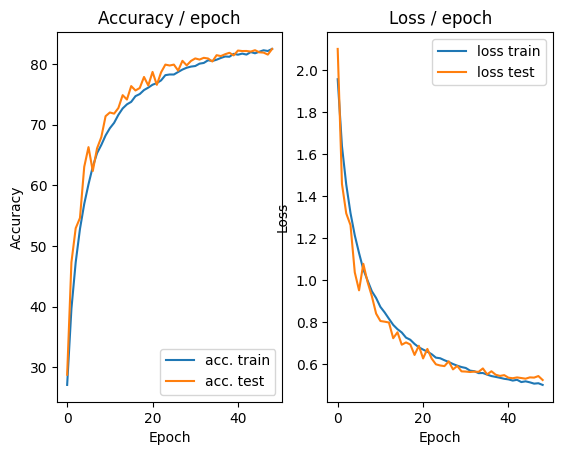

=== EPOCH 50 =====

Current learning rate: 0.008099
[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.4778 (0.4778)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.052s (0.032s)	Loss 0.4360 (0.4981)	Prec@1  84.4 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 12s	Avg loss 0.5002	Avg Prec@1 82.63 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 0.3899 (0.3899)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5280	Avg Prec@1 82.49 %	Avg Prec@5 99.07 %



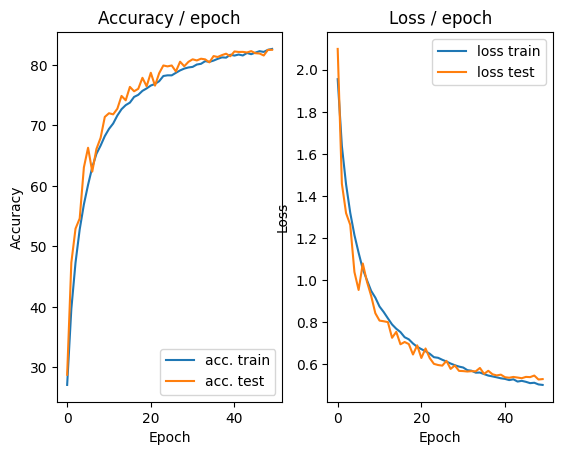

=== EPOCH 51 =====

Current learning rate: 0.007694
[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.4920 (0.4920)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.060s (0.035s)	Loss 0.6022 (0.4992)	Prec@1  76.6 ( 82.7)	Prec@5 100.0 ( 99.1)

===============> Total time 14s	Avg loss 0.5012	Avg Prec@1 82.62 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.3856 (0.3856)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5173	Avg Prec@1 82.59 %	Avg Prec@5 99.14 %



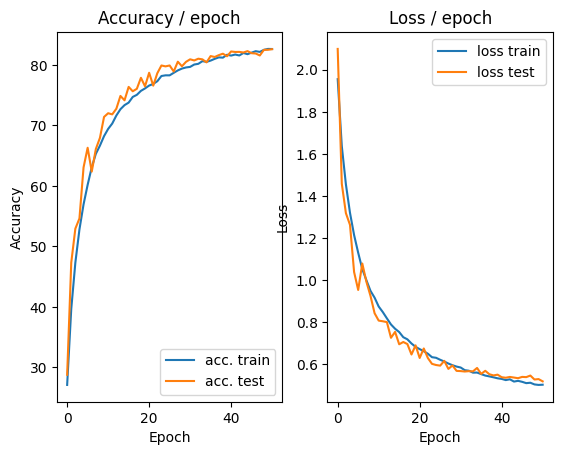

=== EPOCH 52 =====

Current learning rate: 0.007310
[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.5993 (0.5993)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.043s (0.039s)	Loss 0.4640 (0.5035)	Prec@1  81.2 ( 82.6)	Prec@5  99.2 ( 99.2)

===============> Total time 13s	Avg loss 0.4992	Avg Prec@1 82.80 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.4059 (0.4059)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5226	Avg Prec@1 82.29 %	Avg Prec@5 99.05 %



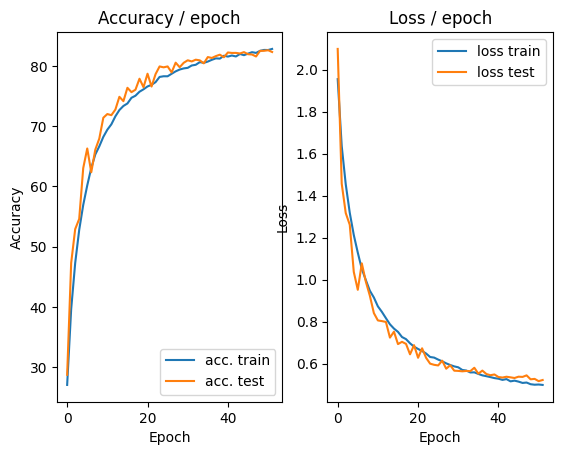

=== EPOCH 53 =====

Current learning rate: 0.006944
[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.5228 (0.5228)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.011s (0.028s)	Loss 0.3546 (0.4987)	Prec@1  88.3 ( 82.7)	Prec@5  99.2 ( 99.1)

===============> Total time 11s	Avg loss 0.4987	Avg Prec@1 82.72 %	Avg Prec@5 99.18 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 0.4016 (0.4016)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5240	Avg Prec@1 82.77 %	Avg Prec@5 99.02 %



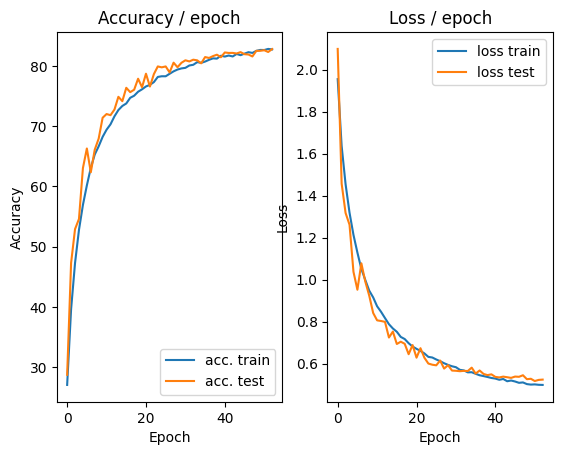

=== EPOCH 54 =====

Current learning rate: 0.006597
[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.5168 (0.5168)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.038s (0.033s)	Loss 0.5644 (0.4869)	Prec@1  77.3 ( 83.3)	Prec@5 100.0 ( 99.2)

===============> Total time 12s	Avg loss 0.4906	Avg Prec@1 82.92 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.3830 (0.3830)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5180	Avg Prec@1 82.33 %	Avg Prec@5 99.16 %



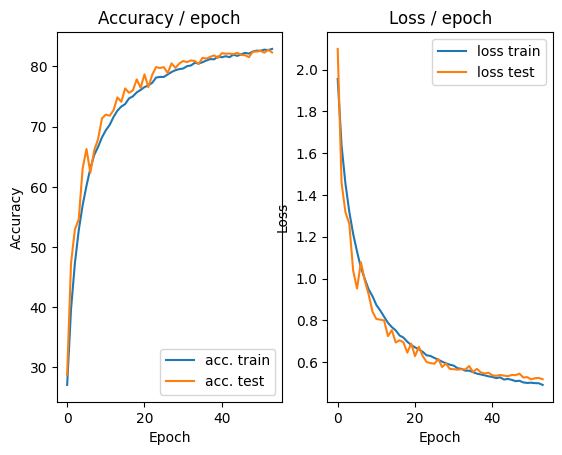

=== EPOCH 55 =====

Current learning rate: 0.006267
[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.5799 (0.5799)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.047s (0.027s)	Loss 0.5172 (0.4850)	Prec@1  84.4 ( 83.2)	Prec@5 100.0 ( 99.2)

===============> Total time 10s	Avg loss 0.4883	Avg Prec@1 83.07 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.3803 (0.3803)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5156	Avg Prec@1 82.72 %	Avg Prec@5 99.17 %



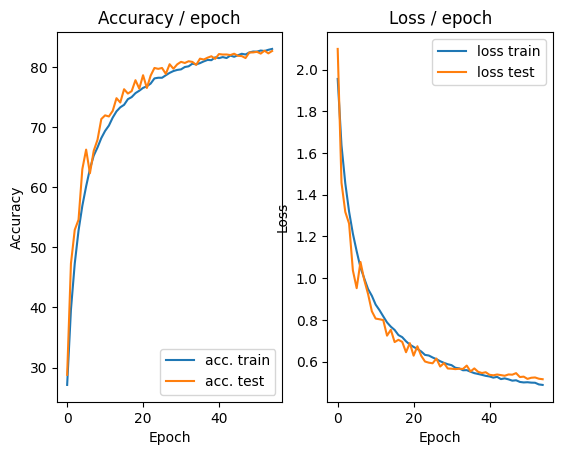

=== EPOCH 56 =====

Current learning rate: 0.005954
[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.3731 (0.3731)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.4148 (0.4780)	Prec@1  87.5 ( 83.7)	Prec@5  99.2 ( 99.2)

===============> Total time 10s	Avg loss 0.4865	Avg Prec@1 83.13 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.071s (0.071s)	Loss 0.3710 (0.3710)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5148	Avg Prec@1 82.84 %	Avg Prec@5 99.19 %



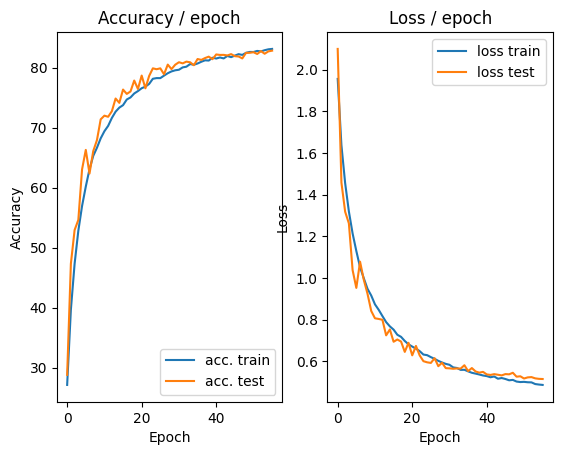

=== EPOCH 57 =====

Current learning rate: 0.005656
[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.5210 (0.5210)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.047s (0.028s)	Loss 0.4352 (0.4920)	Prec@1  86.7 ( 82.7)	Prec@5 100.0 ( 99.1)

===============> Total time 10s	Avg loss 0.4837	Avg Prec@1 82.94 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.3734 (0.3734)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5155	Avg Prec@1 82.60 %	Avg Prec@5 99.19 %



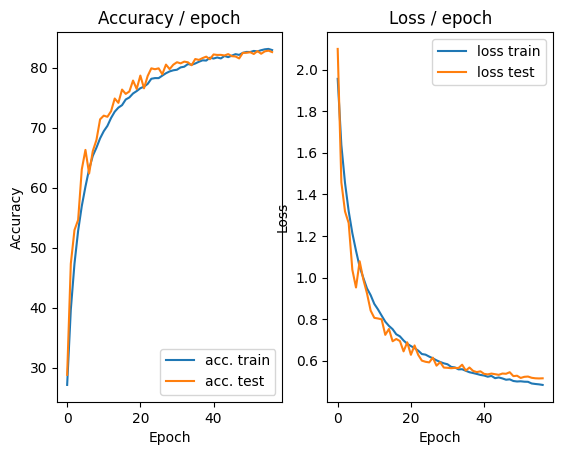

=== EPOCH 58 =====

Current learning rate: 0.005373
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.5414 (0.5414)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.045s (0.033s)	Loss 0.3993 (0.4821)	Prec@1  83.6 ( 83.1)	Prec@5 100.0 ( 99.2)

===============> Total time 11s	Avg loss 0.4842	Avg Prec@1 83.03 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.3576 (0.3576)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5154	Avg Prec@1 82.62 %	Avg Prec@5 99.19 %



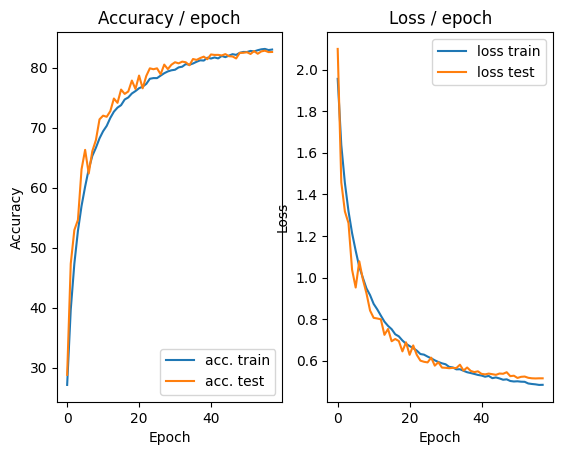

=== EPOCH 59 =====

Current learning rate: 0.005105
[TRAIN Batch 000/391]	Time 0.114s (0.114s)	Loss 0.5133 (0.5133)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.051s (0.028s)	Loss 0.4958 (0.4794)	Prec@1  86.7 ( 83.1)	Prec@5  98.4 ( 99.2)

===============> Total time 10s	Avg loss 0.4831	Avg Prec@1 83.10 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.3798 (0.3798)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5135	Avg Prec@1 82.76 %	Avg Prec@5 99.19 %



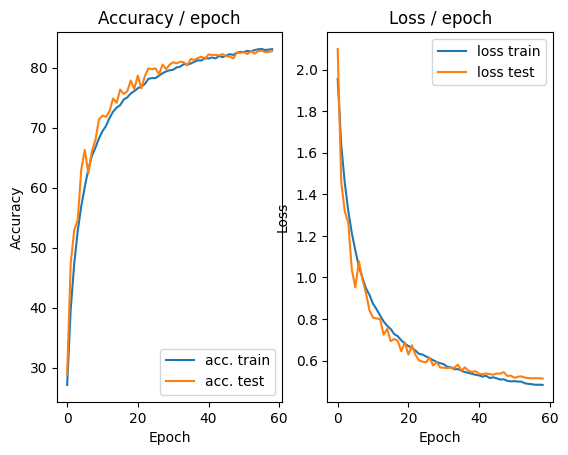

=== EPOCH 60 =====

Current learning rate: 0.004849
[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.5805 (0.5805)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.029s)	Loss 0.4928 (0.4890)	Prec@1  82.8 ( 83.1)	Prec@5  99.2 ( 99.2)

===============> Total time 11s	Avg loss 0.4845	Avg Prec@1 83.24 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.3757 (0.3757)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5155	Avg Prec@1 82.96 %	Avg Prec@5 99.22 %



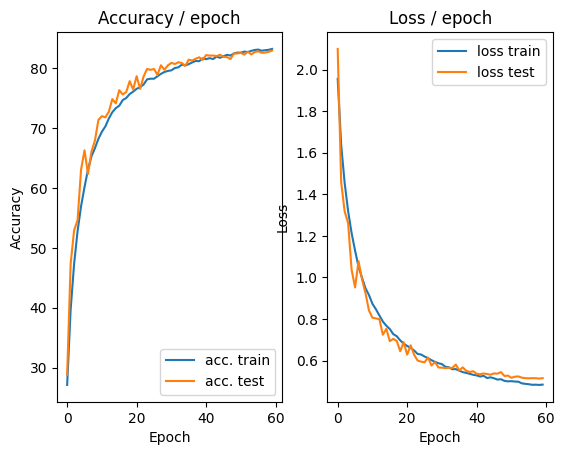

=== EPOCH 61 =====

Current learning rate: 0.004607
[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.4801 (0.4801)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.028s)	Loss 0.4285 (0.4873)	Prec@1  84.4 ( 83.1)	Prec@5 100.0 ( 99.2)

===============> Total time 10s	Avg loss 0.4808	Avg Prec@1 83.20 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.3852 (0.3852)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5140	Avg Prec@1 82.91 %	Avg Prec@5 99.18 %



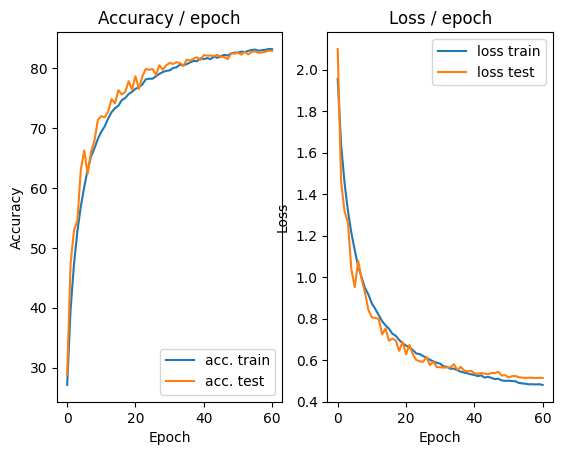

=== EPOCH 62 =====

Current learning rate: 0.004377
[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.4811 (0.4811)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.4940 (0.4773)	Prec@1  80.5 ( 83.3)	Prec@5  98.4 ( 99.2)

===============> Total time 10s	Avg loss 0.4786	Avg Prec@1 83.34 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.3542 (0.3542)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5183	Avg Prec@1 82.59 %	Avg Prec@5 99.14 %



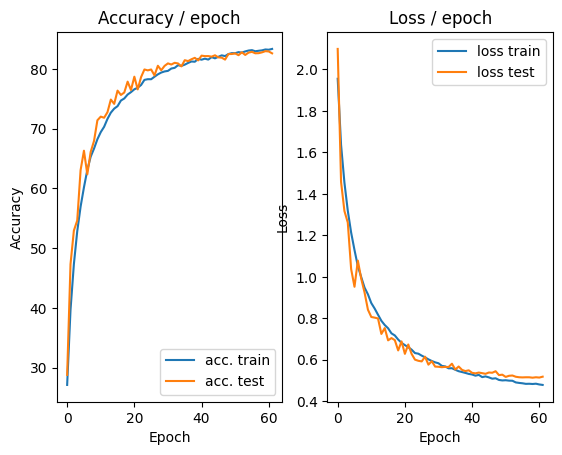

=== EPOCH 63 =====

Current learning rate: 0.004158
[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.5292 (0.5292)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.040s (0.027s)	Loss 0.3479 (0.4839)	Prec@1  88.3 ( 83.2)	Prec@5 100.0 ( 99.3)

===============> Total time 10s	Avg loss 0.4826	Avg Prec@1 83.27 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.3580 (0.3580)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5101	Avg Prec@1 83.10 %	Avg Prec@5 99.14 %



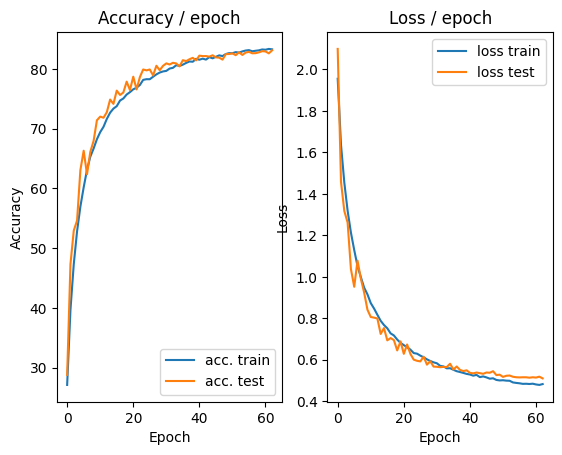

=== EPOCH 64 =====

Current learning rate: 0.003950
[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.5550 (0.5550)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.049s (0.027s)	Loss 0.3517 (0.4757)	Prec@1  89.1 ( 83.5)	Prec@5  99.2 ( 99.2)

===============> Total time 10s	Avg loss 0.4796	Avg Prec@1 83.40 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.3713 (0.3713)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5124	Avg Prec@1 82.84 %	Avg Prec@5 99.19 %



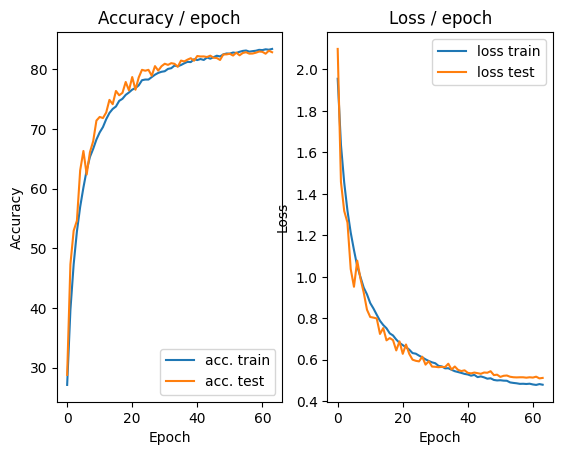

=== EPOCH 65 =====

Current learning rate: 0.003752
[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.4779 (0.4779)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.042s (0.028s)	Loss 0.6275 (0.4788)	Prec@1  81.2 ( 83.1)	Prec@5  97.7 ( 99.3)

===============> Total time 10s	Avg loss 0.4770	Avg Prec@1 83.23 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.099s (0.099s)	Loss 0.3555 (0.3555)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5068	Avg Prec@1 83.13 %	Avg Prec@5 99.21 %



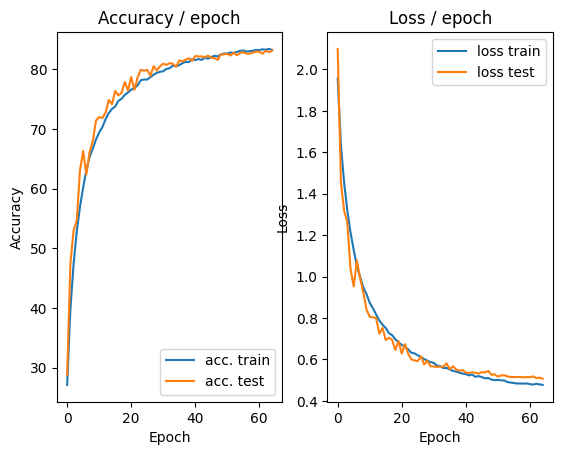

=== EPOCH 66 =====

Current learning rate: 0.003565
[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.5793 (0.5793)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.7028 (0.4670)	Prec@1  76.6 ( 83.6)	Prec@5  96.1 ( 99.3)

===============> Total time 10s	Avg loss 0.4744	Avg Prec@1 83.27 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.3516 (0.3516)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5062	Avg Prec@1 83.10 %	Avg Prec@5 99.21 %



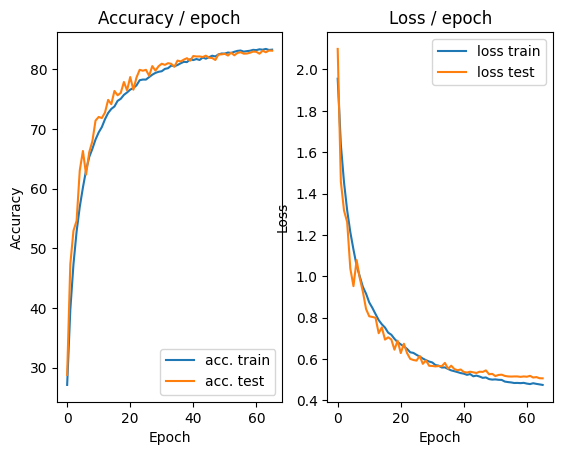

=== EPOCH 67 =====

Current learning rate: 0.003387
[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.4941 (0.4941)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.047s (0.029s)	Loss 0.4982 (0.4763)	Prec@1  81.2 ( 83.3)	Prec@5 100.0 ( 99.3)

===============> Total time 11s	Avg loss 0.4741	Avg Prec@1 83.44 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 0.3621 (0.3621)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5054	Avg Prec@1 83.13 %	Avg Prec@5 99.17 %



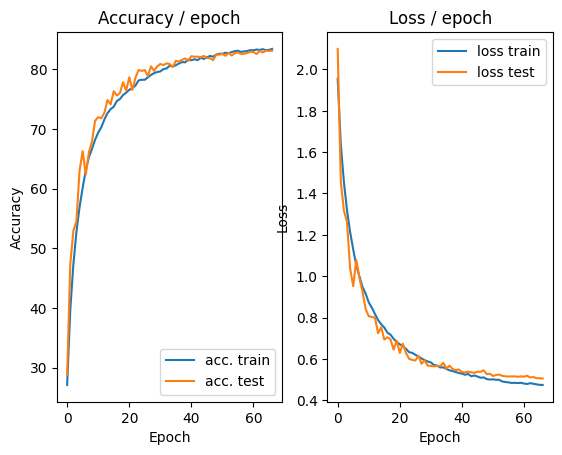

=== EPOCH 68 =====

Current learning rate: 0.003217
[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.4404 (0.4404)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.029s)	Loss 0.4872 (0.4724)	Prec@1  79.7 ( 83.6)	Prec@5 100.0 ( 99.2)

===============> Total time 12s	Avg loss 0.4729	Avg Prec@1 83.52 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.3536 (0.3536)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5084	Avg Prec@1 82.93 %	Avg Prec@5 99.24 %



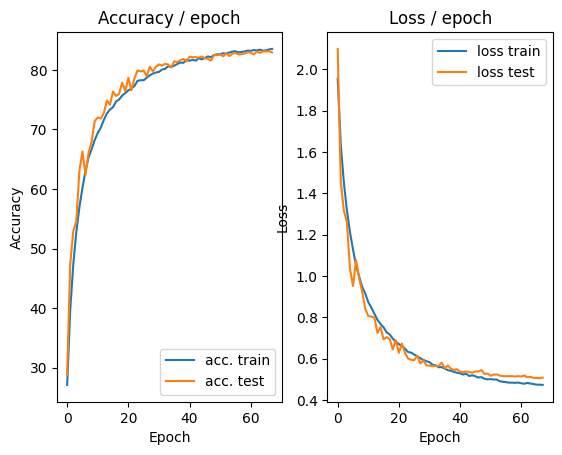

=== EPOCH 69 =====

Current learning rate: 0.003056
[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.5388 (0.5388)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.028s (0.031s)	Loss 0.4259 (0.4670)	Prec@1  83.6 ( 83.9)	Prec@5  99.2 ( 99.3)

===============> Total time 11s	Avg loss 0.4688	Avg Prec@1 83.79 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.3679 (0.3679)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5080	Avg Prec@1 82.92 %	Avg Prec@5 99.24 %



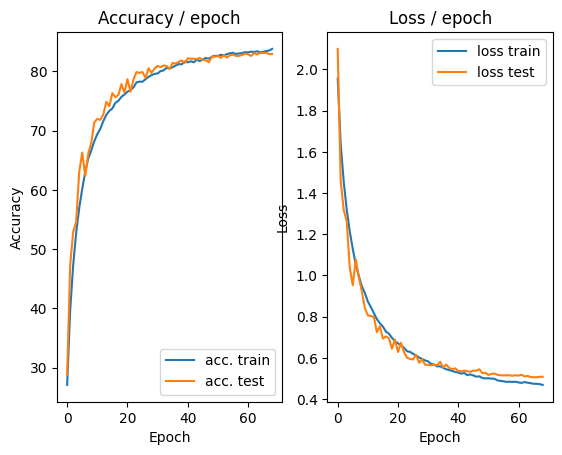

=== EPOCH 70 =====

Current learning rate: 0.002904
[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.4349 (0.4349)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.078s (0.031s)	Loss 0.4685 (0.4695)	Prec@1  83.6 ( 83.5)	Prec@5 100.0 ( 99.2)

===============> Total time 11s	Avg loss 0.4696	Avg Prec@1 83.60 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.3638 (0.3638)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5074	Avg Prec@1 83.03 %	Avg Prec@5 99.13 %



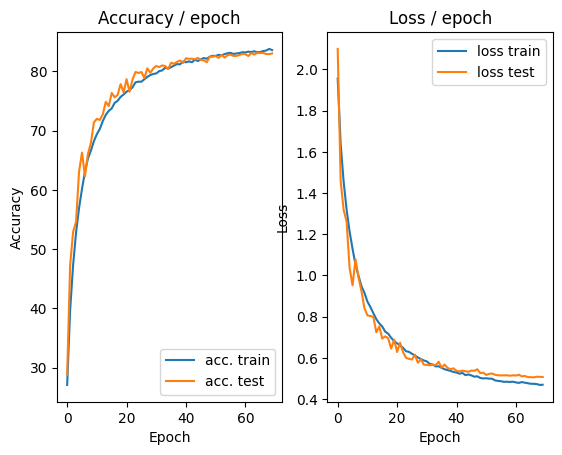

In [16]:
main(128, 0.1, 70, cuda=True)

# 3.5 Use of batch normalization

In [17]:
class ConvNet(nn.Module):
    """
    Cette classe définit la structure du réseau neuronal convolutif.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
            # Définition des couches convolutives et de pooling pour extraire les caractéristiques
        self.features = nn.Sequential(
            # First convolutional block
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            
            # Second convolutional block
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            
            # Third convolutional block
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True)
        )
        # Couches fully connected pour la classification
        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, 1000),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(1000, 10)
            # Remarque : Pas besoin d'ajouter la couche softmax ici, car elle est incluse dans la fonction de perte
        )



    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le jeu de données CIFAR-10 et applique les transformations nécessaires,
    y compris la normalisation.
    """
    # Valeurs de normalisation pour CIFAR-10
    mean = [0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]

    # Transformations à appliquer sur les images
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),  # Flips aléatoires pour augmenter les données
        transforms.RandomCrop(28, padding=4),  # Découpage aléatoire
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)  # Normalisation
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Chargement des jeux de données d'entraînement et de validation
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True, transform=val_transform)

    # Création des DataLoader pour parcourir les jeux de données par batch
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                                               pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False,
                                             pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Effectue un passage (epoch) sur les données `data` avec le modèle `model`.
    Évalue la perte avec `criterion`. Si `optimizer` est fourni, fait une étape d'entraînement,
    sinon fait une évaluation.
    """
    model.eval() if optimizer is None else model.train()

    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()

    tic = time.time()
    for i, (input, target) in enumerate(data):
        if cuda:
            input = input.cuda()
            target = target.cuda()

        # Forward pass
        output = model(input)
        loss = criterion(output, target)

        # Backward pass si on est en mode entraînement
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Calcul des métriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # Mise à jour des métriques moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)

        # Affichage des informations
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time,
                   loss=avg_loss, top1=avg_top1_acc, top5=avg_top5_acc))

    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss

import torch.optim.lr_scheduler

def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        print(f"Current learning rate: {optimizer.param_groups[0]['lr']:.6f}")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # Update the learning rate
        lr_scheduler.step()
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

Current learning rate: 0.100000
[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 2.3253 (2.3253)	Prec@1  14.8 ( 14.8)	Prec@5  54.7 ( 54.7)
[TRAIN Batch 200/391]	Time 0.050s (0.031s)	Loss 1.8826 (1.8184)	Prec@1  35.2 ( 31.6)	Prec@5  82.8 ( 84.8)

===============> Total time 11s	Avg loss 1.6944	Avg Prec@1 36.89 %	Avg Prec@5 87.93 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 1.4962 (1.4962)	Prec@1  43.8 ( 43.8)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5345	Avg Prec@1 44.78 %	Avg Prec@5 91.62 %



<Figure size 640x480 with 0 Axes>

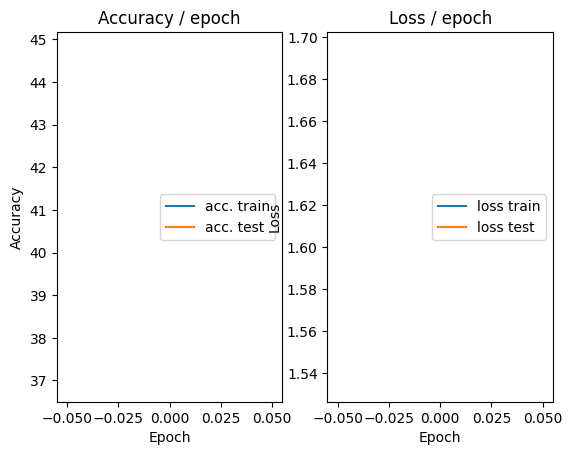

=== EPOCH 2 =====

Current learning rate: 0.095000
[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 1.6320 (1.6320)	Prec@1  40.6 ( 40.6)	Prec@5  93.0 ( 93.0)
[TRAIN Batch 200/391]	Time 0.044s (0.028s)	Loss 1.4053 (1.4063)	Prec@1  47.7 ( 48.5)	Prec@5  92.2 ( 92.9)

===============> Total time 10s	Avg loss 1.3566	Avg Prec@1 50.71 %	Avg Prec@5 93.50 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 1.2478 (1.2478)	Prec@1  52.3 ( 52.3)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.2755	Avg Prec@1 53.87 %	Avg Prec@5 94.22 %



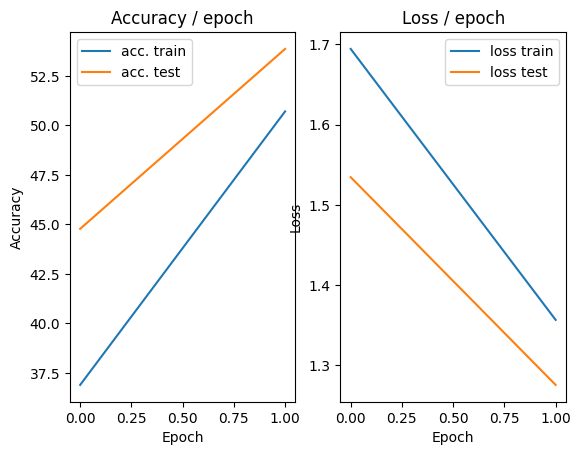

=== EPOCH 3 =====

Current learning rate: 0.090250
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 1.4191 (1.4191)	Prec@1  49.2 ( 49.2)	Prec@5  92.2 ( 92.2)
[TRAIN Batch 200/391]	Time 0.010s (0.027s)	Loss 1.3543 (1.2195)	Prec@1  55.5 ( 56.0)	Prec@5  92.2 ( 95.1)

===============> Total time 10s	Avg loss 1.1953	Avg Prec@1 56.96 %	Avg Prec@5 95.33 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 1.1794 (1.1794)	Prec@1  60.9 ( 60.9)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1924	Avg Prec@1 57.42 %	Avg Prec@5 95.31 %



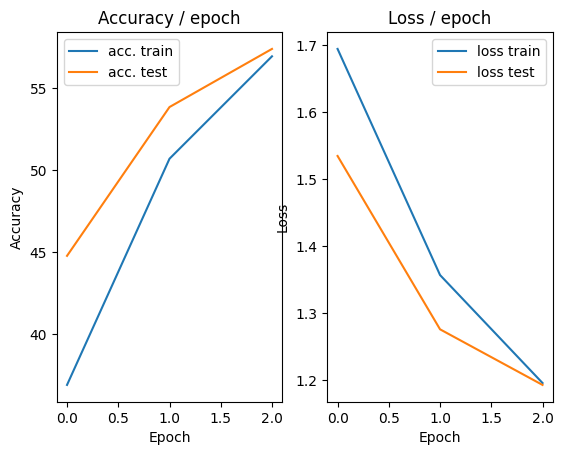

=== EPOCH 4 =====

Current learning rate: 0.085737
[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 1.3116 (1.3116)	Prec@1  50.8 ( 50.8)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.009s (0.027s)	Loss 0.9604 (1.1134)	Prec@1  64.1 ( 60.0)	Prec@5  96.1 ( 96.2)

===============> Total time 10s	Avg loss 1.0925	Avg Prec@1 60.98 %	Avg Prec@5 96.22 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 1.1792 (1.1792)	Prec@1  58.6 ( 58.6)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2492	Avg Prec@1 57.47 %	Avg Prec@5 96.20 %



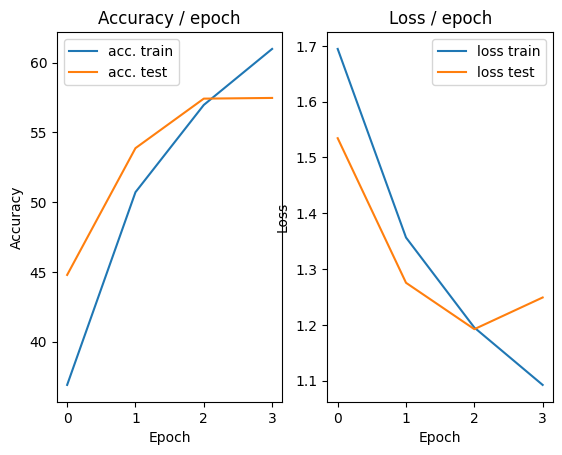

=== EPOCH 5 =====

Current learning rate: 0.081451
[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.2213 (1.2213)	Prec@1  56.2 ( 56.2)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.027s (0.027s)	Loss 1.0223 (1.0265)	Prec@1  63.3 ( 63.2)	Prec@5  97.7 ( 96.6)

===============> Total time 10s	Avg loss 1.0144	Avg Prec@1 63.79 %	Avg Prec@5 96.56 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.8638 (0.8638)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9694	Avg Prec@1 66.44 %	Avg Prec@5 96.64 %



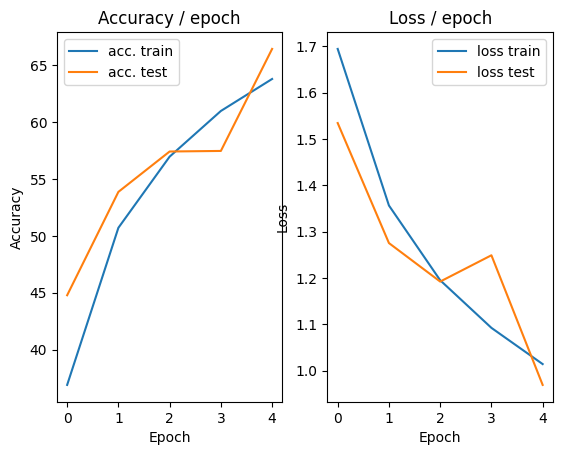

=== EPOCH 6 =====

Current learning rate: 0.077378
[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 0.9292 (0.9292)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.044s (0.027s)	Loss 1.0840 (0.9677)	Prec@1  61.7 ( 66.0)	Prec@5  96.9 ( 96.9)

===============> Total time 10s	Avg loss 0.9561	Avg Prec@1 66.33 %	Avg Prec@5 96.97 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 1.0441 (1.0441)	Prec@1  66.4 ( 66.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1134	Avg Prec@1 63.51 %	Avg Prec@5 95.57 %



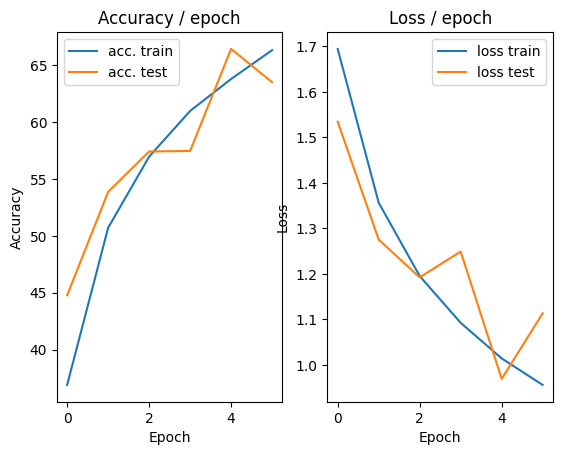

=== EPOCH 7 =====

Current learning rate: 0.073509
[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 1.0518 (1.0518)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.042s (0.027s)	Loss 0.7903 (0.9033)	Prec@1  71.9 ( 68.1)	Prec@5  96.9 ( 97.3)

===============> Total time 10s	Avg loss 0.9032	Avg Prec@1 68.25 %	Avg Prec@5 97.34 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.9257 (0.9257)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9767	Avg Prec@1 67.50 %	Avg Prec@5 96.30 %



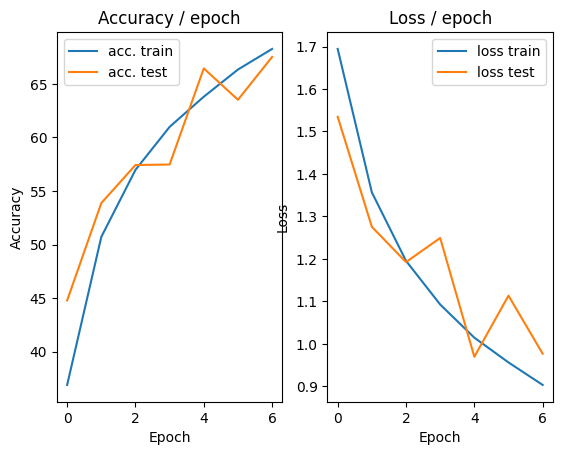

=== EPOCH 8 =====

Current learning rate: 0.069834
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.9989 (0.9989)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.039s (0.027s)	Loss 0.8952 (0.8636)	Prec@1  68.8 ( 69.4)	Prec@5  97.7 ( 97.5)

===============> Total time 10s	Avg loss 0.8637	Avg Prec@1 69.67 %	Avg Prec@5 97.54 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.9314 (0.9314)	Prec@1  71.1 ( 71.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.9213	Avg Prec@1 68.11 %	Avg Prec@5 97.49 %



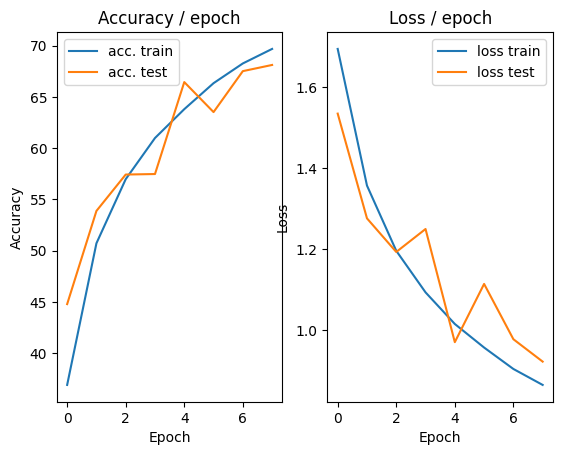

=== EPOCH 9 =====

Current learning rate: 0.066342
[TRAIN Batch 000/391]	Time 0.356s (0.356s)	Loss 0.8577 (0.8577)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.015s (0.029s)	Loss 0.7531 (0.8361)	Prec@1  77.3 ( 70.7)	Prec@5  97.7 ( 97.7)

===============> Total time 10s	Avg loss 0.8293	Avg Prec@1 70.92 %	Avg Prec@5 97.82 %

[EVAL Batch 000/079]	Time 0.306s (0.306s)	Loss 0.7333 (0.7333)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7744	Avg Prec@1 72.94 %	Avg Prec@5 98.07 %



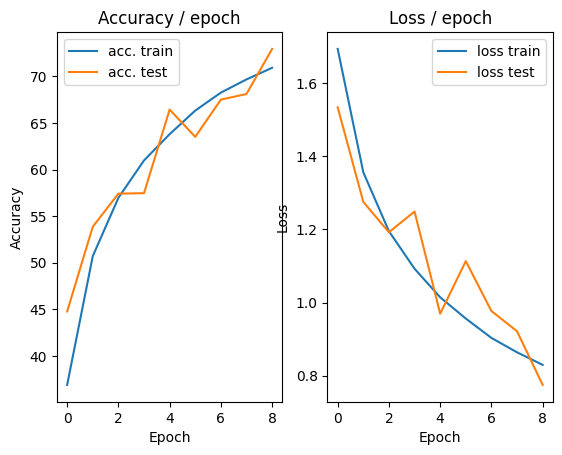

=== EPOCH 10 =====

Current learning rate: 0.063025
[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.7383 (0.7383)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.039s (0.027s)	Loss 0.9346 (0.8077)	Prec@1  62.5 ( 71.6)	Prec@5  96.9 ( 97.9)

===============> Total time 10s	Avg loss 0.8034	Avg Prec@1 71.71 %	Avg Prec@5 98.00 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.7551 (0.7551)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7672	Avg Prec@1 73.01 %	Avg Prec@5 98.20 %



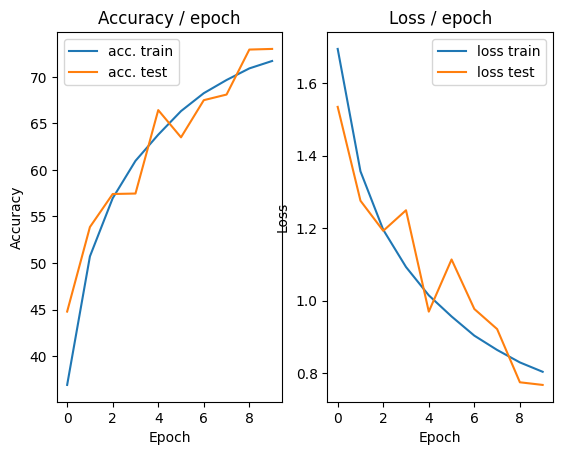

=== EPOCH 11 =====

Current learning rate: 0.059874
[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 0.7894 (0.7894)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.036s (0.027s)	Loss 0.6671 (0.7785)	Prec@1  78.1 ( 72.5)	Prec@5  96.9 ( 98.0)

===============> Total time 10s	Avg loss 0.7715	Avg Prec@1 72.98 %	Avg Prec@5 98.02 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.6678 (0.6678)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7382	Avg Prec@1 74.54 %	Avg Prec@5 98.36 %



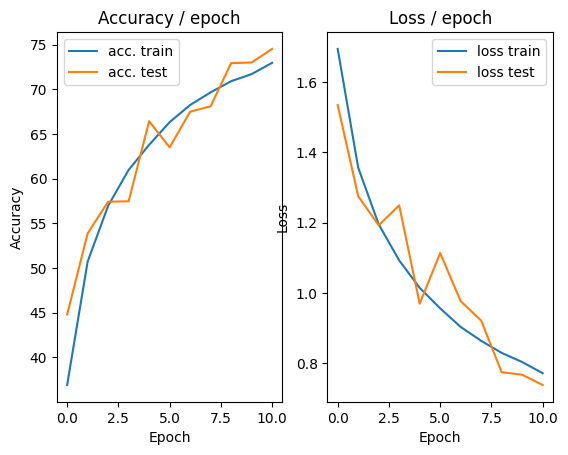

=== EPOCH 12 =====

Current learning rate: 0.056880
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.8419 (0.8419)	Prec@1  75.0 ( 75.0)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.012s (0.028s)	Loss 0.7846 (0.7664)	Prec@1  71.1 ( 73.3)	Prec@5  97.7 ( 98.0)

===============> Total time 10s	Avg loss 0.7515	Avg Prec@1 73.76 %	Avg Prec@5 98.11 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.6212 (0.6212)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7283	Avg Prec@1 74.56 %	Avg Prec@5 98.30 %



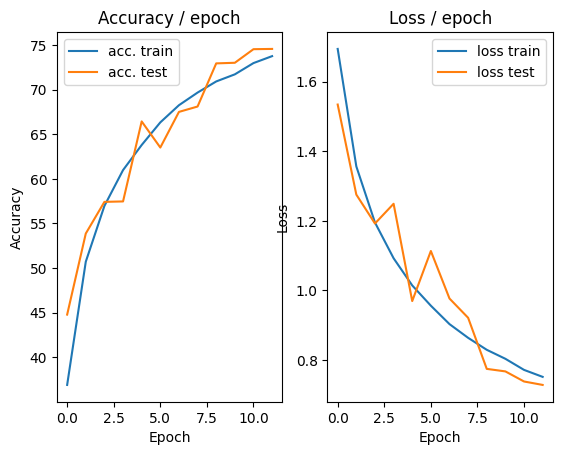

=== EPOCH 13 =====

Current learning rate: 0.054036
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.8521 (0.8521)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.043s (0.027s)	Loss 0.6135 (0.7289)	Prec@1  76.6 ( 74.5)	Prec@5  99.2 ( 98.2)

===============> Total time 10s	Avg loss 0.7334	Avg Prec@1 74.28 %	Avg Prec@5 98.20 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.6981 (0.6981)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.7114	Avg Prec@1 75.42 %	Avg Prec@5 98.50 %



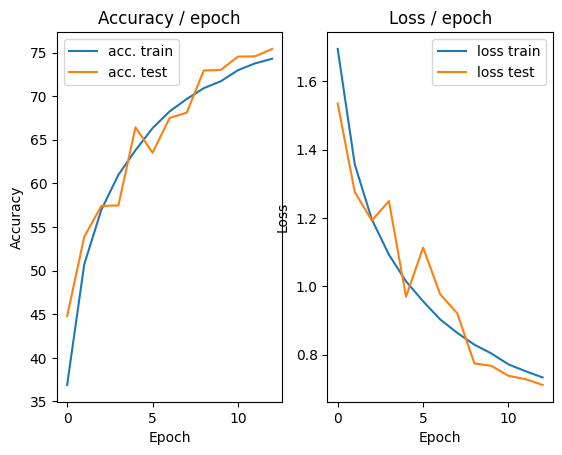

=== EPOCH 14 =====

Current learning rate: 0.051334
[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 0.6942 (0.6942)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.040s (0.027s)	Loss 0.9386 (0.7217)	Prec@1  68.0 ( 74.8)	Prec@5  98.4 ( 98.3)

===============> Total time 10s	Avg loss 0.7115	Avg Prec@1 75.22 %	Avg Prec@5 98.36 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.7477 (0.7477)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7659	Avg Prec@1 73.77 %	Avg Prec@5 98.50 %



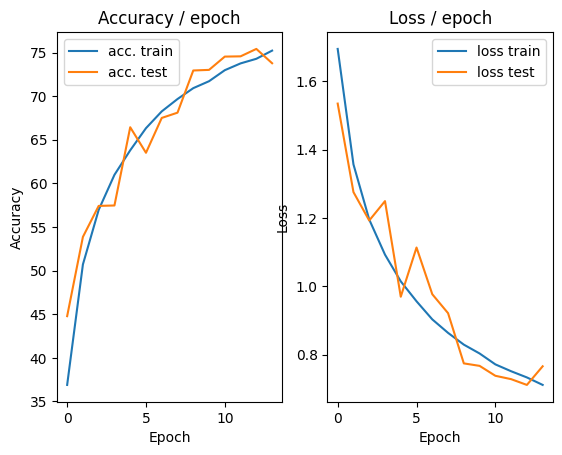

=== EPOCH 15 =====

Current learning rate: 0.048767
[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.7478 (0.7478)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.014s (0.027s)	Loss 0.8058 (0.7008)	Prec@1  72.7 ( 75.4)	Prec@5  97.7 ( 98.5)

===============> Total time 10s	Avg loss 0.6956	Avg Prec@1 75.57 %	Avg Prec@5 98.50 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.5861 (0.5861)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6591	Avg Prec@1 77.64 %	Avg Prec@5 98.62 %



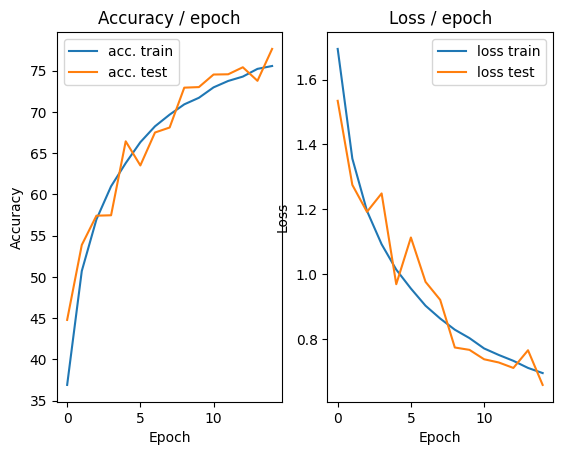

=== EPOCH 16 =====

Current learning rate: 0.046329
[TRAIN Batch 000/391]	Time 0.115s (0.115s)	Loss 0.6862 (0.6862)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.005s (0.026s)	Loss 0.8054 (0.6839)	Prec@1  77.3 ( 76.2)	Prec@5  99.2 ( 98.5)

===============> Total time 10s	Avg loss 0.6802	Avg Prec@1 76.30 %	Avg Prec@5 98.53 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.7096 (0.7096)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6633	Avg Prec@1 77.25 %	Avg Prec@5 98.81 %



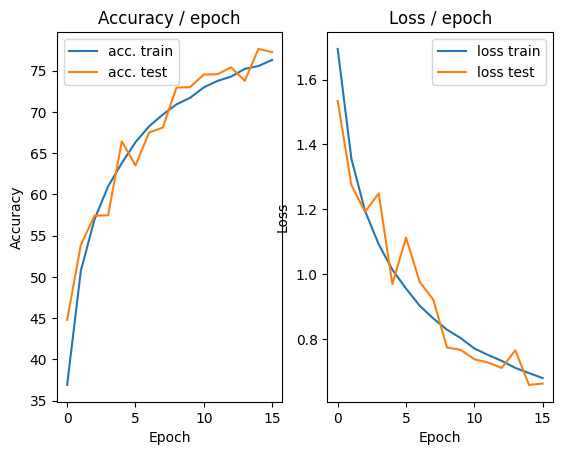

=== EPOCH 17 =====

Current learning rate: 0.044013
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.5809 (0.5809)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.026s)	Loss 0.7857 (0.6723)	Prec@1  69.5 ( 76.5)	Prec@5  97.7 ( 98.6)

===============> Total time 10s	Avg loss 0.6656	Avg Prec@1 76.67 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.6398 (0.6398)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6812	Avg Prec@1 76.22 %	Avg Prec@5 98.31 %



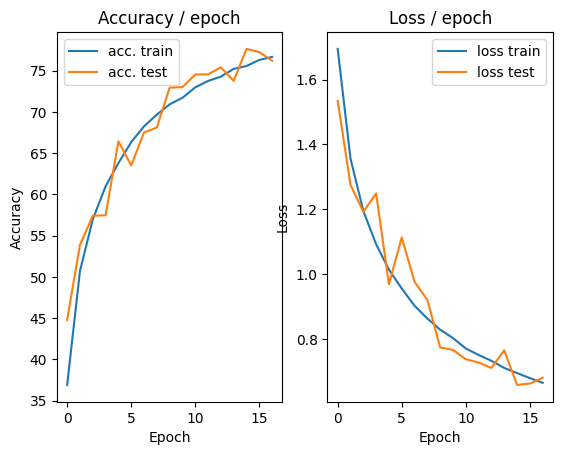

=== EPOCH 18 =====

Current learning rate: 0.041812
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.5798 (0.5798)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.039s (0.027s)	Loss 0.6442 (0.6459)	Prec@1  77.3 ( 77.5)	Prec@5 100.0 ( 98.7)

===============> Total time 10s	Avg loss 0.6498	Avg Prec@1 77.36 %	Avg Prec@5 98.70 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.6180 (0.6180)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6594	Avg Prec@1 76.95 %	Avg Prec@5 98.95 %



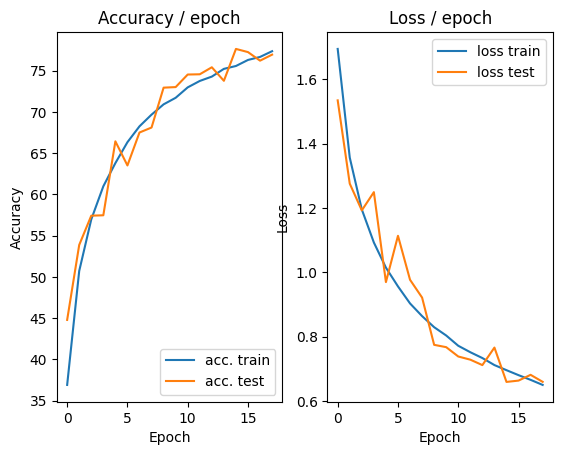

=== EPOCH 19 =====

Current learning rate: 0.039721
[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.6122 (0.6122)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.044s (0.027s)	Loss 0.5205 (0.6475)	Prec@1  82.8 ( 77.5)	Prec@5  98.4 ( 98.7)

===============> Total time 10s	Avg loss 0.6420	Avg Prec@1 77.65 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.076s (0.076s)	Loss 0.5819 (0.5819)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.6251	Avg Prec@1 78.26 %	Avg Prec@5 98.81 %



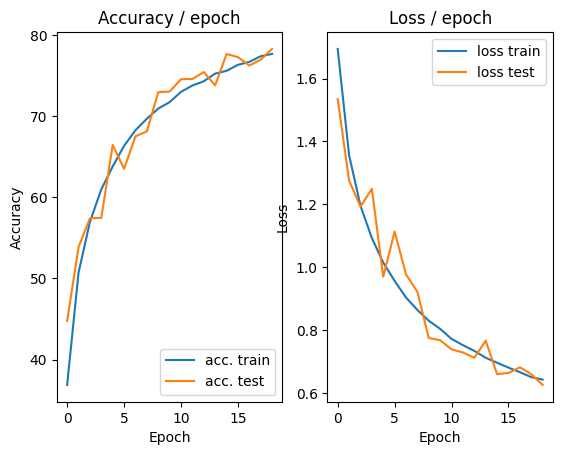

=== EPOCH 20 =====

Current learning rate: 0.037735
[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.6933 (0.6933)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.008s (0.027s)	Loss 0.6318 (0.6267)	Prec@1  77.3 ( 78.1)	Prec@5  97.7 ( 98.7)

===============> Total time 10s	Avg loss 0.6249	Avg Prec@1 78.15 %	Avg Prec@5 98.74 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.5546 (0.5546)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6243	Avg Prec@1 78.41 %	Avg Prec@5 98.84 %



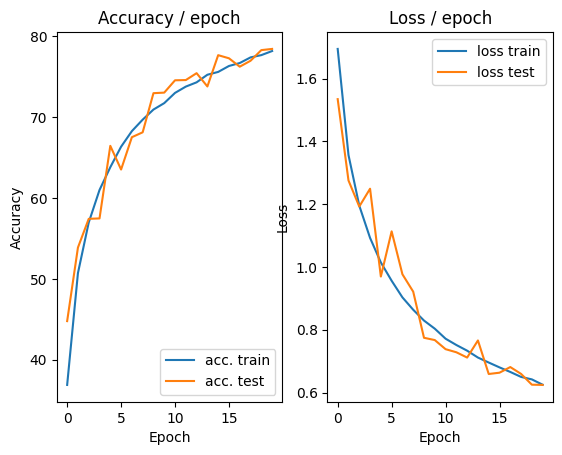

=== EPOCH 21 =====

Current learning rate: 0.035849
[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.7504 (0.7504)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.039s (0.027s)	Loss 0.6491 (0.6179)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.6185	Avg Prec@1 78.22 %	Avg Prec@5 98.81 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.5819 (0.5819)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6327	Avg Prec@1 78.31 %	Avg Prec@5 98.83 %



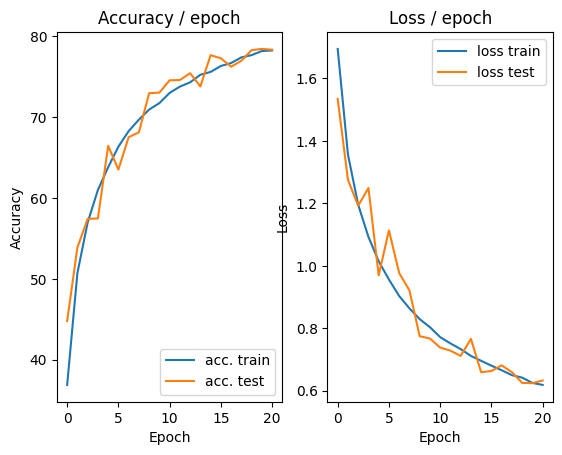

=== EPOCH 22 =====

Current learning rate: 0.034056
[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.6080 (0.6080)	Prec@1  79.7 ( 79.7)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.043s (0.029s)	Loss 0.5020 (0.5963)	Prec@1  81.2 ( 78.9)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.6058	Avg Prec@1 78.73 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.5581 (0.5581)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6145	Avg Prec@1 78.96 %	Avg Prec@5 98.80 %



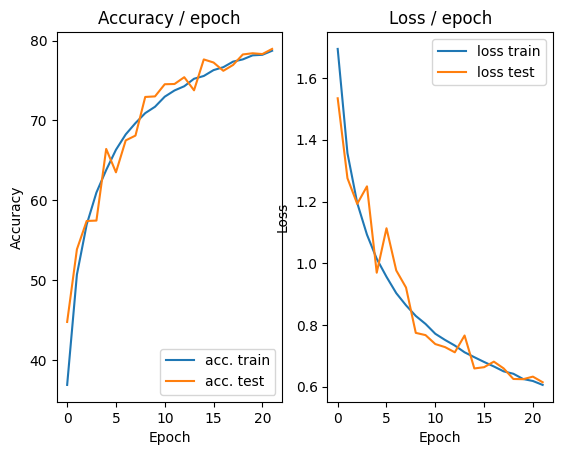

=== EPOCH 23 =====

Current learning rate: 0.032353
[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.5967 (0.5967)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.010s (0.027s)	Loss 0.5856 (0.6011)	Prec@1  83.6 ( 79.1)	Prec@5  99.2 ( 98.9)

===============> Total time 10s	Avg loss 0.5989	Avg Prec@1 79.10 %	Avg Prec@5 98.88 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.5238 (0.5238)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5776	Avg Prec@1 80.13 %	Avg Prec@5 98.95 %



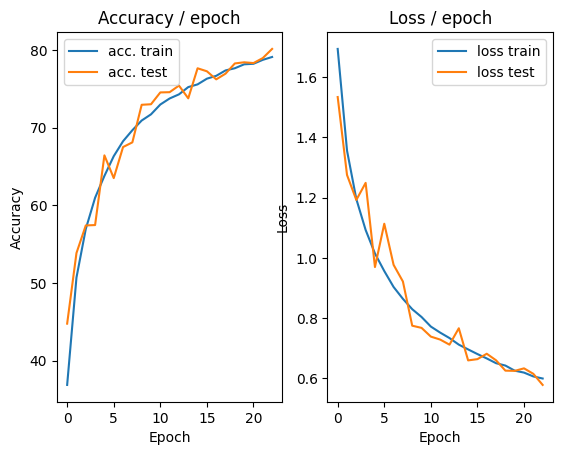

=== EPOCH 24 =====

Current learning rate: 0.030736
[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.6054 (0.6054)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.028s)	Loss 0.7446 (0.5949)	Prec@1  76.6 ( 79.3)	Prec@5  97.7 ( 98.9)

===============> Total time 10s	Avg loss 0.5924	Avg Prec@1 79.34 %	Avg Prec@5 98.87 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.5618 (0.5618)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5956	Avg Prec@1 79.46 %	Avg Prec@5 98.82 %



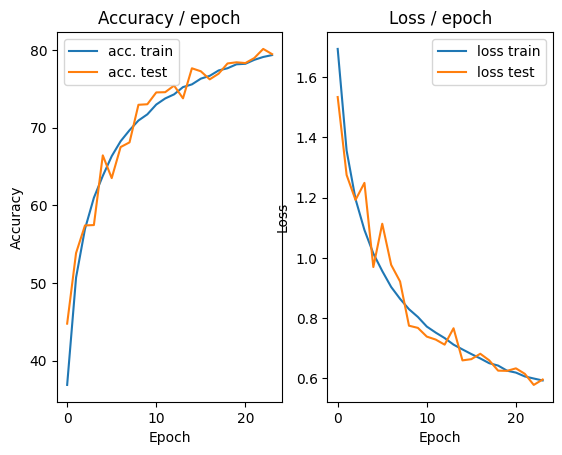

=== EPOCH 25 =====

Current learning rate: 0.029199
[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.6764 (0.6764)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.044s (0.027s)	Loss 0.5364 (0.5817)	Prec@1  82.0 ( 79.8)	Prec@5 100.0 ( 98.9)

===============> Total time 10s	Avg loss 0.5833	Avg Prec@1 79.75 %	Avg Prec@5 98.91 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.5030 (0.5030)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5551	Avg Prec@1 80.62 %	Avg Prec@5 99.05 %



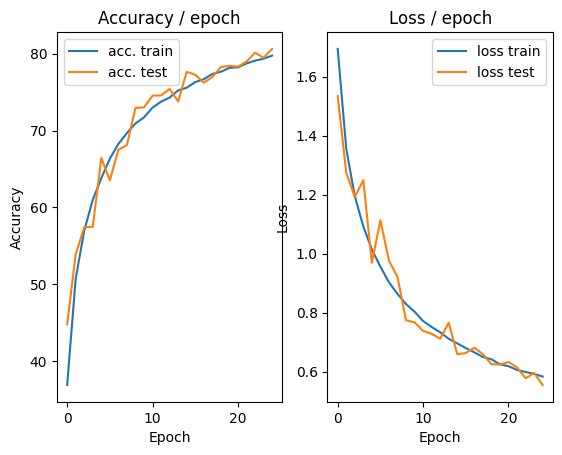

=== EPOCH 26 =====

Current learning rate: 0.027739
[TRAIN Batch 000/391]	Time 0.119s (0.119s)	Loss 0.6710 (0.6710)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.039s (0.027s)	Loss 0.4446 (0.5683)	Prec@1  84.4 ( 80.2)	Prec@5  98.4 ( 99.0)

===============> Total time 10s	Avg loss 0.5712	Avg Prec@1 80.06 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.4851 (0.4851)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5630	Avg Prec@1 80.78 %	Avg Prec@5 98.88 %



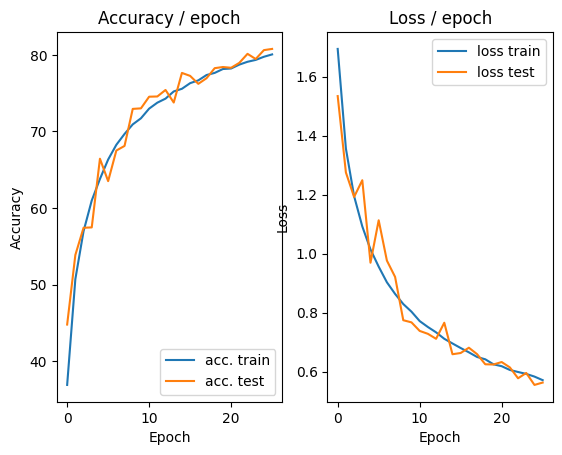

=== EPOCH 27 =====

Current learning rate: 0.026352
[TRAIN Batch 000/391]	Time 0.115s (0.115s)	Loss 0.6418 (0.6418)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.048s (0.027s)	Loss 0.5874 (0.5741)	Prec@1  75.8 ( 80.0)	Prec@5 100.0 ( 98.9)

===============> Total time 10s	Avg loss 0.5727	Avg Prec@1 80.09 %	Avg Prec@5 98.91 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.5255 (0.5255)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5826	Avg Prec@1 80.30 %	Avg Prec@5 98.90 %



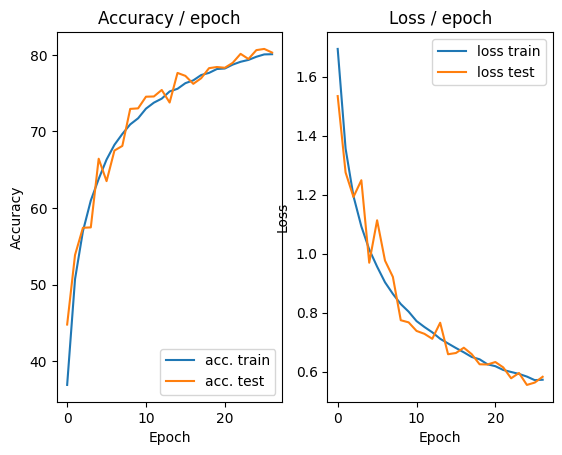

=== EPOCH 28 =====

Current learning rate: 0.025034
[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.5094 (0.5094)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.015s (0.026s)	Loss 0.5226 (0.5582)	Prec@1  82.8 ( 80.5)	Prec@5  99.2 ( 99.0)

===============> Total time 10s	Avg loss 0.5614	Avg Prec@1 80.38 %	Avg Prec@5 98.99 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.4654 (0.4654)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5413	Avg Prec@1 81.23 %	Avg Prec@5 99.03 %



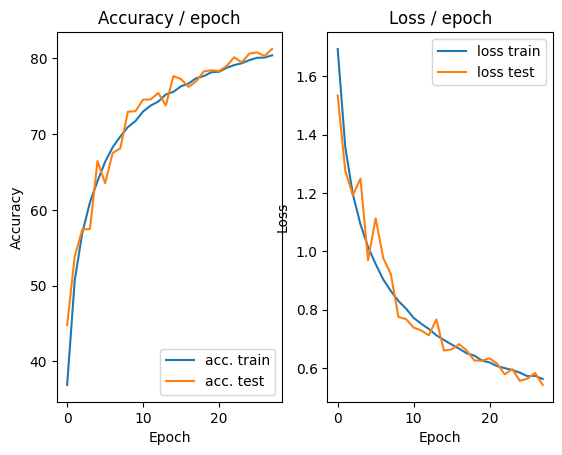

=== EPOCH 29 =====

Current learning rate: 0.023783
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.5699 (0.5699)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.037s (0.026s)	Loss 0.5900 (0.5529)	Prec@1  81.2 ( 80.8)	Prec@5  99.2 ( 99.0)

===============> Total time 10s	Avg loss 0.5569	Avg Prec@1 80.64 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.5074 (0.5074)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5561	Avg Prec@1 80.74 %	Avg Prec@5 99.14 %



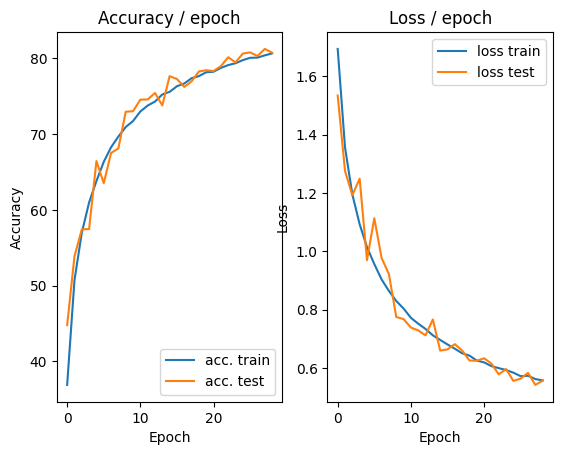

=== EPOCH 30 =====

Current learning rate: 0.022594
[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.5177 (0.5177)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.010s (0.027s)	Loss 0.5739 (0.5427)	Prec@1  80.5 ( 80.8)	Prec@5  99.2 ( 99.0)

===============> Total time 10s	Avg loss 0.5465	Avg Prec@1 80.94 %	Avg Prec@5 99.00 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.4848 (0.4848)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5509	Avg Prec@1 81.09 %	Avg Prec@5 98.99 %



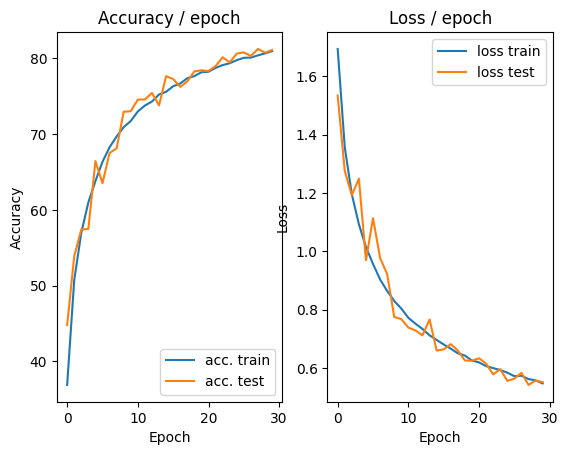

=== EPOCH 31 =====

Current learning rate: 0.021464
[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.4947 (0.4947)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.039s (0.027s)	Loss 0.5667 (0.5418)	Prec@1  78.1 ( 81.0)	Prec@5 100.0 ( 99.1)

===============> Total time 10s	Avg loss 0.5428	Avg Prec@1 81.05 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.5014 (0.5014)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5535	Avg Prec@1 80.71 %	Avg Prec@5 98.98 %



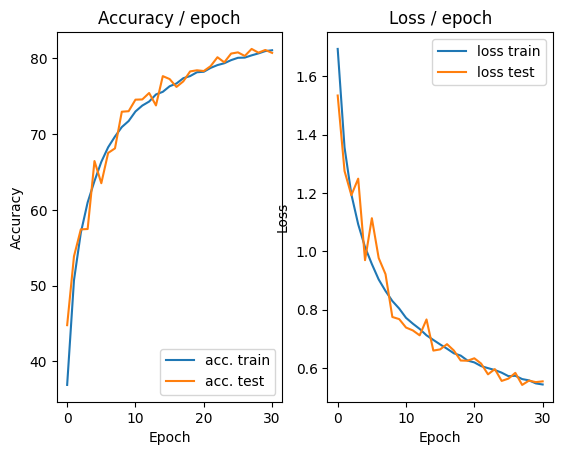

=== EPOCH 32 =====

Current learning rate: 0.020391
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.7109 (0.7109)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.011s (0.026s)	Loss 0.4959 (0.5472)	Prec@1  85.2 ( 80.8)	Prec@5  98.4 ( 99.1)

===============> Total time 10s	Avg loss 0.5404	Avg Prec@1 81.17 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.5023 (0.5023)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5362	Avg Prec@1 81.70 %	Avg Prec@5 99.07 %



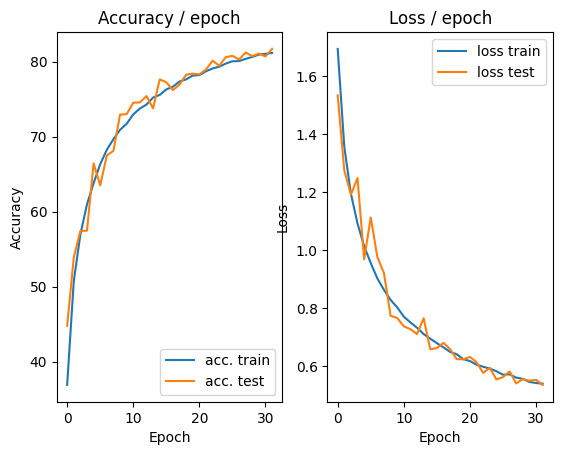

=== EPOCH 33 =====

Current learning rate: 0.019371
[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.6706 (0.6706)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.007s (0.028s)	Loss 0.4347 (0.5378)	Prec@1  85.9 ( 81.3)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5356	Avg Prec@1 81.35 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.4982 (0.4982)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5268	Avg Prec@1 81.84 %	Avg Prec@5 99.05 %



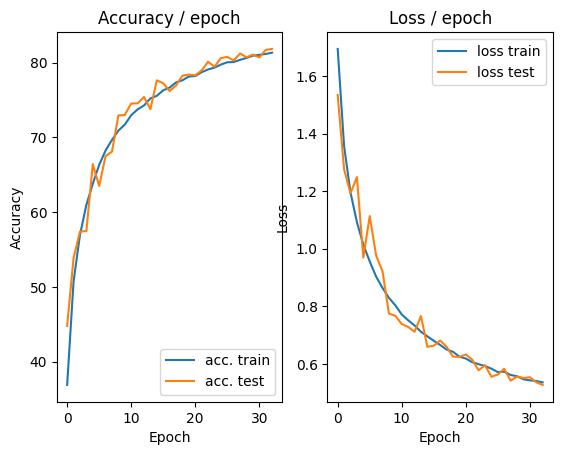

=== EPOCH 34 =====

Current learning rate: 0.018403
[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.5787 (0.5787)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.049s (0.029s)	Loss 0.4071 (0.5280)	Prec@1  85.9 ( 81.6)	Prec@5  99.2 ( 99.1)

===============> Total time 10s	Avg loss 0.5269	Avg Prec@1 81.74 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.4577 (0.4577)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5293	Avg Prec@1 81.83 %	Avg Prec@5 99.12 %



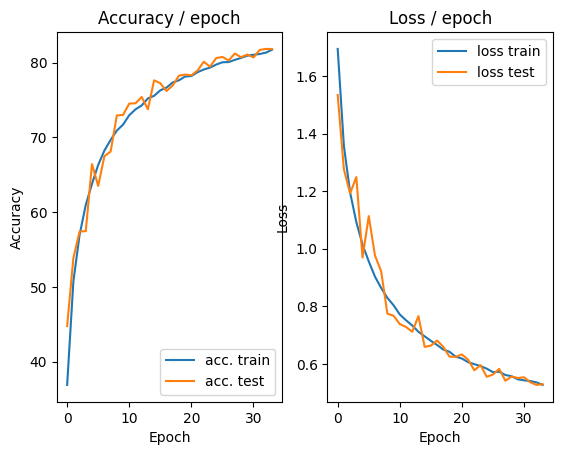

=== EPOCH 35 =====

Current learning rate: 0.017482
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.4990 (0.4990)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.042s (0.027s)	Loss 0.4592 (0.5240)	Prec@1  84.4 ( 81.7)	Prec@5 100.0 ( 99.0)

===============> Total time 10s	Avg loss 0.5230	Avg Prec@1 81.70 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.5066 (0.5066)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5739	Avg Prec@1 80.30 %	Avg Prec@5 98.90 %



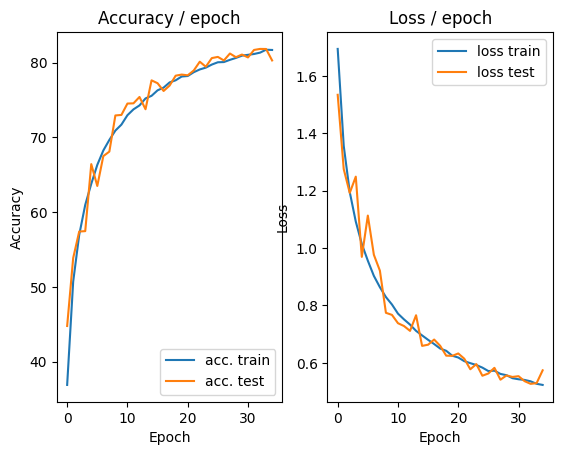

=== EPOCH 36 =====

Current learning rate: 0.016608
[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.5557 (0.5557)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.050s (0.027s)	Loss 0.4739 (0.5063)	Prec@1  85.9 ( 82.4)	Prec@5  99.2 ( 99.2)

===============> Total time 10s	Avg loss 0.5197	Avg Prec@1 81.93 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.4767 (0.4767)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5120	Avg Prec@1 81.87 %	Avg Prec@5 99.12 %



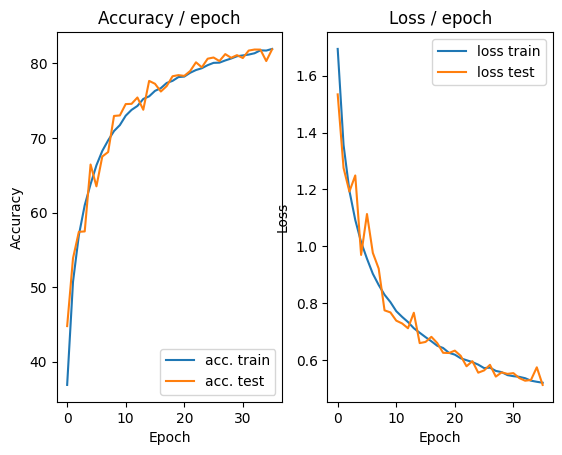

=== EPOCH 37 =====

Current learning rate: 0.015778
[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.4633 (0.4633)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.018s (0.027s)	Loss 0.5022 (0.5100)	Prec@1  83.6 ( 82.3)	Prec@5 100.0 ( 99.2)

===============> Total time 10s	Avg loss 0.5124	Avg Prec@1 82.23 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.4581 (0.4581)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5064	Avg Prec@1 82.60 %	Avg Prec@5 99.17 %



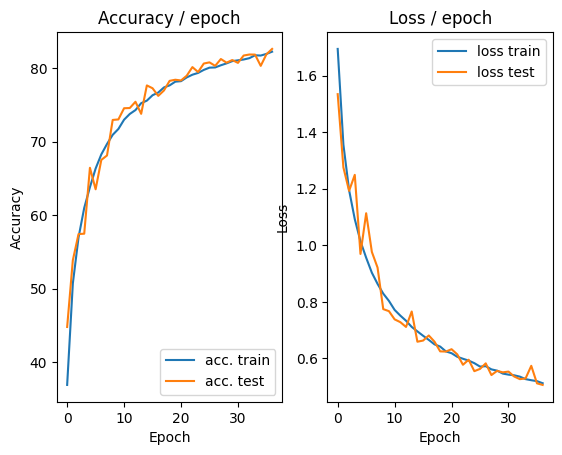

=== EPOCH 38 =====

Current learning rate: 0.014989
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.5830 (0.5830)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.067s (0.027s)	Loss 0.6646 (0.5060)	Prec@1  80.5 ( 82.4)	Prec@5  97.7 ( 99.2)

===============> Total time 10s	Avg loss 0.5077	Avg Prec@1 82.30 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.4695 (0.4695)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5146	Avg Prec@1 82.35 %	Avg Prec@5 99.08 %



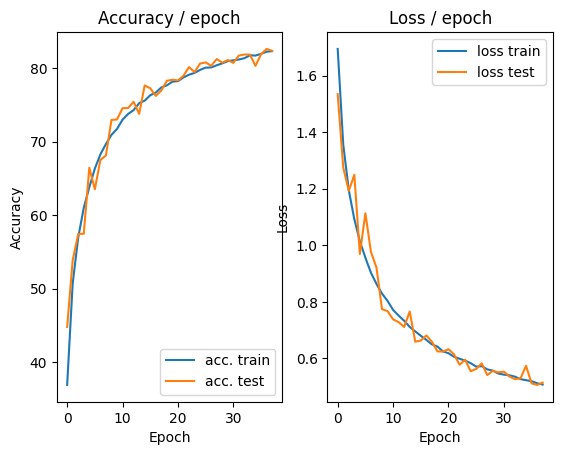

=== EPOCH 39 =====

Current learning rate: 0.014240
[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.5624 (0.5624)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.043s (0.027s)	Loss 0.5543 (0.5091)	Prec@1  77.3 ( 82.0)	Prec@5 100.0 ( 99.2)

===============> Total time 10s	Avg loss 0.5041	Avg Prec@1 82.27 %	Avg Prec@5 99.18 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.4648 (0.4648)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5185	Avg Prec@1 82.14 %	Avg Prec@5 99.12 %



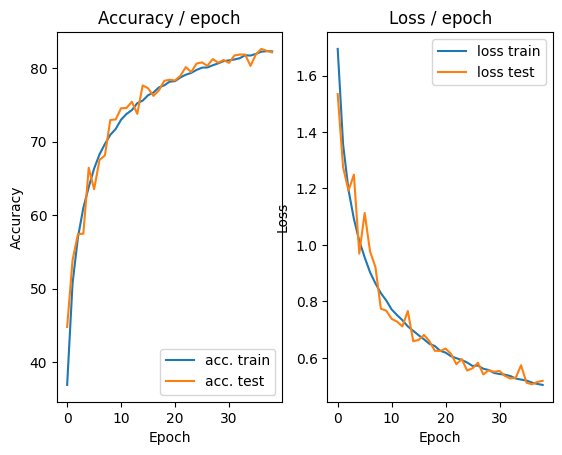

=== EPOCH 40 =====

Current learning rate: 0.013528
[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.3882 (0.3882)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.009s (0.027s)	Loss 0.5178 (0.5017)	Prec@1  82.0 ( 82.5)	Prec@5  97.7 ( 99.2)

===============> Total time 11s	Avg loss 0.5054	Avg Prec@1 82.34 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 0.4701 (0.4701)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5124	Avg Prec@1 82.44 %	Avg Prec@5 99.07 %



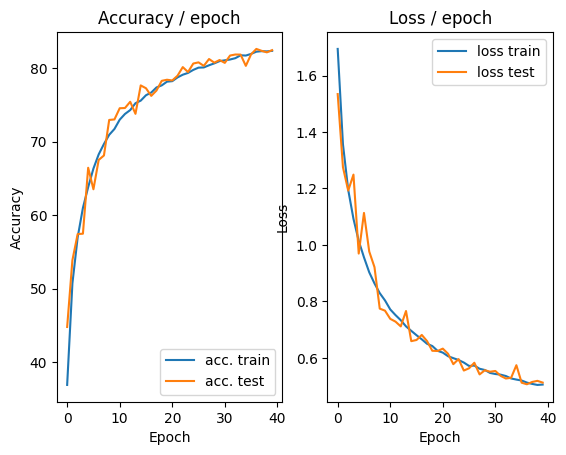

=== EPOCH 41 =====

Current learning rate: 0.012851
[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.4321 (0.4321)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.048s (0.028s)	Loss 0.4432 (0.4966)	Prec@1  88.3 ( 82.7)	Prec@5  98.4 ( 99.2)

===============> Total time 10s	Avg loss 0.4971	Avg Prec@1 82.63 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.5475 (0.5475)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5512	Avg Prec@1 81.17 %	Avg Prec@5 99.01 %



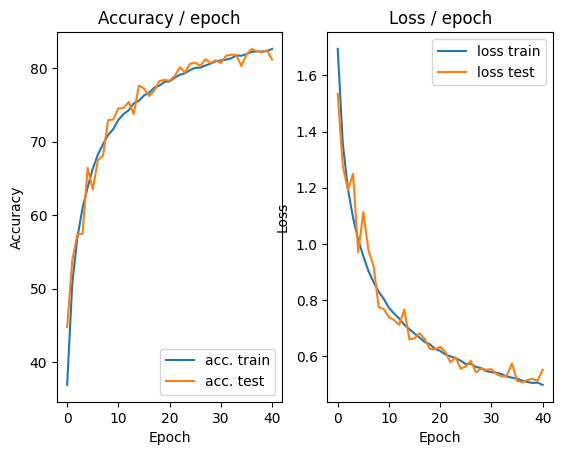

=== EPOCH 42 =====

Current learning rate: 0.012209
[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.5406 (0.5406)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.037s (0.026s)	Loss 0.6411 (0.5020)	Prec@1  77.3 ( 82.5)	Prec@5  98.4 ( 99.2)

===============> Total time 9s	Avg loss 0.4985	Avg Prec@1 82.58 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.4740 (0.4740)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4969	Avg Prec@1 83.09 %	Avg Prec@5 99.16 %



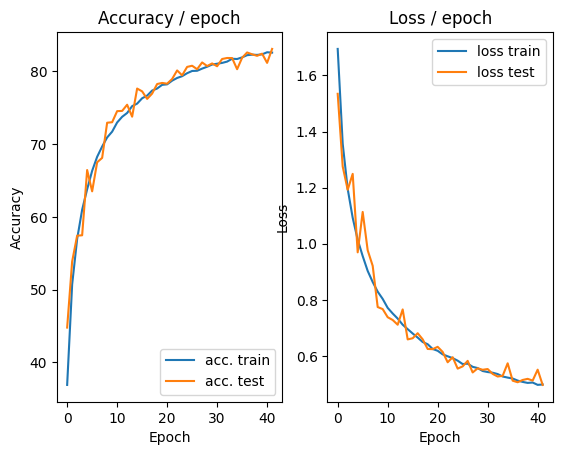

=== EPOCH 43 =====

Current learning rate: 0.011598
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.5167 (0.5167)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.009s (0.026s)	Loss 0.4657 (0.4924)	Prec@1  82.8 ( 82.6)	Prec@5  99.2 ( 99.2)

===============> Total time 9s	Avg loss 0.4930	Avg Prec@1 82.70 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.4711 (0.4711)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5038	Avg Prec@1 82.68 %	Avg Prec@5 99.04 %



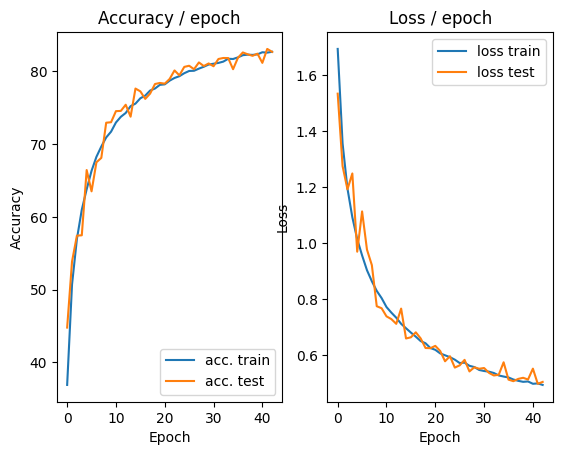

=== EPOCH 44 =====

Current learning rate: 0.011018
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.4451 (0.4451)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.036s (0.025s)	Loss 0.5769 (0.4869)	Prec@1  79.7 ( 82.9)	Prec@5 100.0 ( 99.2)

===============> Total time 9s	Avg loss 0.4892	Avg Prec@1 82.93 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.4457 (0.4457)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4916	Avg Prec@1 83.04 %	Avg Prec@5 99.10 %



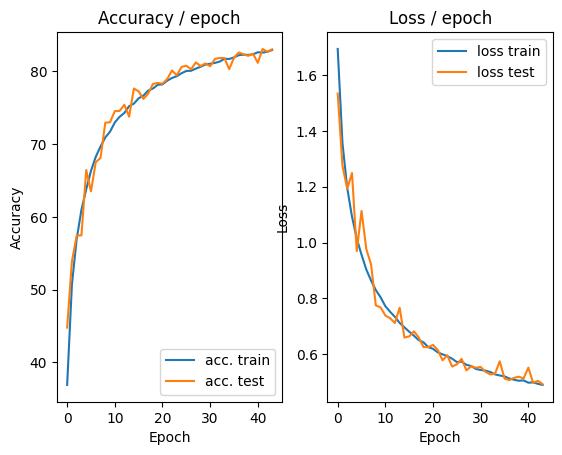

=== EPOCH 45 =====

Current learning rate: 0.010467
[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.4805 (0.4805)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.026s)	Loss 0.3939 (0.4790)	Prec@1  85.2 ( 83.3)	Prec@5 100.0 ( 99.3)

===============> Total time 9s	Avg loss 0.4818	Avg Prec@1 83.20 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 0.4519 (0.4519)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.5014	Avg Prec@1 82.87 %	Avg Prec@5 99.13 %



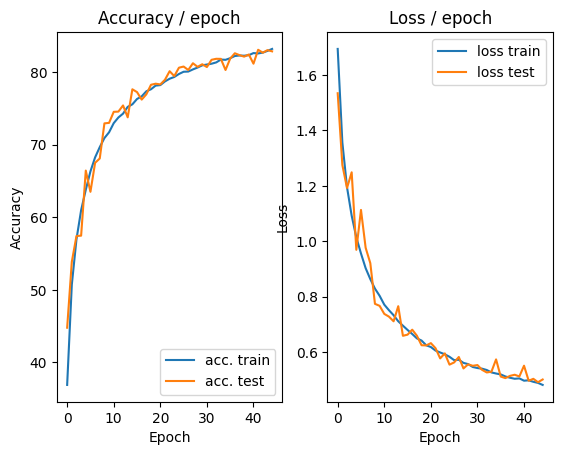

=== EPOCH 46 =====

Current learning rate: 0.009944
[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.5819 (0.5819)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.045s (0.026s)	Loss 0.5969 (0.4845)	Prec@1  80.5 ( 82.9)	Prec@5  99.2 ( 99.3)

===============> Total time 10s	Avg loss 0.4862	Avg Prec@1 82.92 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.4606 (0.4606)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4889	Avg Prec@1 83.32 %	Avg Prec@5 99.24 %



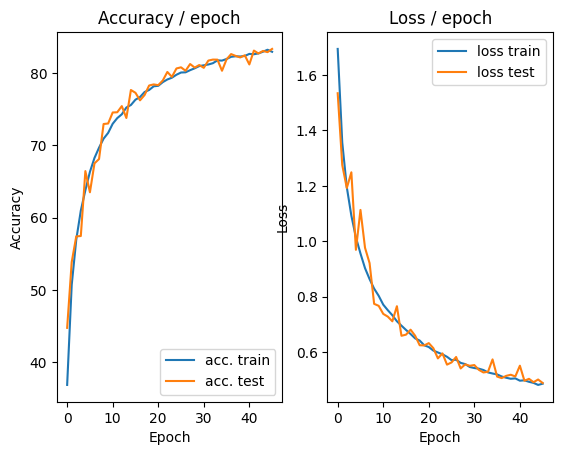

=== EPOCH 47 =====

Current learning rate: 0.009447
[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.5552 (0.5552)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.036s (0.026s)	Loss 0.4520 (0.4843)	Prec@1  82.0 ( 83.0)	Prec@5 100.0 ( 99.3)

===============> Total time 10s	Avg loss 0.4864	Avg Prec@1 83.07 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.4527 (0.4527)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4896	Avg Prec@1 83.20 %	Avg Prec@5 99.19 %



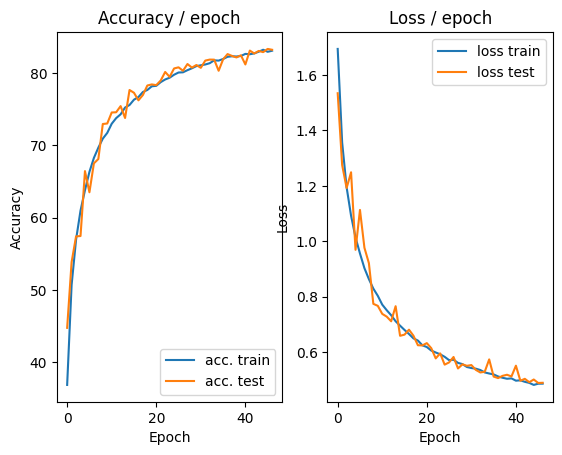

=== EPOCH 48 =====

Current learning rate: 0.008974
[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.3966 (0.3966)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.031s)	Loss 0.4786 (0.4874)	Prec@1  85.2 ( 83.1)	Prec@5  99.2 ( 99.2)

===============> Total time 11s	Avg loss 0.4827	Avg Prec@1 83.14 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.4352 (0.4352)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4937	Avg Prec@1 83.06 %	Avg Prec@5 99.22 %



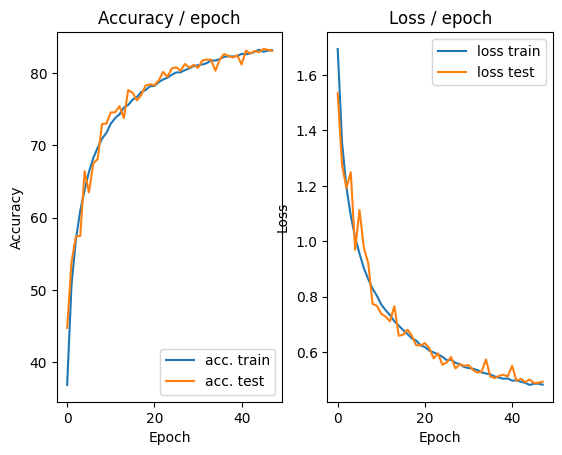

=== EPOCH 49 =====

Current learning rate: 0.008526
[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.4553 (0.4553)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.033s (0.026s)	Loss 0.3417 (0.4735)	Prec@1  86.7 ( 83.4)	Prec@5 100.0 ( 99.3)

===============> Total time 9s	Avg loss 0.4781	Avg Prec@1 83.24 %	Avg Prec@5 99.32 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.4388 (0.4388)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4896	Avg Prec@1 83.19 %	Avg Prec@5 99.20 %



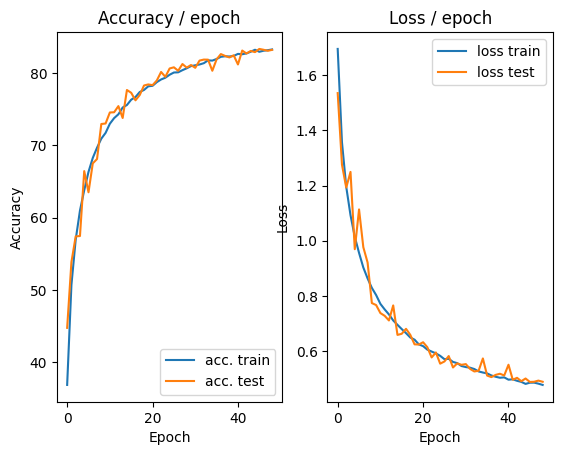

=== EPOCH 50 =====

Current learning rate: 0.008099
[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.4902 (0.4902)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.008s (0.026s)	Loss 0.4695 (0.4798)	Prec@1  82.8 ( 83.0)	Prec@5 100.0 ( 99.3)

===============> Total time 10s	Avg loss 0.4780	Avg Prec@1 83.26 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.4500 (0.4500)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4879	Avg Prec@1 83.38 %	Avg Prec@5 99.16 %



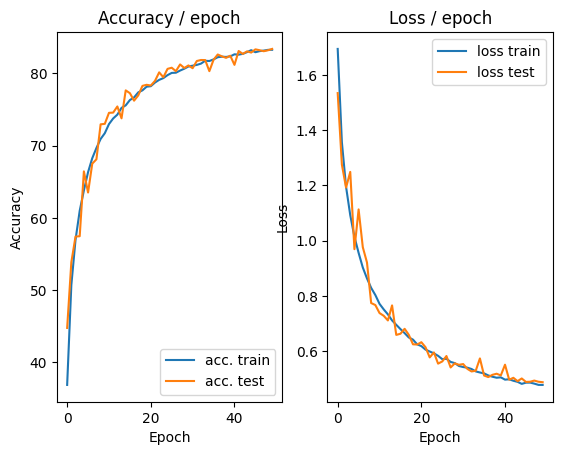

=== EPOCH 51 =====

Current learning rate: 0.007694
[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.4116 (0.4116)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.047s (0.026s)	Loss 0.4097 (0.4713)	Prec@1  86.7 ( 83.6)	Prec@5 100.0 ( 99.3)

===============> Total time 10s	Avg loss 0.4703	Avg Prec@1 83.65 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.4287 (0.4287)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4864	Avg Prec@1 82.95 %	Avg Prec@5 99.18 %



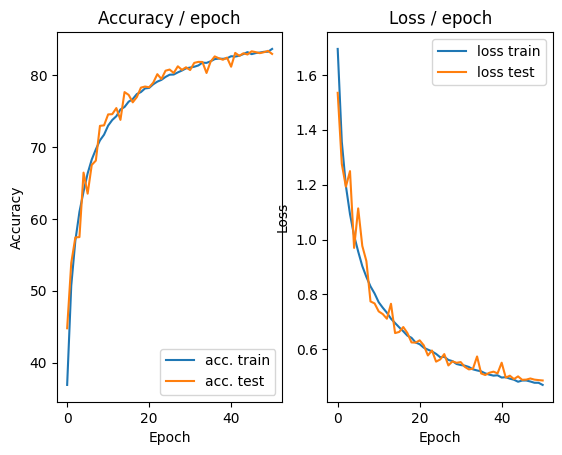

=== EPOCH 52 =====

Current learning rate: 0.007310
[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.4090 (0.4090)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.026s)	Loss 0.4518 (0.4716)	Prec@1  82.0 ( 83.5)	Prec@5  99.2 ( 99.2)

===============> Total time 9s	Avg loss 0.4697	Avg Prec@1 83.49 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.4307 (0.4307)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4827	Avg Prec@1 83.35 %	Avg Prec@5 99.25 %



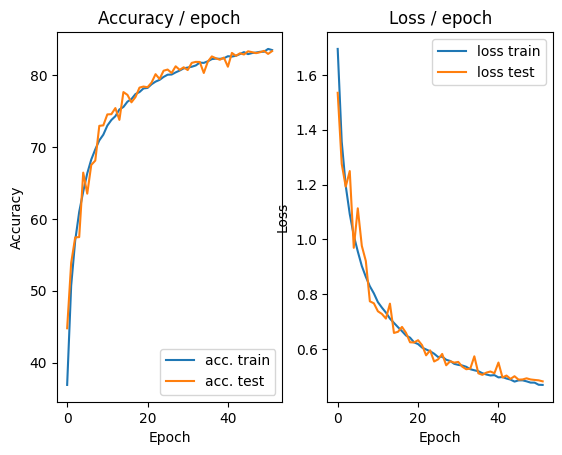

=== EPOCH 53 =====

Current learning rate: 0.006944
[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.4396 (0.4396)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.041s (0.026s)	Loss 0.4044 (0.4623)	Prec@1  83.6 ( 84.0)	Prec@5 100.0 ( 99.4)

===============> Total time 10s	Avg loss 0.4656	Avg Prec@1 83.70 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.4831 (0.4831)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4907	Avg Prec@1 83.20 %	Avg Prec@5 99.22 %



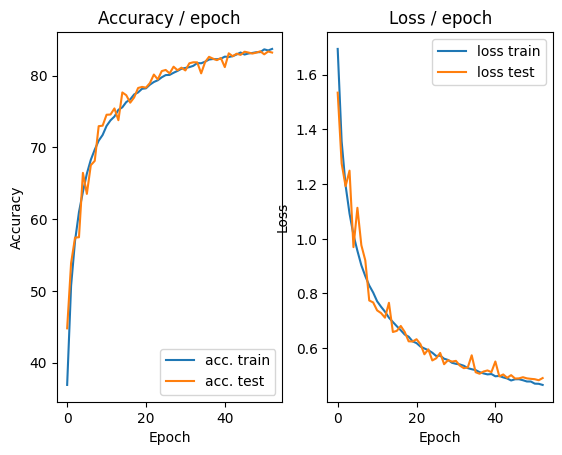

=== EPOCH 54 =====

Current learning rate: 0.006597
[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.4823 (0.4823)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.035s (0.026s)	Loss 0.4899 (0.4655)	Prec@1  82.8 ( 83.6)	Prec@5  98.4 ( 99.4)

===============> Total time 9s	Avg loss 0.4660	Avg Prec@1 83.69 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.074s (0.074s)	Loss 0.4292 (0.4292)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4902	Avg Prec@1 83.19 %	Avg Prec@5 99.16 %



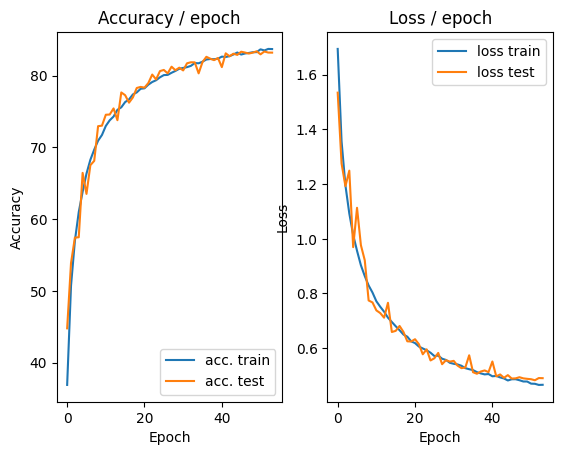

=== EPOCH 55 =====

Current learning rate: 0.006267
[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.3685 (0.3685)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.011s (0.026s)	Loss 0.4829 (0.4612)	Prec@1  83.6 ( 83.8)	Prec@5 100.0 ( 99.4)

===============> Total time 9s	Avg loss 0.4624	Avg Prec@1 83.87 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.4457 (0.4457)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4852	Avg Prec@1 83.46 %	Avg Prec@5 99.19 %



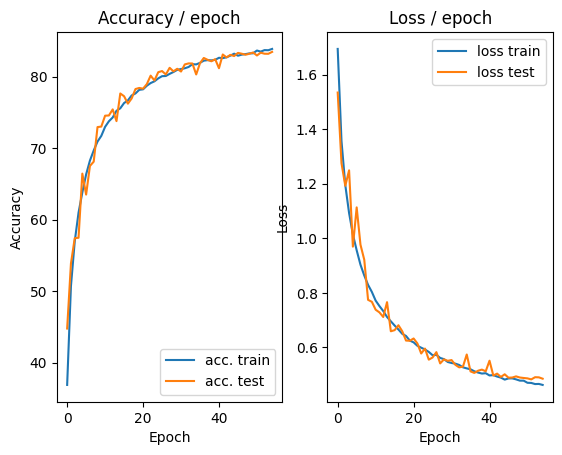

=== EPOCH 56 =====

Current learning rate: 0.005954
[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.4225 (0.4225)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.009s (0.026s)	Loss 0.5476 (0.4582)	Prec@1  79.7 ( 84.1)	Prec@5 100.0 ( 99.4)

===============> Total time 9s	Avg loss 0.4651	Avg Prec@1 83.84 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.4355 (0.4355)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4796	Avg Prec@1 83.64 %	Avg Prec@5 99.17 %



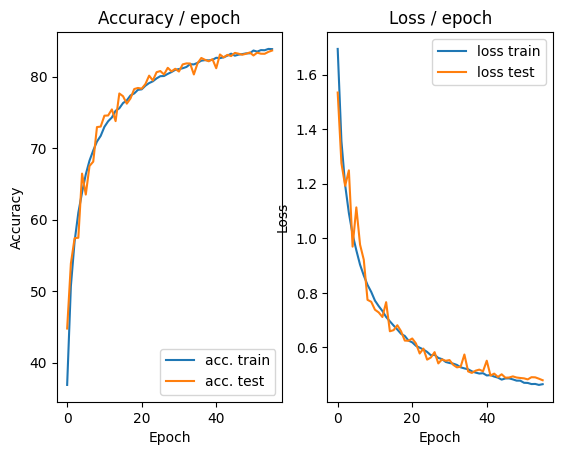

=== EPOCH 57 =====

Current learning rate: 0.005656
[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.4508 (0.4508)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.037s (0.025s)	Loss 0.5253 (0.4636)	Prec@1  79.7 ( 83.6)	Prec@5 100.0 ( 99.3)

===============> Total time 9s	Avg loss 0.4626	Avg Prec@1 83.59 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.4248 (0.4248)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4813	Avg Prec@1 83.42 %	Avg Prec@5 99.25 %



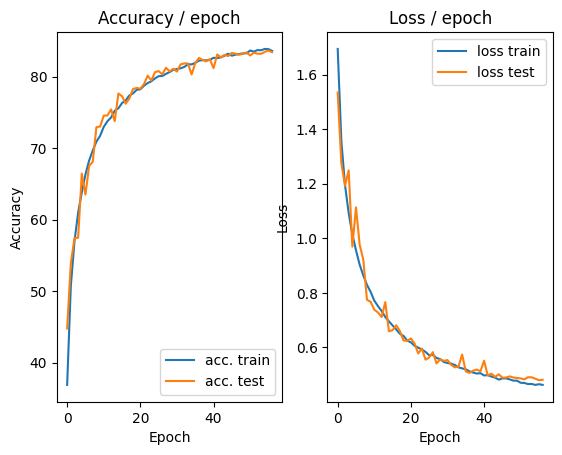

=== EPOCH 58 =====

Current learning rate: 0.005373
[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.6182 (0.6182)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.041s (0.027s)	Loss 0.5436 (0.4657)	Prec@1  81.2 ( 83.9)	Prec@5  97.7 ( 99.4)

===============> Total time 10s	Avg loss 0.4637	Avg Prec@1 83.91 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.4502 (0.4502)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4855	Avg Prec@1 83.30 %	Avg Prec@5 99.19 %



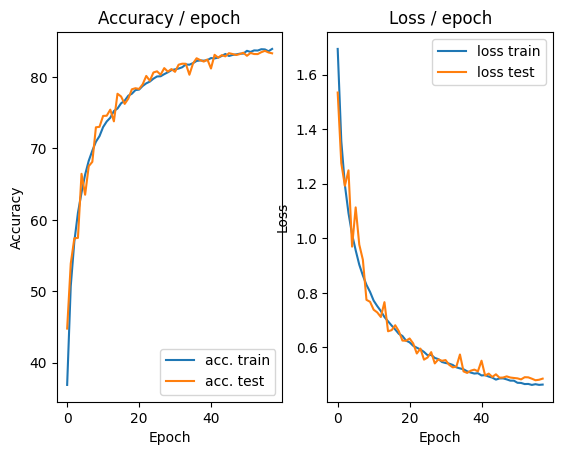

=== EPOCH 59 =====

Current learning rate: 0.005105
[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.4363 (0.4363)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.045s (0.027s)	Loss 0.4772 (0.4612)	Prec@1  82.0 ( 83.7)	Prec@5  98.4 ( 99.3)

===============> Total time 10s	Avg loss 0.4592	Avg Prec@1 83.85 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.4493 (0.4493)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4861	Avg Prec@1 83.24 %	Avg Prec@5 99.15 %



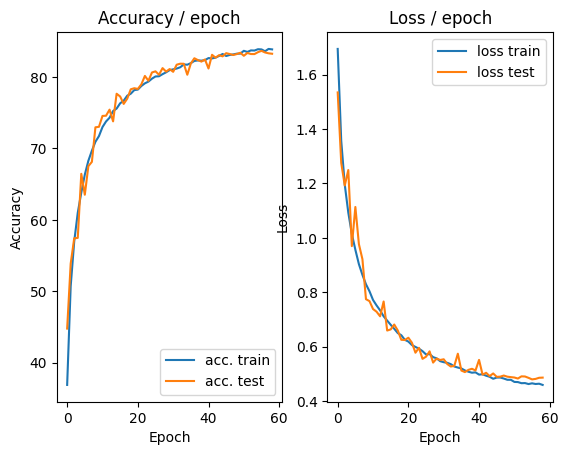

=== EPOCH 60 =====

Current learning rate: 0.004849
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.4354 (0.4354)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.030s (0.026s)	Loss 0.4505 (0.4628)	Prec@1  79.7 ( 83.7)	Prec@5 100.0 ( 99.3)

===============> Total time 9s	Avg loss 0.4607	Avg Prec@1 83.91 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.072s (0.072s)	Loss 0.4190 (0.4190)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4775	Avg Prec@1 83.57 %	Avg Prec@5 99.22 %



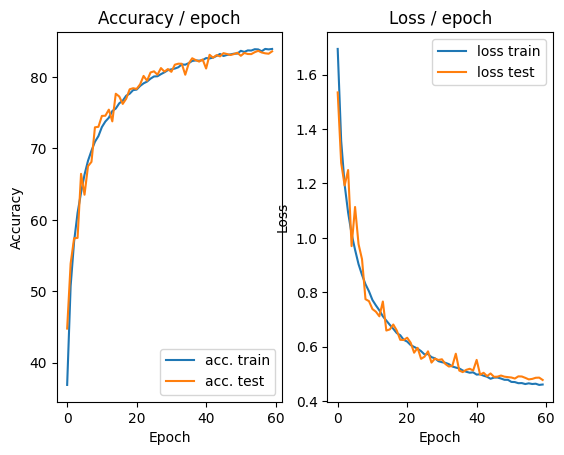

=== EPOCH 61 =====

Current learning rate: 0.004607
[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.5317 (0.5317)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.015s (0.028s)	Loss 0.6126 (0.4568)	Prec@1  74.2 ( 83.8)	Prec@5  99.2 ( 99.4)

===============> Total time 10s	Avg loss 0.4583	Avg Prec@1 83.83 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.4473 (0.4473)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4801	Avg Prec@1 83.57 %	Avg Prec@5 99.28 %



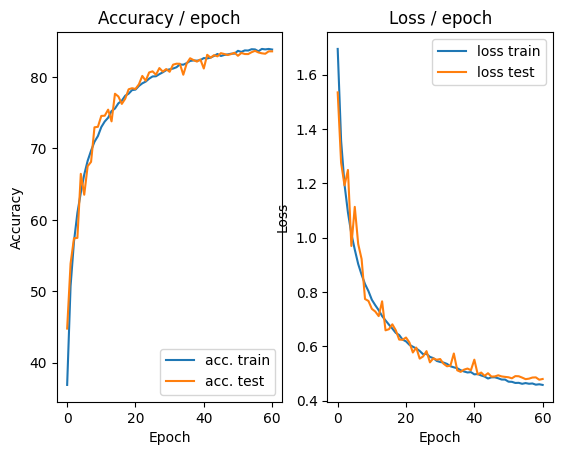

=== EPOCH 62 =====

Current learning rate: 0.004377
[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.4798 (0.4798)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.007s (0.026s)	Loss 0.5659 (0.4462)	Prec@1  82.0 ( 84.6)	Prec@5  98.4 ( 99.3)

===============> Total time 10s	Avg loss 0.4518	Avg Prec@1 84.32 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.4556 (0.4556)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4739	Avg Prec@1 83.82 %	Avg Prec@5 99.15 %



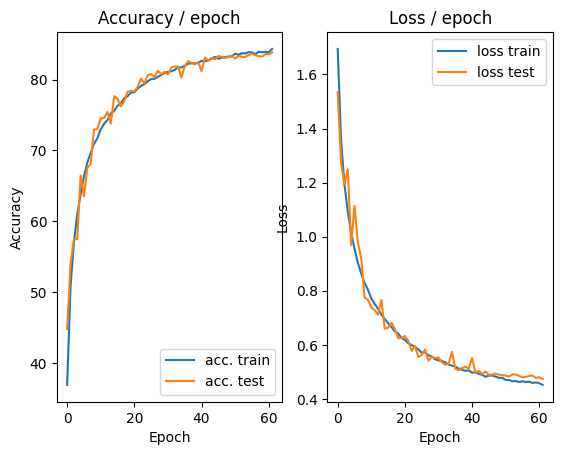

=== EPOCH 63 =====

Current learning rate: 0.004158
[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.5075 (0.5075)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.007s (0.026s)	Loss 0.4693 (0.4507)	Prec@1  84.4 ( 84.3)	Prec@5  99.2 ( 99.4)

===============> Total time 10s	Avg loss 0.4517	Avg Prec@1 84.32 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.4611 (0.4611)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4727	Avg Prec@1 83.87 %	Avg Prec@5 99.21 %



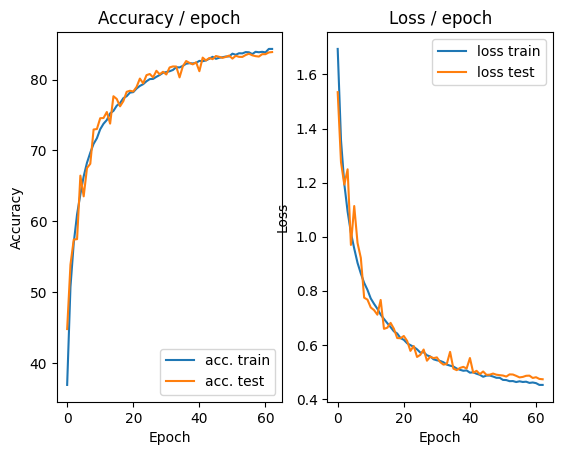

=== EPOCH 64 =====

Current learning rate: 0.003950
[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.4766 (0.4766)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.026s (0.026s)	Loss 0.4550 (0.4501)	Prec@1  85.2 ( 84.2)	Prec@5  98.4 ( 99.4)

===============> Total time 9s	Avg loss 0.4481	Avg Prec@1 84.30 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.079s (0.079s)	Loss 0.4495 (0.4495)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4744	Avg Prec@1 83.65 %	Avg Prec@5 99.14 %



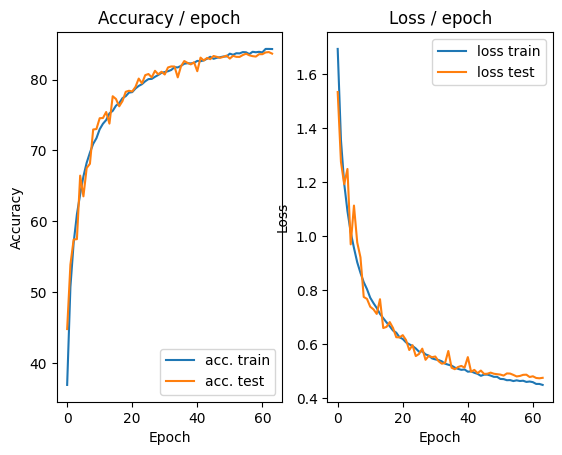

=== EPOCH 65 =====

Current learning rate: 0.003752
[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.4459 (0.4459)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.010s (0.026s)	Loss 0.4125 (0.4435)	Prec@1  86.7 ( 84.4)	Prec@5  97.7 ( 99.4)

===============> Total time 10s	Avg loss 0.4493	Avg Prec@1 84.17 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.4461 (0.4461)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4730	Avg Prec@1 83.71 %	Avg Prec@5 99.23 %



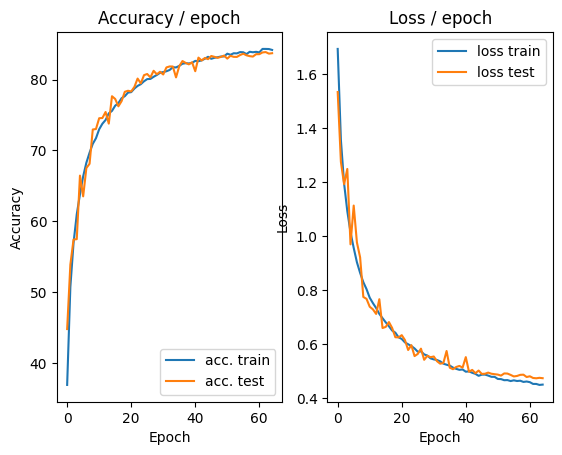

=== EPOCH 66 =====

Current learning rate: 0.003565
[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.3399 (0.3399)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.041s (0.026s)	Loss 0.4091 (0.4487)	Prec@1  86.7 ( 84.1)	Prec@5  99.2 ( 99.3)

===============> Total time 9s	Avg loss 0.4516	Avg Prec@1 84.03 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.4555 (0.4555)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4720	Avg Prec@1 83.89 %	Avg Prec@5 99.22 %



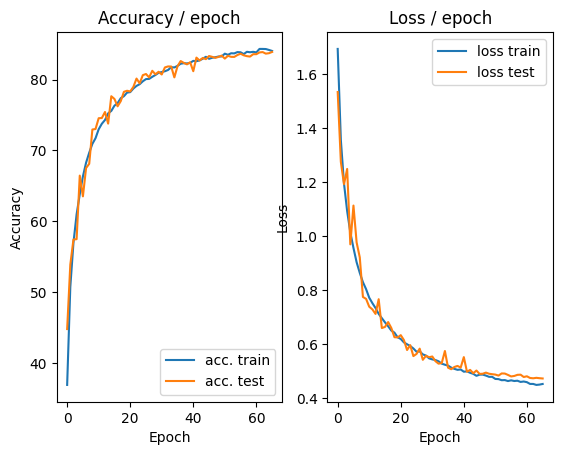

=== EPOCH 67 =====

Current learning rate: 0.003387
[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.4236 (0.4236)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.034s (0.026s)	Loss 0.4192 (0.4440)	Prec@1  86.7 ( 84.4)	Prec@5 100.0 ( 99.4)

===============> Total time 9s	Avg loss 0.4501	Avg Prec@1 84.23 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.4322 (0.4322)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4740	Avg Prec@1 84.07 %	Avg Prec@5 99.18 %



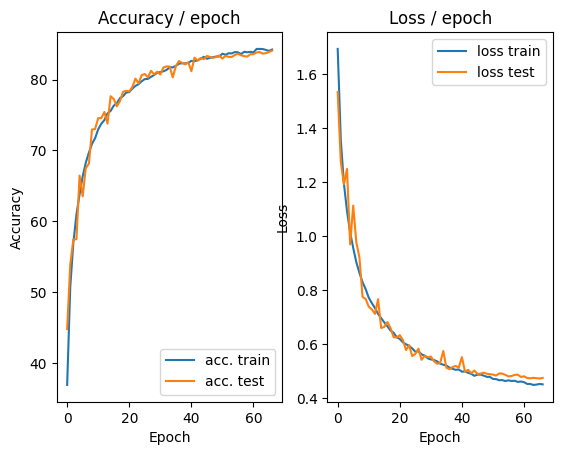

=== EPOCH 68 =====

Current learning rate: 0.003217
[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.3941 (0.3941)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.008s (0.026s)	Loss 0.4347 (0.4453)	Prec@1  85.9 ( 84.5)	Prec@5 100.0 ( 99.4)

===============> Total time 10s	Avg loss 0.4474	Avg Prec@1 84.43 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.4408 (0.4408)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4737	Avg Prec@1 83.53 %	Avg Prec@5 99.26 %



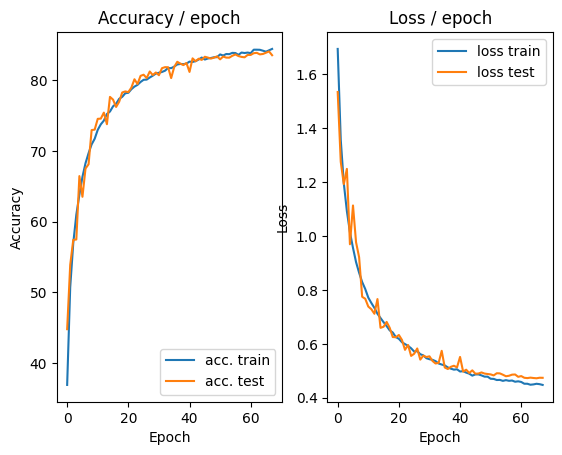

=== EPOCH 69 =====

Current learning rate: 0.003056
[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.3728 (0.3728)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.041s (0.027s)	Loss 0.4341 (0.4474)	Prec@1  86.7 ( 84.1)	Prec@5 100.0 ( 99.4)

===============> Total time 9s	Avg loss 0.4504	Avg Prec@1 84.13 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.4585 (0.4585)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4773	Avg Prec@1 83.48 %	Avg Prec@5 99.24 %



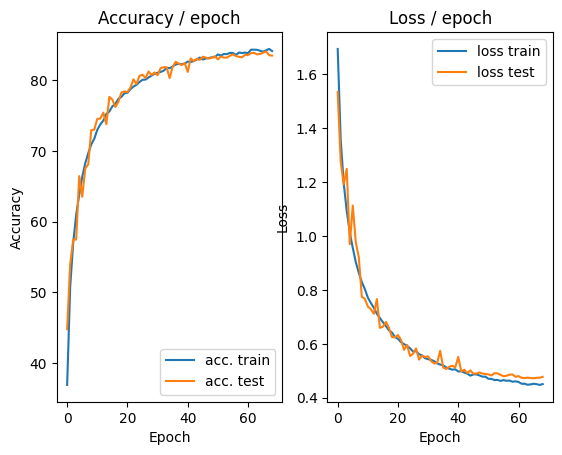

=== EPOCH 70 =====

Current learning rate: 0.002904
[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.4958 (0.4958)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.041s (0.026s)	Loss 0.5182 (0.4368)	Prec@1  80.5 ( 84.6)	Prec@5  98.4 ( 99.4)

===============> Total time 9s	Avg loss 0.4442	Avg Prec@1 84.46 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.4589 (0.4589)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.4747	Avg Prec@1 83.88 %	Avg Prec@5 99.24 %



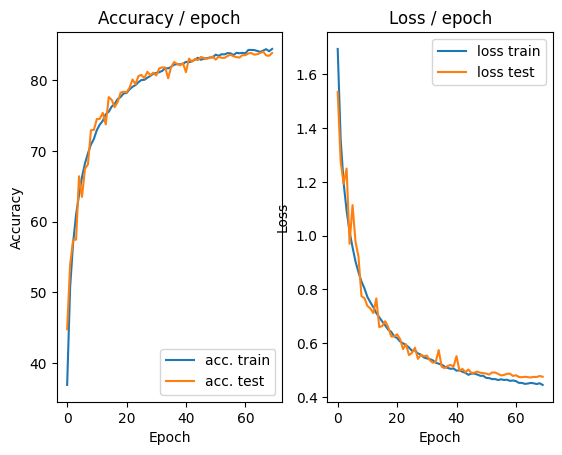

In [18]:
main(128, 0.1, 70, cuda=True)

# BONUS ZCA

In [19]:
import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import numpy as np
from torch.utils.data import Dataset, DataLoader
import time
import matplotlib.pyplot as plt

# Classe pour le plotting des courbes d'accuracy et de loss
class AccLossPlot:
    """
    Classe pour visualiser l'évolution de l'accuracy et de la loss pendant l'entraînement
    """
    def __init__(self):
        plt.ion()
        self.fig, (self.ax1, self.ax2) = plt.subplots(2, 1, figsize=(10, 10))
        self.loss_train = []
        self.loss_test = []
        self.acc_train = []
        self.acc_test = []

    def update(self, loss_train, loss_test, acc_train, acc_test):
        self.loss_train.append(loss_train)
        self.loss_test.append(loss_test)
        self.acc_train.append(acc_train)
        self.acc_test.append(acc_test)

        self.ax1.clear()
        self.ax2.clear()

        self.ax1.plot(self.loss_train, 'b-', label='Train Loss')
        self.ax1.plot(self.loss_test, 'r-', label='Test Loss')
        self.ax1.set_xlabel('Epoch')
        self.ax1.set_ylabel('Loss')
        self.ax1.legend()
        self.ax1.grid(True)

        self.ax2.plot(self.acc_train, 'b-', label='Train Accuracy')
        self.ax2.plot(self.acc_test, 'r-', label='Test Accuracy')
        self.ax2.set_xlabel('Epoch')
        self.ax2.set_ylabel('Accuracy (%)')
        self.ax2.legend()
        self.ax2.grid(True)

        plt.pause(0.1)

# Classe pour visualiser la loss pendant l'entraînement
class TrainLossPlot:
    """
    Classe pour visualiser l'évolution de la loss pendant l'entraînement en temps réel
    """
    def __init__(self):
        plt.ion()
        self.fig, self.ax = plt.subplots()
        self.losses = []

    def update(self, loss):
        self.losses.append(loss)
        self.ax.clear()
        self.ax.plot(self.losses)
        self.ax.set_xlabel('Batch')
        self.ax.set_ylabel('Loss')
        self.ax.grid(True)
        plt.pause(0.1)

class ZCAWhitening:
    """
    Implémente la normalisation ZCA (Zero-phase Component Analysis)
    """
    def __init__(self, epsilon=1e-5):
        self.epsilon = epsilon
        self.mean = None
        self.ZCA_matrix = None

    def fit(self, data):
        if len(data.shape) == 4:
            N, C, H, W = data.shape
            data = data.reshape(N, -1)

        self.mean = data.mean(axis=0, keepdims=True)
        X = data - self.mean

        sigma = np.cov(X.T)
        U, S, V = np.linalg.svd(sigma)
        self.ZCA_matrix = np.dot(U, np.dot(np.diag(1.0/np.sqrt(S + self.epsilon)), U.T))

    def transform(self, data):
        if len(data.shape) == 4:
            N, C, H, W = data.shape
            data = data.reshape(N, -1)

        if isinstance(data, torch.Tensor):
            data = data.cpu().numpy()

        X = data - self.mean
        transformed = np.dot(X, self.ZCA_matrix)

        if len(data.shape) == 4:
            transformed = transformed.reshape(N, C, H, W)

        return torch.FloatTensor(transformed)

class CIFAR10ZCA(Dataset):
    """
    Dataset personnalisé pour CIFAR10 avec normalisation ZCA
    """
    def __init__(self, dataset, transform=None, apply_transform_first=True):
        self.dataset = dataset
        self.transform = transform
        self.apply_transform_first = apply_transform_first

        if not apply_transform_first:
            print("Application de la normalisation ZCA...")
            data = torch.FloatTensor(self.dataset.data) / 255.0
            data = data.permute(0, 3, 1, 2)  # (N, H, W, C) -> (N, C, H, W)

            self.zca = ZCAWhitening()
            self.zca.fit(data.numpy())
            self.data = self.zca.transform(data)
            print("Normalisation ZCA terminée.")

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, idx):
        if self.apply_transform_first:
            # Appliquer d'abord les transformations standards
            img, target = self.dataset[idx]
            if self.transform:
                img = self.transform(img)
            return img, target
        else:
            # Utiliser les données pré-transformées par ZCA
            data = self.data[idx]
            target = self.dataset.targets[idx]
            if self.transform:
                data = self.transform(data)
            return data, target

def get_dataset(batch_size, path='./data', cuda=False):
    """
    Charge et prépare les données CIFAR10
    """
    print("Chargement/téléchargement des données CIFAR10...")

    # Transformations pour l'entraînement
    train_transform = transforms.Compose([
        transforms.ToTensor()
    ])

    # Transformations pour le test
    test_transform = transforms.Compose([
        transforms.ToTensor()
    ])

    # Chargement des datasets
    base_train_dataset = datasets.CIFAR10(path, train=True, download=True, transform=train_transform)
    base_test_dataset = datasets.CIFAR10(path, train=False, download=True, transform=test_transform)

    # Application de ZCA
    print("Préparation des datasets avec ZCA...")
    train_dataset = CIFAR10ZCA(base_train_dataset, transform=None, apply_transform_first=True)
    test_dataset = CIFAR10ZCA(base_test_dataset, transform=None, apply_transform_first=True)

    # Création des dataloaders
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2,
        pin_memory=cuda
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size=batch_size,
        shuffle=False,
        num_workers=2,
        pin_memory=cuda
    )

    print("Chargement des données terminé.")
    return train_loader, test_loader

class ConvNet(nn.Module):
    """
    Réseau neuronal convolutif pour la classification CIFAR10
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
        )

    def forward(self, x):
        x = self.features(x)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

class AverageMeter:
    """
    Calcule et stocke la moyenne et la valeur courante
    """
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

def accuracy(output, target, topk=(1,)):
    """
    Calcule la précision topk pour les k spécifiés
    """
    maxk = max(topk)
    batch_size = target.size(0)

    _, pred = output.topk(maxk, 1, True, True)
    pred = pred.t()
    correct = pred.eq(target.view(1, -1).expand_as(pred))

    res = []
    for k in topk:
        correct_k = correct[:k].reshape(-1).float().sum(0)
        res.append(correct_k.mul_(100.0 / batch_size))
    return res

def epoch(data, model, criterion, optimizer=None, cuda=False, loss_plot=None):
    """
    Effectue une époque d'entraînement ou d'évaluation
    Args:
        data: DataLoader pour les données
        model: Modèle à entraîner/évaluer
        criterion: Fonction de perte
        optimizer: Optimiseur (None pour l'évaluation)
        cuda: Utilisation de GPU
        loss_plot: Instance de TrainLossPlot pour visualiser la loss
    """
    model.train() if optimizer else model.eval()

    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()

    device = torch.device("cuda" if cuda else "cpu")
    tic = time.time()

    for i, (input, target) in enumerate(data):
        input = input.to(device)
        target = target.to(device)

        # Forward pass
        output = model(input)
        loss = criterion(output, target)

        # Backward pass si en mode entraînement
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Calcul des métriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic

        # Mise à jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)

        # Mise à jour du graphique de loss si fourni
        if loss_plot and optimizer:
            loss_plot.update(loss.item())

        # Affichage détaillé toutes les 50 batchs
        if i % 50 == 0:
            mode = "TRAIN" if optimizer else "EVAL"
            print(f'[{mode}] Batch {i:03d}/{len(data):03d}\t'
                  f'Time {avg_batch_time.val:.3f}s ({avg_batch_time.avg:.3f}s)\t'
                  f'Loss {avg_loss.val:.4f} ({avg_loss.avg:.4f})\t'
                  f'Acc@1 {avg_top1_acc.val:5.1f} ({avg_top1_acc.avg:5.1f})\t'
                  f'Acc@5 {avg_top5_acc.val:5.1f} ({avg_top5_acc.avg:5.1f})')

        tic = time.time()

    return avg_top1_acc, avg_top5_acc, avg_loss

def main(batch_size=128, lr=0.1, epochs=30, cuda=False):
    """
    Fonction principale d'entraînement
    """
    device = torch.device("cuda" if cuda and torch.cuda.is_available() else "cpu")
    print(f"Utilisation de : {device}")

    # Création du modèle
    model = ConvNet().to(device)
    criterion = nn.CrossEntropyLoss().to(device)
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda and torch.cuda.is_available():
        cudnn.benchmark = True

    try:
        print("Chargement des données...")
        train_loader, test_loader = get_dataset(batch_size, path='/content/data', cuda=cuda)
    except Exception as e:
        print(f"Erreur lors du chargement des données: {e}")
        print("Tentative avec un chemin alternatif...")
        train_loader, test_loader = get_dataset(batch_size, path='./data', cuda=cuda)

    # Initialisation des outils de visualisation
    acc_loss_plot = AccLossPlot()
    train_loss_plot = TrainLossPlot()

    for epoch_idx in range(epochs):
        print(f"\n=== EPOCH {epoch_idx + 1}/{epochs} ===")

        train_acc, train_acc_top5, train_loss = epoch(train_loader, model, criterion, optimizer, cuda, train_loss_plot)

        with torch.no_grad():
            test_acc, test_acc_top5, test_loss = epoch(test_loader, model, criterion, cuda=cuda)

        # Mise à jour des graphiques
        acc_loss_plot.update(train_loss.avg, test_loss.avg, train_acc.avg, test_acc.avg)

        print(f"\nEpoch {epoch_idx + 1}/{epochs}:")
        print(f"Train - Acc@1: {train_acc.avg:.2f}% | Acc@5: {train_acc_top5.avg:.2f}% | Loss: {train_loss.avg:.4f}")
        print(f"Test  - Acc@1: {test_acc.avg:.2f}% | Acc@5: {test_acc_top5.avg:.2f}% | Loss: {test_loss.avg:.4f}")

    plt.ioff()
    plt.show()
    return model


Utilisation de : cuda
Chargement des données...
Chargement/téléchargement des données CIFAR10...
Erreur lors du chargement des données: [Errno 13] Permission denied: '/content'
Tentative avec un chemin alternatif...
Chargement/téléchargement des données CIFAR10...


100%|██████████| 170498071/170498071 [02:59<00:00, 950865.83it/s] 


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified
Préparation des datasets avec ZCA...
Chargement des données terminé.

=== EPOCH 1/30 ===


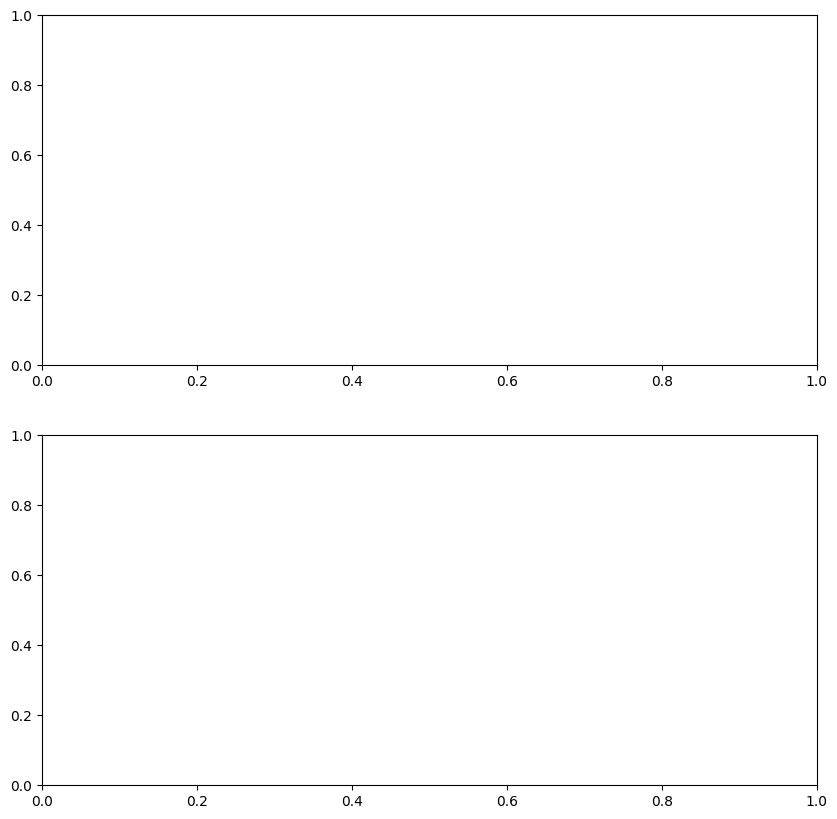

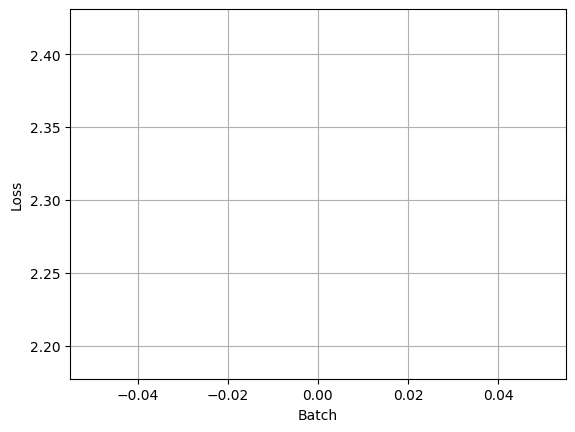

[TRAIN] Batch 000/391	Time 0.158s (0.158s)	Loss 2.3042 (2.3042)	Acc@1   7.0 (  7.0)	Acc@5  47.7 ( 47.7)
[TRAIN] Batch 050/391	Time 0.006s (0.009s)	Loss 2.2988 (2.3007)	Acc@1  14.1 ( 11.3)	Acc@5  50.8 ( 52.1)
[TRAIN] Batch 100/391	Time 0.006s (0.007s)	Loss 2.3197 (2.2899)	Acc@1   7.0 ( 12.3)	Acc@5  50.0 ( 54.8)
[TRAIN] Batch 150/391	Time 0.005s (0.006s)	Loss 2.1791 (2.2717)	Acc@1  19.5 ( 13.7)	Acc@5  78.9 ( 58.3)
[TRAIN] Batch 200/391	Time 0.004s (0.006s)	Loss 2.2524 (2.2420)	Acc@1  15.6 ( 15.5)	Acc@5  59.4 ( 61.6)
[TRAIN] Batch 250/391	Time 0.004s (0.006s)	Loss 2.1826 (2.2442)	Acc@1  23.4 ( 15.4)	Acc@5  75.8 ( 61.2)
[TRAIN] Batch 300/391	Time 0.004s (0.006s)	Loss 2.1617 (2.2392)	Acc@1  25.8 ( 16.1)	Acc@5  74.2 ( 62.2)
[TRAIN] Batch 350/391	Time 0.005s (0.005s)	Loss 2.1131 (2.2226)	Acc@1  21.9 ( 16.9)	Acc@5  73.4 ( 63.7)
[EVAL] Batch 000/079	Time 0.058s (0.058s)	Loss 2.0206 (2.0206)	Acc@1  30.5 ( 30.5)	Acc@5  76.6 ( 76.6)
[EVAL] Batch 050/079	Time 0.019s (0.011s)	Loss 2.1017 (2.0168)	Ac

ConvNet(
  (features): Sequential(
    (0): Conv2d(3, 32, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(32, 64, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(64, 64, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (7): ReLU()
    (8): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (classifier): Sequential(
    (0): Linear(in_features=1024, out_features=1000, bias=True)
    (1): ReLU()
    (2): Linear(in_features=1000, out_features=10, bias=True)
  )
)

In [20]:
main(128, 0.1, 30, cuda=True)

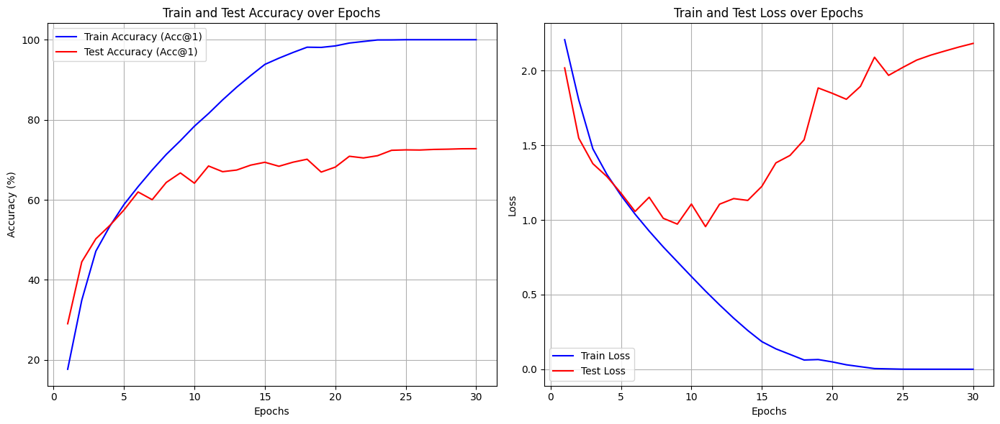

In [21]:
import matplotlib.pyplot as plt

# Data for training and testing accuracies and losses over epochs
epochs = list(range(1, 31))
train_acc1 = [17.67, 34.92, 47.17, 53.46, 58.84, 63.29, 67.45, 71.34, 74.76, 78.40, 81.55, 84.96, 88.14, 91.06, 93.83,
              95.39, 96.81, 98.13, 98.08, 98.45, 99.17, 99.56, 99.94, 99.95, 100.00, 100.00, 100.00, 100.00, 100.00, 100.00]
test_acc1 = [29.04, 44.50, 50.26, 53.62, 57.48, 61.96, 60.03, 64.34, 66.72, 64.15, 68.45, 67.03, 67.44, 68.67, 69.38,
             68.38, 69.40, 70.14, 66.93, 68.17, 70.88, 70.46, 71.02, 72.37, 72.48, 72.44, 72.59, 72.65, 72.75, 72.77]
train_loss = [2.2065, 1.8033, 1.4764, 1.3045, 1.1640, 1.0385, 0.9253, 0.8191, 0.7199, 0.6209, 0.5236, 0.4309, 0.3421,
              0.2597, 0.1851, 0.1366, 0.0996, 0.0620, 0.0651, 0.0494, 0.0300, 0.0173, 0.0047, 0.0027, 0.0006, 0.0004, 0.0003, 0.0003, 0.0002, 0.0002]
test_loss = [2.0176, 1.5472, 1.3766, 1.2903, 1.1790, 1.0567, 1.1517, 1.0109, 0.9718, 1.1062, 0.9551, 1.1054, 1.1427,
             1.1306, 1.2246, 1.3820, 1.4317, 1.5363, 1.8836, 1.8477, 1.8078, 1.8939, 2.0891, 1.9679, 2.0207, 2.0703, 2.1035, 2.1310, 2.1577, 2.1817]

# Plotting training and testing accuracy
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.plot(epochs, train_acc1, label='Train Accuracy (Acc@1)', color='b')
plt.plot(epochs, test_acc1, label='Test Accuracy (Acc@1)', color='r')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.title('Train and Test Accuracy over Epochs')
plt.legend()
plt.grid(True)

# Plotting training and testing loss
plt.subplot(1, 2, 2)
plt.plot(epochs, train_loss, label='Train Loss', color='b')
plt.plot(epochs, test_loss, label='Test Loss', color='r')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Train and Test Loss over Epochs')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


# BONUS Data Aug

In [11]:
class ConvNet(nn.Module):
    """
    Cette classe définit la structure du réseau neuronal convolutif.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # Définition des couches convolutives et de pooling pour extraire les caractéristiques
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True),
        )
        # Couches fully connected pour la classification
        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Remarque : Pas besoin d'ajouter la couche softmax ici, car elle est incluse dans la fonction de perte
        )



    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le jeu de données CIFAR-10 et applique les transformations nécessaires,
    y compris la normalisation.
    """
    # Valeurs de normalisation pour CIFAR-10
    mean = [0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]

    # Transformations à appliquer sur les images
    train_transform = transforms.Compose([
        # transforms.RandomHorizontalFlip(),  # Flips aléatoires pour augmenter les données
        # transforms.RandomCrop(28, padding=4),  # Découpage aléatoire
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        transforms.RandomRotation(15),
        transforms.RandomAffine(degrees=0, translate=(0.1, 0.1), scale=(0.9, 1.1)),
        transforms.RandomPerspective(distortion_scale=0.2, p=0.5),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)  # Normalisation
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Chargement des jeux de données d'entraînement et de validation
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True, transform=val_transform)

    # Création des DataLoader pour parcourir les jeux de données par batch
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                                               pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False,
                                             pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Effectue un passage (epoch) sur les données `data` avec le modèle `model`.
    Évalue la perte avec `criterion`. Si `optimizer` est fourni, fait une étape d'entraînement,
    sinon fait une évaluation.
    """
    model.eval() if optimizer is None else model.train()

    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()

    tic = time.time()
    for i, (input, target) in enumerate(data):
        if cuda:
            input = input.cuda()
            target = target.cuda()

        # Forward pass
        output = model(input)
        loss = criterion(output, target)

        # Backward pass si on est en mode entraînement
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Calcul des métriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # Mise à jour des métriques moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)

        # Affichage des informations
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time,
                   loss=avg_loss, top1=avg_top1_acc, top5=avg_top5_acc))

    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 2.3025 (2.3025)	Prec@1  14.8 ( 14.8)	Prec@5  47.7 ( 47.7)
[TRAIN Batch 200/391]	Time 0.185s (0.113s)	Loss 1.7199 (2.0443)	Prec@1  38.3 ( 24.7)	Prec@5  90.6 ( 75.1)

===============> Total time 44s	Avg loss 1.9087	Avg Prec@1 30.21 %	Avg Prec@5 80.64 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.5121 (1.5121)	Prec@1  45.3 ( 45.3)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5144	Avg Prec@1 44.35 %	Avg Prec@5 91.28 %



<Figure size 640x480 with 0 Axes>

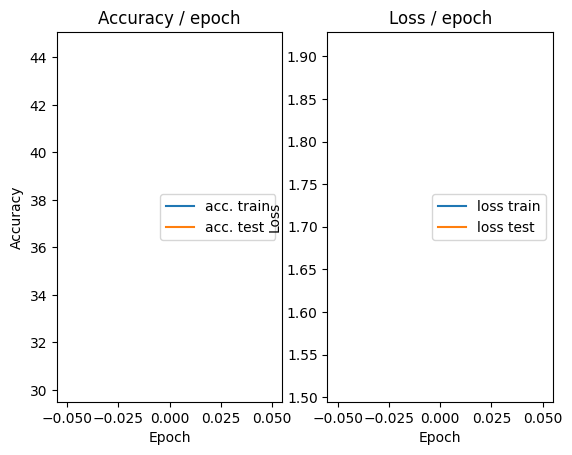

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 1.6999 (1.6999)	Prec@1  39.1 ( 39.1)	Prec@5  90.6 ( 90.6)
[TRAIN Batch 200/391]	Time 0.157s (0.094s)	Loss 1.4553 (1.6336)	Prec@1  46.1 ( 41.0)	Prec@5  92.2 ( 89.2)

===============> Total time 35s	Avg loss 1.5857	Avg Prec@1 42.85 %	Avg Prec@5 90.03 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 1.4191 (1.4191)	Prec@1  56.2 ( 56.2)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.4534	Avg Prec@1 49.63 %	Avg Prec@5 92.14 %



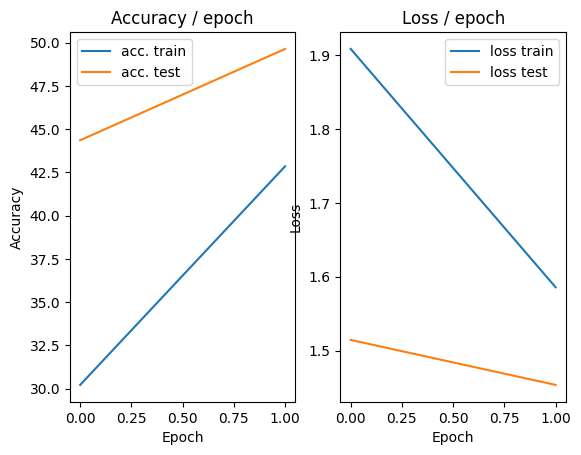

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 1.5072 (1.5072)	Prec@1  46.1 ( 46.1)	Prec@5  90.6 ( 90.6)
[TRAIN Batch 200/391]	Time 0.025s (0.087s)	Loss 1.4364 (1.4483)	Prec@1  50.0 ( 48.1)	Prec@5  92.2 ( 92.2)

===============> Total time 33s	Avg loss 1.4187	Avg Prec@1 49.45 %	Avg Prec@5 92.59 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 1.3056 (1.3056)	Prec@1  57.8 ( 57.8)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.3980	Avg Prec@1 50.38 %	Avg Prec@5 93.85 %



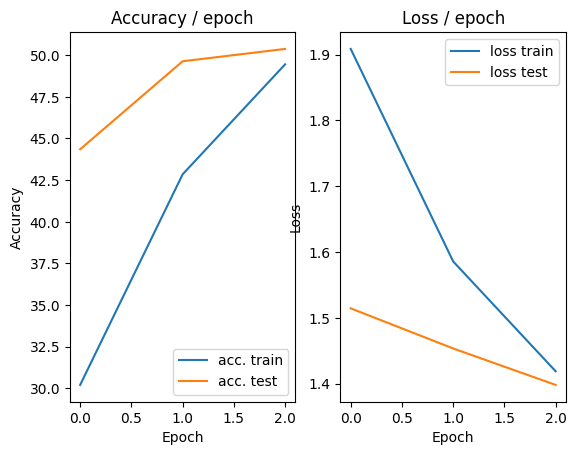

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.294s (0.294s)	Loss 1.4177 (1.4177)	Prec@1  44.5 ( 44.5)	Prec@5  93.0 ( 93.0)
[TRAIN Batch 200/391]	Time 0.036s (0.090s)	Loss 1.3296 (1.3201)	Prec@1  53.1 ( 52.9)	Prec@5  90.6 ( 94.0)

===============> Total time 35s	Avg loss 1.3006	Avg Prec@1 53.71 %	Avg Prec@5 94.09 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 1.1100 (1.1100)	Prec@1  61.7 ( 61.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.1426	Avg Prec@1 59.72 %	Avg Prec@5 95.88 %



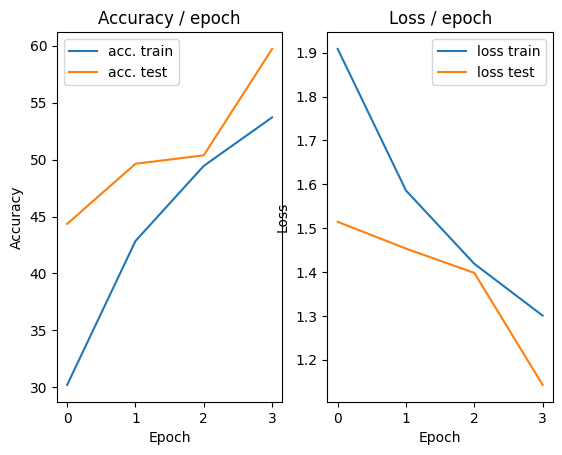

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.321s (0.321s)	Loss 1.2423 (1.2423)	Prec@1  58.6 ( 58.6)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.154s (0.114s)	Loss 1.2060 (1.2065)	Prec@1  55.5 ( 57.3)	Prec@5  96.1 ( 94.9)

===============> Total time 47s	Avg loss 1.1968	Avg Prec@1 57.82 %	Avg Prec@5 95.06 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 1.1005 (1.1005)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1280	Avg Prec@1 60.07 %	Avg Prec@5 96.06 %



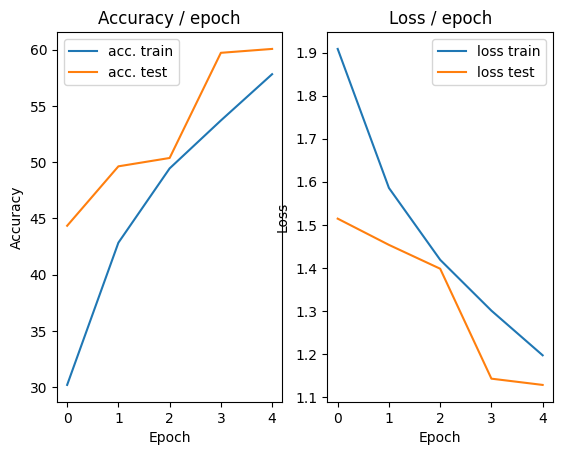

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 1.2863 (1.2863)	Prec@1  48.4 ( 48.4)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.161s (0.090s)	Loss 0.9794 (1.1393)	Prec@1  70.3 ( 59.7)	Prec@5  95.3 ( 95.7)

===============> Total time 38s	Avg loss 1.1259	Avg Prec@1 60.31 %	Avg Prec@5 95.78 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.9955 (0.9955)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9992	Avg Prec@1 65.06 %	Avg Prec@5 96.89 %



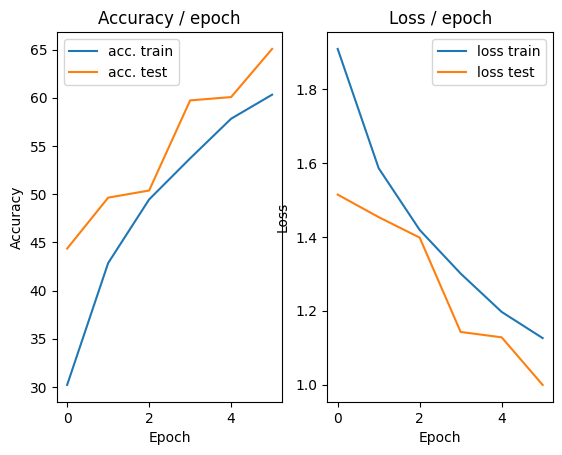

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.451s (0.451s)	Loss 1.0891 (1.0891)	Prec@1  61.7 ( 61.7)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.009s (0.116s)	Loss 1.1199 (1.0796)	Prec@1  60.9 ( 62.1)	Prec@5  96.1 ( 96.0)

===============> Total time 45s	Avg loss 1.0625	Avg Prec@1 62.66 %	Avg Prec@5 96.31 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.9335 (0.9335)	Prec@1  68.8 ( 68.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9966	Avg Prec@1 65.05 %	Avg Prec@5 96.96 %



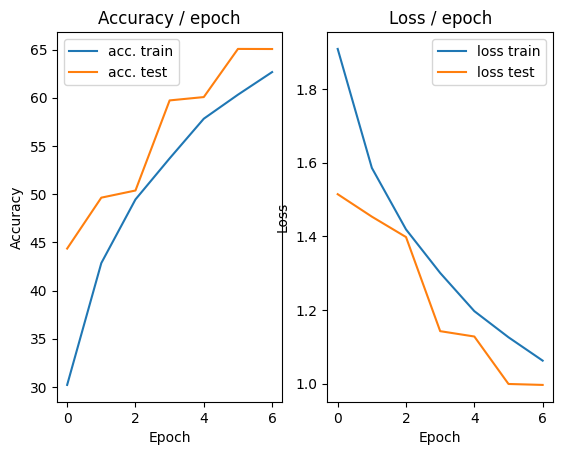

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.306s (0.306s)	Loss 1.2428 (1.2428)	Prec@1  56.2 ( 56.2)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.168s (0.104s)	Loss 1.2984 (1.0185)	Prec@1  51.6 ( 64.4)	Prec@5  91.4 ( 96.6)

===============> Total time 38s	Avg loss 1.0147	Avg Prec@1 64.48 %	Avg Prec@5 96.57 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 0.9258 (0.9258)	Prec@1  68.8 ( 68.8)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.9701	Avg Prec@1 67.15 %	Avg Prec@5 96.61 %



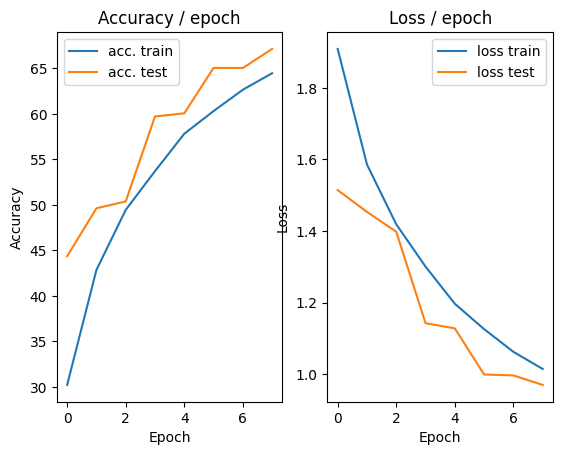

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 1.0539 (1.0539)	Prec@1  60.9 ( 60.9)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.178s (0.097s)	Loss 1.0931 (0.9588)	Prec@1  60.2 ( 66.6)	Prec@5  95.3 ( 97.0)

===============> Total time 39s	Avg loss 0.9628	Avg Prec@1 66.52 %	Avg Prec@5 96.94 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.8707 (0.8707)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8643	Avg Prec@1 70.64 %	Avg Prec@5 97.44 %



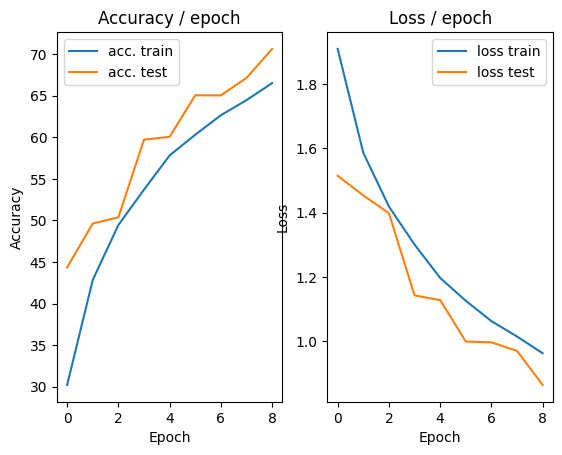

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.7451 (0.7451)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.152s (0.089s)	Loss 0.8801 (0.9287)	Prec@1  67.2 ( 67.5)	Prec@5  98.4 ( 97.2)

===============> Total time 34s	Avg loss 0.9218	Avg Prec@1 67.65 %	Avg Prec@5 97.18 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.8528 (0.8528)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9151	Avg Prec@1 68.93 %	Avg Prec@5 96.80 %



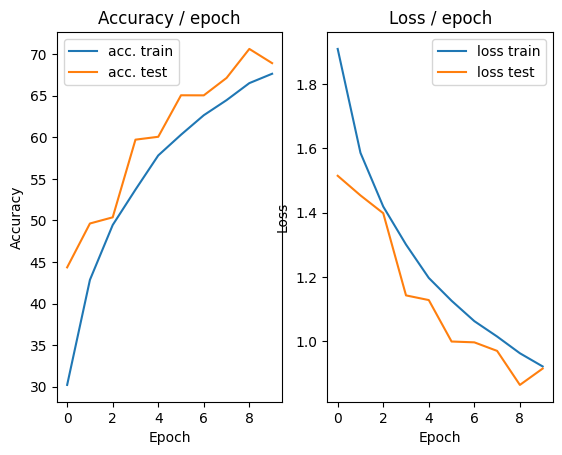

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 1.1039 (1.1039)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.177s (0.091s)	Loss 0.8617 (0.8871)	Prec@1  70.3 ( 68.9)	Prec@5  94.5 ( 97.4)

===============> Total time 35s	Avg loss 0.8868	Avg Prec@1 68.91 %	Avg Prec@5 97.41 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.8207 (0.8207)	Prec@1  74.2 ( 74.2)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 0.7993	Avg Prec@1 72.77 %	Avg Prec@5 98.04 %



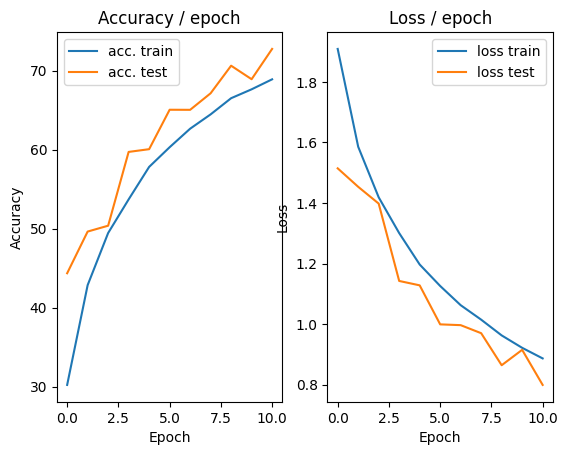

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.9706 (0.9706)	Prec@1  71.1 ( 71.1)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.229s (0.092s)	Loss 0.8816 (0.8540)	Prec@1  68.8 ( 70.2)	Prec@5  96.1 ( 97.6)

===============> Total time 38s	Avg loss 0.8583	Avg Prec@1 70.24 %	Avg Prec@5 97.61 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 0.9088 (0.9088)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8548	Avg Prec@1 71.92 %	Avg Prec@5 97.70 %



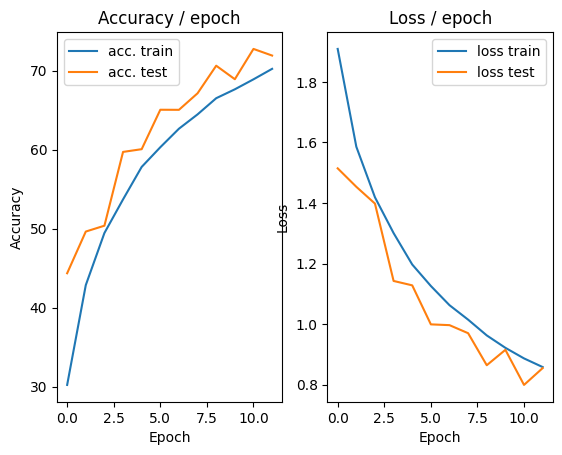

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.8683 (0.8683)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.117s (0.092s)	Loss 0.8823 (0.8344)	Prec@1  68.0 ( 70.6)	Prec@5  98.4 ( 97.8)

===============> Total time 35s	Avg loss 0.8328	Avg Prec@1 70.81 %	Avg Prec@5 97.75 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.9337 (0.9337)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7976	Avg Prec@1 73.27 %	Avg Prec@5 97.98 %



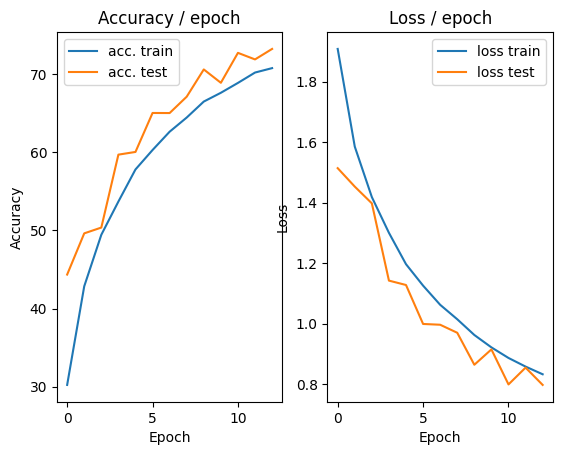

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.8220 (0.8220)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.146s (0.093s)	Loss 0.9410 (0.8032)	Prec@1  64.1 ( 71.8)	Prec@5  95.3 ( 98.0)

===============> Total time 35s	Avg loss 0.8055	Avg Prec@1 71.75 %	Avg Prec@5 97.95 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 0.8235 (0.8235)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8483	Avg Prec@1 71.98 %	Avg Prec@5 97.59 %



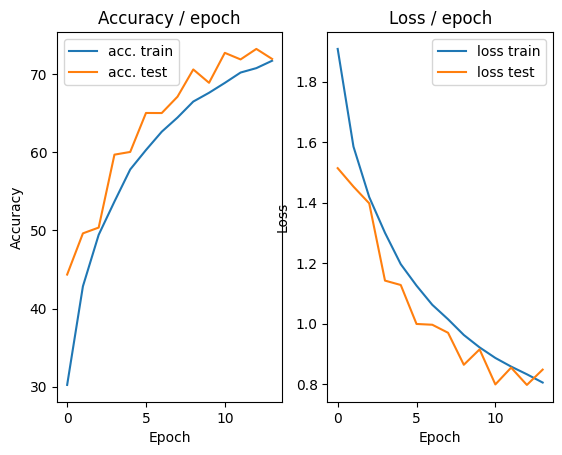

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.8739 (0.8739)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.008s (0.089s)	Loss 0.7673 (0.7706)	Prec@1  69.5 ( 73.3)	Prec@5  98.4 ( 98.1)

===============> Total time 34s	Avg loss 0.7772	Avg Prec@1 72.82 %	Avg Prec@5 98.11 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.8772 (0.8772)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.7680	Avg Prec@1 74.39 %	Avg Prec@5 97.85 %



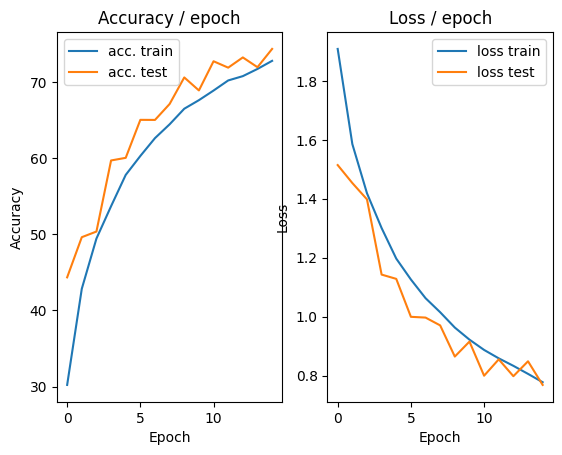

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.7823 (0.7823)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.149s (0.090s)	Loss 0.6924 (0.7513)	Prec@1  77.3 ( 73.7)	Prec@5  96.1 ( 98.2)

===============> Total time 34s	Avg loss 0.7560	Avg Prec@1 73.62 %	Avg Prec@5 98.21 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 0.7540 (0.7540)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7647	Avg Prec@1 74.73 %	Avg Prec@5 97.90 %



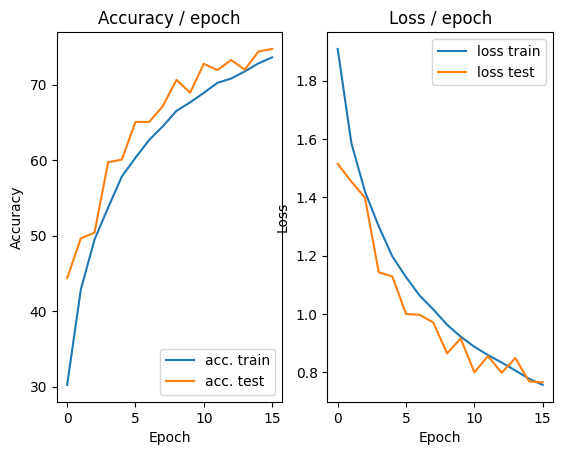

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.5386 (0.5386)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.166s (0.093s)	Loss 0.7494 (0.7308)	Prec@1  71.1 ( 74.3)	Prec@5  98.4 ( 98.4)

===============> Total time 36s	Avg loss 0.7351	Avg Prec@1 74.30 %	Avg Prec@5 98.39 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.7142 (0.7142)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7169	Avg Prec@1 75.72 %	Avg Prec@5 98.22 %



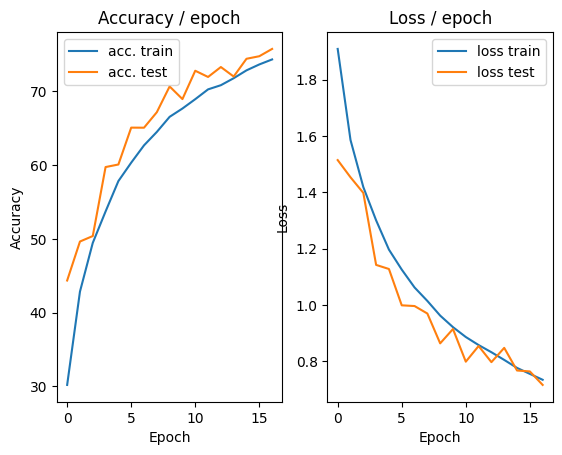

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 0.6631 (0.6631)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.215s (0.092s)	Loss 0.7107 (0.7149)	Prec@1  78.9 ( 74.9)	Prec@5 100.0 ( 98.5)

===============> Total time 36s	Avg loss 0.7175	Avg Prec@1 74.82 %	Avg Prec@5 98.49 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.8699 (0.8699)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7388	Avg Prec@1 76.14 %	Avg Prec@5 97.93 %



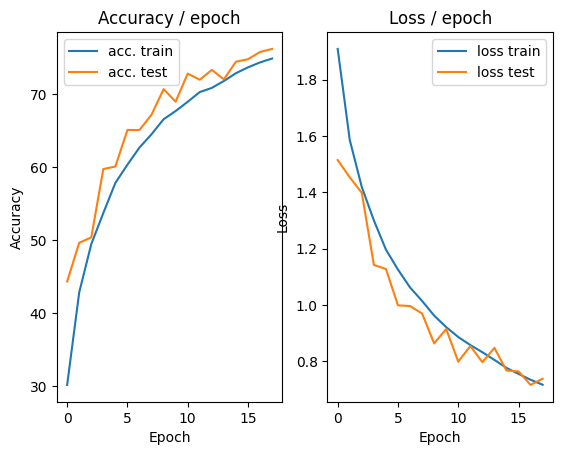

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.6247 (0.6247)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.159s (0.091s)	Loss 0.6116 (0.6912)	Prec@1  80.5 ( 75.5)	Prec@5  99.2 ( 98.5)

===============> Total time 36s	Avg loss 0.6999	Avg Prec@1 75.35 %	Avg Prec@5 98.49 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 0.7705 (0.7705)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7254	Avg Prec@1 75.74 %	Avg Prec@5 98.22 %



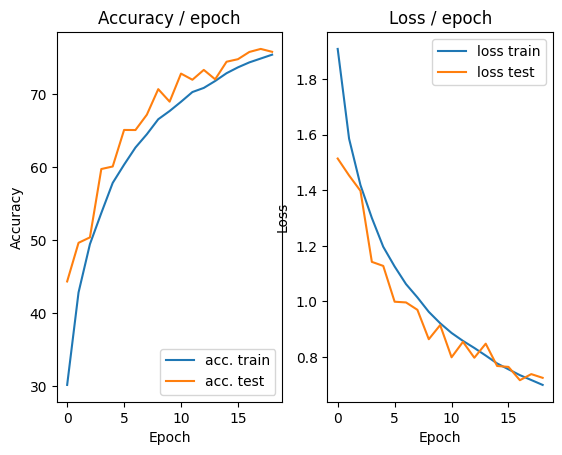

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.7337 (0.7337)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.174s (0.094s)	Loss 0.8861 (0.6820)	Prec@1  70.3 ( 76.2)	Prec@5  96.1 ( 98.7)

===============> Total time 37s	Avg loss 0.6881	Avg Prec@1 76.07 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.6992 (0.6992)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7331	Avg Prec@1 75.72 %	Avg Prec@5 98.31 %



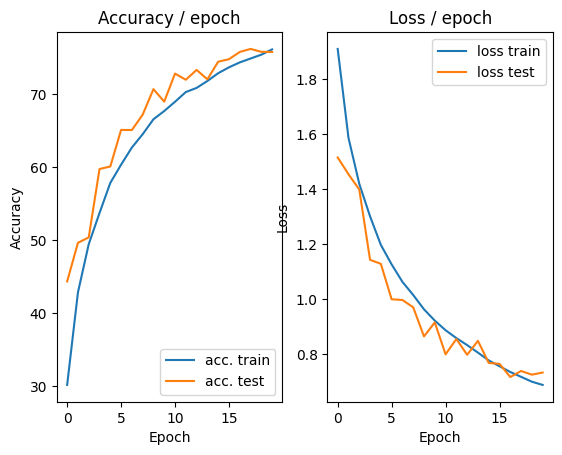

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.6725 (0.6725)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.116s (0.082s)	Loss 0.5953 (0.6529)	Prec@1  77.3 ( 77.0)	Prec@5 100.0 ( 98.8)

===============> Total time 31s	Avg loss 0.6681	Avg Prec@1 76.54 %	Avg Prec@5 98.78 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.7426 (0.7426)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7493	Avg Prec@1 75.19 %	Avg Prec@5 97.84 %



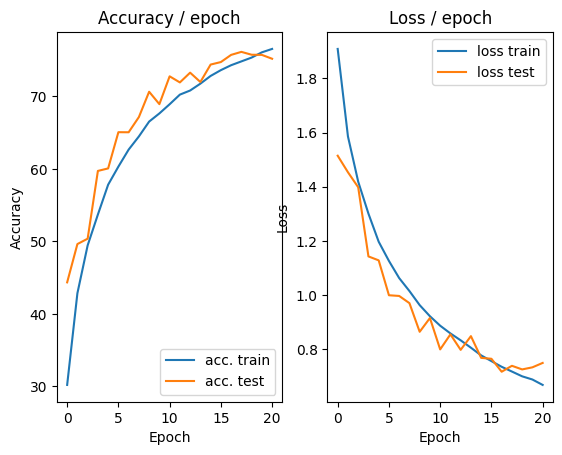

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.326s (0.326s)	Loss 0.7943 (0.7943)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.142s (0.084s)	Loss 0.6714 (0.6443)	Prec@1  73.4 ( 77.2)	Prec@5  98.4 ( 98.9)

===============> Total time 32s	Avg loss 0.6592	Avg Prec@1 76.88 %	Avg Prec@5 98.82 %

[EVAL Batch 000/079]	Time 0.078s (0.078s)	Loss 0.7669 (0.7669)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7031	Avg Prec@1 76.71 %	Avg Prec@5 98.25 %



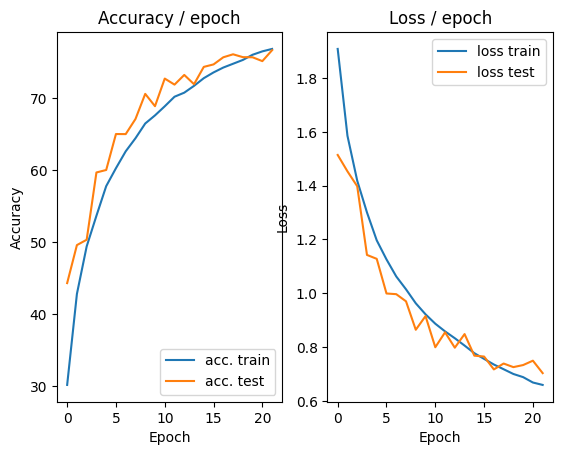

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.7349 (0.7349)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.158s (0.086s)	Loss 0.7649 (0.6293)	Prec@1  75.0 ( 77.8)	Prec@5  96.1 ( 98.9)

===============> Total time 36s	Avg loss 0.6440	Avg Prec@1 77.41 %	Avg Prec@5 98.82 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.8558 (0.8558)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7888	Avg Prec@1 73.43 %	Avg Prec@5 97.57 %



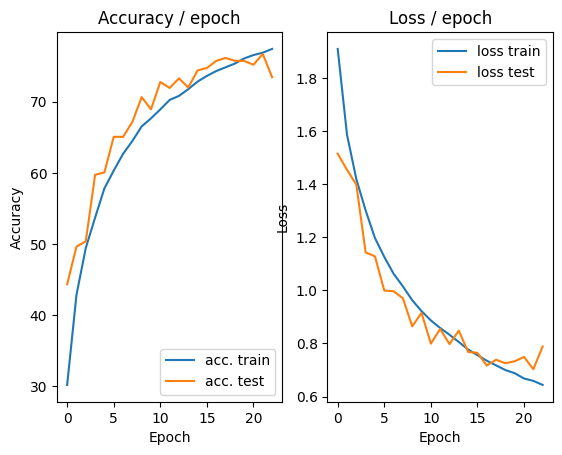

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.7322 (0.7322)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.154s (0.091s)	Loss 0.6801 (0.6206)	Prec@1  77.3 ( 78.1)	Prec@5  98.4 ( 98.9)

===============> Total time 34s	Avg loss 0.6298	Avg Prec@1 77.94 %	Avg Prec@5 98.87 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.7417 (0.7417)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7037	Avg Prec@1 77.03 %	Avg Prec@5 98.03 %



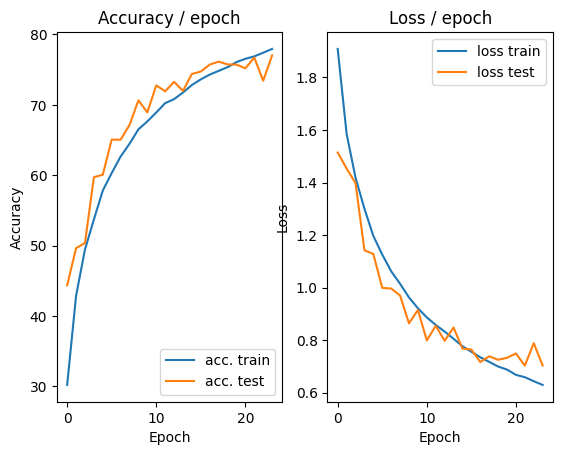

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.5013 (0.5013)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.185s (0.093s)	Loss 0.6690 (0.6027)	Prec@1  75.0 ( 79.0)	Prec@5  98.4 ( 98.9)

===============> Total time 41s	Avg loss 0.6161	Avg Prec@1 78.55 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 0.7826 (0.7826)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7258	Avg Prec@1 76.50 %	Avg Prec@5 98.20 %



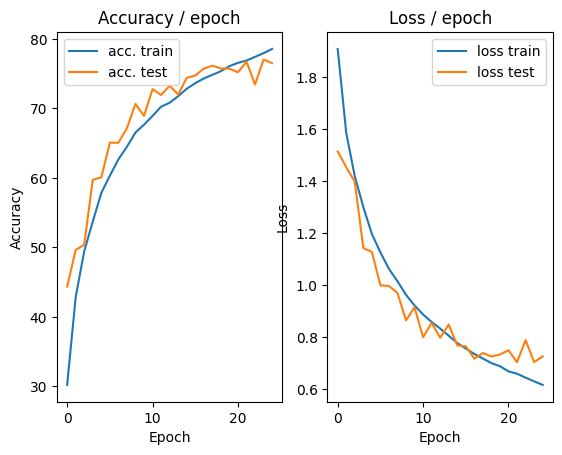

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.396s (0.396s)	Loss 0.6382 (0.6382)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.207s (0.109s)	Loss 0.6015 (0.6122)	Prec@1  78.9 ( 78.6)	Prec@5 100.0 ( 98.9)

===============> Total time 40s	Avg loss 0.6111	Avg Prec@1 78.68 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 0.8819 (0.8819)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7128	Avg Prec@1 77.02 %	Avg Prec@5 98.18 %



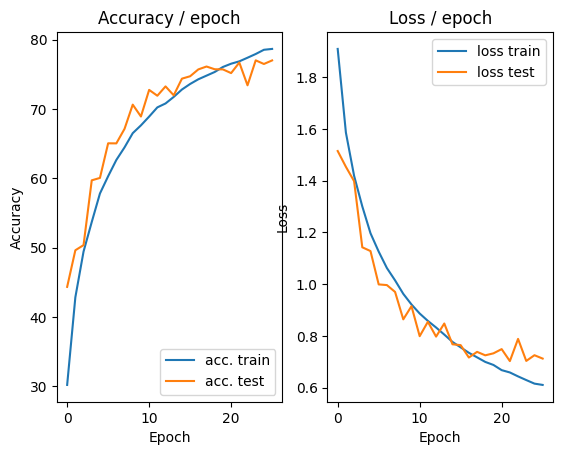

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.386s (0.386s)	Loss 0.6212 (0.6212)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.194s (0.115s)	Loss 0.5706 (0.5874)	Prec@1  81.2 ( 79.6)	Prec@5  99.2 ( 99.1)

===============> Total time 41s	Avg loss 0.5889	Avg Prec@1 79.49 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 0.8359 (0.8359)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7405	Avg Prec@1 75.75 %	Avg Prec@5 98.13 %



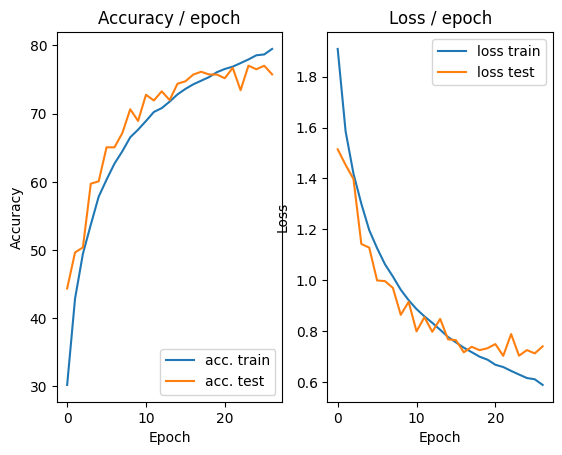

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.6605 (0.6605)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.155s (0.088s)	Loss 0.6747 (0.5763)	Prec@1  75.8 ( 80.1)	Prec@5  98.4 ( 99.0)

===============> Total time 34s	Avg loss 0.5887	Avg Prec@1 79.40 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.8843 (0.8843)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7462	Avg Prec@1 76.32 %	Avg Prec@5 97.99 %



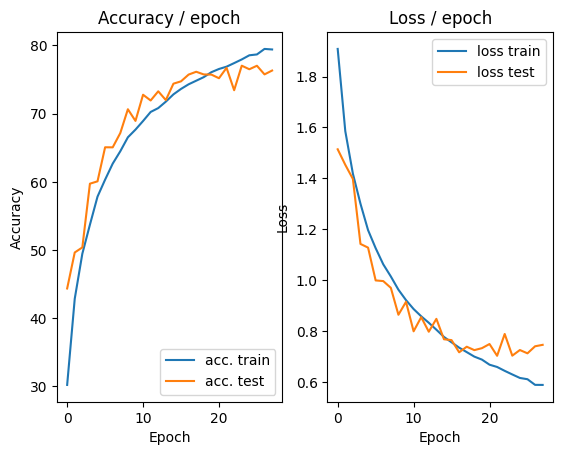

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.5999 (0.5999)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.160s (0.088s)	Loss 0.5149 (0.5733)	Prec@1  82.0 ( 79.9)	Prec@5 100.0 ( 99.2)

===============> Total time 34s	Avg loss 0.5745	Avg Prec@1 80.01 %	Avg Prec@5 99.11 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.7077 (0.7077)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6985	Avg Prec@1 78.06 %	Avg Prec@5 98.20 %



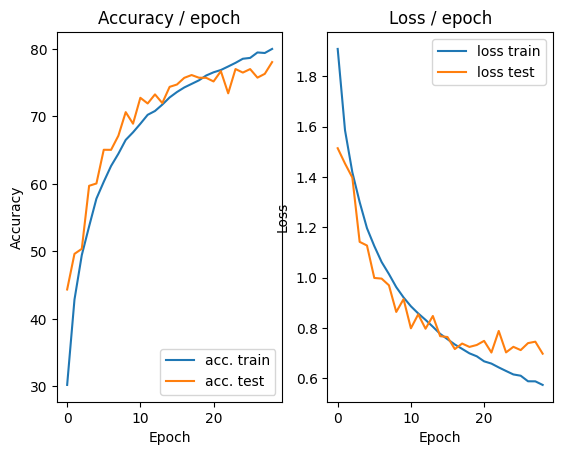

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.4504 (0.4504)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.149s (0.088s)	Loss 0.5527 (0.5476)	Prec@1  79.7 ( 80.9)	Prec@5 100.0 ( 99.3)

===============> Total time 34s	Avg loss 0.5662	Avg Prec@1 80.46 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.8085 (0.8085)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7198	Avg Prec@1 77.39 %	Avg Prec@5 98.29 %



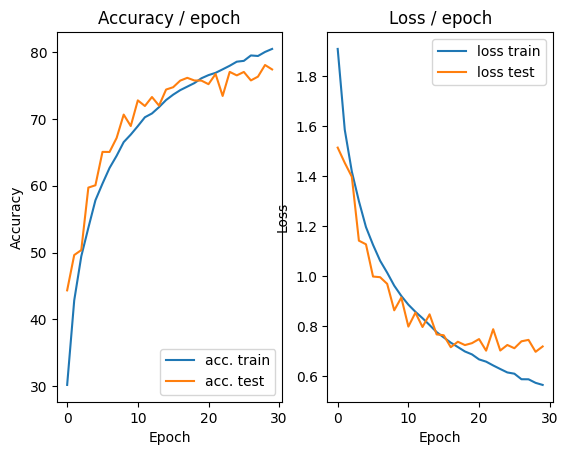

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 0.6148 (0.6148)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.166s (0.088s)	Loss 0.5926 (0.5378)	Prec@1  81.2 ( 81.1)	Prec@5 100.0 ( 99.2)

===============> Total time 34s	Avg loss 0.5534	Avg Prec@1 80.63 %	Avg Prec@5 99.18 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 0.7958 (0.7958)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7091	Avg Prec@1 77.65 %	Avg Prec@5 98.22 %



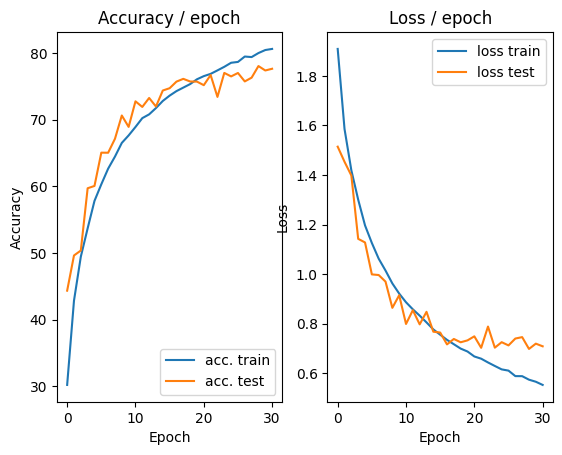

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.4546 (0.4546)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.048s (0.087s)	Loss 0.6216 (0.5322)	Prec@1  75.0 ( 81.6)	Prec@5 100.0 ( 99.3)

===============> Total time 34s	Avg loss 0.5403	Avg Prec@1 81.18 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 0.8450 (0.8450)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7736	Avg Prec@1 76.28 %	Avg Prec@5 97.85 %



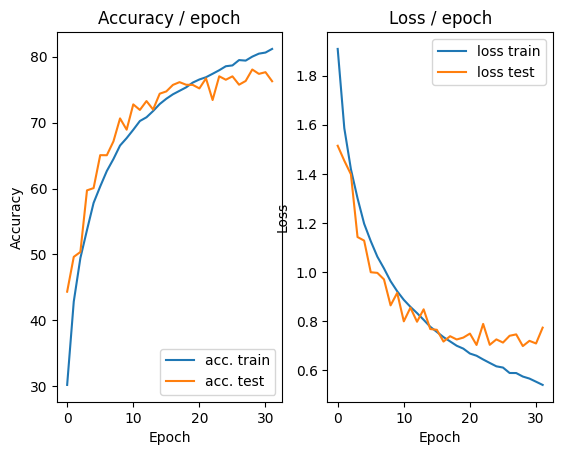

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.382s (0.382s)	Loss 0.6524 (0.6524)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.115s (0.103s)	Loss 0.5881 (0.5280)	Prec@1  82.0 ( 81.4)	Prec@5  99.2 ( 99.3)

===============> Total time 40s	Avg loss 0.5368	Avg Prec@1 81.14 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.7809 (0.7809)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7038	Avg Prec@1 78.41 %	Avg Prec@5 98.17 %



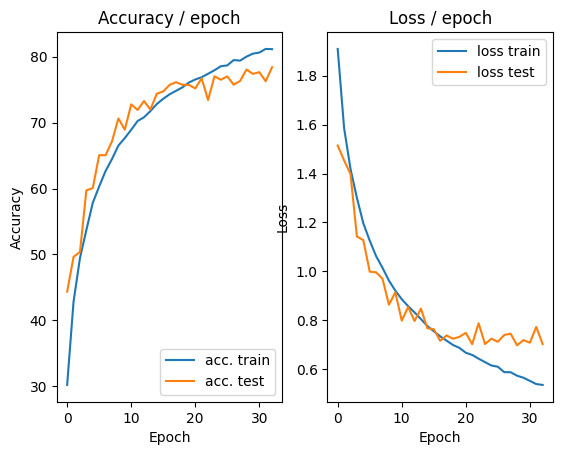

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.4037 (0.4037)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.364s (0.095s)	Loss 0.4552 (0.5212)	Prec@1  86.7 ( 81.8)	Prec@5  99.2 ( 99.3)

===============> Total time 37s	Avg loss 0.5297	Avg Prec@1 81.49 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 0.8273 (0.8273)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7417	Avg Prec@1 77.51 %	Avg Prec@5 98.18 %



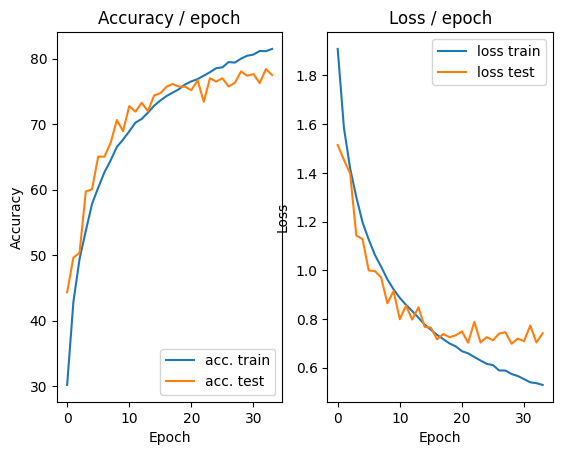

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.357s (0.357s)	Loss 0.6008 (0.6008)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.010s (0.098s)	Loss 0.5888 (0.5033)	Prec@1  78.1 ( 82.5)	Prec@5 100.0 ( 99.4)

===============> Total time 37s	Avg loss 0.5221	Avg Prec@1 81.86 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.096s (0.096s)	Loss 0.8210 (0.8210)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7843	Avg Prec@1 76.51 %	Avg Prec@5 97.93 %



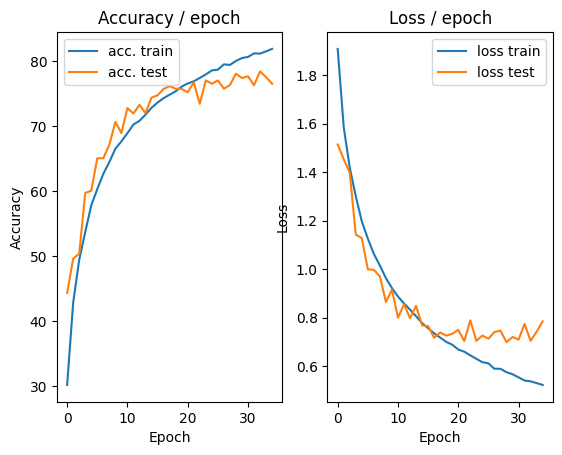

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.393s (0.393s)	Loss 0.5806 (0.5806)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.009s (0.110s)	Loss 0.5557 (0.5018)	Prec@1  78.1 ( 82.4)	Prec@5  99.2 ( 99.4)

===============> Total time 39s	Avg loss 0.5191	Avg Prec@1 81.97 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.7543 (0.7543)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7118	Avg Prec@1 78.47 %	Avg Prec@5 98.21 %



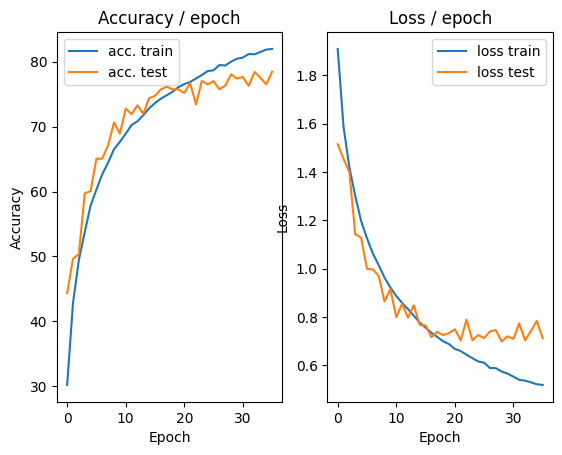

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 0.4657 (0.4657)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.010s (0.090s)	Loss 0.4438 (0.4984)	Prec@1  82.8 ( 82.5)	Prec@5 100.0 ( 99.4)

===============> Total time 34s	Avg loss 0.5107	Avg Prec@1 82.14 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 0.8181 (0.8181)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7351	Avg Prec@1 78.00 %	Avg Prec@5 98.20 %



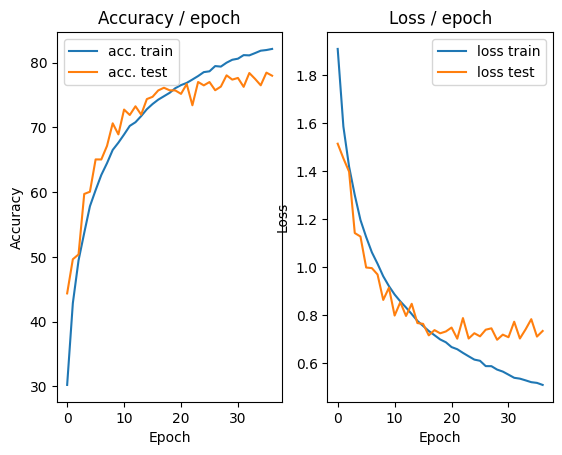

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 0.5286 (0.5286)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.079s (0.088s)	Loss 0.3811 (0.4917)	Prec@1  84.4 ( 83.1)	Prec@5  99.2 ( 99.3)

===============> Total time 34s	Avg loss 0.5018	Avg Prec@1 82.67 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 0.7627 (0.7627)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7349	Avg Prec@1 78.20 %	Avg Prec@5 98.08 %



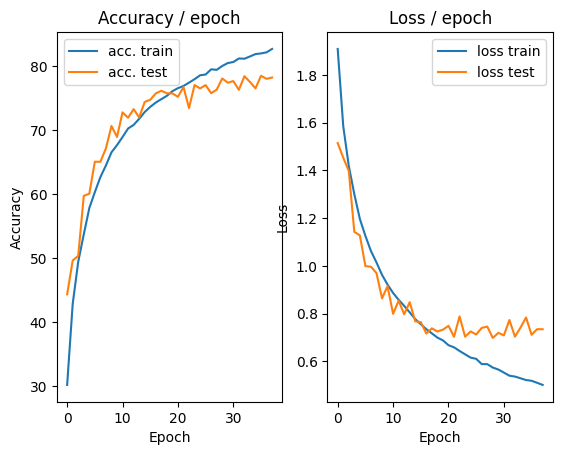

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.4570 (0.4570)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.011s (0.095s)	Loss 0.5301 (0.4816)	Prec@1  79.7 ( 83.2)	Prec@5 100.0 ( 99.5)

===============> Total time 37s	Avg loss 0.4907	Avg Prec@1 82.98 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.9168 (0.9168)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7201	Avg Prec@1 78.20 %	Avg Prec@5 97.97 %



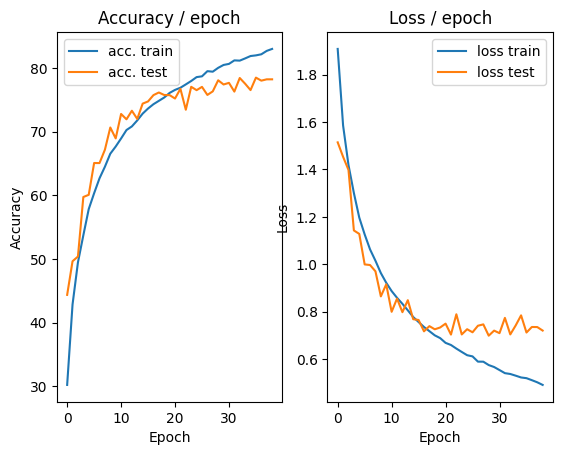

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.4315 (0.4315)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.163s (0.089s)	Loss 0.4961 (0.4832)	Prec@1  81.2 ( 83.0)	Prec@5  99.2 ( 99.4)

===============> Total time 34s	Avg loss 0.4903	Avg Prec@1 82.88 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 0.8543 (0.8543)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8348	Avg Prec@1 76.34 %	Avg Prec@5 97.68 %



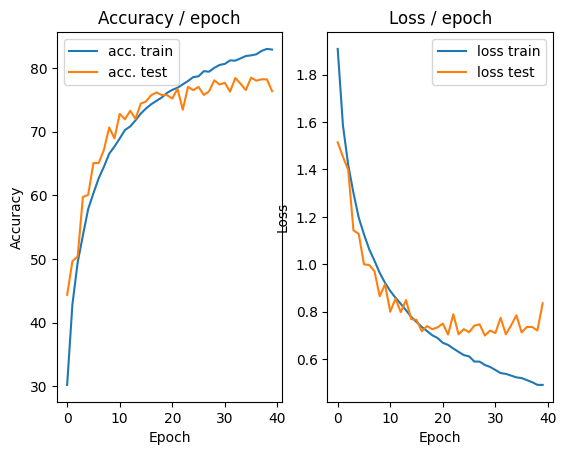

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.314s (0.314s)	Loss 0.5412 (0.5412)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.006s (0.097s)	Loss 0.5323 (0.4764)	Prec@1  78.9 ( 83.3)	Prec@5 100.0 ( 99.4)

===============> Total time 36s	Avg loss 0.4844	Avg Prec@1 82.94 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 1.0481 (1.0481)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8205	Avg Prec@1 75.97 %	Avg Prec@5 97.71 %



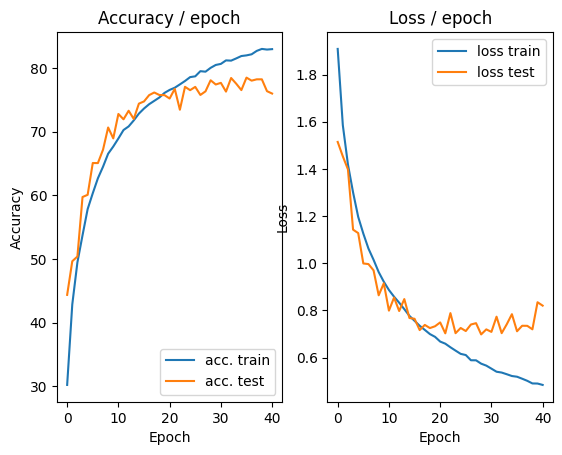

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.8661 (0.8661)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.054s (0.090s)	Loss 0.4694 (0.4767)	Prec@1  83.6 ( 83.4)	Prec@5  98.4 ( 99.4)

===============> Total time 34s	Avg loss 0.4793	Avg Prec@1 83.45 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.086s (0.086s)	Loss 0.8429 (0.8429)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7827	Avg Prec@1 76.50 %	Avg Prec@5 98.07 %



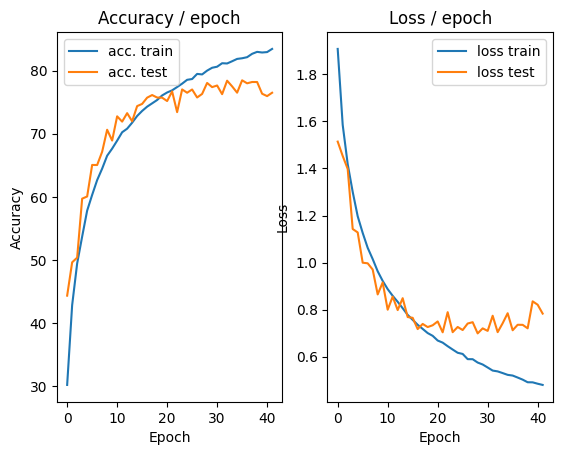

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.295s (0.295s)	Loss 0.6331 (0.6331)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.008s (0.090s)	Loss 0.7292 (0.4708)	Prec@1  78.1 ( 83.8)	Prec@5  98.4 ( 99.4)

===============> Total time 34s	Avg loss 0.4767	Avg Prec@1 83.51 %	Avg Prec@5 99.45 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.9307 (0.9307)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8493	Avg Prec@1 76.04 %	Avg Prec@5 97.70 %



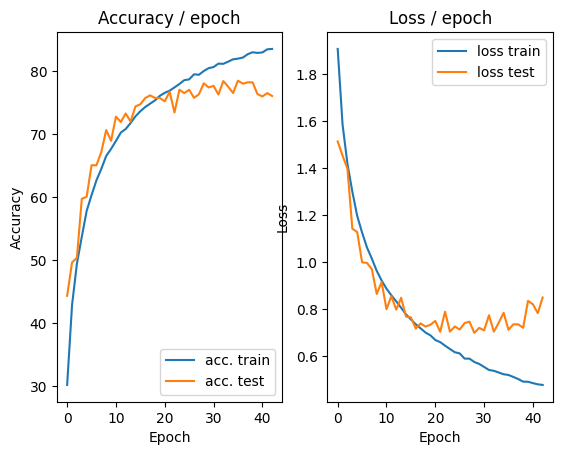

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 0.5239 (0.5239)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.172s (0.098s)	Loss 0.4018 (0.4547)	Prec@1  85.9 ( 84.5)	Prec@5  99.2 ( 99.4)

===============> Total time 36s	Avg loss 0.4636	Avg Prec@1 84.13 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.091s (0.091s)	Loss 0.9474 (0.9474)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8253	Avg Prec@1 76.64 %	Avg Prec@5 98.18 %



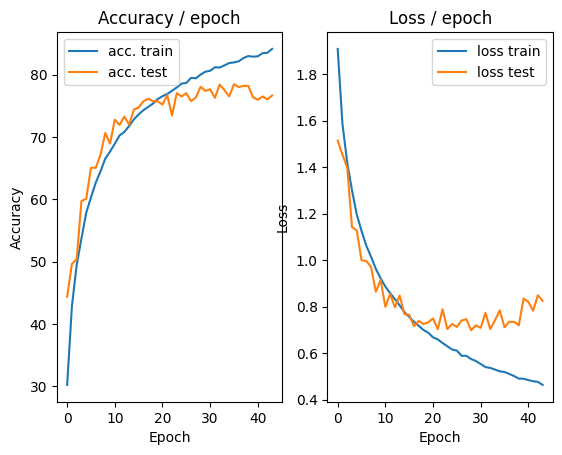

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.3516 (0.3516)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.164s (0.090s)	Loss 0.3284 (0.4576)	Prec@1  90.6 ( 84.1)	Prec@5  99.2 ( 99.5)

===============> Total time 34s	Avg loss 0.4637	Avg Prec@1 83.86 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.088s (0.088s)	Loss 0.9081 (0.9081)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7739	Avg Prec@1 78.05 %	Avg Prec@5 98.05 %



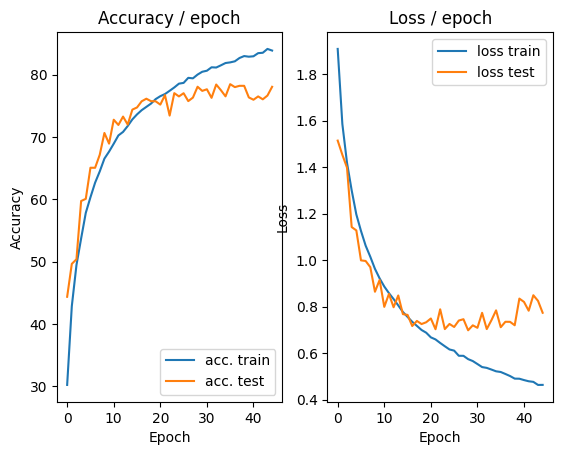

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.288s (0.288s)	Loss 0.2926 (0.2926)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.155s (0.091s)	Loss 0.2659 (0.4396)	Prec@1  93.0 ( 84.9)	Prec@5 100.0 ( 99.5)

===============> Total time 34s	Avg loss 0.4485	Avg Prec@1 84.59 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.7939 (0.7939)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.7599	Avg Prec@1 77.56 %	Avg Prec@5 97.92 %



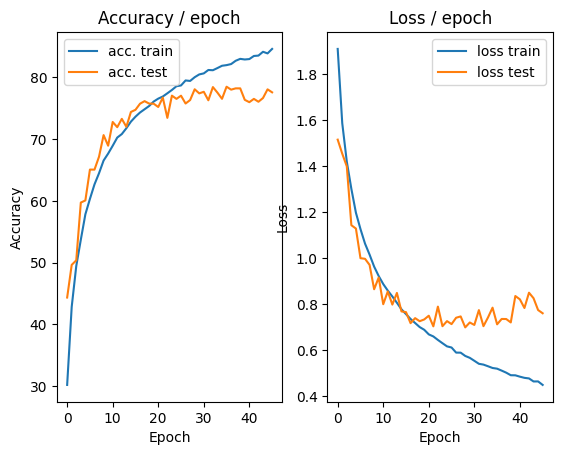

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 0.4765 (0.4765)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.177s (0.089s)	Loss 0.5071 (0.4411)	Prec@1  82.8 ( 84.8)	Prec@5 100.0 ( 99.5)

===============> Total time 34s	Avg loss 0.4455	Avg Prec@1 84.49 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.8193 (0.8193)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7809	Avg Prec@1 77.62 %	Avg Prec@5 98.11 %



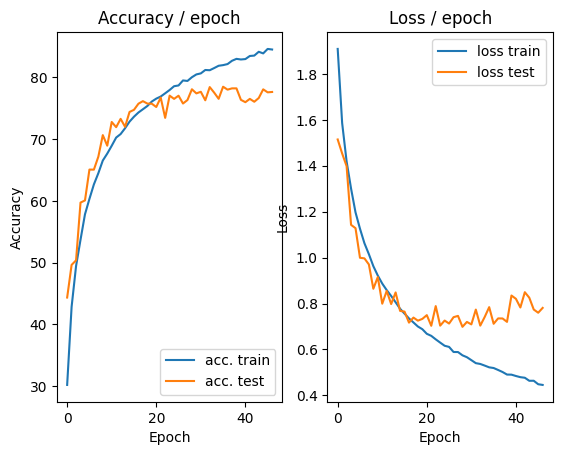

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.442s (0.442s)	Loss 0.4647 (0.4647)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.163s (0.090s)	Loss 0.3726 (0.4331)	Prec@1  87.5 ( 85.1)	Prec@5  99.2 ( 99.6)

===============> Total time 35s	Avg loss 0.4484	Avg Prec@1 84.69 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.7361 (0.7361)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7713	Avg Prec@1 78.45 %	Avg Prec@5 98.32 %



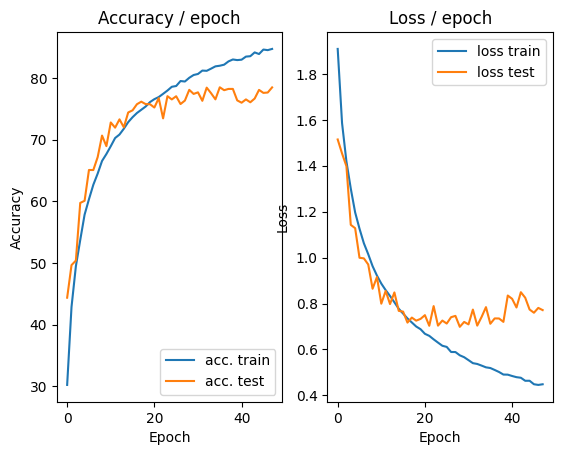

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.3747 (0.3747)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)
[TRAIN Batch 200/391]	Time 0.109s (0.090s)	Loss 0.3949 (0.4273)	Prec@1  86.7 ( 85.5)	Prec@5 100.0 ( 99.5)

===============> Total time 34s	Avg loss 0.4410	Avg Prec@1 84.87 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 0.7014 (0.7014)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7728	Avg Prec@1 78.40 %	Avg Prec@5 98.07 %



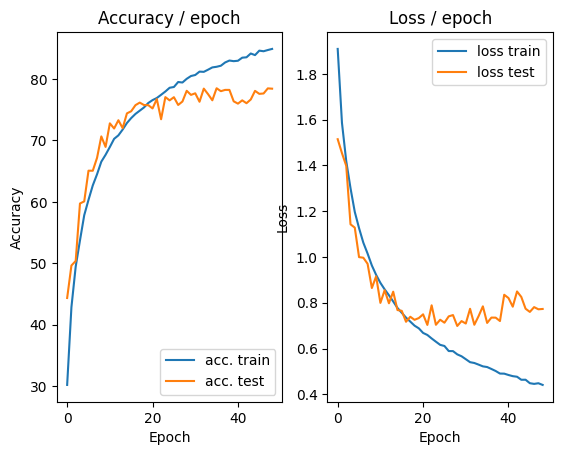

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.341s (0.341s)	Loss 0.4668 (0.4668)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.010s (0.088s)	Loss 0.3616 (0.4328)	Prec@1  85.9 ( 85.1)	Prec@5 100.0 ( 99.5)

===============> Total time 34s	Avg loss 0.4396	Avg Prec@1 84.84 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.8546 (0.8546)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7916	Avg Prec@1 77.95 %	Avg Prec@5 98.02 %



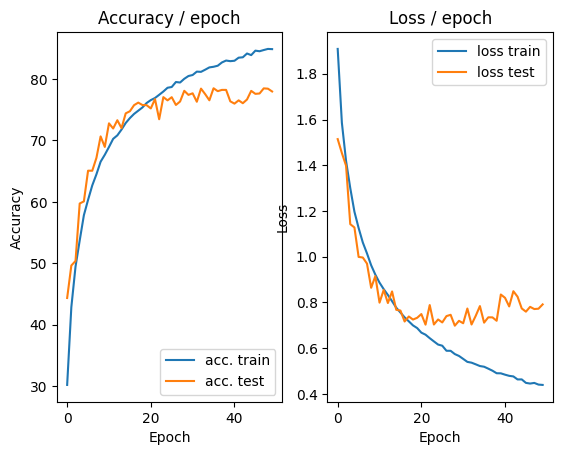

In [12]:
main(128, 0.1, 50, cuda=True)

In [8]:
class ConvNet(nn.Module):
    """
    Cette classe définit la structure du réseau neuronal convolutif.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # Définition des couches convolutives et de pooling pour extraire les caractéristiques
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True),
        )
        # Couches fully connected pour la classification
        self.classifier = nn.Sequential(
            nn.Linear(64 * 4 * 4, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Remarque : Pas besoin d'ajouter la couche softmax ici, car elle est incluse dans la fonction de perte
        )



    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    Cette fonction charge le jeu de données CIFAR-10 et applique les transformations nécessaires,
    y compris la normalisation.
    """
    # Valeurs de normalisation pour CIFAR-10
    mean = [0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]

    # Transformations à appliquer sur les images
    train_transform = transforms.Compose([
        transforms.RandomHorizontalFlip(),  # Flips aléatoires pour augmenter les données
        transforms.RandomCrop(28, padding=4),  # Découpage aléatoire
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        transforms.RandomRotation(15),
        transforms.RandomAffine(degrees=0, translate=(0.1, 0.1), scale=(0.9, 1.1)),
        transforms.RandomPerspective(distortion_scale=0.2, p=0.5),
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)  # Normalisation
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std)
    ])

    # Chargement des jeux de données d'entraînement et de validation
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True, transform=train_transform)
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True, transform=val_transform)

    # Création des DataLoader pour parcourir les jeux de données par batch
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True,
                                               pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size, shuffle=False,
                                             pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Effectue un passage (epoch) sur les données `data` avec le modèle `model`.
    Évalue la perte avec `criterion`. Si `optimizer` est fourni, fait une étape d'entraînement,
    sinon fait une évaluation.
    """
    model.eval() if optimizer is None else model.train()

    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()

    tic = time.time()
    for i, (input, target) in enumerate(data):
        if cuda:
            input = input.cuda()
            target = target.cuda()

        # Forward pass
        output = model(input)
        loss = criterion(output, target)

        # Backward pass si on est en mode entraînement
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # Calcul des métriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # Mise à jour des métriques moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)

        # Affichage des informations
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time,
                   loss=avg_loss, top1=avg_top1_acc, top5=avg_top5_acc))

    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 2.3014 (2.3014)	Prec@1   7.8 (  7.8)	Prec@5  47.7 ( 47.7)
[TRAIN Batch 200/391]	Time 0.137s (0.090s)	Loss 2.1065 (2.1096)	Prec@1  22.7 ( 20.9)	Prec@5  68.0 ( 72.7)

===============> Total time 37s	Avg loss 2.0279	Avg Prec@1 24.43 %	Avg Prec@5 76.92 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 1.8151 (1.8151)	Prec@1  43.0 ( 43.0)	Prec@5  85.9 ( 85.9)

===============> Total time 1s	Avg loss 1.7841	Avg Prec@1 36.48 %	Avg Prec@5 86.68 %



<Figure size 640x480 with 0 Axes>

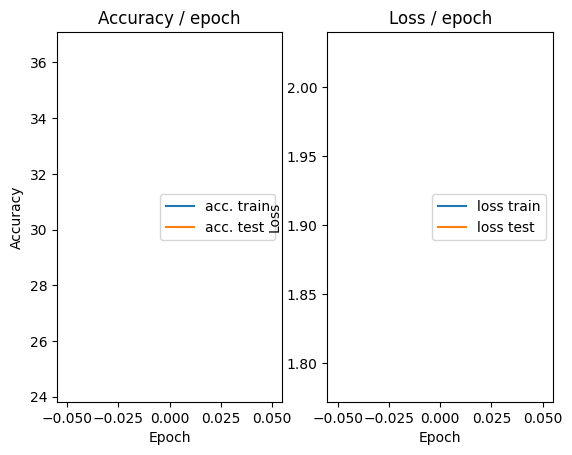

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 1.9735 (1.9735)	Prec@1  28.1 ( 28.1)	Prec@5  78.1 ( 78.1)
[TRAIN Batch 200/391]	Time 0.158s (0.088s)	Loss 1.8390 (1.8385)	Prec@1  30.5 ( 32.2)	Prec@5  87.5 ( 84.8)

===============> Total time 39s	Avg loss 1.8026	Avg Prec@1 33.44 %	Avg Prec@5 85.64 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.6379 (1.6379)	Prec@1  47.7 ( 47.7)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.7256	Avg Prec@1 38.54 %	Avg Prec@5 88.40 %



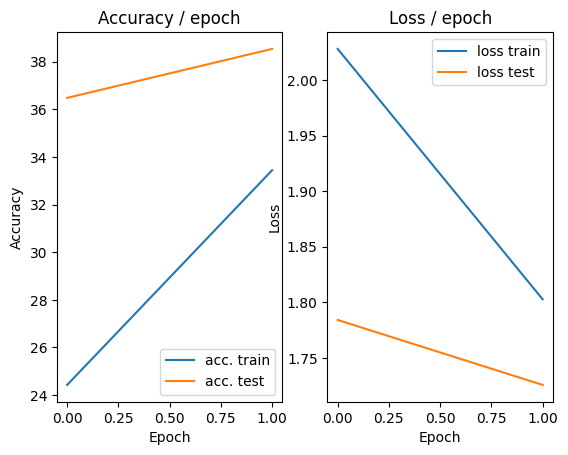

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 1.7764 (1.7764)	Prec@1  31.2 ( 31.2)	Prec@5  85.9 ( 85.9)
[TRAIN Batch 200/391]	Time 0.164s (0.091s)	Loss 1.5565 (1.7057)	Prec@1  43.0 ( 37.9)	Prec@5  89.8 ( 87.8)

===============> Total time 35s	Avg loss 1.6835	Avg Prec@1 38.61 %	Avg Prec@5 88.22 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.5823 (1.5823)	Prec@1  48.4 ( 48.4)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.6311	Avg Prec@1 42.57 %	Avg Prec@5 90.11 %



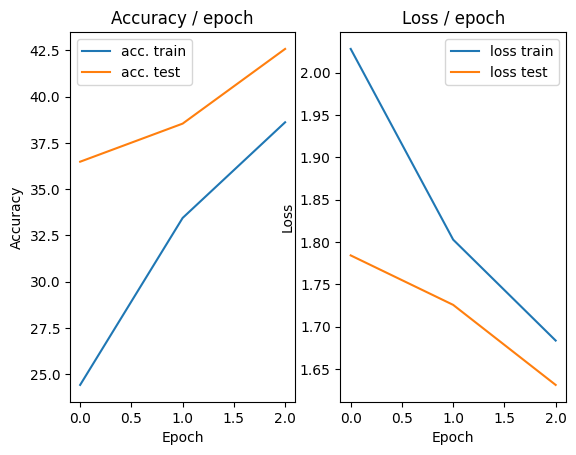

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.249s (0.249s)	Loss 1.7131 (1.7131)	Prec@1  35.9 ( 35.9)	Prec@5  90.6 ( 90.6)
[TRAIN Batch 200/391]	Time 0.188s (0.099s)	Loss 1.5455 (1.6015)	Prec@1  44.5 ( 41.7)	Prec@5  87.5 ( 89.6)

===============> Total time 39s	Avg loss 1.5896	Avg Prec@1 42.34 %	Avg Prec@5 89.72 %

[EVAL Batch 000/079]	Time 0.083s (0.083s)	Loss 1.4086 (1.4086)	Prec@1  54.7 ( 54.7)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.4283	Avg Prec@1 50.72 %	Avg Prec@5 92.06 %



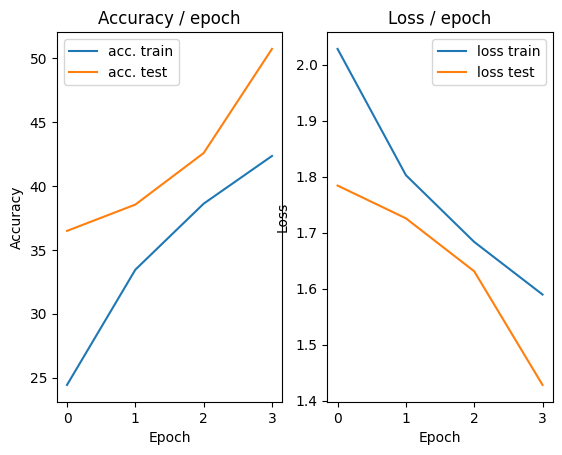

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.314s (0.314s)	Loss 1.6099 (1.6099)	Prec@1  43.0 ( 43.0)	Prec@5  89.8 ( 89.8)
[TRAIN Batch 200/391]	Time 0.183s (0.101s)	Loss 1.5381 (1.5288)	Prec@1  42.2 ( 45.3)	Prec@5  93.0 ( 91.1)

===============> Total time 39s	Avg loss 1.5102	Avg Prec@1 45.84 %	Avg Prec@5 91.29 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 1.2592 (1.2592)	Prec@1  62.5 ( 62.5)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.3144	Avg Prec@1 53.07 %	Avg Prec@5 93.88 %



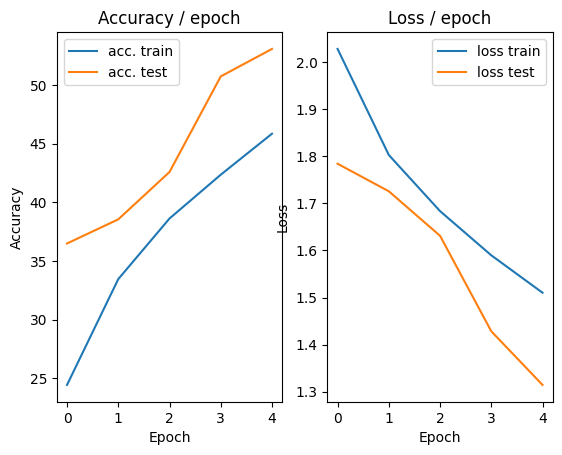

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 1.4177 (1.4177)	Prec@1  51.6 ( 51.6)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.165s (0.096s)	Loss 1.4396 (1.4517)	Prec@1  48.4 ( 47.9)	Prec@5  92.2 ( 91.7)

===============> Total time 38s	Avg loss 1.4462	Avg Prec@1 48.11 %	Avg Prec@5 91.92 %

[EVAL Batch 000/079]	Time 0.073s (0.073s)	Loss 1.3049 (1.3049)	Prec@1  59.4 ( 59.4)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.3236	Avg Prec@1 52.76 %	Avg Prec@5 93.21 %



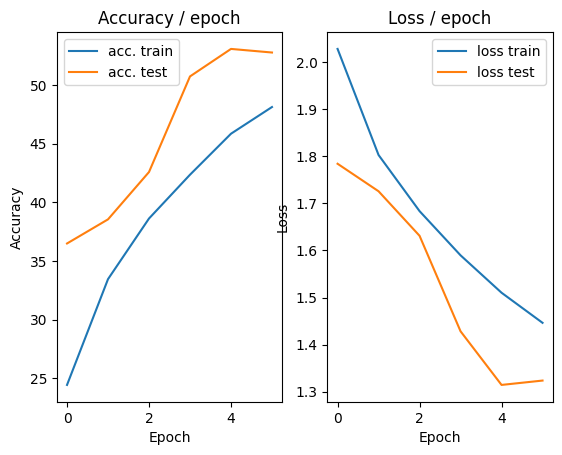

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.335s (0.335s)	Loss 1.4847 (1.4847)	Prec@1  48.4 ( 48.4)	Prec@5  89.1 ( 89.1)
[TRAIN Batch 200/391]	Time 0.158s (0.102s)	Loss 1.1127 (1.4002)	Prec@1  63.3 ( 50.2)	Prec@5  94.5 ( 92.6)

===============> Total time 36s	Avg loss 1.3917	Avg Prec@1 50.28 %	Avg Prec@5 92.78 %

[EVAL Batch 000/079]	Time 0.068s (0.068s)	Loss 1.2955 (1.2955)	Prec@1  56.2 ( 56.2)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.2760	Avg Prec@1 55.91 %	Avg Prec@5 93.77 %



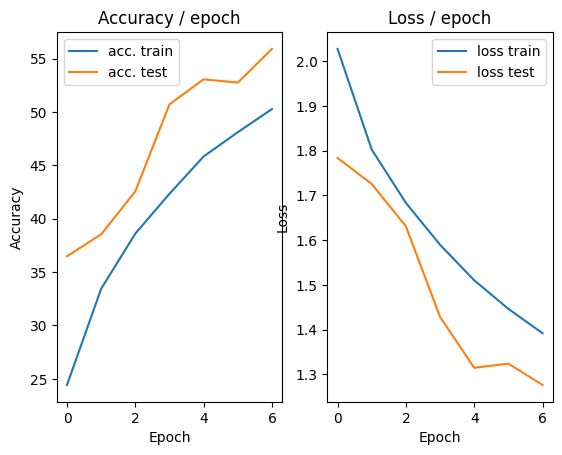

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 1.3056 (1.3056)	Prec@1  57.0 ( 57.0)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.162s (0.094s)	Loss 1.3297 (1.3650)	Prec@1  53.9 ( 51.3)	Prec@5  91.4 ( 93.0)

===============> Total time 35s	Avg loss 1.3484	Avg Prec@1 51.75 %	Avg Prec@5 93.32 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 1.3265 (1.3265)	Prec@1  60.2 ( 60.2)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2587	Avg Prec@1 57.62 %	Avg Prec@5 94.56 %



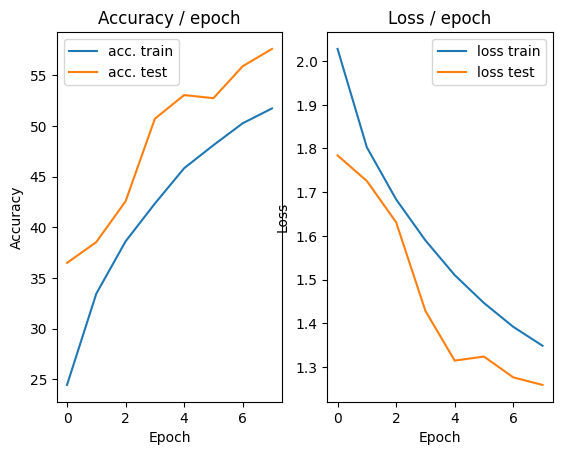

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 1.5168 (1.5168)	Prec@1  51.6 ( 51.6)	Prec@5  86.7 ( 86.7)
[TRAIN Batch 200/391]	Time 0.163s (0.087s)	Loss 1.3481 (1.3213)	Prec@1  53.9 ( 53.0)	Prec@5  94.5 ( 93.7)

===============> Total time 34s	Avg loss 1.3125	Avg Prec@1 53.25 %	Avg Prec@5 93.72 %

[EVAL Batch 000/079]	Time 0.085s (0.085s)	Loss 1.1762 (1.1762)	Prec@1  62.5 ( 62.5)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.1726	Avg Prec@1 59.25 %	Avg Prec@5 94.75 %



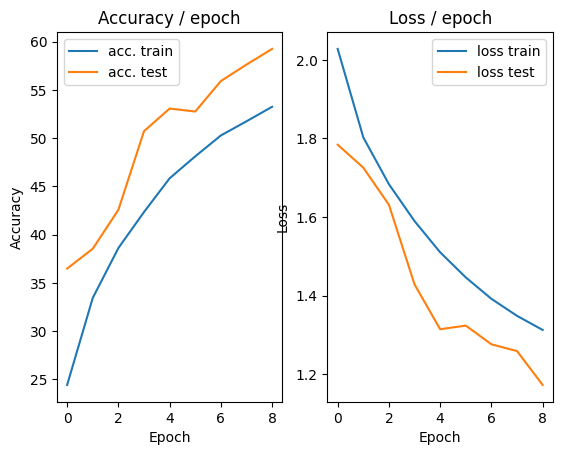

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.249s (0.249s)	Loss 1.3618 (1.3618)	Prec@1  54.7 ( 54.7)	Prec@5  92.2 ( 92.2)
[TRAIN Batch 200/391]	Time 0.187s (0.090s)	Loss 1.3739 (1.2866)	Prec@1  50.0 ( 54.3)	Prec@5  87.5 ( 93.9)

===============> Total time 37s	Avg loss 1.2714	Avg Prec@1 54.94 %	Avg Prec@5 94.07 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.1731 (1.1731)	Prec@1  58.6 ( 58.6)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.1165	Avg Prec@1 61.42 %	Avg Prec@5 95.57 %



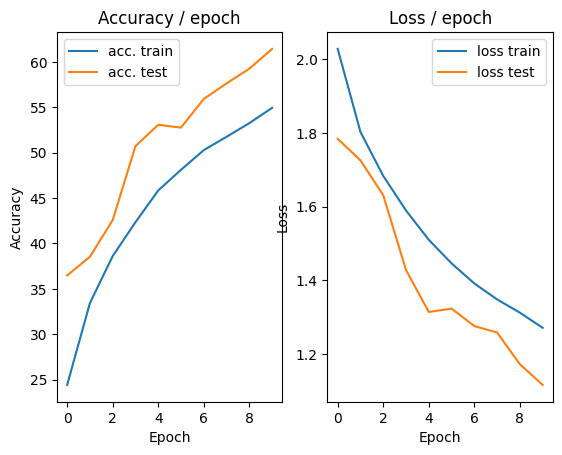

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 1.2911 (1.2911)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.123s (0.098s)	Loss 1.1698 (1.2592)	Prec@1  58.6 ( 55.2)	Prec@5  94.5 ( 94.1)

===============> Total time 38s	Avg loss 1.2417	Avg Prec@1 55.93 %	Avg Prec@5 94.29 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.1068 (1.1068)	Prec@1  64.8 ( 64.8)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.0641	Avg Prec@1 63.35 %	Avg Prec@5 96.38 %



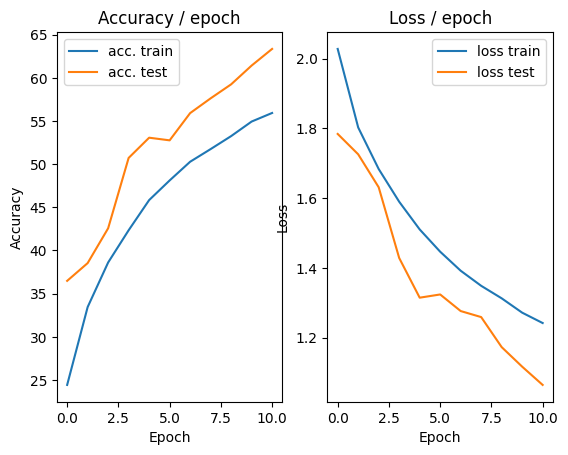

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.360s (0.360s)	Loss 1.2953 (1.2953)	Prec@1  54.7 ( 54.7)	Prec@5  92.2 ( 92.2)
[TRAIN Batch 200/391]	Time 0.048s (0.102s)	Loss 1.1728 (1.2225)	Prec@1  57.0 ( 56.9)	Prec@5  95.3 ( 94.5)

===============> Total time 39s	Avg loss 1.2144	Avg Prec@1 57.12 %	Avg Prec@5 94.71 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 1.0173 (1.0173)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9762	Avg Prec@1 66.04 %	Avg Prec@5 96.62 %



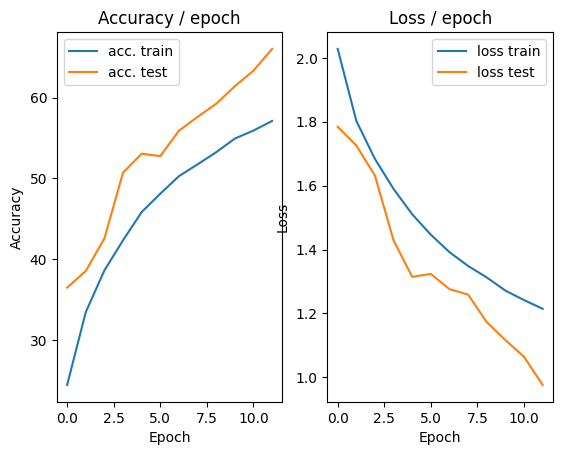

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.321s (0.321s)	Loss 1.1490 (1.1490)	Prec@1  56.2 ( 56.2)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.184s (0.095s)	Loss 1.1641 (1.1894)	Prec@1  56.2 ( 58.1)	Prec@5  96.1 ( 94.9)

===============> Total time 36s	Avg loss 1.1878	Avg Prec@1 58.04 %	Avg Prec@5 94.86 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.9847 (0.9847)	Prec@1  71.9 ( 71.9)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.9991	Avg Prec@1 65.76 %	Avg Prec@5 96.53 %



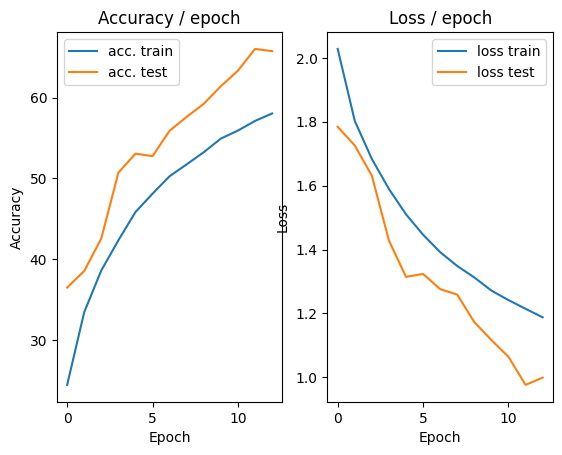

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.374s (0.374s)	Loss 1.1917 (1.1917)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.177s (0.112s)	Loss 1.1042 (1.1647)	Prec@1  60.2 ( 58.8)	Prec@5  96.9 ( 95.1)

===============> Total time 39s	Avg loss 1.1674	Avg Prec@1 58.61 %	Avg Prec@5 95.25 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 1.1337 (1.1337)	Prec@1  63.3 ( 63.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9829	Avg Prec@1 66.56 %	Avg Prec@5 96.78 %



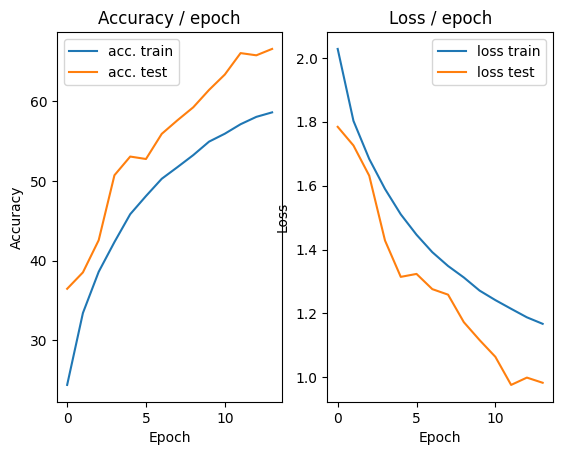

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 1.2637 (1.2637)	Prec@1  60.9 ( 60.9)	Prec@5  94.5 ( 94.5)
[TRAIN Batch 200/391]	Time 0.184s (0.092s)	Loss 1.2285 (1.1441)	Prec@1  57.0 ( 59.6)	Prec@5  90.6 ( 95.2)

===============> Total time 35s	Avg loss 1.1415	Avg Prec@1 59.67 %	Avg Prec@5 95.28 %

[EVAL Batch 000/079]	Time 0.089s (0.089s)	Loss 1.1350 (1.1350)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.0158	Avg Prec@1 65.57 %	Avg Prec@5 96.57 %



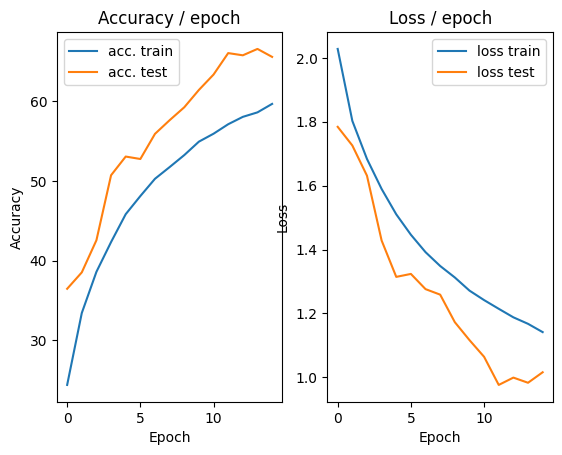

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 1.1989 (1.1989)	Prec@1  60.2 ( 60.2)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.008s (0.092s)	Loss 1.0818 (1.1312)	Prec@1  58.6 ( 60.4)	Prec@5  96.9 ( 95.4)

===============> Total time 35s	Avg loss 1.1242	Avg Prec@1 60.57 %	Avg Prec@5 95.50 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 1.0113 (1.0113)	Prec@1  62.5 ( 62.5)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9331	Avg Prec@1 67.71 %	Avg Prec@5 96.94 %



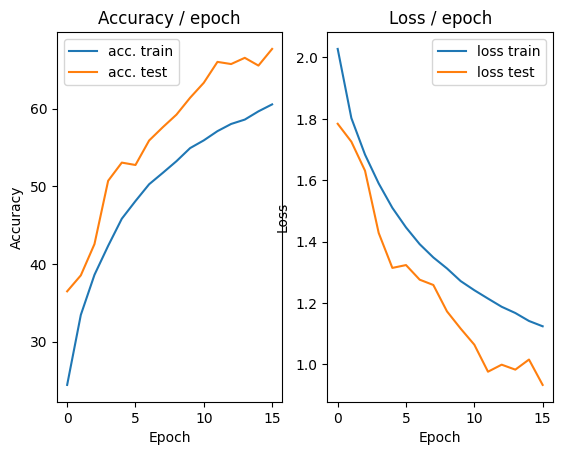

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 1.1875 (1.1875)	Prec@1  58.6 ( 58.6)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.008s (0.092s)	Loss 0.9180 (1.1185)	Prec@1  62.5 ( 60.6)	Prec@5  98.4 ( 95.5)

===============> Total time 36s	Avg loss 1.1101	Avg Prec@1 61.05 %	Avg Prec@5 95.56 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 0.8732 (0.8732)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9090	Avg Prec@1 69.41 %	Avg Prec@5 97.15 %



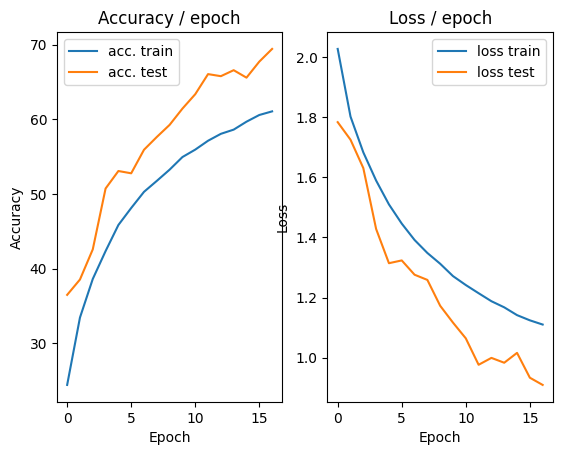

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 1.2594 (1.2594)	Prec@1  59.4 ( 59.4)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.160s (0.093s)	Loss 1.0716 (1.0917)	Prec@1  64.8 ( 61.5)	Prec@5  97.7 ( 95.8)

===============> Total time 36s	Avg loss 1.0901	Avg Prec@1 61.49 %	Avg Prec@5 95.82 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.8416 (0.8416)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8501	Avg Prec@1 70.71 %	Avg Prec@5 97.43 %



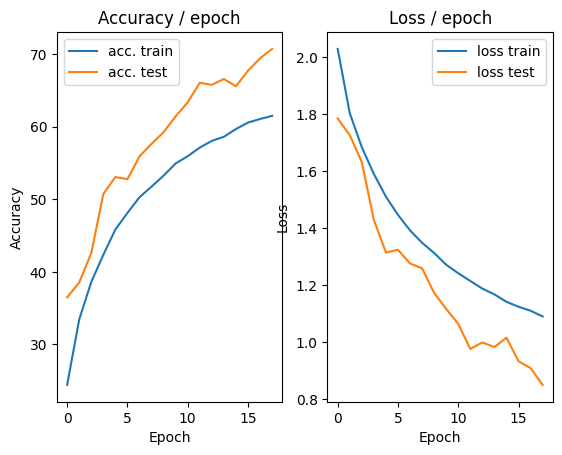

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.9745 (0.9745)	Prec@1  61.7 ( 61.7)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.009s (0.093s)	Loss 0.9329 (1.0733)	Prec@1  66.4 ( 62.5)	Prec@5  98.4 ( 95.9)

===============> Total time 35s	Avg loss 1.0766	Avg Prec@1 62.28 %	Avg Prec@5 95.86 %

[EVAL Batch 000/079]	Time 0.082s (0.082s)	Loss 0.9190 (0.9190)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9030	Avg Prec@1 69.24 %	Avg Prec@5 97.61 %



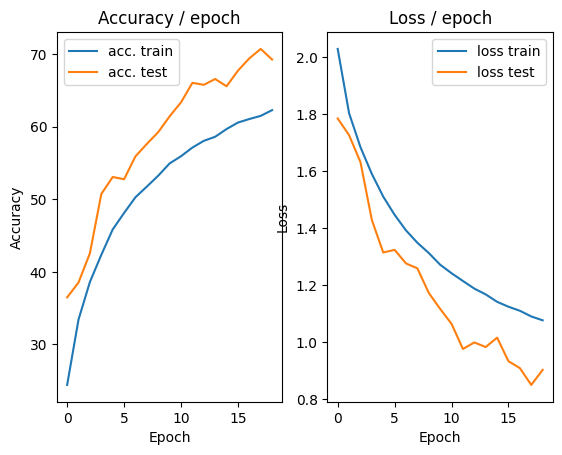

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 1.2138 (1.2138)	Prec@1  60.2 ( 60.2)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.115s (0.091s)	Loss 1.0381 (1.0700)	Prec@1  64.1 ( 62.5)	Prec@5  97.7 ( 95.8)

===============> Total time 37s	Avg loss 1.0596	Avg Prec@1 62.95 %	Avg Prec@5 95.97 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.8112 (0.8112)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8214	Avg Prec@1 71.87 %	Avg Prec@5 97.77 %



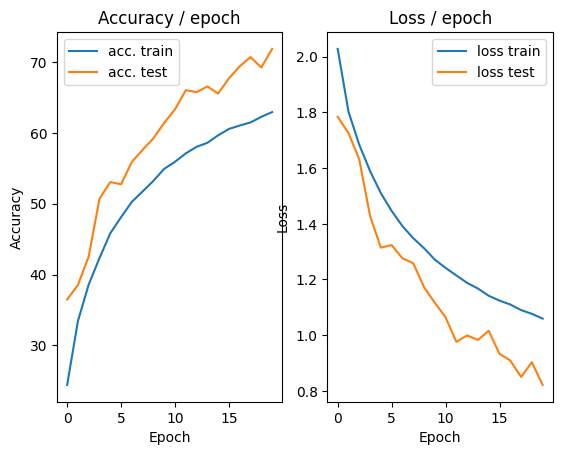

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.363s (0.363s)	Loss 1.0705 (1.0705)	Prec@1  60.9 ( 60.9)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.009s (0.123s)	Loss 1.1582 (1.0532)	Prec@1  59.4 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 48s	Avg loss 1.0593	Avg Prec@1 62.95 %	Avg Prec@5 96.08 %

[EVAL Batch 000/079]	Time 0.090s (0.090s)	Loss 0.7972 (0.7972)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8259	Avg Prec@1 71.28 %	Avg Prec@5 97.78 %



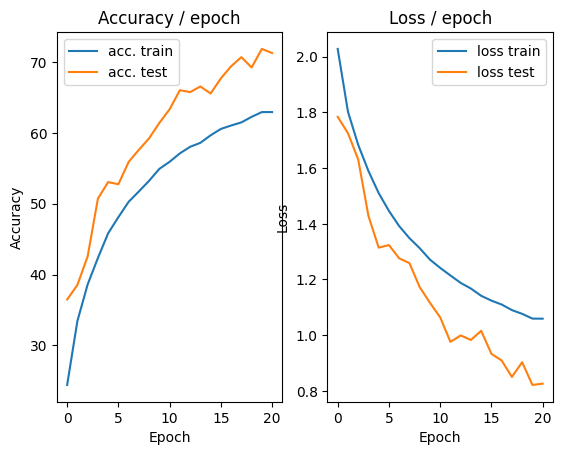

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.339s (0.339s)	Loss 1.1479 (1.1479)	Prec@1  60.2 ( 60.2)	Prec@5  99.2 ( 99.2)
[TRAIN Batch 200/391]	Time 0.012s (0.112s)	Loss 1.1182 (1.0352)	Prec@1  58.6 ( 63.6)	Prec@5  97.7 ( 96.3)

===============> Total time 41s	Avg loss 1.0393	Avg Prec@1 63.69 %	Avg Prec@5 96.16 %

[EVAL Batch 000/079]	Time 0.104s (0.104s)	Loss 0.7648 (0.7648)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8081	Avg Prec@1 72.54 %	Avg Prec@5 97.57 %



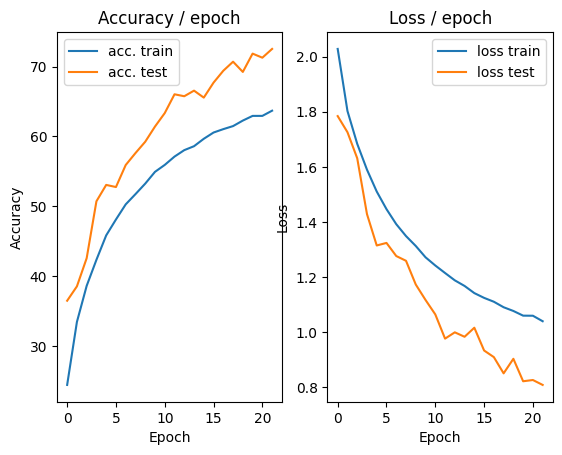

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 1.0325 (1.0325)	Prec@1  62.5 ( 62.5)	Prec@5  95.3 ( 95.3)
[TRAIN Batch 200/391]	Time 0.171s (0.098s)	Loss 0.9752 (1.0316)	Prec@1  68.8 ( 64.1)	Prec@5  96.1 ( 96.1)

===============> Total time 40s	Avg loss 1.0310	Avg Prec@1 64.07 %	Avg Prec@5 96.18 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.8051 (0.8051)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8365	Avg Prec@1 71.33 %	Avg Prec@5 97.54 %



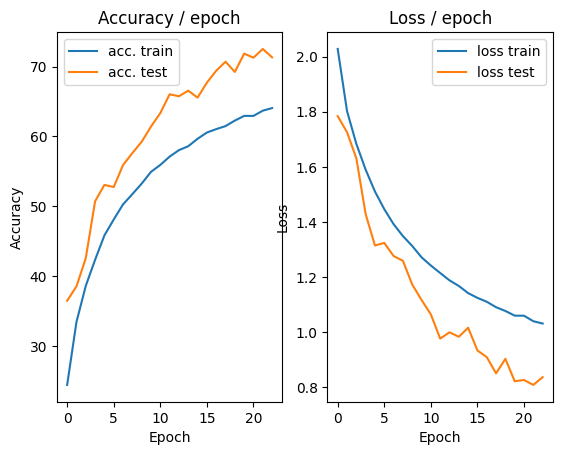

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.9967 (0.9967)	Prec@1  63.3 ( 63.3)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.171s (0.111s)	Loss 1.0724 (1.0205)	Prec@1  61.7 ( 64.4)	Prec@5  96.9 ( 96.4)

===============> Total time 38s	Avg loss 1.0200	Avg Prec@1 64.31 %	Avg Prec@5 96.30 %

[EVAL Batch 000/079]	Time 0.080s (0.080s)	Loss 0.7952 (0.7952)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7897	Avg Prec@1 73.36 %	Avg Prec@5 97.56 %



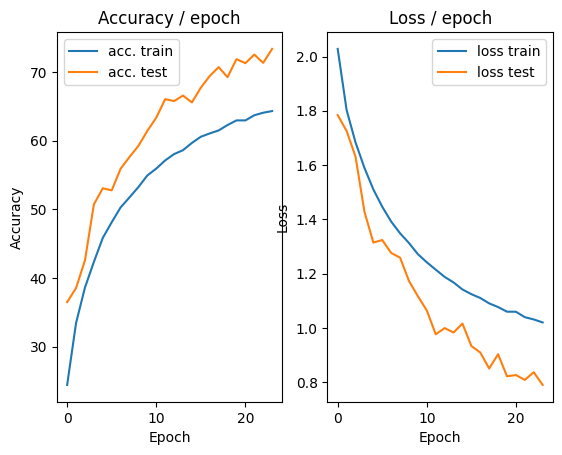

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.355s (0.355s)	Loss 1.0319 (1.0319)	Prec@1  64.1 ( 64.1)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.062s (0.088s)	Loss 0.9499 (1.0121)	Prec@1  66.4 ( 64.8)	Prec@5  96.1 ( 96.2)

===============> Total time 34s	Avg loss 1.0115	Avg Prec@1 64.60 %	Avg Prec@5 96.22 %

[EVAL Batch 000/079]	Time 0.077s (0.077s)	Loss 0.7132 (0.7132)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8233	Avg Prec@1 71.81 %	Avg Prec@5 97.47 %



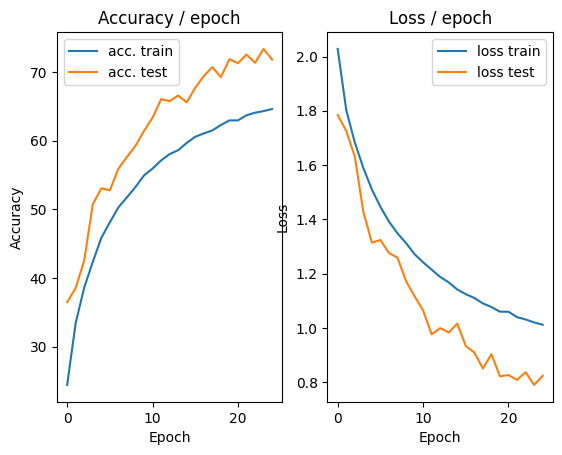

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.281s (0.281s)	Loss 1.1572 (1.1572)	Prec@1  61.7 ( 61.7)	Prec@5  93.8 ( 93.8)
[TRAIN Batch 200/391]	Time 0.161s (0.089s)	Loss 1.0023 (1.0068)	Prec@1  69.5 ( 65.0)	Prec@5  94.5 ( 96.5)

===============> Total time 34s	Avg loss 0.9955	Avg Prec@1 65.36 %	Avg Prec@5 96.45 %

[EVAL Batch 000/079]	Time 0.075s (0.075s)	Loss 0.6970 (0.6970)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8365	Avg Prec@1 71.20 %	Avg Prec@5 97.42 %



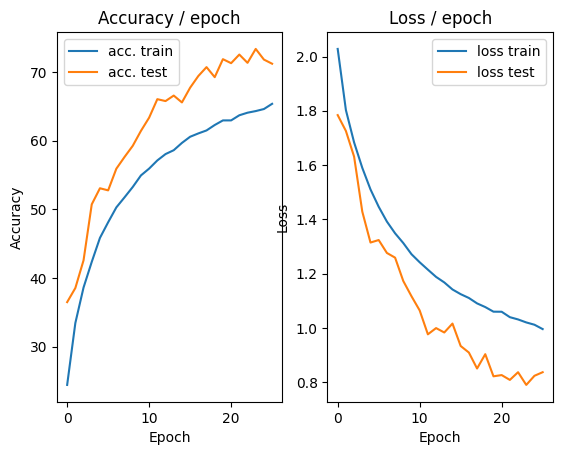

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 1.1289 (1.1289)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)
[TRAIN Batch 200/391]	Time 0.251s (0.093s)	Loss 1.1271 (0.9963)	Prec@1  57.0 ( 65.3)	Prec@5  96.9 ( 96.5)

===============> Total time 38s	Avg loss 0.9950	Avg Prec@1 65.21 %	Avg Prec@5 96.52 %

[EVAL Batch 000/079]	Time 0.081s (0.081s)	Loss 0.7739 (0.7739)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8040	Avg Prec@1 72.33 %	Avg Prec@5 97.78 %



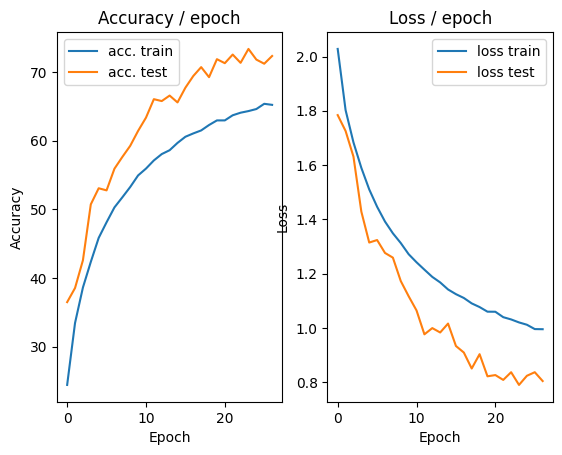

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 1.0474 (1.0474)	Prec@1  60.9 ( 60.9)	Prec@5  96.1 ( 96.1)
[TRAIN Batch 200/391]	Time 0.149s (0.114s)	Loss 1.0233 (0.9844)	Prec@1  60.2 ( 65.2)	Prec@5 100.0 ( 96.5)

===============> Total time 43s	Avg loss 0.9868	Avg Prec@1 65.42 %	Avg Prec@5 96.49 %

[EVAL Batch 000/079]	Time 0.087s (0.087s)	Loss 0.8425 (0.8425)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8521	Avg Prec@1 71.36 %	Avg Prec@5 97.30 %



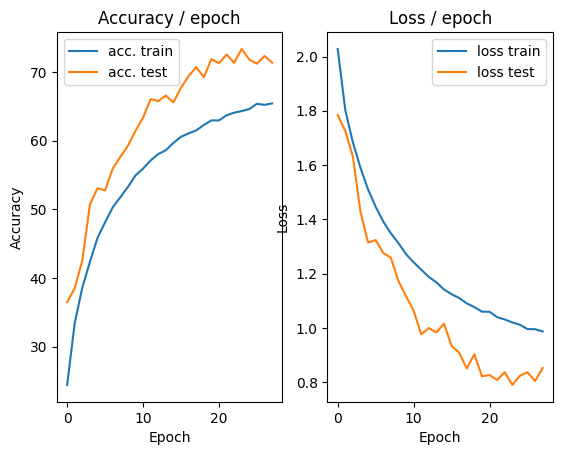

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.9801 (0.9801)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)
[TRAIN Batch 200/391]	Time 0.094s (0.106s)	Loss 0.9169 (0.9810)	Prec@1  70.3 ( 65.7)	Prec@5  96.9 ( 96.6)

===============> Total time 39s	Avg loss 0.9754	Avg Prec@1 65.90 %	Avg Prec@5 96.62 %

[EVAL Batch 000/079]	Time 0.084s (0.084s)	Loss 0.7493 (0.7493)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7429	Avg Prec@1 75.15 %	Avg Prec@5 98.09 %



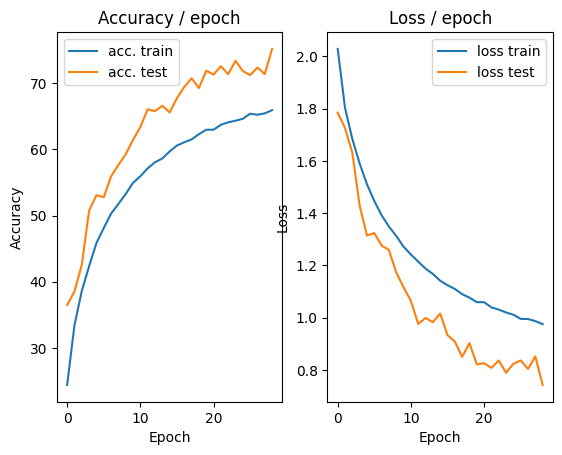

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.9840 (0.9840)	Prec@1  64.8 ( 64.8)	Prec@5  97.7 ( 97.7)
[TRAIN Batch 200/391]	Time 0.011s (0.098s)	Loss 1.2446 (0.9673)	Prec@1  56.2 ( 66.4)	Prec@5  93.8 ( 96.7)

===============> Total time 41s	Avg loss 0.9594	Avg Prec@1 66.47 %	Avg Prec@5 96.70 %

[EVAL Batch 000/079]	Time 0.095s (0.095s)	Loss 0.7969 (0.7969)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7796	Avg Prec@1 73.39 %	Avg Prec@5 98.00 %



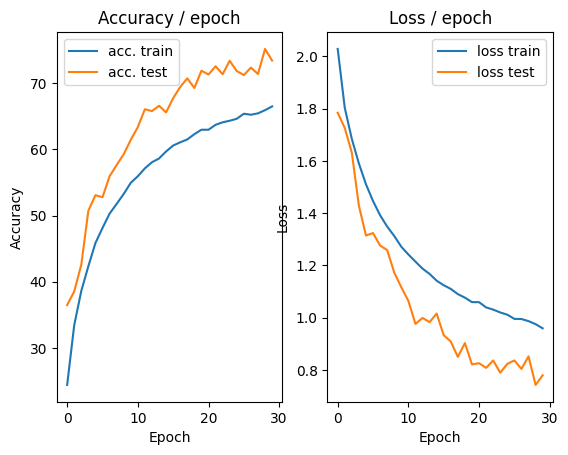

In [10]:
main(128, 0.1, 30, cuda=True)

# BONUS SGD

In [ ]:
import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
import torch.optim as optim
from torch.optim.lr_scheduler import (
    ExponentialLR, 
    CosineAnnealingLR, 
    OneCycleLR,
    ReduceLROnPlateau,
    StepLR
)
import matplotlib.pyplot as plt
from collections import defaultdict

class OptimizerTest:
    def __init__(self, name, optimizer_class, scheduler_class=None, optimizer_params={}, scheduler_params={}):
        self.name = name
        self.optimizer_class = optimizer_class
        self.scheduler_class = scheduler_class
        self.optimizer_params = optimizer_params
        self.scheduler_params = scheduler_params
        self.history = defaultdict(list)

def create_optimizer_tests(base_lr=0.1):
    return [
        # Test différentes variantes de SGD
        OptimizerTest(
            "SGD basique",
            optim.SGD,
            optimizer_params={'lr': base_lr}
        ),
        OptimizerTest(
            "SGD avec momentum",
            optim.SGD,
            optimizer_params={'lr': base_lr, 'momentum': 0.9}
        ),
        OptimizerTest(
            "SGD avec momentum et nesterov",
            optim.SGD,
            optimizer_params={'lr': base_lr, 'momentum': 0.9, 'nesterov': True}
        ),
        OptimizerTest(
            "Adam",
            optim.Adam,
            optimizer_params={'lr': base_lr}
        ),
        # Test différents schedulers avec SGD+momentum
        OptimizerTest(
            "SGD + ExponentialLR",
            optim.SGD,
            ExponentialLR,
            {'lr': base_lr, 'momentum': 0.9},
            {'gamma': 0.95}
        ),
        OptimizerTest(
            "SGD + CosineAnnealing",
            optim.SGD,
            CosineAnnealingLR,
            {'lr': base_lr, 'momentum': 0.9},
            {'T_max': 25, 'eta_min': 1e-4}
        ),
        OptimizerTest(
            "SGD + OneCycleLR",
            optim.SGD,
            OneCycleLR,
            {'lr': base_lr, 'momentum': 0.9},
            {'max_lr': base_lr, 'epochs': 25, 'steps_per_epoch': 1}
        ),
        OptimizerTest(
            "SGD + ReduceLROnPlateau",
            optim.SGD,
            ReduceLROnPlateau,
            {'lr': base_lr, 'momentum': 0.9},
            {'mode': 'min', 'factor': 0.5, 'patience': 3}
        ),
        OptimizerTest(
            "SGD + StepLR",
            optim.SGD,
            StepLR,
            {'lr': base_lr, 'momentum': 0.9},
            {'step_size': 5, 'gamma': 0.5}
        ),
    ]

def plot_results(all_histories):
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 5))
    
    for name, history in all_histories.items():
        epochs = range(1, len(history['train_loss']) + 1)
        ax1.plot(epochs, history['train_loss'], label=f'{name} (train)')
        ax1.plot(epochs, history['test_loss'], label=f'{name} (test)')
        ax2.plot(epochs, history['train_acc'], label=f'{name} (train)')
        ax2.plot(epochs, history['test_acc'], label=f'{name} (test)')
        ax3.plot(epochs, history['learning_rates'], label=name)
    
    ax1.set_title('Loss Evolution')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()
    ax1.grid(True)

    ax2.set_title('Accuracy Evolution')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy (%)')
    ax2.legend()
    ax2.grid(True)

    ax3.set_title('Learning Rate Evolution')
    ax3.set_xlabel('Epoch')
    ax3.set_ylabel('Learning Rate')
    ax3.set_yscale('log')
    ax3.legend()
    ax3.grid(True)

    plt.tight_layout()
    plt.show()

def main(batch_size=128, base_lr=0.1, epochs=15, cuda=False):
    optimizer_tests = create_optimizer_tests(base_lr)
    all_histories = {}

    for test in optimizer_tests:
        print(f"\nTesting {test.name}")
        
        # define model
        model = ConvNet()
        criterion = nn.CrossEntropyLoss()
        
        # create optimizer
        optimizer = test.optimizer_class(model.parameters(), **test.optimizer_params)
        
        # create scheduler if specified
        scheduler = None
        if test.scheduler_class is not None:
            if test.scheduler_class == ReduceLROnPlateau:
                scheduler = test.scheduler_class(optimizer, **test.scheduler_params)
            else:
                scheduler = test.scheduler_class(optimizer, **test.scheduler_params)

        if cuda:
            cudnn.benchmark = True
            model = model.cuda()
            criterion = criterion.cuda()

        # Get the data
        train, test_loader = get_dataset(batch_size, cuda)

        # Training loop
        for i in range(epochs):
            print(f"Epoch {i+1}/{epochs}")
            current_lr = optimizer.param_groups[0]['lr']
            print(f"Learning rate: {current_lr:.6f}")

            # Train phase
            top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
            
            # Test phase
            top1_acc_test, top5_acc_test, loss_test = epoch(test_loader, model, criterion, cuda=cuda)

            # Update learning rate
            if scheduler is not None:
                if isinstance(scheduler, ReduceLROnPlateau):
                    scheduler.step(loss_test.avg)
                else:
                    scheduler.step()

            # Save metrics
            test.history['train_loss'].append(loss.avg)
            test.history['test_loss'].append(loss_test.avg)
            test.history['train_acc'].append(top1_acc.avg)
            test.history['test_acc'].append(top1_acc_test.avg)
            test.history['learning_rates'].append(current_lr)

        all_histories[test.name] = test.history

    # Plot results
    plot_results(all_histories)

if __name__ == '__main__':
    main(cuda=torch.cuda.is_available())